In [ ]:
function ClickConnect(){
    console.log("Working"); 
    document.querySelector("colab-toolbar-button#connect").click() 
}
setInterval(ClickConnect,60000)

#Data Preprocessing

In [1]:
''' Imports for loading stuff in .p form from Google Drive into arrays.'''
import os
import pickle
import numpy as np

def load_input_data(storage_folder, which_kind):
	"""
	Unpickle the data stored in the folder. The name of the measurement data
	inside the folder is considered as 'data_arrays_which_kind-data-' + standards.
	The measurement data for each standard is returned in a list.	Standard must be
  a list of Strings. The data is loaded in the order of the standards.
	"""

  # Declare variables in this scope.
	x_data = None
	data_file = None
	
  # Decide which input data to load.
	if which_kind == 'iq':
		data_file = 'data_iq.p'
	elif which_kind == 'fft':
		data_file = 'data_fft.p'
	else:
		raise ValueError('Parameter which_kind must be "iq" for IQ-data or "fft" for FFT-data.')

  # Data is loaded in the form of a byte stream for pickle and the 'latin-1'
  # encoding is used to read the data initially generated for Python 2.7

  # Load input data (x). 
	data_path = os.path.join(storage_folder, data_file)
	with open(data_path, mode='rb') as storage:
	  x_data = pickle.load(storage, encoding='latin-1')
	
	return x_data

def load_output_data(storage_folder):
	"""
	Unpickle the label data stored in the folder. The label data is considered as 
  'labels-data-' + standards.	The label data for each standard is returned in a 
  list of integers. The labels are loaded in the order of the standards.
	"""

  # Declare variables in this scope.
	y_data = None

  # Data is loaded in the form of a byte stream for pickle and the 'latin-1'
  # encoding is used to read the data initially generated for Python 2.7
  
  # Load output data/labels (y).
	label_file = 'labels.p'
	label_path = os.path.join(storage_folder, label_file)
	with open(label_path, mode='rb') as storage:
		y_data = pickle.load(storage, encoding='latin-1')

	return y_data

def normalize_data(x):
	"""
  x is a numpy array which should be normalized. Normalizes the training data
  to have a train_mean of 0 and a standard deviation of 1. Removes bias in the 
  data for better training. Returns the normalized data in the same format.
	"""
 
  # Subtract mean and divide by standard deviation to normalize.
	flat_x = x.flatten()
	return ((x - np.mean(flat_x))/np.std(flat_x))

In [2]:
from google.colab import drive

drive.mount('/gdrive/')
!ls /gdrive
folder = '/gdrive/MyDrive/Wireless_Interference_Identification_Dataset2'

Mounted at /gdrive/
MyDrive


In [3]:
# Load 'fft' data.
x_data_fft_data = load_input_data(folder, 'fft')

# Load the labels.
y_labels_data= load_output_data(folder)

## Format of Data

The data structure is a 5-dimensional tensor of the below structure.

*15 x 21 x 715 x 128 x 2 - Tensor*
*Label x SNR x Snapshot x Samples x IQ Data*


**Description of Snapshots:**

Each snapshot has 128 complex samples. The real and imaginary component are
represented by the last dimension.

'iq'- Time series of IQ samples

'fft'- Frequency samples of FFT of IQ series 


**Label:**

0..9: Bluetooth signal at center frequency of 2422 MHz + Label * 1 MHz representing channels 20-29 respectively.

10..12: WiFi (802.11b/g) signal at center frequency of 2422 MHz + (Label - 10) * 5 MHz representing channels 3, 4, 5 respectively.

13..14: Zigbee (802.15.4) signal at center frequency of 2425 MHz + (Label - 13) * 5 MHz
representing channels 15 and 16.

The frequency offset is necessary because different offsets expose different
channels of the signals as in the below.


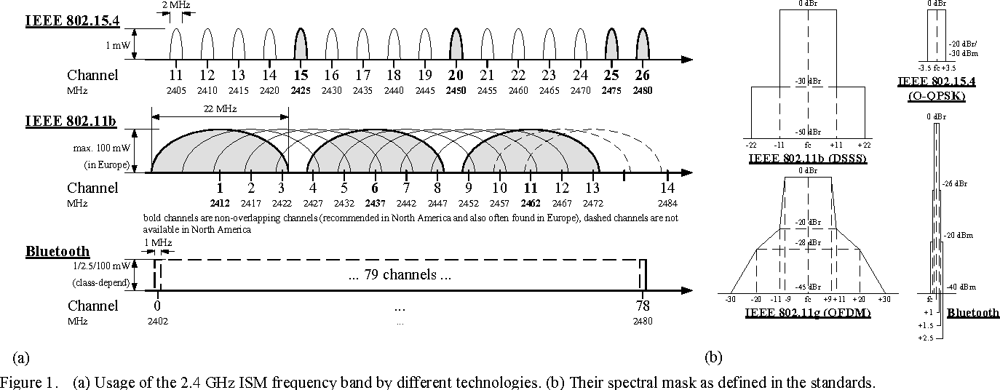

**SNR:**

0..20: SNR between -20 dB...20 dB with the step size of 2 dB, (e.g. index 6 referres to SNR of -8 dB).

Stronger SNRs represent easier to identify stronger signals but we train the
neural network on signals of all SNR.

**Snapshot:**

0..714: Number of the snapshots per Label

**Samples:**

0..127: Sample number per snapshot

**iq:**

0: In-Phase

1: Quadrature

# Models

In [4]:
from keras.models import Sequential
from keras.layers import Dense, BatchNormalization, LeakyReLU, Dropout, Conv2D, Flatten

In [5]:
# Define model with two hidden layers
def fcn_model():
	# Create model
	model = Sequential(
    [      
      Dense(256, input_dim=128),
      BatchNormalization(),
      Dropout(0.2),
      LeakyReLU(),
      Dense(64),
      Dropout(0.2),
      BatchNormalization(),
      LeakyReLU(),
      Dense(15, activation='softmax'),
    ]
  )
  # Compile model
	model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
	return model

print(fcn_model().summary())

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 256)               33024     
_________________________________________________________________
batch_normalization (BatchNo (None, 256)               1024      
_________________________________________________________________
dropout (Dropout)            (None, 256)               0         
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 256)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 64)                16448     
_________________________________________________________________
dropout_1 (Dropout)          (None, 64)                0         
_________________________________________________________________
batch_normalization_1 (Batch (None, 64)                2

In [6]:
# Define model with two hidden layers
def fcn_model_signalType():
	# Create model
	model = Sequential(
    [      
      Dense(256, input_dim=128),
      BatchNormalization(),
      Dropout(0.2),
      LeakyReLU(),
      Dense(64),
      Dropout(0.2),
      BatchNormalization(),
      LeakyReLU(),
      Dense(3, activation='softmax'),
    ]
  )
  # Compile model
	model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
	return model

print(fcn_model_signalType().summary())

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3 (Dense)              (None, 256)               33024     
_________________________________________________________________
batch_normalization_2 (Batch (None, 256)               1024      
_________________________________________________________________
dropout_2 (Dropout)          (None, 256)               0         
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 256)               0         
_________________________________________________________________
dense_4 (Dense)              (None, 64)                16448     
_________________________________________________________________
dropout_3 (Dropout)          (None, 64)                0         
_________________________________________________________________
batch_normalization_3 (Batch (None, 64)               

In [7]:
# Define model with two hidden layers
def fcn_model_bluetooth():
	# Create model
	model = Sequential(
    [      
      Dense(256, input_dim=128),
      BatchNormalization(),
      Dropout(0.2),
      LeakyReLU(),
      Dense(64),
      Dropout(0.2),
      BatchNormalization(),
      LeakyReLU(),
      Dense(10, activation='softmax'),
    ]
  )
  # Compile model
	model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
	return model

print(fcn_model_bluetooth().summary())

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_6 (Dense)              (None, 256)               33024     
_________________________________________________________________
batch_normalization_4 (Batch (None, 256)               1024      
_________________________________________________________________
dropout_4 (Dropout)          (None, 256)               0         
_________________________________________________________________
leaky_re_lu_4 (LeakyReLU)    (None, 256)               0         
_________________________________________________________________
dense_7 (Dense)              (None, 64)                16448     
_________________________________________________________________
dropout_5 (Dropout)          (None, 64)                0         
_________________________________________________________________
batch_normalization_5 (Batch (None, 64)               

In [8]:
# Define model with two hidden layers
def fcn_model_wifi():
	# Create model
	model = Sequential(
    [      
      Dense(256, input_dim=128),
      BatchNormalization(),
      Dropout(0.2),
      LeakyReLU(),
      Dense(64),
      Dropout(0.2),
      BatchNormalization(),
      LeakyReLU(),
      Dense(3, activation='softmax'),
    ]
  )
  # Compile model
	model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
	return model

print(fcn_model_wifi().summary())

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_9 (Dense)              (None, 256)               33024     
_________________________________________________________________
batch_normalization_6 (Batch (None, 256)               1024      
_________________________________________________________________
dropout_6 (Dropout)          (None, 256)               0         
_________________________________________________________________
leaky_re_lu_6 (LeakyReLU)    (None, 256)               0         
_________________________________________________________________
dense_10 (Dense)             (None, 64)                16448     
_________________________________________________________________
dropout_7 (Dropout)          (None, 64)                0         
_________________________________________________________________
batch_normalization_7 (Batch (None, 64)               

In [9]:
# Define model with two hidden layers
def fcn_model_zigbee():
	# Create model
	model = Sequential(
    [      
      Dense(256, input_dim=128),
      BatchNormalization(),
      Dropout(0.2),
      LeakyReLU(),
      Dense(64),
      Dropout(0.2),
      BatchNormalization(),
      LeakyReLU(),
      Dense(2, activation='softmax'),
    ]
  )
  # Compile model
	model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
	return model

print(fcn_model_zigbee().summary())

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_12 (Dense)             (None, 256)               33024     
_________________________________________________________________
batch_normalization_8 (Batch (None, 256)               1024      
_________________________________________________________________
dropout_8 (Dropout)          (None, 256)               0         
_________________________________________________________________
leaky_re_lu_8 (LeakyReLU)    (None, 256)               0         
_________________________________________________________________
dense_13 (Dense)             (None, 64)                16448     
_________________________________________________________________
dropout_9 (Dropout)          (None, 64)                0         
_________________________________________________________________
batch_normalization_9 (Batch (None, 64)               

In [10]:
from matplotlib import pyplot

def summarize_model(history):

  pyplot.plot(history.history['accuracy'])
  pyplot.plot(history.history['val_accuracy']) 
  pyplot.title('Model train and validation accuracy')
  pyplot.ylabel('Accuracy')
  pyplot.xlabel('Epoch')
  pyplot.legend(['train', 'validation'], loc='upper right')
  pyplot.show()

  pyplot.plot(history.history['loss'])
  pyplot.plot(history.history['val_loss'])  
  pyplot.title('Model train and validation loss')
  pyplot.ylabel('Loss')
  pyplot.xlabel('Epoch')
  pyplot.legend(['train', 'validation'], loc='upper right')
  pyplot.show()

# Whole data

In [ ]:
x_dim = x_data_fft_data.shape
total_num_snapshots = x_dim[0]*x_dim[1]*x_dim[2]
num_snapshots_per_tech = x_dim[1]*x_dim[2]
num_tech = x_dim[0]
num_samples = x_dim[3]
print(num_snapshots_per_tech)

15015


In [ ]:
from sklearn.preprocessing import MinMaxScaler

# Bin wise scalers for FFT data from sklearn
scaler_01 = MinMaxScaler(feature_range=(0,1))

x_data_fft_all_SNR_1d = np.reshape(x_data_fft_data, (total_num_snapshots, num_samples*x_dim[4]))
fft_data_complex = np.reshape(x_data_fft_all_SNR_1d.flatten()[::2] + 1j*x_data_fft_all_SNR_1d.flatten()[1::2], (total_num_snapshots, num_samples))
x_data_fft_all_SNR_1d = scaler_01.fit_transform(np.absolute(fft_data_complex))

In [ ]:
from keras.utils.np_utils import to_categorical

y_labels_all_SNR = y_labels_data.flatten()
y_labels_one_hot_all_SNR = to_categorical(y_labels_all_SNR)

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test_valid, Y_train, Y_test_valid = train_test_split(x_data_fft_all_SNR_1d, y_labels_one_hot_all_SNR, test_size=0.4)
X_validation, X_test, Y_validation, Y_test = train_test_split(X_test_valid, Y_test_valid, test_size=0.5)

In [ ]:
from keras.callbacks import EarlyStopping
ES = EarlyStopping(monitor = 'val_accuracy', mode = 'max', min_delta = 0.00001, patience = 200, verbose = 1)

import logging
logging.disable(logging.WARNING)

Epoch 1/200
132/132 [==============================] - 3s 11ms/step - loss: 1.3160 - accuracy: 0.6514 - val_loss: 2.2185 - val_accuracy: 0.0676
Epoch 2/200
132/132 [==============================] - 1s 7ms/step - loss: 0.5035 - accuracy: 0.8657 - val_loss: 1.7974 - val_accuracy: 0.2190
Epoch 3/200
132/132 [==============================] - 1s 7ms/step - loss: 0.4362 - accuracy: 0.8755 - val_loss: 0.6179 - val_accuracy: 0.8029
Epoch 4/200
132/132 [==============================] - 1s 7ms/step - loss: 0.3968 - accuracy: 0.8825 - val_loss: 0.4224 - val_accuracy: 0.8635
Epoch 5/200
132/132 [==============================] - 1s 7ms/step - loss: 0.3888 - accuracy: 0.8814 - val_loss: 0.3671 - val_accuracy: 0.8854
Epoch 6/200
132/132 [==============================] - 1s 7ms/step - loss: 0.3778 - accuracy: 0.8838 - val_loss: 0.3634 - val_accuracy: 0.8897
Epoch 7/200
132/132 [==============================] - 1s 7ms/step - loss: 0.3718 - accuracy: 0.8848 - val_loss: 0.3537 - val_accuracy: 0.889

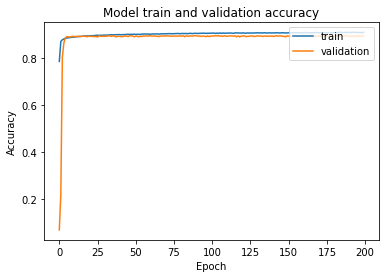

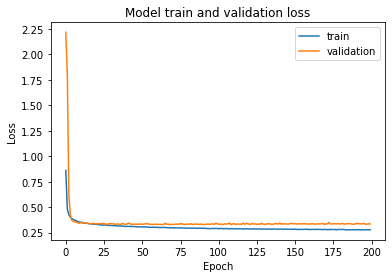


Training Accuracy Array:  [0.78434157371521, 0.8694120645523071, 0.8763681054115295, 0.879890501499176, 0.8817848563194275, 0.8840344548225403, 0.8847301006317139, 0.8860399127006531, 0.886994481086731, 0.8877049088478088, 0.8882080912590027, 0.8893032670021057, 0.889776885509491, 0.8905982971191406, 0.8911162614822388, 0.8916342854499817, 0.8922041058540344, 0.8922929167747498, 0.892633318901062, 0.8931586742401123, 0.8933733105659485, 0.8936619162559509, 0.8939356803894043, 0.8941947221755981, 0.8953787088394165, 0.8953343033790588, 0.895282506942749, 0.8955932855606079, 0.8954823017120361, 0.8962740898132324, 0.896000325679779, 0.8962222933769226, 0.89598548412323, 0.8969845175743103, 0.8981462717056274, 0.8973100781440735, 0.8977689146995544, 0.8981611132621765, 0.8980870842933655, 0.8988049030303955, 0.8977910876274109, 0.8983979225158691, 0.8981611132621765, 0.8985828757286072, 0.8990712761878967, 0.8997743129730225, 0.8991600871086121, 0.8997743129730225, 0.8997372984886169, 0.

In [ ]:
fcn_learning = fcn_model()

epochs = 200
batch_size = 1024

history = fcn_learning.fit(X_train, Y_train, epochs=epochs, batch_size=batch_size,  validation_data = (X_validation, Y_validation), shuffle=True, callbacks=[ES])

score = fcn_learning.evaluate(X_test, Y_test, verbose=0)
print('\nEvaluating on Test data : Score of SNR  = ' + str(score[1]*100) +'\n')

summarize_model(history)
fcn_learning.save("/gdrive/My Drive/Signal Identification Model FCN/fcnFFTdata_allSNR.tf")

print("\nTraining Accuracy Array: ", history.history['accuracy'])
print("\nValidation Accuracy Array: ", history.history['val_accuracy'])

# High SNR 

In [ ]:
x_data_fft_high_SNR = x_data_fft_data[:,10:21]
y_labels_high_SNR = y_labels_data[:,10:21]

print(x_data_fft_high_SNR.shape)
print(y_labels_high_SNR.shape)

(15, 11, 715, 128, 2)
(15, 11, 715)


In [ ]:
x_dim = x_data_fft_high_SNR.shape
total_num_snapshots = x_dim[0]*x_dim[1]*x_dim[2]
num_snapshots_per_tech = x_dim[1]*x_dim[2]
num_tech = x_dim[0]
num_samples = x_dim[3]
print(num_snapshots_per_tech)

7865


In [ ]:
from sklearn.preprocessing import MinMaxScaler

# Bin wise scalers for FFT data from sklearn
scaler_01 = MinMaxScaler(feature_range=(0,1))

x_data_fft_high_SNR_1d = np.reshape(x_data_fft_high_SNR, (total_num_snapshots, num_samples*x_dim[4]))
fft_data_complex = np.reshape(x_data_fft_high_SNR_1d.flatten()[::2] + 1j*x_data_fft_high_SNR_1d.flatten()[1::2], (total_num_snapshots, num_samples))
x_data_fft_high_SNR_1d = scaler_01.fit_transform(np.absolute(fft_data_complex))

In [ ]:
from keras.utils.np_utils import to_categorical

y_labels_high_SNR = y_labels_high_SNR.flatten()
y_labels_one_hot_high_SNR = to_categorical(y_labels_high_SNR)

In [ ]:
from keras.callbacks import EarlyStopping
ES = EarlyStopping(monitor = 'val_accuracy', mode = 'max', min_delta = 0.00001, patience = 200, verbose = 1)

import logging
logging.disable(logging.WARNING)

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test_valid, Y_train, Y_test_valid = train_test_split(x_data_fft_high_SNR_1d, y_labels_one_hot_high_SNR, test_size=0.4)
X_validation, X_test, Y_validation, Y_test = train_test_split(X_test_valid, Y_test_valid, test_size=0.5)

Epoch 1/200
70/70 [==============================] - 2s 13ms/step - loss: 1.0411 - accuracy: 0.7370 - val_loss: 1.8045 - val_accuracy: 0.6598
Epoch 2/200
70/70 [==============================] - 1s 8ms/step - loss: 0.1309 - accuracy: 0.9889 - val_loss: 1.5319 - val_accuracy: 0.3490
Epoch 3/200
70/70 [==============================] - 1s 8ms/step - loss: 0.0589 - accuracy: 0.9944 - val_loss: 1.0901 - val_accuracy: 0.6393
Epoch 4/200
70/70 [==============================] - 1s 7ms/step - loss: 0.0363 - accuracy: 0.9965 - val_loss: 0.5001 - val_accuracy: 0.9459
Epoch 5/200
70/70 [==============================] - 1s 7ms/step - loss: 0.0261 - accuracy: 0.9969 - val_loss: 0.1626 - val_accuracy: 0.9873
Epoch 6/200
70/70 [==============================] - 1s 7ms/step - loss: 0.0200 - accuracy: 0.9973 - val_loss: 0.0483 - val_accuracy: 0.9969
Epoch 7/200
70/70 [==============================] - 1s 9ms/step - loss: 0.0168 - accuracy: 0.9979 - val_loss: 0.0193 - val_accuracy: 0.9982
Epoch 8/200


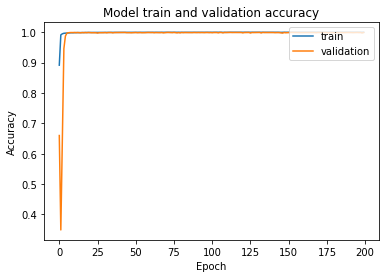

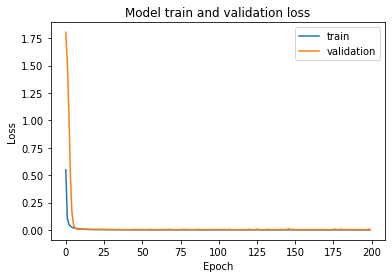


Training Accuracy Array:  [0.8914600610733032, 0.991198718547821, 0.9947446584701538, 0.996468186378479, 0.9969484806060791, 0.9973723292350769, 0.9979798197746277, 0.998022198677063, 0.9983047246932983, 0.9981493353843689, 0.9985731244087219, 0.9985166192054749, 0.9985731244087219, 0.9987002611160278, 0.9987285733222961, 0.9989122152328491, 0.9989263415336609, 0.9991382360458374, 0.9990676045417786, 0.9991947412490845, 0.9992936253547668, 0.9991382360458374, 0.9991947412490845, 0.9991382360458374, 0.9992512464523315, 0.9992088675498962, 0.9992794990539551, 0.9994207620620728, 0.9992936253547668, 0.9992653727531433, 0.9994913935661316, 0.9992936253547668, 0.9993783831596375, 0.9995055198669434, 0.9993077516555786, 0.9994348883628845, 0.9994490146636963, 0.9995196461677551, 0.9993360042572021, 0.999632716178894, 0.9992936253547668, 0.9994631409645081, 0.9994631409645081, 0.9994631409645081, 0.9994913935661316, 0.9996185898780823, 0.9995903372764587, 0.9995620250701904, 0.99966096878051

In [ ]:
fcn_learning_high_SNR = fcn_model()

epochs = 200
batch_size = 1024

history = fcn_learning_high_SNR.fit(X_train, Y_train, epochs=epochs, batch_size=batch_size,  validation_data = (X_validation, Y_validation), shuffle=True, callbacks=[ES])

score = fcn_learning_high_SNR.evaluate(X_test, Y_test, verbose=0)
print('\nEvaluating on Test data : Score of SNR = ' + str(score[1]*100) +'\n')

summarize_model(history)
fcn_learning_high_SNR.save("/gdrive/My Drive/Signal Identification Model FCN/fcnFFTdata_highSNR.tf")

print("\nTraining Accuracy Array: ", history.history['accuracy'])
print("\nValidation Accuracy Array: ", history.history['val_accuracy'])

# Low SNR

In [ ]:
x_data_fft_low_SNR = x_data_fft_data[:,0:10]
y_labels_low_SNR = y_labels_data[:,0:10]

print(x_data_fft_low_SNR.shape)
print(y_labels_low_SNR.shape)

(15, 10, 715, 128, 2)
(15, 10, 715)


In [ ]:
x_dim = x_data_fft_low_SNR.shape
total_num_snapshots = x_dim[0]*x_dim[1]*x_dim[2]
num_snapshots_per_tech = x_dim[1]*x_dim[2]
num_tech = x_dim[0]
num_samples = x_dim[3]
print(num_snapshots_per_tech)

7150


In [ ]:
from sklearn.preprocessing import MinMaxScaler

# Bin wise scalers for FFT data from sklearn
scaler_01 = MinMaxScaler(feature_range=(0,1))

x_data_fft_low_SNR_1d = np.reshape(x_data_fft_low_SNR, (total_num_snapshots, num_samples*x_dim[4]))
fft_data_complex = np.reshape(x_data_fft_low_SNR_1d.flatten()[::2] + 1j*x_data_fft_low_SNR_1d.flatten()[1::2], (total_num_snapshots, num_samples))
x_data_fft_low_SNR_1d = scaler_01.fit_transform(np.absolute(fft_data_complex))

In [ ]:
from keras.utils.np_utils import to_categorical

y_labels_low_SNR = y_labels_low_SNR.flatten()
y_labels_one_hot_low_SNR = to_categorical(y_labels_low_SNR)

In [ ]:
from keras.callbacks import EarlyStopping
ES = EarlyStopping(monitor = 'val_accuracy', mode = 'max', min_delta = 0.00001, patience = 200, verbose = 1)

import logging
logging.disable(logging.WARNING)

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test_valid, Y_train, Y_test_valid = train_test_split(x_data_fft_low_SNR_1d, y_labels_one_hot_low_SNR, test_size=0.4)
X_validation, X_test, Y_validation, Y_test = train_test_split(X_test_valid, Y_test_valid, test_size=0.5)

Epoch 1/200
63/63 [==============================] - 2s 15ms/step - loss: 1.9766 - accuracy: 0.4210 - val_loss: 2.3150 - val_accuracy: 0.5134
Epoch 2/200
63/63 [==============================] - 0s 8ms/step - loss: 0.9821 - accuracy: 0.7159 - val_loss: 2.0843 - val_accuracy: 0.2074
Epoch 3/200
63/63 [==============================] - 0s 8ms/step - loss: 0.8480 - accuracy: 0.7452 - val_loss: 1.9319 - val_accuracy: 0.2021
Epoch 4/200
63/63 [==============================] - 0s 8ms/step - loss: 0.7912 - accuracy: 0.7550 - val_loss: 1.6431 - val_accuracy: 0.3611
Epoch 5/200
63/63 [==============================] - 1s 9ms/step - loss: 0.7646 - accuracy: 0.7594 - val_loss: 1.3380 - val_accuracy: 0.5211
Epoch 6/200
63/63 [==============================] - 0s 8ms/step - loss: 0.7377 - accuracy: 0.7661 - val_loss: 1.0220 - val_accuracy: 0.6642
Epoch 7/200
63/63 [==============================] - 0s 8ms/step - loss: 0.7293 - accuracy: 0.7678 - val_loss: 0.8428 - val_accuracy: 0.7285
Epoch 8/200


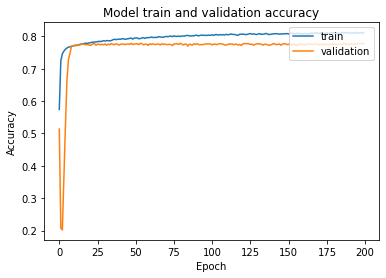

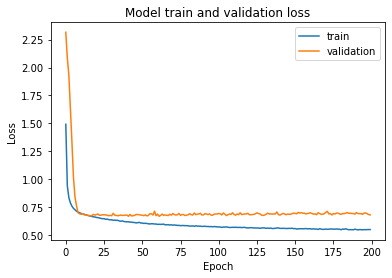


Training Accuracy Array:  [0.5741724967956543, 0.7247397303581238, 0.7459518313407898, 0.7539860010147095, 0.760217547416687, 0.763853907585144, 0.7666822075843811, 0.7674902677536011, 0.7689666152000427, 0.7698368430137634, 0.7717171907424927, 0.7727117538452148, 0.7724164724349976, 0.774514377117157, 0.7760062217712402, 0.7758974432945251, 0.777622401714325, 0.7790986895561218, 0.7775757312774658, 0.7795648574829102, 0.7795338034629822, 0.7814607620239258, 0.781647264957428, 0.7820978760719299, 0.7829370498657227, 0.7830147743225098, 0.7848795652389526, 0.7836984992027283, 0.7851437330245972, 0.786511242389679, 0.7851748466491699, 0.7869153022766113, 0.7864646315574646, 0.7862004637718201, 0.7869153022766113, 0.7893550992012024, 0.7910489439964294, 0.7897436022758484, 0.7906293869018555, 0.7914685606956482, 0.7909091114997864, 0.7925563454627991, 0.7924941778182983, 0.7908779978752136, 0.7917171716690063, 0.792478621006012, 0.7938616871833801, 0.7946076393127441, 0.7914685606956482,

In [ ]:
fcn_learning_low_SNR = fcn_model()

epochs = 200
batch_size = 1024

history = fcn_learning_low_SNR.fit(X_train, Y_train, epochs=epochs, batch_size=batch_size,  validation_data = (X_validation, Y_validation), shuffle=True, callbacks=[ES])

score = fcn_learning_low_SNR.evaluate(X_test, Y_test, verbose=0)
print('\nEvaluating on Test data : Score of SNR  = ' + str(score[1]*100) +'\n')

summarize_model(history)
fcn_learning_low_SNR.save("/gdrive/My Drive/Signal Identification Model FCN/fcnFFTdata_lowSNR.tf")

print("\nTraining Accuracy Array: ", history.history['accuracy'])
print("\nValidation Accuracy Array: ", history.history['val_accuracy'])

# Training each SNR separately and transfer learning 

In [33]:
x_dim = x_data_fft_data.shape
total_num_snapshots = x_dim[0]*x_dim[1]*x_dim[2]
num_snapshots_per_tech = x_dim[1]*x_dim[2]
num_tech = x_dim[0]
num_samples = x_dim[3]
print(num_snapshots_per_tech)

15015


In [34]:
from sklearn.model_selection import train_test_split
from keras import models
from keras.utils.np_utils import to_categorical
import math

X_train_curr = np.zeros((math.floor(0.6*total_num_snapshots/21), num_samples, 2))
X_validation_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_samples, 2))
X_test_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_samples, 2))
Y_train_curr = np.zeros((math.floor(0.6*total_num_snapshots/21), num_tech))
Y_validation_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_tech))
Y_test_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_tech))

X_test_valid_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_samples, 2))
Y_test_valid_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_tech))

In [24]:
print('X_train_curr.shape = ' + str(X_train_curr.shape))
print('X_validation_curr.shape = ' + str(X_validation_curr.shape))
print('X_test_curr.shape = ' + str(X_test_curr.shape))
print('Y_train_curr.shape = ' + str(Y_train_curr.shape))
print('Y_validation_curr.shape = ' + str(Y_validation_curr.shape))
print('Y_test_curr.shape = ' + str(Y_test_curr.shape))

X_train_curr.shape = (6435, 128, 2)
X_validation_curr.shape = (2145, 128, 2)
X_test_curr.shape = (2145, 128, 2)
Y_train_curr.shape = (6435, 15)
Y_validation_curr.shape = (2145, 15)
Y_test_curr.shape = (2145, 15)


In [25]:
from matplotlib import pyplot

def summarize_model(history, i):

  pyplot.plot(history.history['accuracy'])
  pyplot.plot(history.history['val_accuracy']) 
  pyplot.title('Model train and validation accuracy - SNR ' + str(2*i-20))
  pyplot.ylabel('Accuracy')
  pyplot.xlabel('Epoch')
  pyplot.legend(['train', 'validation'], loc='upper right')
  pyplot.show()

  pyplot.plot(history.history['loss'])
  pyplot.plot(history.history['val_loss'])  
  pyplot.title('Model train and validation loss - SNR ' + str(2*i-20))
  pyplot.ylabel('Loss')
  pyplot.xlabel('Epoch')
  pyplot.legend(['train', 'validation'], loc='upper right')
  pyplot.show()

In [35]:
from keras.callbacks import EarlyStopping
ES = EarlyStopping(monitor = 'val_accuracy', mode = 'max', min_delta = 0.001, patience = 60, verbose = 1)

import logging
logging.disable(logging.WARNING)

from keras.utils.np_utils import to_categorical
from sklearn.preprocessing import StandardScaler
scaler_std = StandardScaler()

In [36]:
def Testing(X_test_curr, Y_test_curr, i):
  
  all_snr_model = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/fcnFFTdata_allSNR.tf"))

  score = all_snr_model.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('\nScore of SNR on All SNR model without Transfer Learning ' + str(2*i-20) + ' = ' + str(score[1]*100))

  high_snr_model = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/fcnFFTdata_highSNR.tf"))

  score = high_snr_model.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('Score of SNR on High SNR model without Transfer Learning ' + str(2*i-20) + ' = ' + str(score[1]*100))

  low_snr_model = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/fcnFFTdata_lowSNR.tf"))

  score = low_snr_model.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('Score of SNR on low SNR model without Transfer Learning ' + str(2*i-20) + ' = ' + str(score[1]*100))

In [37]:
def train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i):
  
  print("\nTraining SNR = "+str(2*i-20)+" Data\n")

  lstm_model_cur = fcn_model()
  history = lstm_model_cur.fit(X_train_curr, Y_train_curr, validation_data = (X_validation_curr, Y_validation_curr), epochs=200, batch_size=1024)

  score = lstm_model_cur.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('\nEvaluating on Test data : Score of SNR ' + str(2*i-20) + ' = ' + str(score[1]*100) +'\n')

  summarize_model(history, i)
  lstm_model_cur.save("/gdrive/My Drive/Signal Identification Model FCN/fcnFFTdata_SNR_"+str(2*i-20)+".tf")
  del history, lstm_model_cur

In [38]:
def train_data_on_all_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i):
  
  print("\nTraining SNR = "+str(2*i-20)+" Data on a pre-trained All SNR model\n")

  lstm_model_cur = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/fcnFFTdata_allSNR.tf"))
  lstm_model_cur.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
  history = lstm_model_cur.fit(X_train_curr, Y_train_curr, validation_data = (X_validation_curr, Y_validation_curr), epochs=200, batch_size=1024, callbacks=[ES])

  score = lstm_model_cur.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('\nEvaluating on Test data : Score of SNR ' + str(2*i-20) + ' = ' + str(score[1]*100) +'\n')

  summarize_model(history, i)
  lstm_model_cur.save("/gdrive/My Drive/Signal Identification Model FCN/Transfer Learning/fcnFFTdata_allSNR_to_SNR_"+str(2*i-20)+".tf")
  del history, lstm_model_cur

In [39]:
def train_data_on_high_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i):
  
  print("\nTraining SNR = "+str(2*i-20)+" Data on a pre-trained High SNR model\n")

  lstm_model_cur = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/fcnFFTdata_highSNR.tf"))
  lstm_model_cur.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
  history = lstm_model_cur.fit(X_train_curr, Y_train_curr, validation_data = (X_validation_curr, Y_validation_curr), epochs=200, batch_size=1024, callbacks=[ES])

  score = lstm_model_cur.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('\nEvaluating on Test data : Score of SNR ' + str(2*i-20) + ' = ' + str(score[1]*100) +'\n')

  summarize_model(history, i)
  lstm_model_cur.save("/gdrive/My Drive/Signal Identification Model FCN/Transfer Learning/fcnFFTdata_highSNR_to_SNR_"+str(2*i-20)+".tf")
  del history, lstm_model_cur

In [40]:
def train_data_on_low_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i):
  
  print("\nTraining SNR = "+str(2*i-20)+" Data on a pre-trained Low SNR model\n")

  lstm_model_cur = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/fcnFFTdata_lowSNR.tf"))
  lstm_model_cur.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
  history = lstm_model_cur.fit(X_train_curr, Y_train_curr, validation_data = (X_validation_curr, Y_validation_curr), epochs=200, batch_size=1024, callbacks=[ES])

  score = lstm_model_cur.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('\nEvaluating on Test data : Score of SNR ' + str(2*i-20) + ' = ' + str(score[1]*100) +'\n')

  summarize_model(history, i)
  lstm_model_cur.save("/gdrive/My Drive/Signal Identification Model FCN/Transfer Learning/fcnFFTdata_lowSNR_to_SNR_"+str(2*i-20)+".tf")
  del history, lstm_model_cur

In [41]:
#es 

for i in range(0, 10):

  x_data_mag = np.absolute(x_data_fft_data[:,:,:,:,0] + 1j*x_data_fft_data[:,:,:,:,1]) 
  x_data_fft_curr = np.reshape(x_data_mag[:,i], (x_dim[0]*x_dim[2], x_dim[3]))

  y_data_fft_curr = to_categorical(y_labels_data[:,i].flatten())

  X_train_curr, X_test_valid_curr, Y_train_curr, Y_test_valid_curr = train_test_split(x_data_fft_curr, y_data_fft_curr, test_size=0.4)
  X_validation_curr, X_test_curr, Y_validation_curr, Y_test_curr = train_test_split(X_test_valid_curr, Y_test_valid_curr, test_size=0.5)

  Testing(X_test_curr, Y_test_curr, i)
  train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_all_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_high_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_low_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)

Output hidden; open in https://colab.research.google.com to view.


Score of SNR on All SNR model without Transfer Learning 0 = 97.2960352897644
Score of SNR on High SNR model without Transfer Learning 0 = 92.68065094947815
Score of SNR on low SNR model without Transfer Learning 0 = 97.71561622619629

Training SNR = 0 Data

Epoch 1/200
7/7 [==============================] - 2s 63ms/step - loss: 2.5456 - accuracy: 0.2324 - val_loss: 2.5815 - val_accuracy: 0.6727
Epoch 2/200
7/7 [==============================] - 0s 7ms/step - loss: 1.1130 - accuracy: 0.7516 - val_loss: 2.4786 - val_accuracy: 0.7692
Epoch 3/200
7/7 [==============================] - 0s 7ms/step - loss: 0.7321 - accuracy: 0.8467 - val_loss: 2.4090 - val_accuracy: 0.6606
Epoch 4/200
7/7 [==============================] - 0s 7ms/step - loss: 0.5717 - accuracy: 0.8891 - val_loss: 2.3697 - val_accuracy: 0.2648
Epoch 5/200
7/7 [==============================] - 0s 7ms/step - loss: 0.4776 - accuracy: 0.9217 - val_loss: 2.3492 - val_accuracy: 0.0844
Epoch 6/200
7/7 [============================

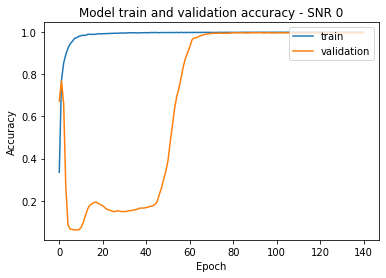

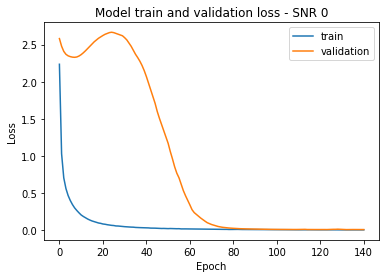


Score of SNR on All SNR model without Transfer Learning 2 = 98.27505946159363
Score of SNR on High SNR model without Transfer Learning 2 = 93.28671097755432
Score of SNR on low SNR model without Transfer Learning 2 = 98.27505946159363

Training SNR = 2 Data

Epoch 1/200
7/7 [==============================] - 2s 61ms/step - loss: 2.6891 - accuracy: 0.1750 - val_loss: 2.5824 - val_accuracy: 0.7883
Epoch 2/200
7/7 [==============================] - 0s 8ms/step - loss: 1.1339 - accuracy: 0.7394 - val_loss: 2.4663 - val_accuracy: 0.8345
Epoch 3/200
7/7 [==============================] - 0s 8ms/step - loss: 0.7157 - accuracy: 0.8316 - val_loss: 2.3864 - val_accuracy: 0.8308
Epoch 4/200
7/7 [==============================] - 0s 7ms/step - loss: 0.5695 - accuracy: 0.8894 - val_loss: 2.3371 - val_accuracy: 0.7753
Epoch 5/200
7/7 [==============================] - 0s 8ms/step - loss: 0.4816 - accuracy: 0.9208 - val_loss: 2.3094 - val_accuracy: 0.5832
Epoch 6/200
7/7 [===========================

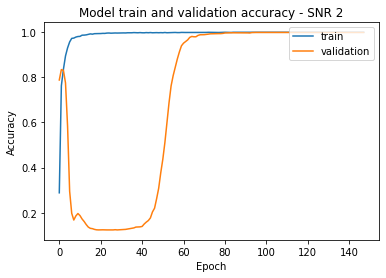

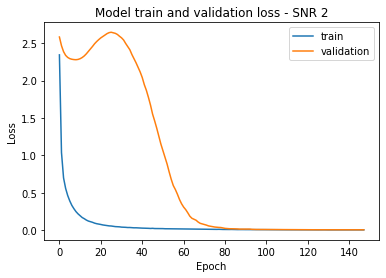


Score of SNR on All SNR model without Transfer Learning 4 = 98.8811194896698
Score of SNR on High SNR model without Transfer Learning 4 = 92.72727370262146
Score of SNR on low SNR model without Transfer Learning 4 = 98.22843670845032

Training SNR = 4 Data

Epoch 1/200
7/7 [==============================] - 2s 65ms/step - loss: 2.7870 - accuracy: 0.1808 - val_loss: 2.5777 - val_accuracy: 0.7259
Epoch 2/200
7/7 [==============================] - 0s 8ms/step - loss: 1.1289 - accuracy: 0.7558 - val_loss: 2.4597 - val_accuracy: 0.7683
Epoch 3/200
7/7 [==============================] - 0s 8ms/step - loss: 0.6813 - accuracy: 0.8854 - val_loss: 2.3822 - val_accuracy: 0.6527
Epoch 4/200
7/7 [==============================] - 0s 10ms/step - loss: 0.5096 - accuracy: 0.9244 - val_loss: 2.3361 - val_accuracy: 0.3529
Epoch 5/200
7/7 [==============================] - 0s 8ms/step - loss: 0.4103 - accuracy: 0.9440 - val_loss: 2.3112 - val_accuracy: 0.1580
Epoch 6/200
7/7 [===========================

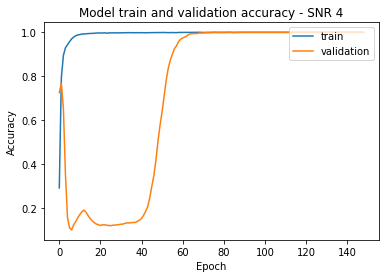

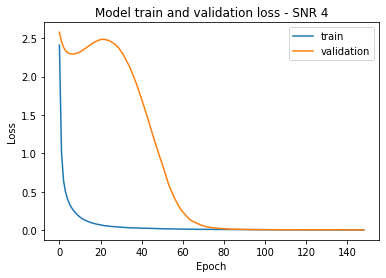


Score of SNR on All SNR model without Transfer Learning 6 = 99.48717951774597
Score of SNR on High SNR model without Transfer Learning 6 = 93.00699234008789
Score of SNR on low SNR model without Transfer Learning 6 = 98.4149158000946

Training SNR = 6 Data

Epoch 1/200
7/7 [==============================] - 2s 64ms/step - loss: 2.4752 - accuracy: 0.2319 - val_loss: 2.5626 - val_accuracy: 0.8401
Epoch 2/200
7/7 [==============================] - 0s 8ms/step - loss: 0.9990 - accuracy: 0.8073 - val_loss: 2.4482 - val_accuracy: 0.8732
Epoch 3/200
7/7 [==============================] - 0s 8ms/step - loss: 0.6303 - accuracy: 0.9176 - val_loss: 2.3720 - val_accuracy: 0.8615
Epoch 4/200
7/7 [==============================] - 0s 8ms/step - loss: 0.4735 - accuracy: 0.9563 - val_loss: 2.3219 - val_accuracy: 0.7198
Epoch 5/200
7/7 [==============================] - 0s 9ms/step - loss: 0.3976 - accuracy: 0.9593 - val_loss: 2.2896 - val_accuracy: 0.4853
Epoch 6/200
7/7 [============================

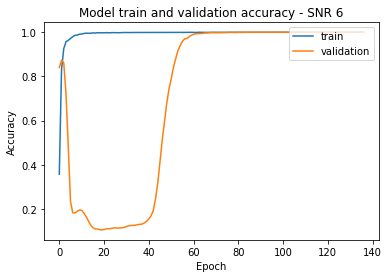

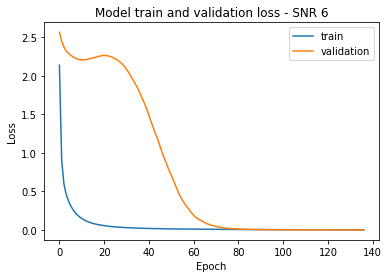


Score of SNR on All SNR model without Transfer Learning 8 = 99.30070042610168
Score of SNR on High SNR model without Transfer Learning 8 = 93.75291466712952
Score of SNR on low SNR model without Transfer Learning 8 = 98.69464039802551

Training SNR = 8 Data

Epoch 1/200
7/7 [==============================] - 1s 62ms/step - loss: 2.5306 - accuracy: 0.2121 - val_loss: 2.5570 - val_accuracy: 0.8084
Epoch 2/200
7/7 [==============================] - 0s 9ms/step - loss: 1.0765 - accuracy: 0.7456 - val_loss: 2.4449 - val_accuracy: 0.8359
Epoch 3/200
7/7 [==============================] - 0s 7ms/step - loss: 0.7033 - accuracy: 0.8505 - val_loss: 2.3772 - val_accuracy: 0.8294
Epoch 4/200
7/7 [==============================] - 0s 8ms/step - loss: 0.5348 - accuracy: 0.9133 - val_loss: 2.3392 - val_accuracy: 0.7776
Epoch 5/200
7/7 [==============================] - 0s 8ms/step - loss: 0.4249 - accuracy: 0.9486 - val_loss: 2.3163 - val_accuracy: 0.5622
Epoch 6/200
7/7 [===========================

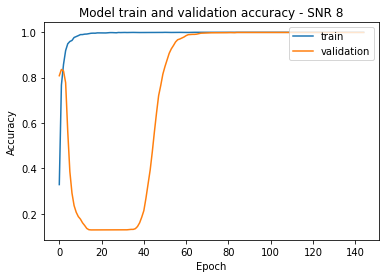

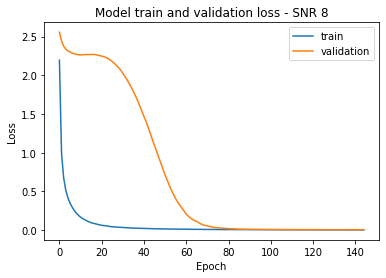


Score of SNR on All SNR model without Transfer Learning 10 = 99.44055676460266
Score of SNR on High SNR model without Transfer Learning 10 = 93.84615421295166
Score of SNR on low SNR model without Transfer Learning 10 = 98.92773628234863

Training SNR = 10 Data

Epoch 1/200
7/7 [==============================] - 2s 63ms/step - loss: 2.6027 - accuracy: 0.1912 - val_loss: 2.5643 - val_accuracy: 0.7282
Epoch 2/200
7/7 [==============================] - 0s 9ms/step - loss: 1.0354 - accuracy: 0.7959 - val_loss: 2.4469 - val_accuracy: 0.8093
Epoch 3/200
7/7 [==============================] - 0s 8ms/step - loss: 0.6176 - accuracy: 0.9176 - val_loss: 2.3648 - val_accuracy: 0.8163
Epoch 4/200
7/7 [==============================] - 0s 8ms/step - loss: 0.4605 - accuracy: 0.9420 - val_loss: 2.3112 - val_accuracy: 0.6033
Epoch 5/200
7/7 [==============================] - 0s 8ms/step - loss: 0.3598 - accuracy: 0.9652 - val_loss: 2.2765 - val_accuracy: 0.4084
Epoch 6/200
7/7 [=======================

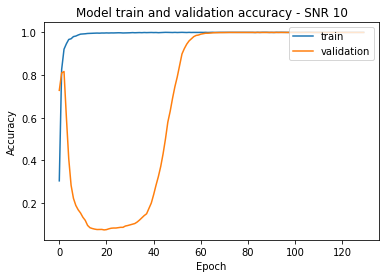

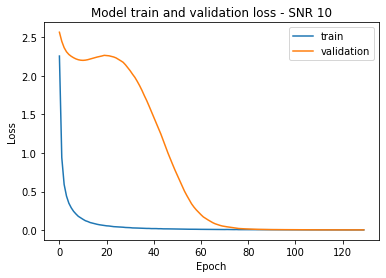


Score of SNR on All SNR model without Transfer Learning 12 = 99.44055676460266
Score of SNR on High SNR model without Transfer Learning 12 = 92.7738904953003
Score of SNR on low SNR model without Transfer Learning 12 = 98.50816130638123

Training SNR = 12 Data

Epoch 1/200
7/7 [==============================] - 1s 63ms/step - loss: 2.4138 - accuracy: 0.2450 - val_loss: 2.5500 - val_accuracy: 0.8261
Epoch 2/200
7/7 [==============================] - 0s 8ms/step - loss: 0.9831 - accuracy: 0.7975 - val_loss: 2.4426 - val_accuracy: 0.8513
Epoch 3/200
7/7 [==============================] - 0s 8ms/step - loss: 0.6292 - accuracy: 0.8862 - val_loss: 2.3709 - val_accuracy: 0.8364
Epoch 4/200
7/7 [==============================] - 0s 10ms/step - loss: 0.4782 - accuracy: 0.9290 - val_loss: 2.3253 - val_accuracy: 0.6667
Epoch 5/200
7/7 [==============================] - 0s 8ms/step - loss: 0.3908 - accuracy: 0.9507 - val_loss: 2.2958 - val_accuracy: 0.5077
Epoch 6/200
7/7 [=======================

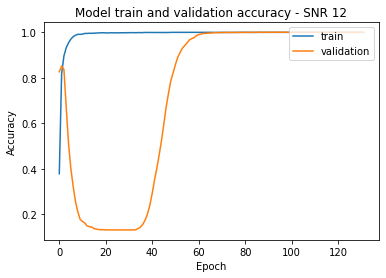

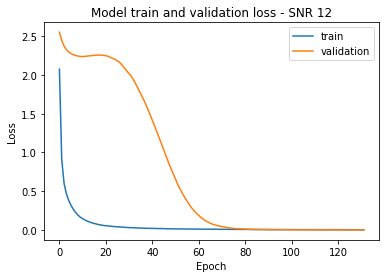


Score of SNR on All SNR model without Transfer Learning 14 = 99.34731721878052
Score of SNR on High SNR model without Transfer Learning 14 = 93.42657327651978
Score of SNR on low SNR model without Transfer Learning 14 = 98.50816130638123

Training SNR = 14 Data

Epoch 1/200
7/7 [==============================] - 1s 60ms/step - loss: 2.3399 - accuracy: 0.2884 - val_loss: 2.5477 - val_accuracy: 0.7371
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 0.9681 - accuracy: 0.7929 - val_loss: 2.4356 - val_accuracy: 0.8191
Epoch 3/200
7/7 [==============================] - 0s 9ms/step - loss: 0.5916 - accuracy: 0.8966 - val_loss: 2.3558 - val_accuracy: 0.8247
Epoch 4/200
7/7 [==============================] - 0s 10ms/step - loss: 0.4328 - accuracy: 0.9364 - val_loss: 2.2975 - val_accuracy: 0.7995
Epoch 5/200
7/7 [==============================] - 0s 9ms/step - loss: 0.3468 - accuracy: 0.9612 - val_loss: 2.2544 - val_accuracy: 0.7156
Epoch 6/200
7/7 [=====================

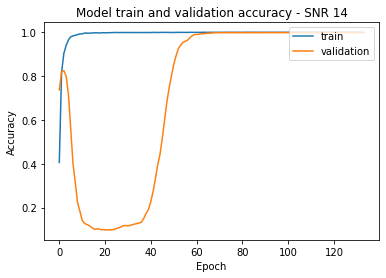

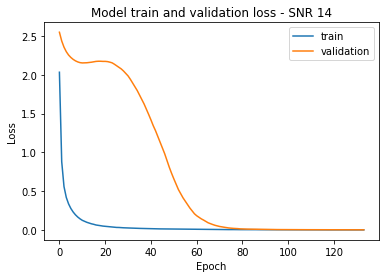


Score of SNR on All SNR model without Transfer Learning 16 = 99.7668981552124
Score of SNR on High SNR model without Transfer Learning 16 = 93.8927710056305
Score of SNR on low SNR model without Transfer Learning 16 = 98.74125719070435

Training SNR = 16 Data

Epoch 1/200
7/7 [==============================] - 2s 63ms/step - loss: 2.2647 - accuracy: 0.3118 - val_loss: 2.5371 - val_accuracy: 0.7678
Epoch 2/200
7/7 [==============================] - 0s 8ms/step - loss: 0.8785 - accuracy: 0.8509 - val_loss: 2.4208 - val_accuracy: 0.8033
Epoch 3/200
7/7 [==============================] - 0s 8ms/step - loss: 0.5472 - accuracy: 0.9185 - val_loss: 2.3448 - val_accuracy: 0.7403
Epoch 4/200
7/7 [==============================] - 0s 9ms/step - loss: 0.4096 - accuracy: 0.9501 - val_loss: 2.2947 - val_accuracy: 0.5613
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 0.3250 - accuracy: 0.9673 - val_loss: 2.2585 - val_accuracy: 0.3972
Epoch 6/200
7/7 [========================

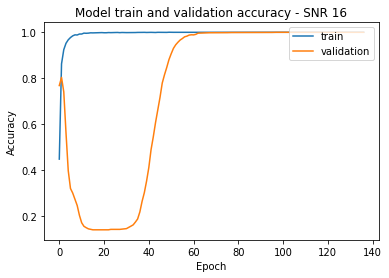

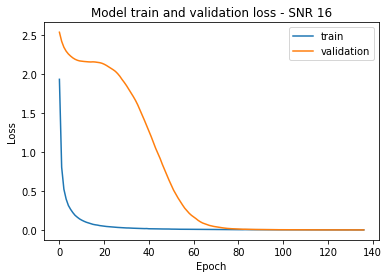


Score of SNR on All SNR model without Transfer Learning 18 = 99.86013770103455
Score of SNR on High SNR model without Transfer Learning 18 = 93.00699234008789
Score of SNR on low SNR model without Transfer Learning 18 = 98.6480176448822

Training SNR = 18 Data

Epoch 1/200
7/7 [==============================] - 2s 64ms/step - loss: 2.5184 - accuracy: 0.2325 - val_loss: 2.5476 - val_accuracy: 0.7865
Epoch 2/200
7/7 [==============================] - 0s 9ms/step - loss: 0.9422 - accuracy: 0.8300 - val_loss: 2.4251 - val_accuracy: 0.8317
Epoch 3/200
7/7 [==============================] - 0s 9ms/step - loss: 0.5730 - accuracy: 0.9116 - val_loss: 2.3398 - val_accuracy: 0.8149
Epoch 4/200
7/7 [==============================] - 0s 9ms/step - loss: 0.4122 - accuracy: 0.9425 - val_loss: 2.2831 - val_accuracy: 0.7221
Epoch 5/200
7/7 [==============================] - 0s 9ms/step - loss: 0.3309 - accuracy: 0.9597 - val_loss: 2.2432 - val_accuracy: 0.5441
Epoch 6/200
7/7 [========================

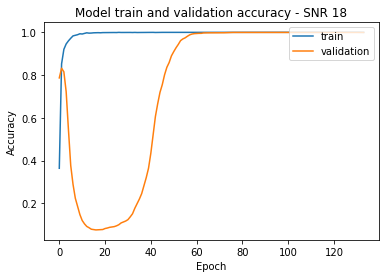

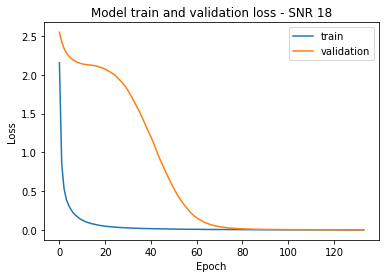


Score of SNR on All SNR model without Transfer Learning 20 = 99.20746088027954
Score of SNR on High SNR model without Transfer Learning 20 = 92.7738904953003
Score of SNR on low SNR model without Transfer Learning 20 = 98.46153855323792

Training SNR = 20 Data

Epoch 1/200
7/7 [==============================] - 2s 65ms/step - loss: 2.3102 - accuracy: 0.2950 - val_loss: 2.5353 - val_accuracy: 0.8545
Epoch 2/200
7/7 [==============================] - 0s 9ms/step - loss: 0.8984 - accuracy: 0.8150 - val_loss: 2.4282 - val_accuracy: 0.8298
Epoch 3/200
7/7 [==============================] - 0s 8ms/step - loss: 0.5785 - accuracy: 0.8889 - val_loss: 2.3606 - val_accuracy: 0.7967
Epoch 4/200
7/7 [==============================] - 0s 8ms/step - loss: 0.4237 - accuracy: 0.9332 - val_loss: 2.3167 - val_accuracy: 0.6881
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 0.3536 - accuracy: 0.9463 - val_loss: 2.2852 - val_accuracy: 0.5548
Epoch 6/200
7/7 [=======================

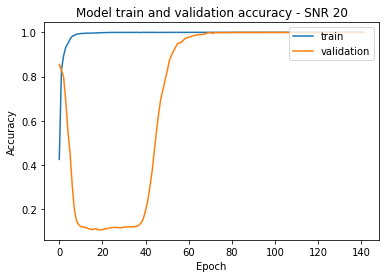

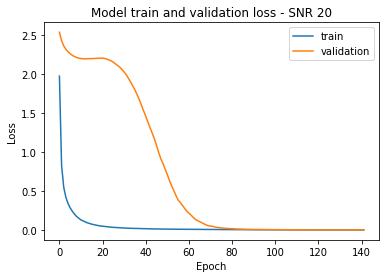

In [ ]:
#es 

for i in range(10, 21):

  x_data_mag = np.absolute(x_data_fft_data[:,:,:,:,0] + 1j*x_data_fft_data[:,:,:,:,1]) 
  x_data_fft_curr = np.reshape(x_data_mag[:,i], (x_dim[0]*x_dim[2], x_dim[3]))

  y_data_fft_curr = to_categorical(y_labels_data[:,i].flatten())

  X_train_curr, X_test_valid_curr, Y_train_curr, Y_test_valid_curr = train_test_split(x_data_fft_curr, y_data_fft_curr, test_size=0.4)
  X_validation_curr, X_test_curr, Y_validation_curr, Y_test_curr = train_test_split(X_test_valid_curr, Y_test_valid_curr, test_size=0.5)

  Testing(X_test_curr, Y_test_curr, i)
  train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)


Score of SNR on All SNR model without Transfer Learning -20 = 42.61072278022766
Score of SNR on High SNR model without Transfer Learning -20 = 5.3613051772117615
Score of SNR on low SNR model without Transfer Learning -20 = 33.473193645477295

Training SNR = -20 Data

Epoch 1/200
7/7 [==============================] - 2s 82ms/step - loss: 3.0059 - accuracy: 0.0788 - val_loss: 2.6932 - val_accuracy: 0.1035
Epoch 2/200
7/7 [==============================] - 0s 12ms/step - loss: 2.7544 - accuracy: 0.1217 - val_loss: 2.6707 - val_accuracy: 0.1464
Epoch 3/200
7/7 [==============================] - 0s 10ms/step - loss: 2.5757 - accuracy: 0.1705 - val_loss: 2.6518 - val_accuracy: 0.1832
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 2.4522 - accuracy: 0.2166 - val_loss: 2.6345 - val_accuracy: 0.2149
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 2.3595 - accuracy: 0.2546 - val_loss: 2.6179 - val_accuracy: 0.2396
Epoch 6/200
7/7 [=============

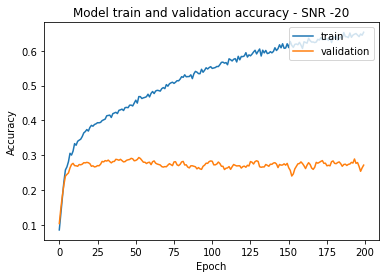

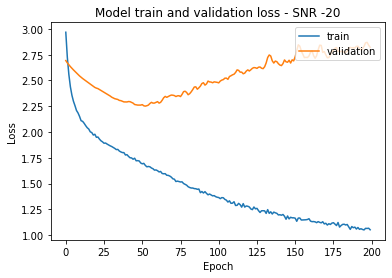


Training SNR = -20 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 2s 87ms/step - loss: 6.1705 - accuracy: 0.4017 - val_loss: 4.3974 - val_accuracy: 0.4797
Epoch 2/200
7/7 [==============================] - 0s 18ms/step - loss: 4.6449 - accuracy: 0.4588 - val_loss: 4.3624 - val_accuracy: 0.4406
Epoch 3/200
7/7 [==============================] - 0s 19ms/step - loss: 3.9042 - accuracy: 0.4966 - val_loss: 4.6342 - val_accuracy: 0.3907
Epoch 4/200
7/7 [==============================] - 0s 19ms/step - loss: 3.5565 - accuracy: 0.5124 - val_loss: 4.5031 - val_accuracy: 0.3902
Epoch 5/200
7/7 [==============================] - 0s 20ms/step - loss: 3.2698 - accuracy: 0.5214 - val_loss: 4.4881 - val_accuracy: 0.3776
Epoch 6/200
7/7 [==============================] - 0s 19ms/step - loss: 3.0760 - accuracy: 0.5157 - val_loss: 4.2095 - val_accuracy: 0.3869
Epoch 7/200
7/7 [==============================] - 0s 20ms/step - loss: 2.8602 - accuracy: 0.5335 - val

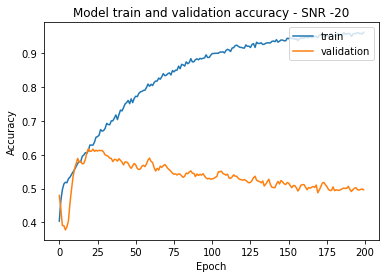

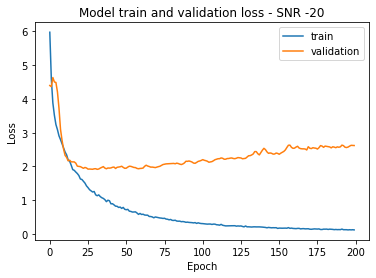


Training SNR = -20 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 2s 80ms/step - loss: 11.6005 - accuracy: 0.2111 - val_loss: 81.1447 - val_accuracy: 0.0657
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 10.7949 - accuracy: 0.2222 - val_loss: 70.2589 - val_accuracy: 0.0657
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 9.8858 - accuracy: 0.2289 - val_loss: 61.0470 - val_accuracy: 0.0657
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 9.3504 - accuracy: 0.2457 - val_loss: 53.7288 - val_accuracy: 0.0657
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 8.7057 - accuracy: 0.2492 - val_loss: 47.3638 - val_accuracy: 0.0662
Epoch 6/200
7/7 [==============================] - 0s 11ms/step - loss: 8.1711 - accuracy: 0.2562 - val_loss: 40.5969 - val_accuracy: 0.0671
Epoch 7/200
7/7 [==============================] - 0s 12ms/step - loss: 7.5670 - accuracy: 0.2

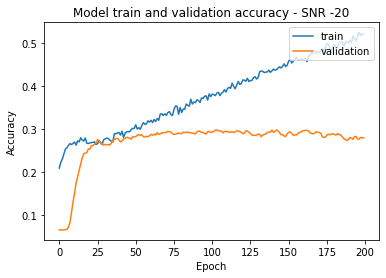

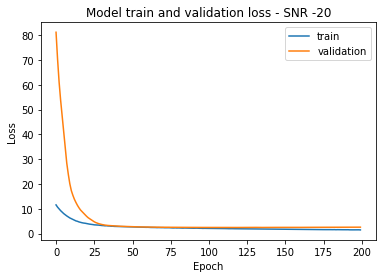


Training SNR = -20 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 2s 87ms/step - loss: 4.1556 - accuracy: 0.3116 - val_loss: 2.8125 - val_accuracy: 0.3431
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 3.7487 - accuracy: 0.3241 - val_loss: 2.6511 - val_accuracy: 0.3487
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 3.5589 - accuracy: 0.3360 - val_loss: 2.4979 - val_accuracy: 0.3524
Epoch 4/200
7/7 [==============================] - 0s 13ms/step - loss: 3.3594 - accuracy: 0.3446 - val_loss: 2.3571 - val_accuracy: 0.3566
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 3.1400 - accuracy: 0.3579 - val_loss: 2.2479 - val_accuracy: 0.3636
Epoch 6/200
7/7 [==============================] - 0s 13ms/step - loss: 3.0600 - accuracy: 0.3601 - val_loss: 2.1673 - val_accuracy: 0.3711
Epoch 7/200
7/7 [==============================] - 0s 13ms/step - loss: 2.9037 - accuracy: 0.3634 - val

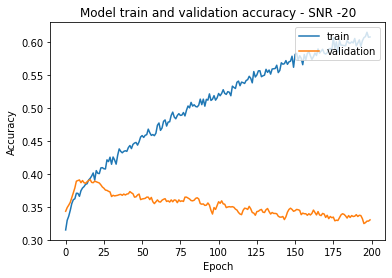

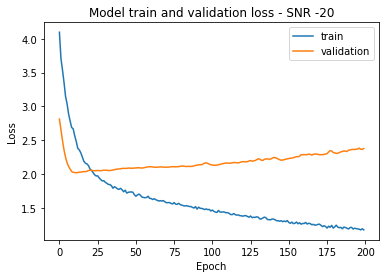


Score of SNR on All SNR model without Transfer Learning -18 = 49.83682930469513
Score of SNR on High SNR model without Transfer Learning -18 = 7.086247205734253
Score of SNR on low SNR model without Transfer Learning -18 = 41.49184226989746

Training SNR = -18 Data

Epoch 1/200
7/7 [==============================] - 2s 81ms/step - loss: 2.9729 - accuracy: 0.0809 - val_loss: 2.6743 - val_accuracy: 0.1305
Epoch 2/200
7/7 [==============================] - 0s 13ms/step - loss: 2.5828 - accuracy: 0.1692 - val_loss: 2.6451 - val_accuracy: 0.1706
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 2.3050 - accuracy: 0.2778 - val_loss: 2.6207 - val_accuracy: 0.2023
Epoch 4/200
7/7 [==============================] - 0s 14ms/step - loss: 2.1550 - accuracy: 0.3350 - val_loss: 2.5975 - val_accuracy: 0.2322
Epoch 5/200
7/7 [==============================] - 0s 12ms/step - loss: 2.0245 - accuracy: 0.3781 - val_loss: 2.5757 - val_accuracy: 0.2434
Epoch 6/200
7/7 [===============

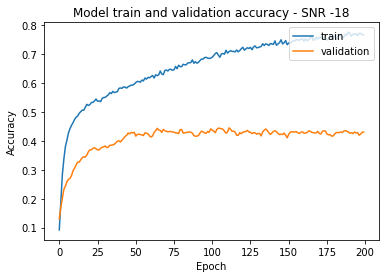

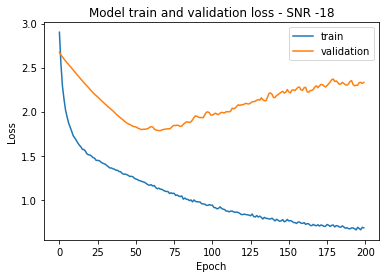


Training SNR = -18 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 3s 91ms/step - loss: 4.4467 - accuracy: 0.5249 - val_loss: 3.9821 - val_accuracy: 0.5245
Epoch 2/200
7/7 [==============================] - 0s 20ms/step - loss: 3.5389 - accuracy: 0.5797 - val_loss: 5.2292 - val_accuracy: 0.4331
Epoch 3/200
7/7 [==============================] - 0s 19ms/step - loss: 2.8685 - accuracy: 0.6047 - val_loss: 6.1188 - val_accuracy: 0.3622
Epoch 4/200
7/7 [==============================] - 0s 19ms/step - loss: 2.6057 - accuracy: 0.6157 - val_loss: 6.2559 - val_accuracy: 0.3310
Epoch 5/200
7/7 [==============================] - 0s 19ms/step - loss: 2.4277 - accuracy: 0.6132 - val_loss: 5.9677 - val_accuracy: 0.3380
Epoch 6/200
7/7 [==============================] - 0s 21ms/step - loss: 2.2466 - accuracy: 0.6321 - val_loss: 5.5828 - val_accuracy: 0.3510
Epoch 7/200
7/7 [==============================] - 0s 20ms/step - loss: 2.0979 - accuracy: 0.6418 - val

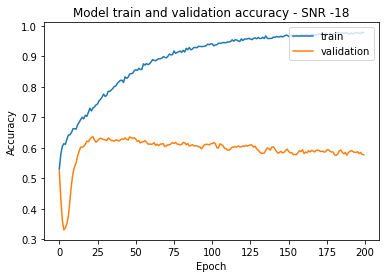

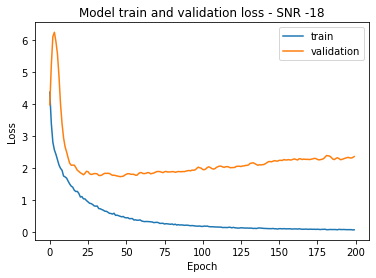


Training SNR = -18 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 2s 84ms/step - loss: 9.0672 - accuracy: 0.3158 - val_loss: 56.4018 - val_accuracy: 0.0695
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 8.4590 - accuracy: 0.3288 - val_loss: 47.6103 - val_accuracy: 0.0709
Epoch 3/200
7/7 [==============================] - 0s 13ms/step - loss: 7.9115 - accuracy: 0.3397 - val_loss: 39.6250 - val_accuracy: 0.0737
Epoch 4/200
7/7 [==============================] - 0s 12ms/step - loss: 7.2393 - accuracy: 0.3698 - val_loss: 33.3418 - val_accuracy: 0.0793
Epoch 5/200
7/7 [==============================] - 0s 13ms/step - loss: 6.6803 - accuracy: 0.3797 - val_loss: 27.9402 - val_accuracy: 0.0960
Epoch 6/200
7/7 [==============================] - 0s 13ms/step - loss: 6.2617 - accuracy: 0.3860 - val_loss: 23.4032 - val_accuracy: 0.1170
Epoch 7/200
7/7 [==============================] - 0s 14ms/step - loss: 5.8911 - accuracy: 0.394

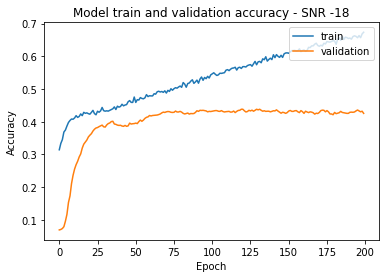

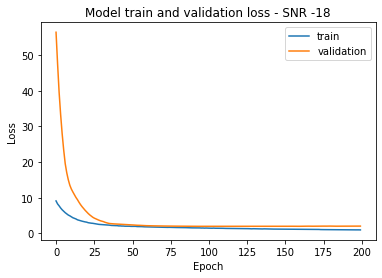


Training SNR = -18 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 2s 80ms/step - loss: 2.7151 - accuracy: 0.4629 - val_loss: 2.2919 - val_accuracy: 0.4448
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 2.5224 - accuracy: 0.4784 - val_loss: 2.2219 - val_accuracy: 0.4555
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 2.3317 - accuracy: 0.4927 - val_loss: 2.1679 - val_accuracy: 0.4536
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 2.1963 - accuracy: 0.4996 - val_loss: 2.1037 - val_accuracy: 0.4555
Epoch 5/200
7/7 [==============================] - 0s 13ms/step - loss: 2.0819 - accuracy: 0.5114 - val_loss: 2.0343 - val_accuracy: 0.4573
Epoch 6/200
7/7 [==============================] - 0s 12ms/step - loss: 2.0290 - accuracy: 0.5021 - val_loss: 1.9955 - val_accuracy: 0.4569
Epoch 7/200
7/7 [==============================] - 0s 14ms/step - loss: 1.9206 - accuracy: 0.5203 - val

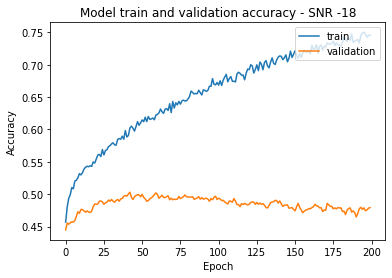

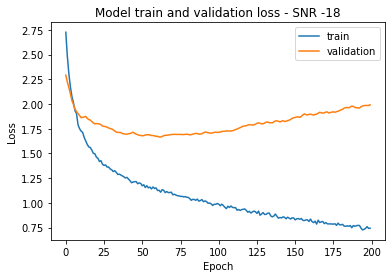


Score of SNR on All SNR model without Transfer Learning -16 = 58.55478048324585
Score of SNR on High SNR model without Transfer Learning -16 = 7.0396266877651215
Score of SNR on low SNR model without Transfer Learning -16 = 54.172492027282715

Training SNR = -16 Data

Epoch 1/200
7/7 [==============================] - 2s 80ms/step - loss: 2.9107 - accuracy: 0.0936 - val_loss: 2.6547 - val_accuracy: 0.1054
Epoch 2/200
7/7 [==============================] - 0s 13ms/step - loss: 2.3450 - accuracy: 0.2711 - val_loss: 2.6020 - val_accuracy: 0.2172
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 1.9991 - accuracy: 0.3995 - val_loss: 2.5504 - val_accuracy: 0.3455
Epoch 4/200
7/7 [==============================] - 0s 12ms/step - loss: 1.7617 - accuracy: 0.4921 - val_loss: 2.5013 - val_accuracy: 0.4075
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 1.6237 - accuracy: 0.5221 - val_loss: 2.4568 - val_accuracy: 0.4149
Epoch 6/200
7/7 [=============

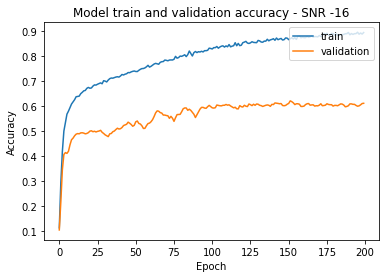

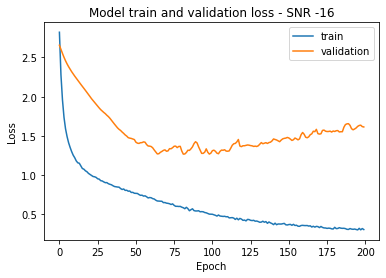


Training SNR = -16 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 2s 89ms/step - loss: 2.7676 - accuracy: 0.6686 - val_loss: 3.3984 - val_accuracy: 0.5837
Epoch 2/200
7/7 [==============================] - 0s 22ms/step - loss: 1.9630 - accuracy: 0.7120 - val_loss: 4.6647 - val_accuracy: 0.5203
Epoch 3/200
7/7 [==============================] - 0s 20ms/step - loss: 1.6324 - accuracy: 0.7422 - val_loss: 5.1080 - val_accuracy: 0.4974
Epoch 4/200
7/7 [==============================] - 0s 22ms/step - loss: 1.4791 - accuracy: 0.7475 - val_loss: 5.2371 - val_accuracy: 0.4872
Epoch 5/200
7/7 [==============================] - 0s 21ms/step - loss: 1.3838 - accuracy: 0.7520 - val_loss: 4.7705 - val_accuracy: 0.5068
Epoch 6/200
7/7 [==============================] - 0s 21ms/step - loss: 1.2419 - accuracy: 0.7612 - val_loss: 4.2244 - val_accuracy: 0.5343
Epoch 7/200
7/7 [==============================] - 0s 21ms/step - loss: 1.1292 - accuracy: 0.7692 - val

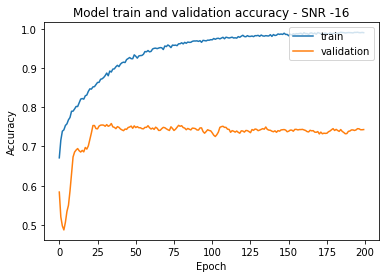

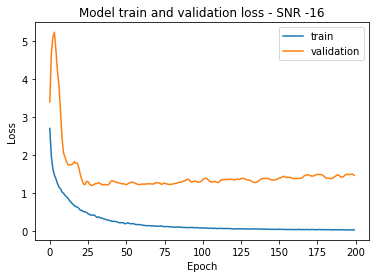


Training SNR = -16 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 2s 80ms/step - loss: 6.7501 - accuracy: 0.4551 - val_loss: 39.1987 - val_accuracy: 0.0685
Epoch 2/200
7/7 [==============================] - 0s 13ms/step - loss: 5.9685 - accuracy: 0.4869 - val_loss: 31.1556 - val_accuracy: 0.0741
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 5.4376 - accuracy: 0.5073 - val_loss: 25.0447 - val_accuracy: 0.0918
Epoch 4/200
7/7 [==============================] - 0s 14ms/step - loss: 5.0002 - accuracy: 0.5255 - val_loss: 20.2226 - val_accuracy: 0.1324
Epoch 5/200
7/7 [==============================] - 0s 14ms/step - loss: 4.7449 - accuracy: 0.5287 - val_loss: 16.7415 - val_accuracy: 0.1837
Epoch 6/200
7/7 [==============================] - 0s 12ms/step - loss: 4.2430 - accuracy: 0.5537 - val_loss: 13.9008 - val_accuracy: 0.2517
Epoch 7/200
7/7 [==============================] - 0s 12ms/step - loss: 4.0955 - accuracy: 0.551

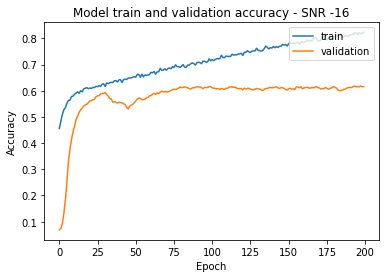

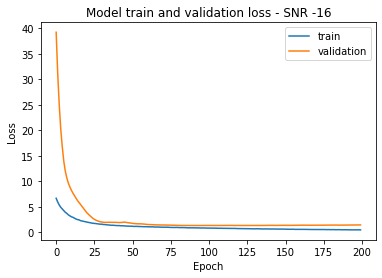


Training SNR = -16 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 2s 81ms/step - loss: 1.4988 - accuracy: 0.6239 - val_loss: 1.6921 - val_accuracy: 0.5641
Epoch 2/200
7/7 [==============================] - 0s 13ms/step - loss: 1.3435 - accuracy: 0.6431 - val_loss: 1.6797 - val_accuracy: 0.5692
Epoch 3/200
7/7 [==============================] - 0s 14ms/step - loss: 1.2277 - accuracy: 0.6536 - val_loss: 1.6562 - val_accuracy: 0.5697
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 1.1879 - accuracy: 0.6624 - val_loss: 1.5997 - val_accuracy: 0.5776
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 1.1474 - accuracy: 0.6692 - val_loss: 1.5573 - val_accuracy: 0.5772
Epoch 6/200
7/7 [==============================] - 0s 12ms/step - loss: 1.1373 - accuracy: 0.6603 - val_loss: 1.5310 - val_accuracy: 0.5865
Epoch 7/200
7/7 [==============================] - 0s 12ms/step - loss: 1.0350 - accuracy: 0.6840 - val

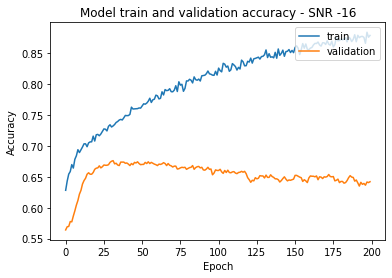

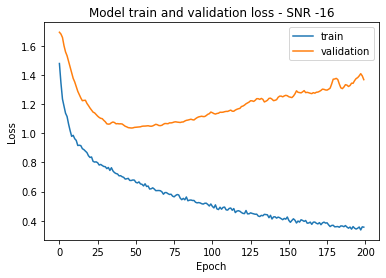


Score of SNR on All SNR model without Transfer Learning -14 = 66.4801836013794
Score of SNR on High SNR model without Transfer Learning -14 = 6.247086077928543
Score of SNR on low SNR model without Transfer Learning -14 = 64.66200351715088

Training SNR = -14 Data

Epoch 1/200
7/7 [==============================] - 2s 81ms/step - loss: 2.8781 - accuracy: 0.1108 - val_loss: 2.6474 - val_accuracy: 0.1697
Epoch 2/200
7/7 [==============================] - 0s 13ms/step - loss: 2.1066 - accuracy: 0.3598 - val_loss: 2.5837 - val_accuracy: 0.3720
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 1.6703 - accuracy: 0.5351 - val_loss: 2.5259 - val_accuracy: 0.4284
Epoch 4/200
7/7 [==============================] - 0s 15ms/step - loss: 1.4135 - accuracy: 0.6160 - val_loss: 2.4740 - val_accuracy: 0.4592
Epoch 5/200
7/7 [==============================] - 0s 12ms/step - loss: 1.2522 - accuracy: 0.6600 - val_loss: 2.4291 - val_accuracy: 0.4779
Epoch 6/200
7/7 [================

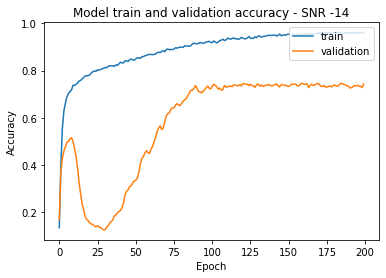

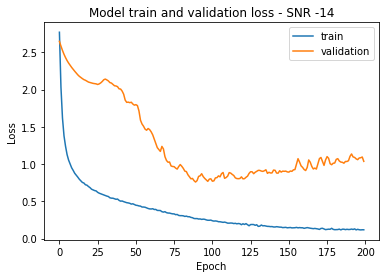


Training SNR = -14 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 2s 90ms/step - loss: 1.7592 - accuracy: 0.7695 - val_loss: 2.3674 - val_accuracy: 0.6825
Epoch 2/200
7/7 [==============================] - 0s 21ms/step - loss: 1.1548 - accuracy: 0.8104 - val_loss: 3.2757 - val_accuracy: 0.6569
Epoch 3/200
7/7 [==============================] - 0s 20ms/step - loss: 0.8958 - accuracy: 0.8355 - val_loss: 3.4933 - val_accuracy: 0.6443
Epoch 4/200
7/7 [==============================] - 0s 22ms/step - loss: 0.8339 - accuracy: 0.8382 - val_loss: 3.2432 - val_accuracy: 0.6490
Epoch 5/200
7/7 [==============================] - 0s 20ms/step - loss: 0.6663 - accuracy: 0.8549 - val_loss: 3.0383 - val_accuracy: 0.6550
Epoch 6/200
7/7 [==============================] - 0s 20ms/step - loss: 0.6530 - accuracy: 0.8565 - val_loss: 2.6556 - val_accuracy: 0.6695
Epoch 7/200
7/7 [==============================] - 0s 19ms/step - loss: 0.5605 - accuracy: 0.8683 - val

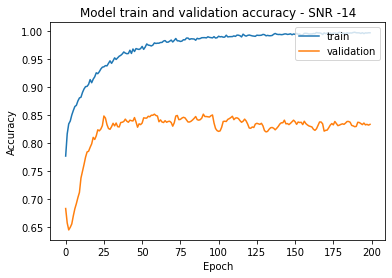

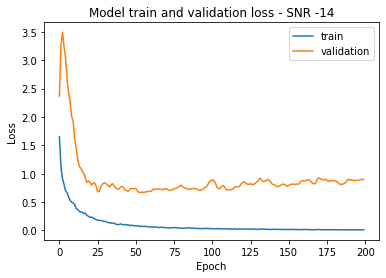


Training SNR = -14 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 2s 84ms/step - loss: 4.7680 - accuracy: 0.5969 - val_loss: 24.5849 - val_accuracy: 0.0779
Epoch 2/200
7/7 [==============================] - 0s 12ms/step - loss: 4.1736 - accuracy: 0.6221 - val_loss: 19.1910 - val_accuracy: 0.1096
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 3.7850 - accuracy: 0.6398 - val_loss: 14.8938 - val_accuracy: 0.1790
Epoch 4/200
7/7 [==============================] - 0s 12ms/step - loss: 3.3051 - accuracy: 0.6681 - val_loss: 12.1832 - val_accuracy: 0.2490
Epoch 5/200
7/7 [==============================] - 0s 12ms/step - loss: 2.9971 - accuracy: 0.6795 - val_loss: 10.1194 - val_accuracy: 0.3245
Epoch 6/200
7/7 [==============================] - 0s 14ms/step - loss: 2.6562 - accuracy: 0.6967 - val_loss: 8.5481 - val_accuracy: 0.4033
Epoch 7/200
7/7 [==============================] - 0s 11ms/step - loss: 2.5259 - accuracy: 0.6953

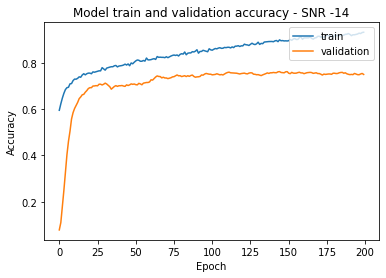

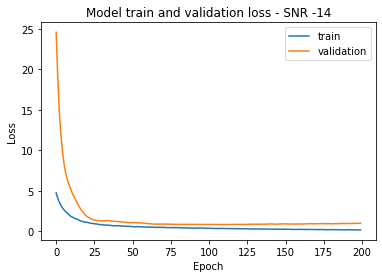


Training SNR = -14 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 2s 87ms/step - loss: 0.8129 - accuracy: 0.7504 - val_loss: 1.2287 - val_accuracy: 0.6615
Epoch 2/200
7/7 [==============================] - 0s 14ms/step - loss: 0.6943 - accuracy: 0.7686 - val_loss: 1.1930 - val_accuracy: 0.6695
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 0.6488 - accuracy: 0.7812 - val_loss: 1.1192 - val_accuracy: 0.6816
Epoch 4/200
7/7 [==============================] - 0s 12ms/step - loss: 0.6381 - accuracy: 0.7791 - val_loss: 1.0477 - val_accuracy: 0.6909
Epoch 5/200
7/7 [==============================] - 0s 12ms/step - loss: 0.5712 - accuracy: 0.7977 - val_loss: 0.9835 - val_accuracy: 0.7012
Epoch 6/200
7/7 [==============================] - 0s 12ms/step - loss: 0.5587 - accuracy: 0.7969 - val_loss: 0.9272 - val_accuracy: 0.7096
Epoch 7/200
7/7 [==============================] - 0s 12ms/step - loss: 0.5461 - accuracy: 0.7979 - val

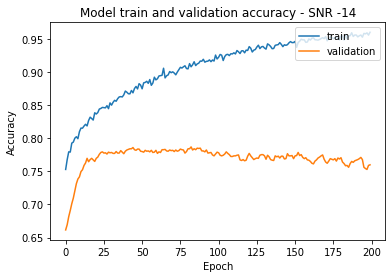

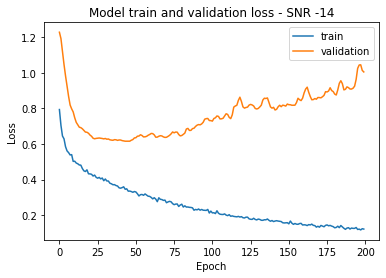


Score of SNR on All SNR model without Transfer Learning -12 = 72.96037077903748
Score of SNR on High SNR model without Transfer Learning -12 = 10.582750290632248
Score of SNR on low SNR model without Transfer Learning -12 = 71.74825072288513

Training SNR = -12 Data

Epoch 1/200
7/7 [==============================] - 2s 83ms/step - loss: 2.9604 - accuracy: 0.1050 - val_loss: 2.6425 - val_accuracy: 0.1688
Epoch 2/200
7/7 [==============================] - 0s 14ms/step - loss: 1.9307 - accuracy: 0.4119 - val_loss: 2.5691 - val_accuracy: 0.3021
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 1.4048 - accuracy: 0.6286 - val_loss: 2.5019 - val_accuracy: 0.4177
Epoch 4/200
7/7 [==============================] - 0s 13ms/step - loss: 1.1352 - accuracy: 0.7029 - val_loss: 2.4446 - val_accuracy: 0.4597
Epoch 5/200
7/7 [==============================] - 0s 12ms/step - loss: 0.9898 - accuracy: 0.7316 - val_loss: 2.3983 - val_accuracy: 0.4392
Epoch 6/200
7/7 [==============

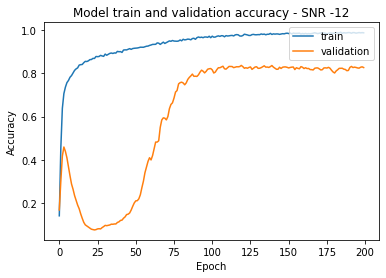

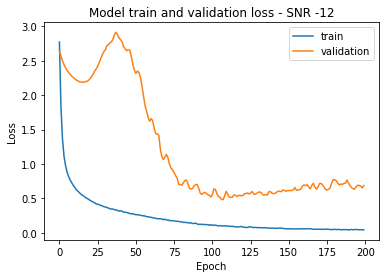


Training SNR = -12 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 2s 97ms/step - loss: 0.9121 - accuracy: 0.8488 - val_loss: 2.3902 - val_accuracy: 0.7091
Epoch 2/200
7/7 [==============================] - 0s 21ms/step - loss: 0.5964 - accuracy: 0.8833 - val_loss: 3.8209 - val_accuracy: 0.6662
Epoch 3/200
7/7 [==============================] - 0s 20ms/step - loss: 0.4607 - accuracy: 0.9017 - val_loss: 4.7785 - val_accuracy: 0.6177
Epoch 4/200
7/7 [==============================] - 0s 21ms/step - loss: 0.3865 - accuracy: 0.9050 - val_loss: 5.0233 - val_accuracy: 0.6084
Epoch 5/200
7/7 [==============================] - 0s 19ms/step - loss: 0.3322 - accuracy: 0.9133 - val_loss: 4.9364 - val_accuracy: 0.6182
Epoch 6/200
7/7 [==============================] - 0s 22ms/step - loss: 0.2781 - accuracy: 0.9246 - val_loss: 4.2418 - val_accuracy: 0.6522
Epoch 7/200
7/7 [==============================] - 0s 20ms/step - loss: 0.2363 - accuracy: 0.9354 - val

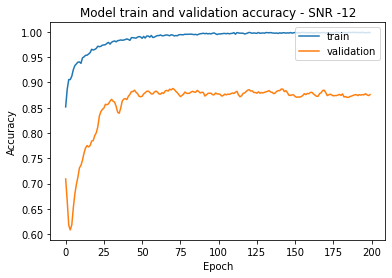

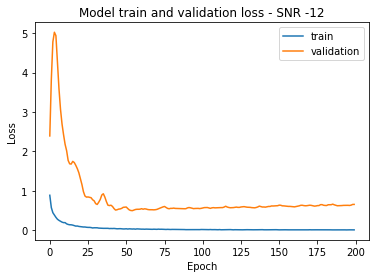


Training SNR = -12 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 2s 83ms/step - loss: 3.1431 - accuracy: 0.7035 - val_loss: 13.3685 - val_accuracy: 0.1776
Epoch 2/200
7/7 [==============================] - 0s 13ms/step - loss: 2.5555 - accuracy: 0.7383 - val_loss: 11.0473 - val_accuracy: 0.2420
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 2.1813 - accuracy: 0.7599 - val_loss: 9.0537 - val_accuracy: 0.3207
Epoch 4/200
7/7 [==============================] - 0s 12ms/step - loss: 1.9549 - accuracy: 0.7760 - val_loss: 7.6111 - val_accuracy: 0.3977
Epoch 5/200
7/7 [==============================] - 0s 13ms/step - loss: 1.7622 - accuracy: 0.7902 - val_loss: 6.6852 - val_accuracy: 0.4564
Epoch 6/200
7/7 [==============================] - 0s 12ms/step - loss: 1.5203 - accuracy: 0.8052 - val_loss: 5.7966 - val_accuracy: 0.5203
Epoch 7/200
7/7 [==============================] - 0s 13ms/step - loss: 1.3704 - accuracy: 0.8038 - 

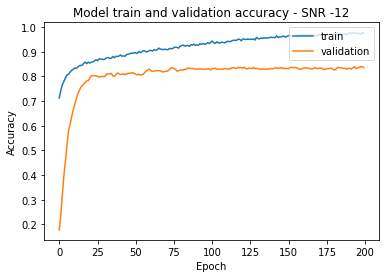

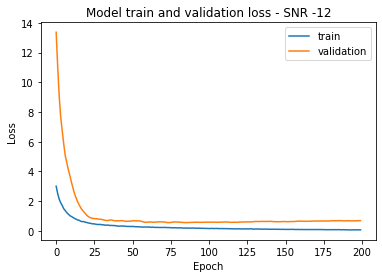


Training SNR = -12 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 2s 78ms/step - loss: 0.4419 - accuracy: 0.8341 - val_loss: 0.8433 - val_accuracy: 0.7403
Epoch 2/200
7/7 [==============================] - 0s 14ms/step - loss: 0.3883 - accuracy: 0.8510 - val_loss: 0.8928 - val_accuracy: 0.7403
Epoch 3/200
7/7 [==============================] - 0s 16ms/step - loss: 0.3634 - accuracy: 0.8528 - val_loss: 0.9191 - val_accuracy: 0.7366
Epoch 4/200
7/7 [==============================] - 0s 16ms/step - loss: 0.3326 - accuracy: 0.8688 - val_loss: 0.9098 - val_accuracy: 0.7352
Epoch 5/200
7/7 [==============================] - 0s 14ms/step - loss: 0.3190 - accuracy: 0.8707 - val_loss: 0.8947 - val_accuracy: 0.7343
Epoch 6/200
7/7 [==============================] - 0s 11ms/step - loss: 0.3131 - accuracy: 0.8776 - val_loss: 0.8834 - val_accuracy: 0.7333
Epoch 7/200
7/7 [==============================] - 0s 13ms/step - loss: 0.2953 - accuracy: 0.8838 - val

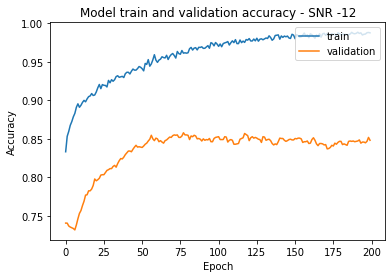

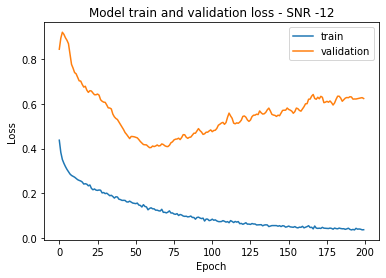

In [ ]:
for i in range(0, 5):

  x_data_mag = np.absolute(x_data_fft_data[:,:,:,:,0] + 1j*x_data_fft_data[:,:,:,:,1]) 
  x_data_fft_curr = np.reshape(x_data_mag[:,i], (x_dim[0]*x_dim[2], x_dim[3]))

  y_data_fft_curr = to_categorical(y_labels_data[:,i].flatten())

  X_train_curr, X_test_valid_curr, Y_train_curr, Y_test_valid_curr = train_test_split(x_data_fft_curr, y_data_fft_curr, test_size=0.4)
  X_validation_curr, X_test_curr, Y_validation_curr, Y_test_curr = train_test_split(X_test_valid_curr, Y_test_valid_curr, test_size=0.5)

  Testing(X_test_curr, Y_test_curr, i)
  train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_all_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_high_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_low_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)


Score of SNR on All SNR model without Transfer Learning -10 = 80.2331030368805
Score of SNR on High SNR model without Transfer Learning -10 = 35.151514410972595
Score of SNR on low SNR model without Transfer Learning -10 = 79.06759977340698

Training SNR = -10 Data

Epoch 1/200
7/7 [==============================] - 2s 84ms/step - loss: 2.7513 - accuracy: 0.1486 - val_loss: 2.6067 - val_accuracy: 0.3170
Epoch 2/200
7/7 [==============================] - 0s 12ms/step - loss: 1.6544 - accuracy: 0.5558 - val_loss: 2.5179 - val_accuracy: 0.5832
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 1.1847 - accuracy: 0.7116 - val_loss: 2.4500 - val_accuracy: 0.6555
Epoch 4/200
7/7 [==============================] - 0s 12ms/step - loss: 0.9744 - accuracy: 0.7466 - val_loss: 2.4023 - val_accuracy: 0.6802
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 0.8633 - accuracy: 0.7587 - val_loss: 2.3704 - val_accuracy: 0.6490
Epoch 6/200
7/7 [===============

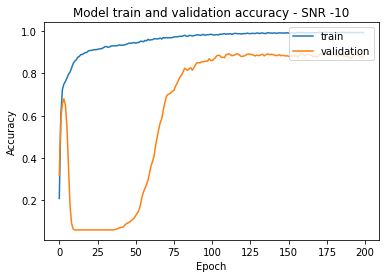

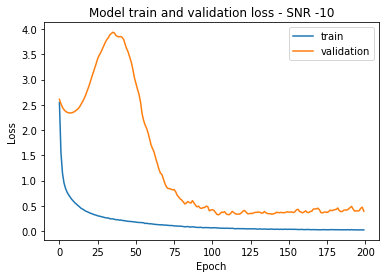


Training SNR = -10 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 2s 88ms/step - loss: 0.5069 - accuracy: 0.8902 - val_loss: 2.9774 - val_accuracy: 0.7040
Epoch 2/200
7/7 [==============================] - 0s 18ms/step - loss: 0.3109 - accuracy: 0.9273 - val_loss: 4.8293 - val_accuracy: 0.6294
Epoch 3/200
7/7 [==============================] - 0s 18ms/step - loss: 0.2457 - accuracy: 0.9356 - val_loss: 5.4106 - val_accuracy: 0.5949
Epoch 4/200
7/7 [==============================] - 0s 20ms/step - loss: 0.1859 - accuracy: 0.9493 - val_loss: 5.0709 - val_accuracy: 0.6051
Epoch 5/200
7/7 [==============================] - 0s 20ms/step - loss: 0.1683 - accuracy: 0.9493 - val_loss: 4.2752 - val_accuracy: 0.6406
Epoch 6/200
7/7 [==============================] - 0s 18ms/step - loss: 0.1487 - accuracy: 0.9538 - val_loss: 3.6921 - val_accuracy: 0.6629
Epoch 7/200
7/7 [==============================] - 0s 18ms/step - loss: 0.1320 - accuracy: 0.9561 - val

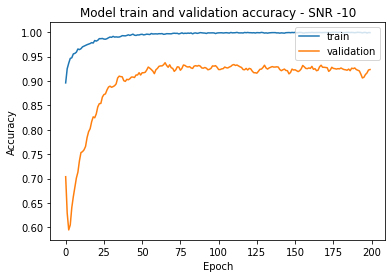

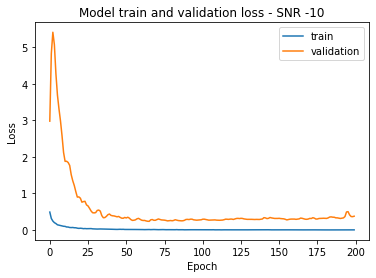


Training SNR = -10 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 2s 80ms/step - loss: 2.0549 - accuracy: 0.7795 - val_loss: 6.0134 - val_accuracy: 0.3692
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 1.5478 - accuracy: 0.8097 - val_loss: 5.7435 - val_accuracy: 0.4033
Epoch 3/200
7/7 [==============================] - 0s 10ms/step - loss: 1.2704 - accuracy: 0.8305 - val_loss: 5.5466 - val_accuracy: 0.4392
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 1.0388 - accuracy: 0.8529 - val_loss: 5.2924 - val_accuracy: 0.4751
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 0.9554 - accuracy: 0.8611 - val_loss: 5.0753 - val_accuracy: 0.4993
Epoch 6/200
7/7 [==============================] - 0s 12ms/step - loss: 0.8390 - accuracy: 0.8688 - val_loss: 4.7487 - val_accuracy: 0.5417
Epoch 7/200
7/7 [==============================] - 0s 15ms/step - loss: 0.7352 - accuracy: 0.8801 - va

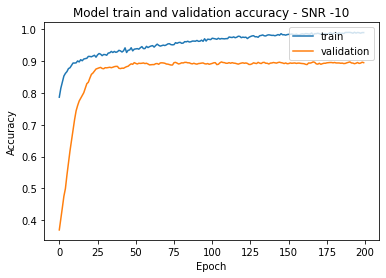

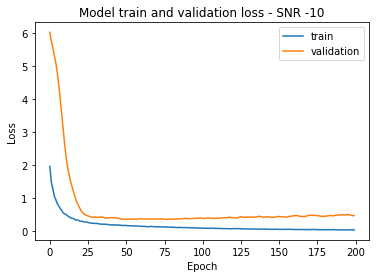


Training SNR = -10 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 2s 81ms/step - loss: 0.3088 - accuracy: 0.8736 - val_loss: 0.5452 - val_accuracy: 0.8084
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 0.2659 - accuracy: 0.8969 - val_loss: 0.6132 - val_accuracy: 0.7977
Epoch 3/200
7/7 [==============================] - 0s 13ms/step - loss: 0.2520 - accuracy: 0.8978 - val_loss: 0.6585 - val_accuracy: 0.7790
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.2375 - accuracy: 0.9017 - val_loss: 0.7098 - val_accuracy: 0.7683
Epoch 5/200
7/7 [==============================] - 0s 13ms/step - loss: 0.2244 - accuracy: 0.9118 - val_loss: 0.7606 - val_accuracy: 0.7636
Epoch 6/200
7/7 [==============================] - 0s 13ms/step - loss: 0.2091 - accuracy: 0.9216 - val_loss: 0.8368 - val_accuracy: 0.7469
Epoch 7/200
7/7 [==============================] - 0s 13ms/step - loss: 0.2085 - accuracy: 0.9219 - val

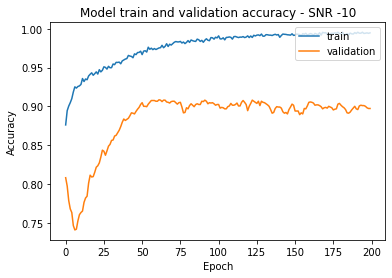

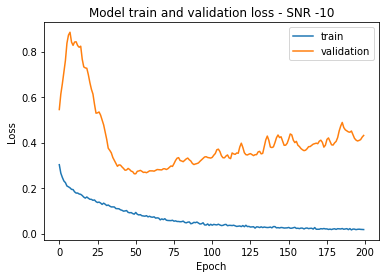


Score of SNR on All SNR model without Transfer Learning -8 = 86.48018836975098
Score of SNR on High SNR model without Transfer Learning -8 = 68.9976692199707
Score of SNR on low SNR model without Transfer Learning -8 = 87.45920658111572

Training SNR = -8 Data

Epoch 1/200
7/7 [==============================] - 2s 80ms/step - loss: 2.6657 - accuracy: 0.1632 - val_loss: 2.5965 - val_accuracy: 0.4471
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 1.4107 - accuracy: 0.6442 - val_loss: 2.4880 - val_accuracy: 0.5650
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 0.9748 - accuracy: 0.7642 - val_loss: 2.4046 - val_accuracy: 0.4970
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.7987 - accuracy: 0.7857 - val_loss: 2.3497 - val_accuracy: 0.3622
Epoch 5/200
7/7 [==============================] - 0s 13ms/step - loss: 0.6741 - accuracy: 0.8213 - val_loss: 2.3169 - val_accuracy: 0.2079
Epoch 6/200
7/7 [====================

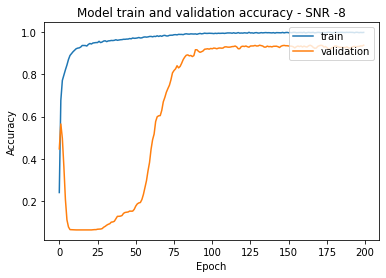

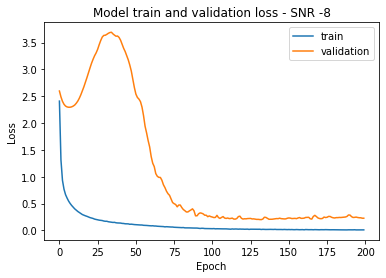


Training SNR = -8 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 2s 88ms/step - loss: 0.2359 - accuracy: 0.9384 - val_loss: 2.1525 - val_accuracy: 0.7632
Epoch 2/200
7/7 [==============================] - 0s 20ms/step - loss: 0.1462 - accuracy: 0.9588 - val_loss: 3.5728 - val_accuracy: 0.7161
Epoch 3/200
7/7 [==============================] - 0s 21ms/step - loss: 0.1288 - accuracy: 0.9616 - val_loss: 4.2758 - val_accuracy: 0.6779
Epoch 4/200
7/7 [==============================] - 0s 21ms/step - loss: 0.1010 - accuracy: 0.9696 - val_loss: 4.3352 - val_accuracy: 0.6723
Epoch 5/200
7/7 [==============================] - 0s 20ms/step - loss: 0.0805 - accuracy: 0.9726 - val_loss: 4.1199 - val_accuracy: 0.6793
Epoch 6/200
7/7 [==============================] - 0s 20ms/step - loss: 0.0724 - accuracy: 0.9754 - val_loss: 3.8660 - val_accuracy: 0.6872
Epoch 7/200
7/7 [==============================] - 0s 20ms/step - loss: 0.0665 - accuracy: 0.9786 - val_

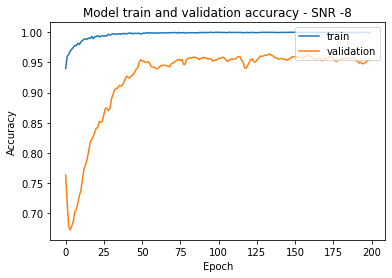

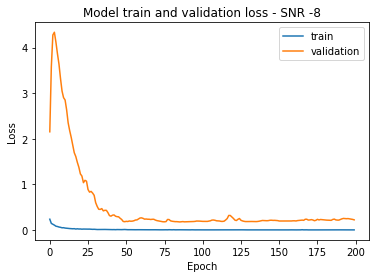


Training SNR = -8 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 2s 78ms/step - loss: 1.0291 - accuracy: 0.8678 - val_loss: 2.1369 - val_accuracy: 0.6531
Epoch 2/200
7/7 [==============================] - 0s 12ms/step - loss: 0.6921 - accuracy: 0.8927 - val_loss: 2.5236 - val_accuracy: 0.6205
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 0.5320 - accuracy: 0.9165 - val_loss: 2.8786 - val_accuracy: 0.6019
Epoch 4/200
7/7 [==============================] - 0s 12ms/step - loss: 0.4492 - accuracy: 0.9230 - val_loss: 3.0866 - val_accuracy: 0.5953
Epoch 5/200
7/7 [==============================] - 0s 13ms/step - loss: 0.3563 - accuracy: 0.9326 - val_loss: 3.2021 - val_accuracy: 0.5991
Epoch 6/200
7/7 [==============================] - 0s 11ms/step - loss: 0.3615 - accuracy: 0.9324 - val_loss: 3.0590 - val_accuracy: 0.6205
Epoch 7/200
7/7 [==============================] - 0s 11ms/step - loss: 0.3229 - accuracy: 0.9350 - val

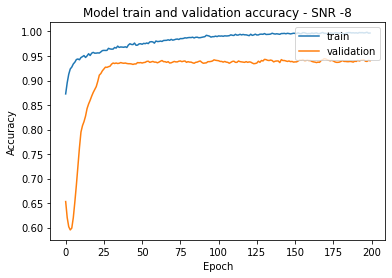

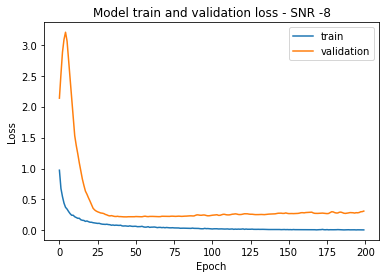


Training SNR = -8 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 2s 81ms/step - loss: 0.2173 - accuracy: 0.9134 - val_loss: 0.3966 - val_accuracy: 0.8457
Epoch 2/200
7/7 [==============================] - 0s 13ms/step - loss: 0.1900 - accuracy: 0.9279 - val_loss: 0.5509 - val_accuracy: 0.8135
Epoch 3/200
7/7 [==============================] - 0s 13ms/step - loss: 0.1697 - accuracy: 0.9335 - val_loss: 0.7158 - val_accuracy: 0.7846
Epoch 4/200
7/7 [==============================] - 0s 16ms/step - loss: 0.1614 - accuracy: 0.9393 - val_loss: 0.8978 - val_accuracy: 0.7571
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 0.1375 - accuracy: 0.9507 - val_loss: 1.0354 - val_accuracy: 0.7385
Epoch 6/200
7/7 [==============================] - 0s 12ms/step - loss: 0.1384 - accuracy: 0.9467 - val_loss: 1.1510 - val_accuracy: 0.7212
Epoch 7/200
7/7 [==============================] - 0s 11ms/step - loss: 0.1334 - accuracy: 0.9492 - val_

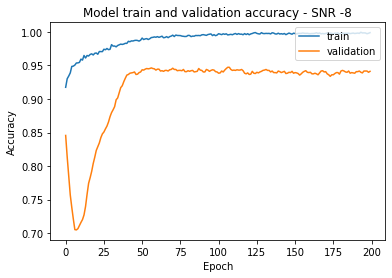

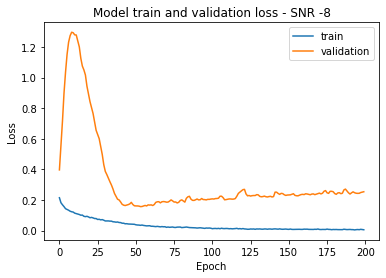


Score of SNR on All SNR model without Transfer Learning -6 = 90.76923131942749
Score of SNR on High SNR model without Transfer Learning -6 = 79.90676164627075
Score of SNR on low SNR model without Transfer Learning -6 = 90.67599177360535

Training SNR = -6 Data

Epoch 1/200
7/7 [==============================] - 2s 80ms/step - loss: 2.5488 - accuracy: 0.1904 - val_loss: 2.5908 - val_accuracy: 0.5590
Epoch 2/200
7/7 [==============================] - 0s 16ms/step - loss: 1.2365 - accuracy: 0.7215 - val_loss: 2.4977 - val_accuracy: 0.6126
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 0.8512 - accuracy: 0.8008 - val_loss: 2.4313 - val_accuracy: 0.5212
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.6794 - accuracy: 0.8308 - val_loss: 2.3899 - val_accuracy: 0.2998
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 0.5816 - accuracy: 0.8636 - val_loss: 2.3688 - val_accuracy: 0.1077
Epoch 6/200
7/7 [===================

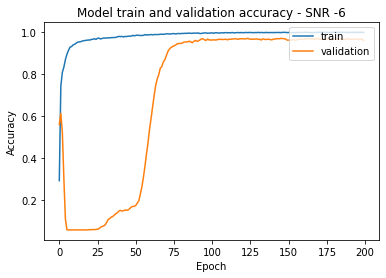

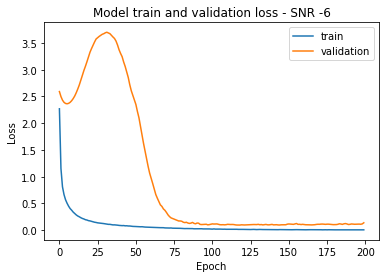


Training SNR = -6 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 2s 92ms/step - loss: 0.1185 - accuracy: 0.9648 - val_loss: 1.6977 - val_accuracy: 0.8121
Epoch 2/200
7/7 [==============================] - 0s 20ms/step - loss: 0.0643 - accuracy: 0.9767 - val_loss: 3.0666 - val_accuracy: 0.7688
Epoch 3/200
7/7 [==============================] - 0s 22ms/step - loss: 0.0472 - accuracy: 0.9860 - val_loss: 3.5326 - val_accuracy: 0.7543
Epoch 4/200
7/7 [==============================] - 0s 20ms/step - loss: 0.0456 - accuracy: 0.9828 - val_loss: 3.4650 - val_accuracy: 0.7497
Epoch 5/200
7/7 [==============================] - 0s 22ms/step - loss: 0.0343 - accuracy: 0.9870 - val_loss: 3.4275 - val_accuracy: 0.7450
Epoch 6/200
7/7 [==============================] - 0s 21ms/step - loss: 0.0316 - accuracy: 0.9881 - val_loss: 2.9958 - val_accuracy: 0.7543
Epoch 7/200
7/7 [==============================] - 0s 20ms/step - loss: 0.0292 - accuracy: 0.9883 - val_

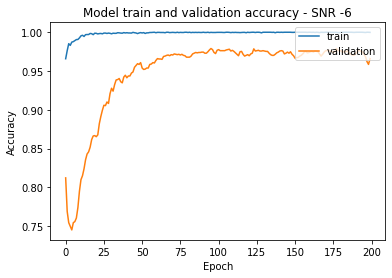

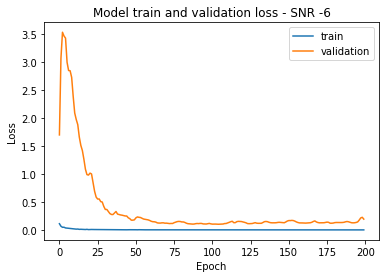


Training SNR = -6 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 2s 79ms/step - loss: 0.5067 - accuracy: 0.9142 - val_loss: 0.6073 - val_accuracy: 0.8452
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 0.3251 - accuracy: 0.9434 - val_loss: 0.8939 - val_accuracy: 0.8098
Epoch 3/200
7/7 [==============================] - 0s 14ms/step - loss: 0.2481 - accuracy: 0.9499 - val_loss: 1.1618 - val_accuracy: 0.7786
Epoch 4/200
7/7 [==============================] - 0s 15ms/step - loss: 0.1826 - accuracy: 0.9589 - val_loss: 1.2920 - val_accuracy: 0.7632
Epoch 5/200
7/7 [==============================] - 0s 14ms/step - loss: 0.1702 - accuracy: 0.9605 - val_loss: 1.3684 - val_accuracy: 0.7548
Epoch 6/200
7/7 [==============================] - 0s 12ms/step - loss: 0.1331 - accuracy: 0.9679 - val_loss: 1.2938 - val_accuracy: 0.7711
Epoch 7/200
7/7 [==============================] - 0s 12ms/step - loss: 0.1125 - accuracy: 0.9702 - val

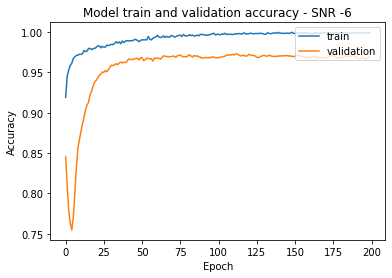

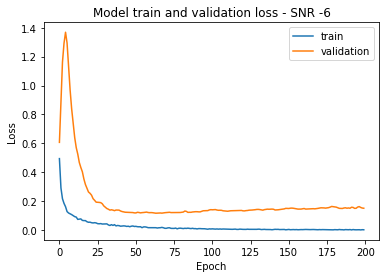


Training SNR = -6 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 2s 84ms/step - loss: 0.1879 - accuracy: 0.9350 - val_loss: 0.2640 - val_accuracy: 0.8918
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 0.1447 - accuracy: 0.9560 - val_loss: 0.3652 - val_accuracy: 0.8695
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 0.1324 - accuracy: 0.9592 - val_loss: 0.5133 - val_accuracy: 0.8485
Epoch 4/200
7/7 [==============================] - 0s 12ms/step - loss: 0.1203 - accuracy: 0.9588 - val_loss: 0.6784 - val_accuracy: 0.8284
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 0.1129 - accuracy: 0.9603 - val_loss: 0.8712 - val_accuracy: 0.8019
Epoch 6/200
7/7 [==============================] - 0s 13ms/step - loss: 0.1008 - accuracy: 0.9637 - val_loss: 1.0292 - val_accuracy: 0.7744
Epoch 7/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0958 - accuracy: 0.9657 - val_

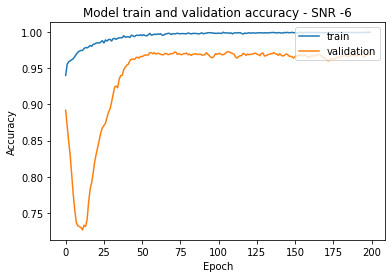

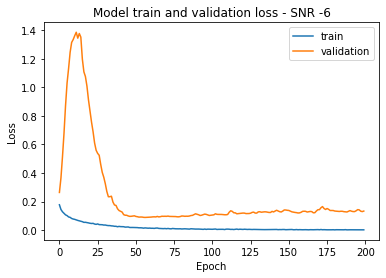


Score of SNR on All SNR model without Transfer Learning -4 = 94.40559148788452
Score of SNR on High SNR model without Transfer Learning -4 = 87.31935024261475
Score of SNR on low SNR model without Transfer Learning -4 = 95.19813656806946

Training SNR = -4 Data

Epoch 1/200
7/7 [==============================] - 2s 77ms/step - loss: 2.6861 - accuracy: 0.2019 - val_loss: 2.5921 - val_accuracy: 0.5683
Epoch 2/200
7/7 [==============================] - 0s 12ms/step - loss: 1.2266 - accuracy: 0.7163 - val_loss: 2.4850 - val_accuracy: 0.7268
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 0.7981 - accuracy: 0.8106 - val_loss: 2.4084 - val_accuracy: 0.6555
Epoch 4/200
7/7 [==============================] - 0s 12ms/step - loss: 0.6358 - accuracy: 0.8501 - val_loss: 2.3603 - val_accuracy: 0.4345
Epoch 5/200
7/7 [==============================] - 0s 12ms/step - loss: 0.5422 - accuracy: 0.8896 - val_loss: 2.3356 - val_accuracy: 0.1781
Epoch 6/200
7/7 [===================

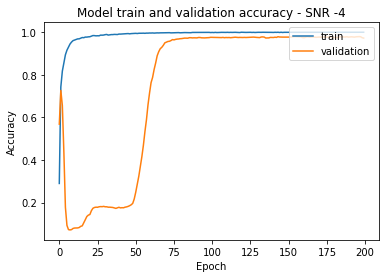

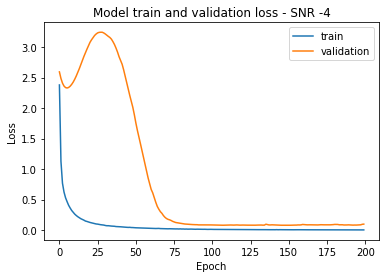


Training SNR = -4 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 2s 88ms/step - loss: 0.0550 - accuracy: 0.9797 - val_loss: 1.1351 - val_accuracy: 0.8573
Epoch 2/200
7/7 [==============================] - 0s 19ms/step - loss: 0.0370 - accuracy: 0.9849 - val_loss: 2.5239 - val_accuracy: 0.7930
Epoch 3/200
7/7 [==============================] - 0s 19ms/step - loss: 0.0198 - accuracy: 0.9915 - val_loss: 3.1070 - val_accuracy: 0.7786
Epoch 4/200
7/7 [==============================] - 0s 22ms/step - loss: 0.0158 - accuracy: 0.9935 - val_loss: 3.0352 - val_accuracy: 0.7646
Epoch 5/200
7/7 [==============================] - 0s 20ms/step - loss: 0.0146 - accuracy: 0.9946 - val_loss: 3.1818 - val_accuracy: 0.7562
Epoch 6/200
7/7 [==============================] - 0s 21ms/step - loss: 0.0099 - accuracy: 0.9963 - val_loss: 3.4583 - val_accuracy: 0.7445
Epoch 7/200
7/7 [==============================] - 0s 21ms/step - loss: 0.0096 - accuracy: 0.9964 - val_

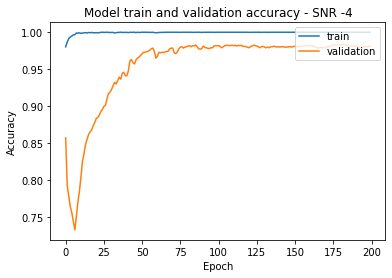

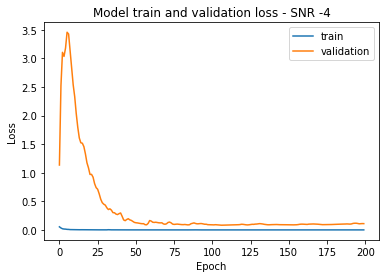


Training SNR = -4 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 2s 84ms/step - loss: 0.2186 - accuracy: 0.9586 - val_loss: 0.1998 - val_accuracy: 0.9357
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0980 - accuracy: 0.9786 - val_loss: 0.2577 - val_accuracy: 0.9277
Epoch 3/200
7/7 [==============================] - 0s 14ms/step - loss: 0.0810 - accuracy: 0.9830 - val_loss: 0.3732 - val_accuracy: 0.9054
Epoch 4/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0596 - accuracy: 0.9823 - val_loss: 0.4507 - val_accuracy: 0.8984
Epoch 5/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0473 - accuracy: 0.9861 - val_loss: 0.4442 - val_accuracy: 0.9002
Epoch 6/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0508 - accuracy: 0.9860 - val_loss: 0.4278 - val_accuracy: 0.9054
Epoch 7/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0363 - accuracy: 0.9881 - val

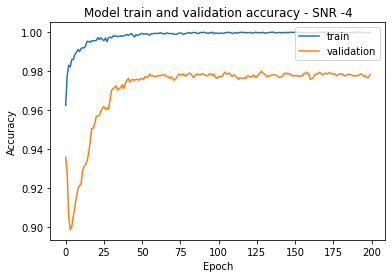

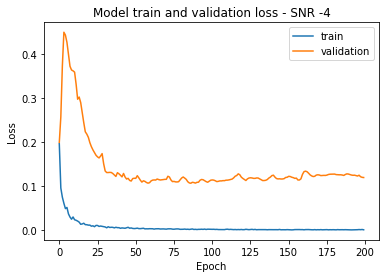


Training SNR = -4 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 2s 84ms/step - loss: 0.1657 - accuracy: 0.9485 - val_loss: 0.1870 - val_accuracy: 0.9287
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 0.1272 - accuracy: 0.9644 - val_loss: 0.2605 - val_accuracy: 0.9016
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 0.1030 - accuracy: 0.9734 - val_loss: 0.3804 - val_accuracy: 0.8807
Epoch 4/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0868 - accuracy: 0.9725 - val_loss: 0.5171 - val_accuracy: 0.8685
Epoch 5/200
7/7 [==============================] - 0s 15ms/step - loss: 0.0761 - accuracy: 0.9786 - val_loss: 0.6116 - val_accuracy: 0.8662
Epoch 6/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0706 - accuracy: 0.9785 - val_loss: 0.7038 - val_accuracy: 0.8601
Epoch 7/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0641 - accuracy: 0.9819 - val_

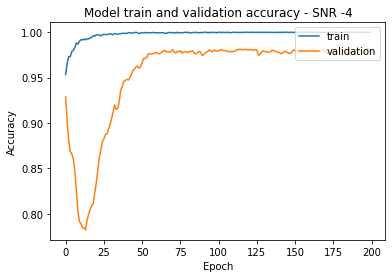

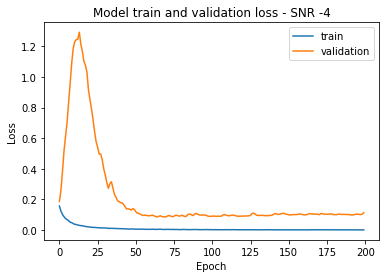


Score of SNR on All SNR model without Transfer Learning -2 = 95.57109475135803
Score of SNR on High SNR model without Transfer Learning -2 = 90.44288992881775
Score of SNR on low SNR model without Transfer Learning -2 = 96.68997526168823

Training SNR = -2 Data

Epoch 1/200
7/7 [==============================] - 2s 83ms/step - loss: 2.7919 - accuracy: 0.1559 - val_loss: 2.5880 - val_accuracy: 0.5068
Epoch 2/200
7/7 [==============================] - 0s 12ms/step - loss: 1.2347 - accuracy: 0.7204 - val_loss: 2.4784 - val_accuracy: 0.6443
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 0.7561 - accuracy: 0.8444 - val_loss: 2.3997 - val_accuracy: 0.5566
Epoch 4/200
7/7 [==============================] - 0s 15ms/step - loss: 0.5881 - accuracy: 0.8914 - val_loss: 2.3487 - val_accuracy: 0.2807
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 0.4904 - accuracy: 0.9245 - val_loss: 2.3179 - val_accuracy: 0.1058
Epoch 6/200
7/7 [===================

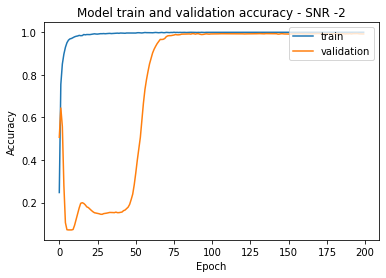

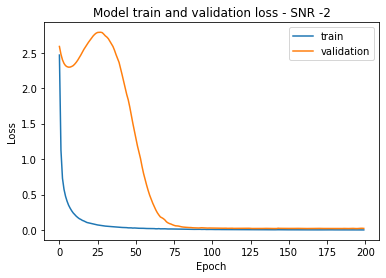


Training SNR = -2 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 2s 91ms/step - loss: 0.0391 - accuracy: 0.9845 - val_loss: 0.9468 - val_accuracy: 0.8657
Epoch 2/200
7/7 [==============================] - 0s 21ms/step - loss: 0.0161 - accuracy: 0.9936 - val_loss: 1.7403 - val_accuracy: 0.8191
Epoch 3/200
7/7 [==============================] - 0s 19ms/step - loss: 0.0085 - accuracy: 0.9972 - val_loss: 2.2710 - val_accuracy: 0.7911
Epoch 4/200
7/7 [==============================] - 0s 22ms/step - loss: 0.0059 - accuracy: 0.9980 - val_loss: 2.5071 - val_accuracy: 0.7869
Epoch 5/200
7/7 [==============================] - 0s 23ms/step - loss: 0.0048 - accuracy: 0.9991 - val_loss: 2.3818 - val_accuracy: 0.7865
Epoch 6/200
7/7 [==============================] - 0s 21ms/step - loss: 0.0056 - accuracy: 0.9982 - val_loss: 2.2594 - val_accuracy: 0.7865
Epoch 7/200
7/7 [==============================] - 0s 20ms/step - loss: 0.0033 - accuracy: 0.9992 - val_

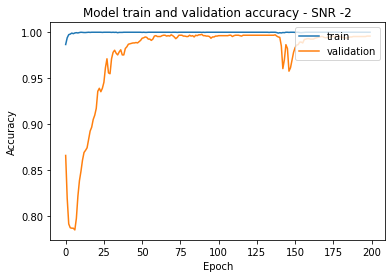

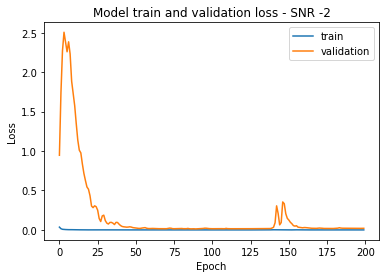


Training SNR = -2 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 2s 82ms/step - loss: 0.0934 - accuracy: 0.9807 - val_loss: 0.0583 - val_accuracy: 0.9786
Epoch 2/200
7/7 [==============================] - 0s 17ms/step - loss: 0.0406 - accuracy: 0.9907 - val_loss: 0.0635 - val_accuracy: 0.9776
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0249 - accuracy: 0.9914 - val_loss: 0.0684 - val_accuracy: 0.9762
Epoch 4/200
7/7 [==============================] - 0s 18ms/step - loss: 0.0165 - accuracy: 0.9951 - val_loss: 0.0606 - val_accuracy: 0.9795
Epoch 5/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0128 - accuracy: 0.9957 - val_loss: 0.0565 - val_accuracy: 0.9809
Epoch 6/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0129 - accuracy: 0.9964 - val_loss: 0.0522 - val_accuracy: 0.9814
Epoch 7/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0088 - accuracy: 0.9973 - val

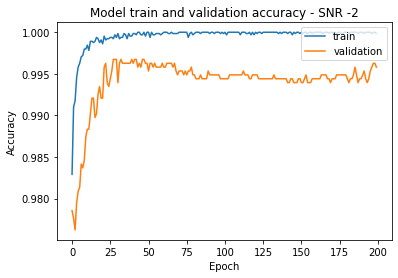

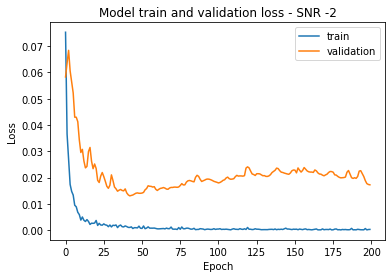


Training SNR = -2 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 2s 80ms/step - loss: 0.1562 - accuracy: 0.9593 - val_loss: 0.1084 - val_accuracy: 0.9538
Epoch 2/200
7/7 [==============================] - 0s 12ms/step - loss: 0.1158 - accuracy: 0.9750 - val_loss: 0.1457 - val_accuracy: 0.9483
Epoch 3/200
7/7 [==============================] - 0s 13ms/step - loss: 0.1000 - accuracy: 0.9765 - val_loss: 0.2197 - val_accuracy: 0.9235
Epoch 4/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0776 - accuracy: 0.9815 - val_loss: 0.3084 - val_accuracy: 0.9096
Epoch 5/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0643 - accuracy: 0.9859 - val_loss: 0.4136 - val_accuracy: 0.8946
Epoch 6/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0543 - accuracy: 0.9878 - val_loss: 0.5133 - val_accuracy: 0.8853
Epoch 7/200
7/7 [==============================] - 0s 18ms/step - loss: 0.0433 - accuracy: 0.9918 - val_

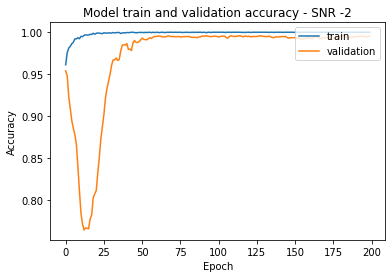

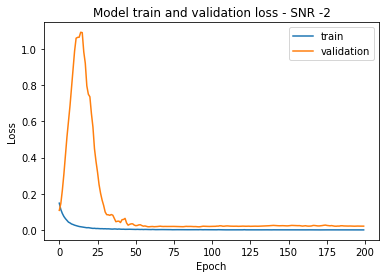

In [ ]:
for i in range(5, 10):

  x_data_mag = np.absolute(x_data_fft_data[:,:,:,:,0] + 1j*x_data_fft_data[:,:,:,:,1]) 
  x_data_fft_curr = np.reshape(x_data_mag[:,i], (x_dim[0]*x_dim[2], x_dim[3]))

  y_data_fft_curr = to_categorical(y_labels_data[:,i].flatten())

  X_train_curr, X_test_valid_curr, Y_train_curr, Y_test_valid_curr = train_test_split(x_data_fft_curr, y_data_fft_curr, test_size=0.4)
  X_validation_curr, X_test_curr, Y_validation_curr, Y_test_curr = train_test_split(X_test_valid_curr, Y_test_valid_curr, test_size=0.5)

  Testing(X_test_curr, Y_test_curr, i)
  train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_all_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_high_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_low_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)


Score of SNR on All SNR model without Transfer Learning 0 = 97.48252034187317
Score of SNR on High SNR model without Transfer Learning 0 = 92.30769276618958
Score of SNR on low SNR model without Transfer Learning 0 = 97.66899943351746

Training SNR = 0 Data

Epoch 1/200
7/7 [==============================] - 2s 81ms/step - loss: 2.4597 - accuracy: 0.2522 - val_loss: 2.5712 - val_accuracy: 0.6942
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 1.1048 - accuracy: 0.7430 - val_loss: 2.4639 - val_accuracy: 0.8280
Epoch 3/200
7/7 [==============================] - 0s 10ms/step - loss: 0.7142 - accuracy: 0.8495 - val_loss: 2.3928 - val_accuracy: 0.7501
Epoch 4/200
7/7 [==============================] - 0s 10ms/step - loss: 0.5563 - accuracy: 0.9073 - val_loss: 2.3513 - val_accuracy: 0.4042
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 0.4608 - accuracy: 0.9408 - val_loss: 2.3300 - val_accuracy: 0.1385
Epoch 6/200
7/7 [=======================

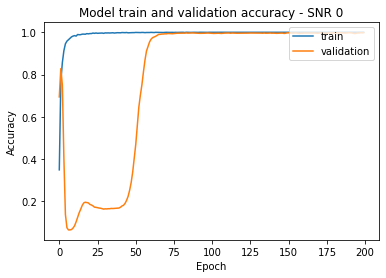

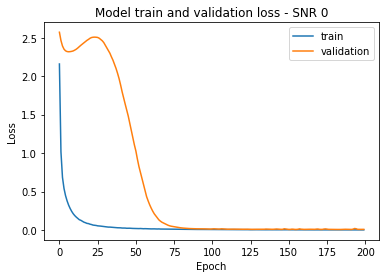


Score of SNR on All SNR model without Transfer Learning 2 = 98.22843670845032
Score of SNR on High SNR model without Transfer Learning 2 = 92.16783046722412
Score of SNR on low SNR model without Transfer Learning 2 = 97.90209531784058

Training SNR = 2 Data

Epoch 1/200
7/7 [==============================] - 2s 82ms/step - loss: 2.6352 - accuracy: 0.1905 - val_loss: 2.5711 - val_accuracy: 0.6848
Epoch 2/200
7/7 [==============================] - 0s 12ms/step - loss: 1.0846 - accuracy: 0.7836 - val_loss: 2.4620 - val_accuracy: 0.6695
Epoch 3/200
7/7 [==============================] - 0s 10ms/step - loss: 0.6771 - accuracy: 0.8954 - val_loss: 2.3877 - val_accuracy: 0.3949
Epoch 4/200
7/7 [==============================] - 0s 10ms/step - loss: 0.5126 - accuracy: 0.9355 - val_loss: 2.3462 - val_accuracy: 0.1333
Epoch 5/200
7/7 [==============================] - 0s 12ms/step - loss: 0.4175 - accuracy: 0.9486 - val_loss: 2.3321 - val_accuracy: 0.0643
Epoch 6/200
7/7 [=======================

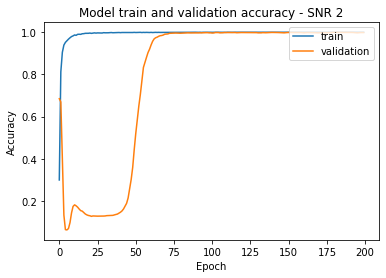

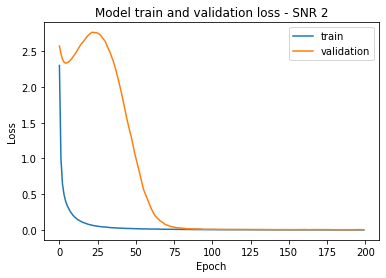


Score of SNR on All SNR model without Transfer Learning 4 = 98.4149158000946
Score of SNR on High SNR model without Transfer Learning 4 = 92.72727370262146
Score of SNR on low SNR model without Transfer Learning 4 = 98.18181991577148

Training SNR = 4 Data

Epoch 1/200
7/7 [==============================] - 2s 77ms/step - loss: 2.4325 - accuracy: 0.2530 - val_loss: 2.5543 - val_accuracy: 0.8000
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 0.9881 - accuracy: 0.7916 - val_loss: 2.4448 - val_accuracy: 0.8233
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 0.6468 - accuracy: 0.8811 - val_loss: 2.3742 - val_accuracy: 0.7683
Epoch 4/200
7/7 [==============================] - 0s 10ms/step - loss: 0.4844 - accuracy: 0.9252 - val_loss: 2.3311 - val_accuracy: 0.4480
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 0.4032 - accuracy: 0.9439 - val_loss: 2.3069 - val_accuracy: 0.2168
Epoch 6/200
7/7 [========================

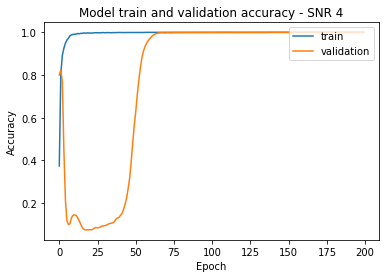

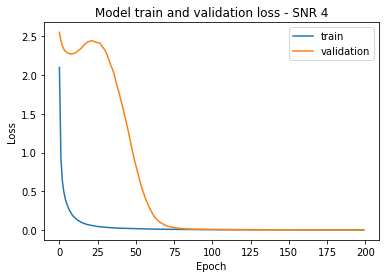


Score of SNR on All SNR model without Transfer Learning 6 = 99.34731721878052
Score of SNR on High SNR model without Transfer Learning 6 = 93.00699234008789
Score of SNR on low SNR model without Transfer Learning 6 = 98.92773628234863

Training SNR = 6 Data

Epoch 1/200
7/7 [==============================] - 2s 80ms/step - loss: 2.4825 - accuracy: 0.2260 - val_loss: 2.5533 - val_accuracy: 0.8075
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 0.9794 - accuracy: 0.8118 - val_loss: 2.4356 - val_accuracy: 0.8182
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 0.6244 - accuracy: 0.8902 - val_loss: 2.3564 - val_accuracy: 0.7450
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.4652 - accuracy: 0.9280 - val_loss: 2.3066 - val_accuracy: 0.5706
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 0.3886 - accuracy: 0.9513 - val_loss: 2.2757 - val_accuracy: 0.3441
Epoch 6/200
7/7 [=======================

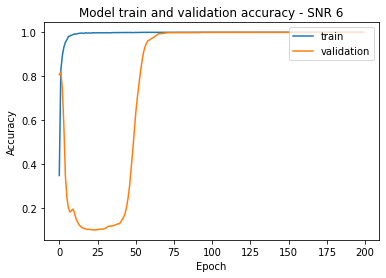

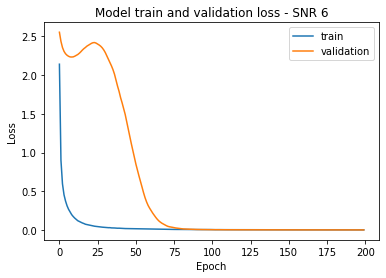


Score of SNR on All SNR model without Transfer Learning 8 = 99.20746088027954
Score of SNR on High SNR model without Transfer Learning 8 = 92.40093231201172
Score of SNR on low SNR model without Transfer Learning 8 = 98.74125719070435

Training SNR = 8 Data

Epoch 1/200
7/7 [==============================] - 2s 86ms/step - loss: 2.3380 - accuracy: 0.2688 - val_loss: 2.5387 - val_accuracy: 0.7422
Epoch 2/200
7/7 [==============================] - 0s 12ms/step - loss: 0.8977 - accuracy: 0.8186 - val_loss: 2.4286 - val_accuracy: 0.8252
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 0.5619 - accuracy: 0.9100 - val_loss: 2.3648 - val_accuracy: 0.6974
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.4269 - accuracy: 0.9511 - val_loss: 2.3312 - val_accuracy: 0.4177
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 0.3362 - accuracy: 0.9671 - val_loss: 2.3145 - val_accuracy: 0.2140
Epoch 6/200
7/7 [=======================

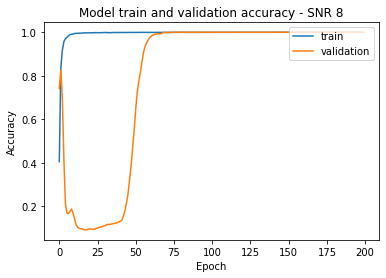

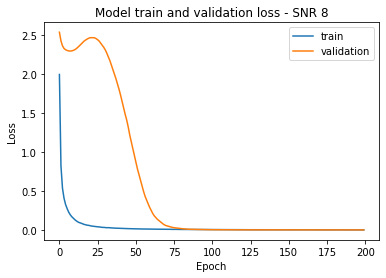

In [ ]:
for i in range(10, 15):

  x_data_mag = np.absolute(x_data_fft_data[:,:,:,:,0] + 1j*x_data_fft_data[:,:,:,:,1]) 
  x_data_fft_curr = np.reshape(x_data_mag[:,i], (x_dim[0]*x_dim[2], x_dim[3]))

  y_data_fft_curr = to_categorical(y_labels_data[:,i].flatten())

  X_train_curr, X_test_valid_curr, Y_train_curr, Y_test_valid_curr = train_test_split(x_data_fft_curr, y_data_fft_curr, test_size=0.4)
  X_validation_curr, X_test_curr, Y_validation_curr, Y_test_curr = train_test_split(X_test_valid_curr, Y_test_valid_curr, test_size=0.5)

  Testing(X_test_curr, Y_test_curr, i)
  train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)


Score of SNR on All SNR model without Transfer Learning 10 = 99.48717951774597
Score of SNR on High SNR model without Transfer Learning 10 = 92.21445322036743
Score of SNR on low SNR model without Transfer Learning 10 = 98.27505946159363

Training SNR = 10 Data

Epoch 1/200
7/7 [==============================] - 2s 82ms/step - loss: 2.3739 - accuracy: 0.2621 - val_loss: 2.5379 - val_accuracy: 0.7860
Epoch 2/200
7/7 [==============================] - 0s 12ms/step - loss: 0.9117 - accuracy: 0.8011 - val_loss: 2.4259 - val_accuracy: 0.8145
Epoch 3/200
7/7 [==============================] - 0s 10ms/step - loss: 0.5822 - accuracy: 0.8905 - val_loss: 2.3576 - val_accuracy: 0.7193
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.4329 - accuracy: 0.9312 - val_loss: 2.3162 - val_accuracy: 0.5552
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 0.3563 - accuracy: 0.9624 - val_loss: 2.2898 - val_accuracy: 0.2951
Epoch 6/200
7/7 [===================

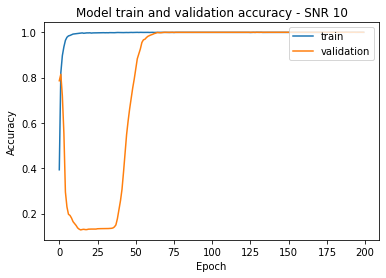

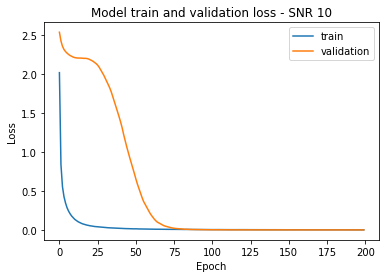


Score of SNR on All SNR model without Transfer Learning 12 = 99.39393997192383
Score of SNR on High SNR model without Transfer Learning 12 = 93.33333373069763
Score of SNR on low SNR model without Transfer Learning 12 = 98.60140085220337

Training SNR = 12 Data

Epoch 1/200
7/7 [==============================] - 2s 80ms/step - loss: 2.2695 - accuracy: 0.3155 - val_loss: 2.5432 - val_accuracy: 0.7832
Epoch 2/200
7/7 [==============================] - 0s 12ms/step - loss: 0.8850 - accuracy: 0.8300 - val_loss: 2.4373 - val_accuracy: 0.8415
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 0.5534 - accuracy: 0.9105 - val_loss: 2.3695 - val_accuracy: 0.6345
Epoch 4/200
7/7 [==============================] - 0s 12ms/step - loss: 0.4193 - accuracy: 0.9473 - val_loss: 2.3276 - val_accuracy: 0.3478
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 0.3313 - accuracy: 0.9685 - val_loss: 2.3010 - val_accuracy: 0.1907
Epoch 6/200
7/7 [===================

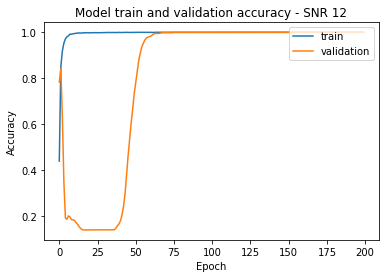

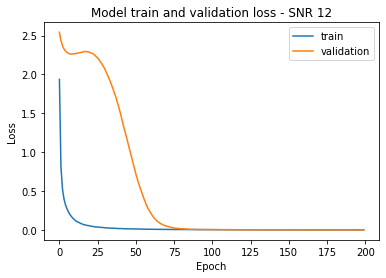


Score of SNR on All SNR model without Transfer Learning 14 = 99.67365860939026
Score of SNR on High SNR model without Transfer Learning 14 = 93.10023188591003
Score of SNR on low SNR model without Transfer Learning 14 = 98.83449673652649

Training SNR = 14 Data

Epoch 1/200
7/7 [==============================] - 2s 84ms/step - loss: 2.6267 - accuracy: 0.1885 - val_loss: 2.5439 - val_accuracy: 0.7571
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 1.0172 - accuracy: 0.7715 - val_loss: 2.4234 - val_accuracy: 0.8168
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 0.6333 - accuracy: 0.8671 - val_loss: 2.3456 - val_accuracy: 0.8266
Epoch 4/200
7/7 [==============================] - 0s 10ms/step - loss: 0.4803 - accuracy: 0.9216 - val_loss: 2.2943 - val_accuracy: 0.7636
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 0.3833 - accuracy: 0.9482 - val_loss: 2.2580 - val_accuracy: 0.6410
Epoch 6/200
7/7 [===================

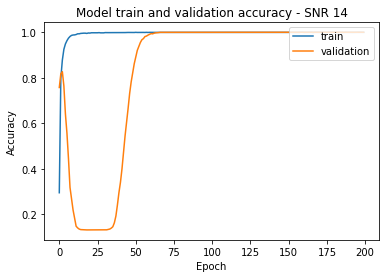

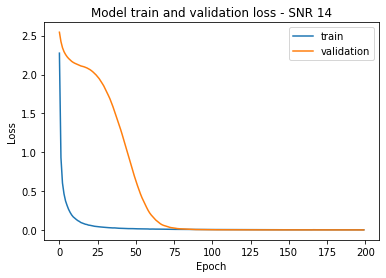


Score of SNR on All SNR model without Transfer Learning 16 = 99.39393997192383
Score of SNR on High SNR model without Transfer Learning 16 = 92.91375279426575
Score of SNR on low SNR model without Transfer Learning 16 = 98.60140085220337

Training SNR = 16 Data

Epoch 1/200
7/7 [==============================] - 2s 79ms/step - loss: 2.5247 - accuracy: 0.2539 - val_loss: 2.5573 - val_accuracy: 0.7566
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 1.0106 - accuracy: 0.7965 - val_loss: 2.4357 - val_accuracy: 0.8508
Epoch 3/200
7/7 [==============================] - 0s 10ms/step - loss: 0.6285 - accuracy: 0.8843 - val_loss: 2.3508 - val_accuracy: 0.8238
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.4700 - accuracy: 0.9282 - val_loss: 2.2938 - val_accuracy: 0.7021
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 0.3698 - accuracy: 0.9555 - val_loss: 2.2531 - val_accuracy: 0.5049
Epoch 6/200
7/7 [===================

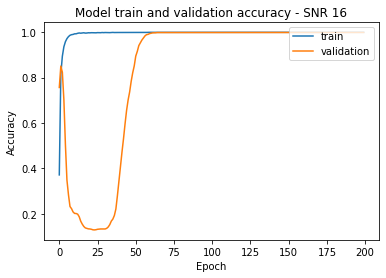

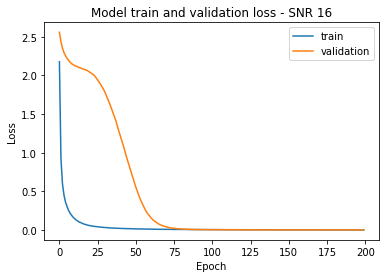


Score of SNR on All SNR model without Transfer Learning 18 = 99.58041906356812
Score of SNR on High SNR model without Transfer Learning 18 = 94.03263330459595
Score of SNR on low SNR model without Transfer Learning 18 = 98.8811194896698

Training SNR = 18 Data

Epoch 1/200
7/7 [==============================] - 2s 81ms/step - loss: 2.7690 - accuracy: 0.1663 - val_loss: 2.5671 - val_accuracy: 0.8121
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 1.0950 - accuracy: 0.7660 - val_loss: 2.4519 - val_accuracy: 0.8900
Epoch 3/200
7/7 [==============================] - 0s 10ms/step - loss: 0.6810 - accuracy: 0.8827 - val_loss: 2.3695 - val_accuracy: 0.9058
Epoch 4/200
7/7 [==============================] - 0s 12ms/step - loss: 0.5093 - accuracy: 0.9258 - val_loss: 2.3141 - val_accuracy: 0.8242
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 0.4081 - accuracy: 0.9488 - val_loss: 2.2753 - val_accuracy: 0.6065
Epoch 6/200
7/7 [====================

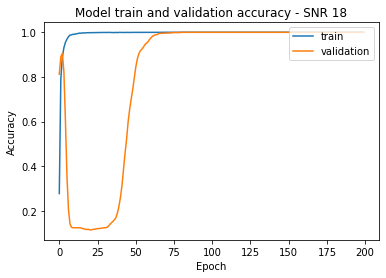

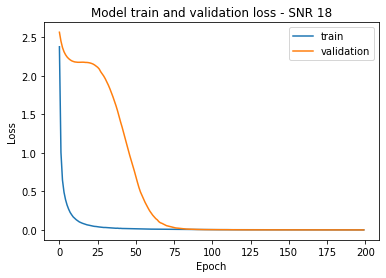


Score of SNR on All SNR model without Transfer Learning 20 = 99.30070042610168
Score of SNR on High SNR model without Transfer Learning 20 = 92.91375279426575
Score of SNR on low SNR model without Transfer Learning 20 = 98.60140085220337

Training SNR = 20 Data

Epoch 1/200
7/7 [==============================] - 2s 78ms/step - loss: 2.5108 - accuracy: 0.2208 - val_loss: 2.5444 - val_accuracy: 0.6802
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 0.9914 - accuracy: 0.8011 - val_loss: 2.4315 - val_accuracy: 0.6946
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 0.5974 - accuracy: 0.8871 - val_loss: 2.3556 - val_accuracy: 0.6336
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.4382 - accuracy: 0.9209 - val_loss: 2.3061 - val_accuracy: 0.5399
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 0.3491 - accuracy: 0.9449 - val_loss: 2.2719 - val_accuracy: 0.4037
Epoch 6/200
7/7 [===================

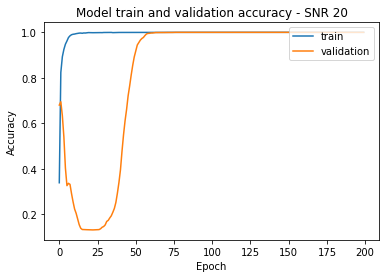

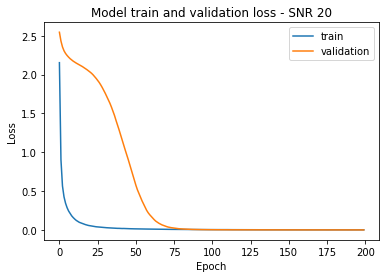

In [ ]:
for i in range(15, 21):

  x_data_mag = np.absolute(x_data_fft_data[:,:,:,:,0] + 1j*x_data_fft_data[:,:,:,:,1]) 
  x_data_fft_curr = np.reshape(x_data_mag[:,i], (x_dim[0]*x_dim[2], x_dim[3]))

  y_data_fft_curr = to_categorical(y_labels_data[:,i].flatten())

  X_train_curr, X_test_valid_curr, Y_train_curr, Y_test_valid_curr = train_test_split(x_data_fft_curr, y_data_fft_curr, test_size=0.4)
  X_validation_curr, X_test_curr, Y_validation_curr, Y_test_curr = train_test_split(X_test_valid_curr, Y_test_valid_curr, test_size=0.5)

  Testing(X_test_curr, Y_test_curr, i)
  train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)

# Signal-type Classification

## Whole data

In [ ]:
x_dim = x_data_fft_data.shape
total_num_snapshots = x_dim[0]*x_dim[1]*x_dim[2]
num_snapshots_per_tech = x_dim[1]*x_dim[2]
num_tech = x_dim[0]
num_samples = x_dim[3]
print(num_snapshots_per_tech)

15015


In [ ]:
from sklearn.preprocessing import MinMaxScaler

# Bin wise scalers for FFT data from sklearn
scaler_01 = MinMaxScaler(feature_range=(0,1))

x_data_fft_all_SNR_1d = np.reshape(x_data_fft_data, (total_num_snapshots, num_samples*x_dim[4]))
fft_data_complex = np.reshape(x_data_fft_all_SNR_1d.flatten()[::2] + 1j*x_data_fft_all_SNR_1d.flatten()[1::2], (total_num_snapshots, num_samples))
x_data_fft_all_SNR_1d = scaler_01.fit_transform(np.absolute(fft_data_complex))

In [ ]:
y_labels_all = y_labels_data.flatten()

y_labels_one_hot_all = np.zeros(shape=(y_labels_all.shape[0],3))
for i in range(y_labels_all.shape[0]):
  if(0<=y_labels_all[i] and y_labels_all[i]<=9):
    y_labels_one_hot_all[i][0] = 1
  elif(10<=y_labels_all[i] and y_labels_all[i]<=12):
    y_labels_one_hot_all[i][1] = 1
  else:
    y_labels_one_hot_all[i][2] = 1

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test_valid, Y_train, Y_test_valid = train_test_split(x_data_fft_all_SNR_1d, y_labels_one_hot_all, test_size=0.4)
X_validation, X_test, Y_validation, Y_test = train_test_split(X_test_valid, Y_test_valid, test_size=0.5)

In [ ]:
from keras.callbacks import EarlyStopping
ES = EarlyStopping(monitor = 'val_accuracy', mode = 'max', min_delta = 0.00001, patience = 200, verbose = 1)

import logging
logging.disable(logging.WARNING)

Epoch 1/200
132/132 [==============================] - 3s 10ms/step - loss: 0.6152 - accuracy: 0.7618 - val_loss: 1.8151 - val_accuracy: 0.2009
Epoch 2/200
132/132 [==============================] - 1s 7ms/step - loss: 0.2575 - accuracy: 0.9095 - val_loss: 2.5646 - val_accuracy: 0.2012
Epoch 3/200
132/132 [==============================] - 1s 7ms/step - loss: 0.2163 - accuracy: 0.9198 - val_loss: 1.0560 - val_accuracy: 0.4124
Epoch 4/200
132/132 [==============================] - 1s 7ms/step - loss: 0.2003 - accuracy: 0.9243 - val_loss: 0.2604 - val_accuracy: 0.8924
Epoch 5/200
132/132 [==============================] - 1s 7ms/step - loss: 0.1904 - accuracy: 0.9262 - val_loss: 0.1736 - val_accuracy: 0.9336
Epoch 6/200
132/132 [==============================] - 1s 7ms/step - loss: 0.1814 - accuracy: 0.9288 - val_loss: 0.1728 - val_accuracy: 0.9298
Epoch 7/200
132/132 [==============================] - 1s 7ms/step - loss: 0.1784 - accuracy: 0.9296 - val_loss: 0.1868 - val_accuracy: 0.928

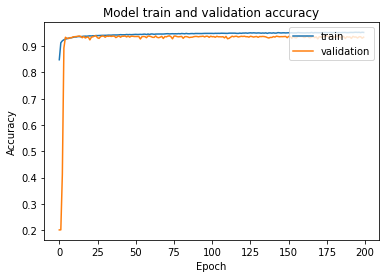

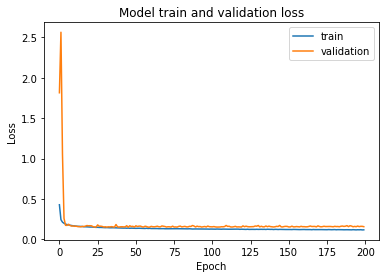


Training Accuracy Array:  [0.8481518626213074, 0.9125910997390747, 0.920050323009491, 0.924135148525238, 0.9265623092651367, 0.9279831051826477, 0.9303807020187378, 0.9309061169624329, 0.9319051504135132, 0.9332297444343567, 0.9347911477088928, 0.9345913529396057, 0.936086118221283, 0.9364117383956909, 0.9354349374771118, 0.936803936958313, 0.9374107122421265, 0.9379065632820129, 0.9375513195991516, 0.9383209347724915, 0.9390683174133301, 0.9384393095970154, 0.939393937587738, 0.9390535354614258, 0.9402967691421509, 0.9398749470710754, 0.9402597546577454, 0.9404373168945312, 0.9408517479896545, 0.9408887624740601, 0.9413401484489441, 0.9410737156867981, 0.9417323470115662, 0.9417545199394226, 0.941532552242279, 0.9422725439071655, 0.9421689510345459, 0.9422281384468079, 0.9423613548278809, 0.9427091479301453, 0.9434935450553894, 0.9430569410324097, 0.9430939555168152, 0.9431309700012207, 0.9441299438476562, 0.9434565305709839, 0.9439745545387268, 0.9434121251106262, 0.9439449310302734

In [ ]:
fcn_learning = fcn_model_signalType()

epochs = 200
batch_size = 1024

history = fcn_learning.fit(X_train, Y_train, epochs=epochs, batch_size=batch_size,  validation_data = (X_validation, Y_validation), shuffle=True, callbacks=[ES])

score = fcn_learning.evaluate(X_test, Y_test, verbose=0)
print('\nEvaluating on Test data : Score of SNR = ' + str(score[1]*100) +'\n')

summarize_model(history)
fcn_learning.save("/gdrive/My Drive/Signal Identification Model FCN/Signal Type/fcnFFTdata_allSNR_signalType.tf")

print("\nTraining Accuracy Array: ", history.history['accuracy'])
print("\nValidation Accuracy Array: ", history.history['val_accuracy'])

## High SNR 

In [ ]:
x_data_fft_high_SNR = x_data_fft_data[:,10:21]
y_labels_high_SNR = y_labels_data[:,10:21]

print(x_data_fft_high_SNR.shape)
print(y_labels_high_SNR.shape)

(15, 11, 715, 128, 2)
(15, 11, 715)


In [ ]:
x_dim = x_data_fft_high_SNR.shape
total_num_snapshots = x_dim[0]*x_dim[1]*x_dim[2]
num_snapshots_per_tech = x_dim[1]*x_dim[2]
num_tech = x_dim[0]
num_samples = x_dim[3]
print(num_snapshots_per_tech)

7865


In [ ]:
from sklearn.preprocessing import MinMaxScaler

# Bin wise scalers for FFT data from sklearn
scaler_01 = MinMaxScaler(feature_range=(0,1))

x_data_fft_high_SNR_1d = np.reshape(x_data_fft_high_SNR, (total_num_snapshots, num_samples*x_dim[4]))
fft_data_complex = np.reshape(x_data_fft_high_SNR_1d.flatten()[::2] + 1j*x_data_fft_high_SNR_1d.flatten()[1::2], (total_num_snapshots, num_samples))
x_data_fft_high_SNR_1d = scaler_01.fit_transform(np.absolute(fft_data_complex))

In [ ]:
y_labels_high_SNR = y_labels_data.flatten()

y_labels_one_hot_high_SNR = np.zeros(shape=(y_labels_high_SNR.shape[0],3))
for i in range(y_labels_high_SNR.shape[0]):
  if(0<=y_labels_high_SNR[i] and y_labels_high_SNR[i]<=9):
    y_labels_one_hot_high_SNR[i][0] = 1
  elif(10<=y_labels_high_SNR[i] and y_labels_high_SNR[i]<=12):
    y_labels_one_hot_high_SNR[i][1] = 1
  else:
    y_labels_one_hot_high_SNR[i][2] = 1

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test_valid, Y_train, Y_test_valid = train_test_split(x_data_fft_high_SNR_1d, y_labels_one_hot_high_SNR, test_size=0.4)
X_validation, X_test, Y_validation, Y_test = train_test_split(X_test_valid, Y_test_valid, test_size=0.5)

ValueError: ignored

In [ ]:
from keras.callbacks import EarlyStopping
ES = EarlyStopping(monitor = 'val_accuracy', mode = 'max', min_delta = 0.00001, patience = 200, verbose = 1)

import logging
logging.disable(logging.WARNING)

Epoch 1/200
132/132 [==============================] - 3s 12ms/step - loss: 0.6812 - accuracy: 0.7267 - val_loss: 1.7416 - val_accuracy: 0.2009
Epoch 2/200
132/132 [==============================] - 1s 7ms/step - loss: 0.2606 - accuracy: 0.9098 - val_loss: 2.5462 - val_accuracy: 0.2016
Epoch 3/200
132/132 [==============================] - 1s 7ms/step - loss: 0.2175 - accuracy: 0.9196 - val_loss: 1.1374 - val_accuracy: 0.3945
Epoch 4/200
132/132 [==============================] - 1s 7ms/step - loss: 0.2025 - accuracy: 0.9233 - val_loss: 0.2319 - val_accuracy: 0.9164
Epoch 5/200
132/132 [==============================] - 1s 7ms/step - loss: 0.1881 - accuracy: 0.9276 - val_loss: 0.1898 - val_accuracy: 0.9220
Epoch 6/200
132/132 [==============================] - 1s 7ms/step - loss: 0.1830 - accuracy: 0.9286 - val_loss: 0.1774 - val_accuracy: 0.9302
Epoch 7/200
132/132 [==============================] - 1s 7ms/step - loss: 0.1772 - accuracy: 0.9311 - val_loss: 0.1677 - val_accuracy: 0.933

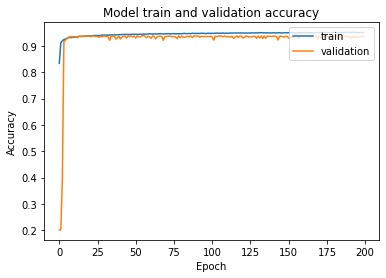

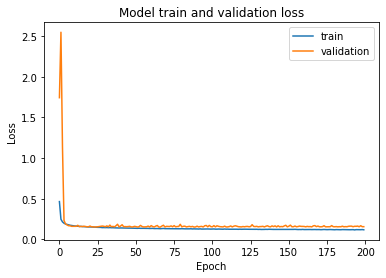


Training Accuracy Array:  [0.834225058555603, 0.9125689268112183, 0.9199985265731812, 0.9244459271430969, 0.9267695546150208, 0.9283309578895569, 0.9314759373664856, 0.9322603344917297, 0.9322973489761353, 0.9332149624824524, 0.9342731237411499, 0.9341251254081726, 0.9355607628822327, 0.9365893602371216, 0.9364561438560486, 0.936803936958313, 0.9370259642601013, 0.9384541511535645, 0.9382543563842773, 0.9385577440261841, 0.9388611316680908, 0.9382691383361816, 0.9397047162055969, 0.9402375221252441, 0.9400673508644104, 0.9402005672454834, 0.9398971199989319, 0.9405113458633423, 0.941650927066803, 0.941399335861206, 0.941650927066803, 0.9414363503456116, 0.9422207474708557, 0.9415399432182312, 0.9423835277557373, 0.9419987201690674, 0.942686915397644, 0.9425537586212158, 0.9428941607475281, 0.9433529376983643, 0.943204939365387, 0.9438709616661072, 0.9437451362609863, 0.9445813298225403, 0.9441225528717041, 0.9436489343643188, 0.9440411329269409, 0.9440041184425354, 0.944758951663971, 

In [ ]:
fcn_learning_high_SNR = fcn_model_signalType()

epochs = 200
batch_size = 1024

history = fcn_learning_high_SNR.fit(X_train, Y_train, epochs=epochs, batch_size=batch_size,  validation_data = (X_validation, Y_validation), shuffle=True, callbacks=[ES])

score = fcn_learning_high_SNR.evaluate(X_test, Y_test, verbose=0)
print('\nEvaluating on Test data : Score of SNR = ' + str(score[1]*100) +'\n')

summarize_model(history)
fcn_learning_high_SNR.save("/gdrive/My Drive/Signal Identification Model FCN/Signal Type/fcnFFTdata_highSNR_signalType.tf")

print("\nTraining Accuracy Array: ", history.history['accuracy'])
print("\nValidation Accuracy Array: ", history.history['val_accuracy'])

## Low SNR

In [ ]:
x_data_fft_low_SNR = x_data_fft_data[:,0:10]
y_labels_low_SNR = y_labels_data[:,0:10]

print(x_data_fft_low_SNR.shape)
print(y_labels_low_SNR.shape)

(15, 10, 715, 128, 2)
(15, 10, 715)


In [ ]:
x_dim = x_data_fft_low_SNR.shape
total_num_snapshots = x_dim[0]*x_dim[1]*x_dim[2]
num_snapshots_per_tech = x_dim[1]*x_dim[2]
num_tech = x_dim[0]
num_samples = x_dim[3]
print(num_snapshots_per_tech)

7150


In [ ]:
from sklearn.preprocessing import MinMaxScaler

# Bin wise scalers for FFT data from sklearn
scaler_01 = MinMaxScaler(feature_range=(0,1))

x_data_fft_low_SNR_1d = np.reshape(x_data_fft_low_SNR, (total_num_snapshots, num_samples*x_dim[4]))
fft_data_complex = np.reshape(x_data_fft_low_SNR_1d.flatten()[::2] + 1j*x_data_fft_low_SNR_1d.flatten()[1::2], (total_num_snapshots, num_samples))
x_data_fft_low_SNR_1d = scaler_01.fit_transform(np.absolute(fft_data_complex))

In [ ]:
y_labels_low_SNR = y_labels_low_SNR.flatten()

y_labels_one_hot_low_SNR = np.zeros(shape=(y_labels_low_SNR.shape[0],3))
for i in range(y_labels_low_SNR.shape[0]):
  if(0<=y_labels_low_SNR[i] and y_labels_low_SNR[i]<=9):
    y_labels_one_hot_low_SNR[i][0] = 1
  elif(10<=y_labels_low_SNR[i] and y_labels_low_SNR[i]<=12):
    y_labels_one_hot_low_SNR[i][1] = 1
  else:
    y_labels_one_hot_low_SNR[i][2] = 1

In [ ]:
y_labels_low_SNR.shape

(107250,)

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test_valid, Y_train, Y_test_valid = train_test_split(x_data_fft_low_SNR_1d, y_labels_one_hot_low_SNR, test_size=0.4)
X_validation, X_test, Y_validation, Y_test = train_test_split(X_test_valid, Y_test_valid, test_size=0.5)

In [ ]:
from keras.callbacks import EarlyStopping
ES = EarlyStopping(monitor = 'val_accuracy', mode = 'max', min_delta = 0.00001, patience = 200, verbose = 1)

import logging
logging.disable(logging.WARNING)

Epoch 1/200
63/63 [==============================] - 2s 15ms/step - loss: 0.9701 - accuracy: 0.5485 - val_loss: 0.9824 - val_accuracy: 0.4365
Epoch 2/200
63/63 [==============================] - 0s 7ms/step - loss: 0.5694 - accuracy: 0.7696 - val_loss: 1.2936 - val_accuracy: 0.1984
Epoch 3/200
63/63 [==============================] - 1s 9ms/step - loss: 0.4814 - accuracy: 0.8093 - val_loss: 1.7919 - val_accuracy: 0.1984
Epoch 4/200
63/63 [==============================] - 0s 7ms/step - loss: 0.4298 - accuracy: 0.8288 - val_loss: 2.1280 - val_accuracy: 0.1984
Epoch 5/200
63/63 [==============================] - 0s 7ms/step - loss: 0.4025 - accuracy: 0.8385 - val_loss: 2.1149 - val_accuracy: 0.1990
Epoch 6/200
63/63 [==============================] - 0s 7ms/step - loss: 0.3808 - accuracy: 0.8462 - val_loss: 1.7073 - val_accuracy: 0.2331
Epoch 7/200
63/63 [==============================] - 0s 7ms/step - loss: 0.3728 - accuracy: 0.8468 - val_loss: 1.0332 - val_accuracy: 0.4591
Epoch 8/200


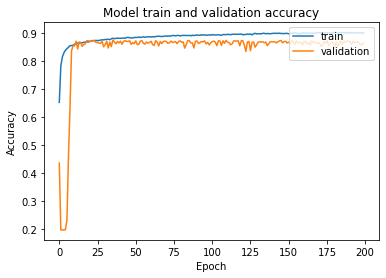

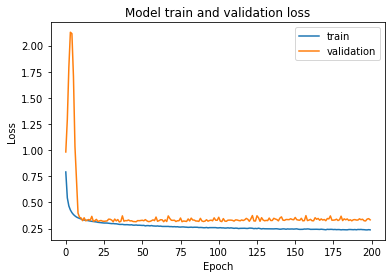


Training Accuracy Array:  [0.6533644199371338, 0.782843828201294, 0.8153069019317627, 0.8296658992767334, 0.8390986919403076, 0.8447707891464233, 0.8498368263244629, 0.855555534362793, 0.8557886481285095, 0.8571561574935913, 0.8599222898483276, 0.8641802668571472, 0.8648795485496521, 0.8647552728652954, 0.8663869500160217, 0.865547776222229, 0.8676612377166748, 0.8681429624557495, 0.8692929148674011, 0.869075357913971, 0.8699922561645508, 0.8731935024261475, 0.8737684488296509, 0.8735508918762207, 0.8743589520454407, 0.8735819458961487, 0.8741569519042969, 0.8755089640617371, 0.8764724135398865, 0.8760994672775269, 0.8778244256973267, 0.8773737549781799, 0.8786324858665466, 0.8767521381378174, 0.8798912167549133, 0.881926953792572, 0.8806992769241333, 0.8811344504356384, 0.8826573491096497, 0.881787121295929, 0.8816472291946411, 0.8818492889404297, 0.8828438520431519, 0.8819113969802856, 0.8844133615493774, 0.8852991461753845, 0.8835586905479431, 0.8829836845397949, 0.8832634091377258

In [ ]:
fcn_learning_low_SNR = fcn_model_signalType()

epochs = 200
batch_size = 1024

history = fcn_learning_low_SNR.fit(X_train, Y_train, epochs=epochs, batch_size=batch_size,  validation_data = (X_validation, Y_validation), shuffle=True, callbacks=[ES])

score = fcn_learning_low_SNR.evaluate(X_test, Y_test, verbose=0)
print('\nEvaluating on Test data : Score of SNR = ' + str(score[1]*100) +'\n')

summarize_model(history)
fcn_learning_low_SNR.save("/gdrive/My Drive/Signal Identification Model FCN/Signal Type/fcnFFTdata_lowSNR_signalType.tf")

print("\nTraining Accuracy Array: ", history.history['accuracy'])
print("\nValidation Accuracy Array: ", history.history['val_accuracy'])

## Training each SNR separately and transfer learning 

In [ ]:
x_dim = x_data_fft_data.shape
total_num_snapshots = x_dim[0]*x_dim[1]*x_dim[2]
num_snapshots_per_tech = x_dim[1]*x_dim[2]
num_tech = x_dim[0]
num_samples = x_dim[3]
print(num_snapshots_per_tech)

15015


In [ ]:
from sklearn.model_selection import train_test_split
from keras import models
from keras.utils.np_utils import to_categorical
import math

X_train_curr = np.zeros((math.floor(0.6*total_num_snapshots/21), num_samples, 2))
X_validation_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_samples, 2))
X_test_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_samples, 2))
Y_train_curr = np.zeros((math.floor(0.6*total_num_snapshots/21), num_tech))
Y_validation_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_tech))
Y_test_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_tech))

X_test_valid_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_samples, 2))
Y_test_valid_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_tech))

In [ ]:
print('X_train_curr.shape = ' + str(X_train_curr.shape))
print('X_validation_curr.shape = ' + str(X_validation_curr.shape))
print('X_test_curr.shape = ' + str(X_test_curr.shape))
print('Y_train_curr.shape = ' + str(Y_train_curr.shape))
print('Y_validation_curr.shape = ' + str(Y_validation_curr.shape))
print('Y_test_curr.shape = ' + str(Y_test_curr.shape))

X_train_curr.shape = (6435, 128, 2)
X_validation_curr.shape = (2145, 128, 2)
X_test_curr.shape = (2145, 128, 2)
Y_train_curr.shape = (6435, 15)
Y_validation_curr.shape = (2145, 15)
Y_test_curr.shape = (2145, 15)


In [ ]:
from matplotlib import pyplot

def summarize_model(history, i):

  pyplot.plot(history.history['accuracy'])
  pyplot.plot(history.history['val_accuracy']) 
  pyplot.title('Model train and validation accuracy - SNR ' + str(2*i-20))
  pyplot.ylabel('Accuracy')
  pyplot.xlabel('Epoch')
  pyplot.legend(['train', 'validation'], loc='upper right')
  pyplot.show()

  pyplot.plot(history.history['loss'])
  pyplot.plot(history.history['val_loss'])  
  pyplot.title('Model train and validation loss - SNR ' + str(2*i-20))
  pyplot.ylabel('Loss')
  pyplot.xlabel('Epoch')
  pyplot.legend(['train', 'validation'], loc='upper right')
  pyplot.show()

In [ ]:
from keras.callbacks import EarlyStopping
ES = EarlyStopping(monitor = 'val_accuracy', mode = 'max', min_delta = 0.001, patience = 60, verbose = 1)

import logging
logging.disable(logging.WARNING)

from sklearn.preprocessing import StandardScaler
scaler_std = StandardScaler()

In [ ]:
def Testing(X_test_curr, Y_test_curr, i):
  
  all_snr_model = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/Signal Type/fcnFFTdata_allSNR_signalType.tf"))

  score = all_snr_model.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('\nScore of SNR on All SNR model without Transfer Learning ' + str(2*i-20) + ' = ' + str(score[1]*100))

  high_snr_model = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/Signal Type/fcnFFTdata_highSNR_signalType.tf"))

  score = high_snr_model.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('Score of SNR on High SNR model without Transfer Learning ' + str(2*i-20) + ' = ' + str(score[1]*100))

  low_snr_model = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/Signal Type/fcnFFTdata_lowSNR_signalType.tf"))

  score = low_snr_model.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('Score of SNR on low SNR model without Transfer Learning ' + str(2*i-20) + ' = ' + str(score[1]*100))

In [ ]:
def train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i):
  
  print("\nTraining SNR = "+str(2*i-20)+" Data\n")

  lstm_model_cur = fcn_model_signalType()
  history = lstm_model_cur.fit(X_train_curr, Y_train_curr, validation_data = (X_validation_curr, Y_validation_curr), epochs=200, batch_size=1024)

  score = lstm_model_cur.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('\nEvaluating on Test data : Score of SNR ' + str(2*i-20) + ' = ' + str(score[1]*100) +'\n')

  summarize_model(history, i)
  lstm_model_cur.save("/gdrive/My Drive/Signal Identification Model FCN/Signal Type/SNR separately/fcnFFTdata_SNR_"+str(2*i-20)+"_signalType.tf")
  del history, lstm_model_cur

In [ ]:
def train_data_on_all_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i):
  
  print("\nTraining SNR = "+str(2*i-20)+" Data on a pre-trained All SNR model\n")

  lstm_model_cur = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/Signal Type/fcnFFTdata_allSNR_signalType.tf"))
  lstm_model_cur.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
  history = lstm_model_cur.fit(X_train_curr, Y_train_curr, validation_data = (X_validation_curr, Y_validation_curr), epochs=200, batch_size=1024, callbacks=[ES])

  score = lstm_model_cur.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('\nEvaluating on Test data : Score of SNR ' + str(2*i-20) + ' = ' + str(score[1]*100) +'\n')

  summarize_model(history, i)
  lstm_model_cur.save("/gdrive/My Drive/Signal Identification Model FCN/Signal Type/Transfer Learning/fcnFFTdata_allSNR_to_SNR_"+str(2*i-20)+"_signalType.tf")
  del history, lstm_model_cur

In [ ]:
def train_data_on_high_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i):
  
  print("\nTraining SNR = "+str(2*i-20)+" Data on a pre-trained High SNR model\n")

  lstm_model_cur = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/Signal Type/fcnFFTdata_highSNR_signalType.tf"))
  lstm_model_cur.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
  history = lstm_model_cur.fit(X_train_curr, Y_train_curr, validation_data = (X_validation_curr, Y_validation_curr), epochs=200, batch_size=1024, callbacks=[ES])

  score = lstm_model_cur.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('\nEvaluating on Test data : Score of SNR ' + str(2*i-20) + ' = ' + str(score[1]*100) +'\n')

  summarize_model(history, i)
  lstm_model_cur.save("/gdrive/My Drive/Signal Identification Model FCN/Signal Type/Transfer Learning/fcnFFTdata_highSNR_to_SNR_"+str(2*i-20)+"_signalType.tf")
  del history, lstm_model_cur

In [ ]:
def train_data_on_low_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i):
  
  print("\nTraining SNR = "+str(2*i-20)+" Data on a pre-trained Low SNR model\n")

  lstm_model_cur = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/Signal Type/fcnFFTdata_lowSNR_signalType.tf"))
  lstm_model_cur.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
  history = lstm_model_cur.fit(X_train_curr, Y_train_curr, validation_data = (X_validation_curr, Y_validation_curr), epochs=200, batch_size=1024, callbacks=[ES])

  score = lstm_model_cur.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('\nEvaluating on Test data : Score of SNR ' + str(2*i-20) + ' = ' + str(score[1]*100) +'\n')

  summarize_model(history, i)
  lstm_model_cur.save("/gdrive/My Drive/Signal Identification Model FCN/Signal Type/Transfer Learning/fcnFFTdata_lowSNR_to_SNR_"+str(2*i-20)+"_signalType.tf")
  del history, lstm_model_cur


Score of SNR on All SNR model without Transfer Learning -20 = 67.73892641067505
Score of SNR on High SNR model without Transfer Learning -20 = 67.17948913574219
Score of SNR on low SNR model without Transfer Learning -20 = 67.50582456588745

Training SNR = -20 Data

Epoch 1/200
7/7 [==============================] - 1s 60ms/step - loss: 1.5014 - accuracy: 0.2865 - val_loss: 1.0454 - val_accuracy: 0.5893
Epoch 2/200
7/7 [==============================] - 0s 8ms/step - loss: 1.2251 - accuracy: 0.3441 - val_loss: 1.0606 - val_accuracy: 0.4727
Epoch 3/200
7/7 [==============================] - 0s 8ms/step - loss: 1.0816 - accuracy: 0.4172 - val_loss: 1.0408 - val_accuracy: 0.5324
Epoch 4/200
7/7 [==============================] - 0s 8ms/step - loss: 0.9869 - accuracy: 0.4919 - val_loss: 0.9945 - val_accuracy: 0.6364
Epoch 5/200
7/7 [==============================] - 0s 8ms/step - loss: 0.9284 - accuracy: 0.5471 - val_loss: 0.9574 - val_accuracy: 0.6541
Epoch 6/200
7/7 [===================

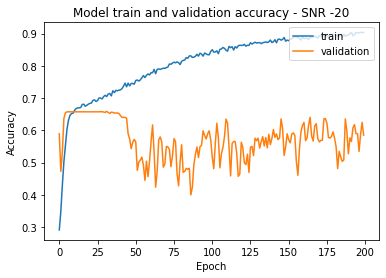

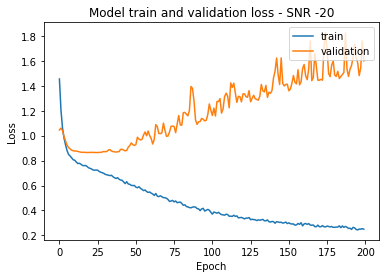


Training SNR = -20 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 1s 64ms/step - loss: 2.7866 - accuracy: 0.6390 - val_loss: 2.1211 - val_accuracy: 0.6634
Epoch 2/200
7/7 [==============================] - 0s 8ms/step - loss: 2.4398 - accuracy: 0.6583 - val_loss: 2.8644 - val_accuracy: 0.6611
Epoch 3/200
7/7 [==============================] - 0s 9ms/step - loss: 2.2599 - accuracy: 0.6596 - val_loss: 3.2373 - val_accuracy: 0.6611
Epoch 4/200
7/7 [==============================] - 0s 9ms/step - loss: 2.1042 - accuracy: 0.6680 - val_loss: 3.3366 - val_accuracy: 0.6587
Epoch 5/200
7/7 [==============================] - 0s 8ms/step - loss: 1.9287 - accuracy: 0.6697 - val_loss: 3.2807 - val_accuracy: 0.6559
Epoch 6/200
7/7 [==============================] - 0s 8ms/step - loss: 1.7835 - accuracy: 0.6727 - val_loss: 3.1620 - val_accuracy: 0.6457
Epoch 7/200
7/7 [==============================] - 0s 8ms/step - loss: 1.6937 - accuracy: 0.6782 - val_loss:

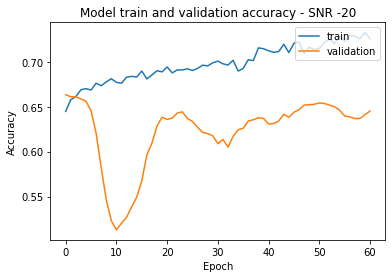

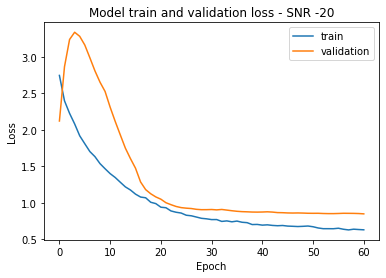


Training SNR = -20 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 1s 60ms/step - loss: 2.7436 - accuracy: 0.6464 - val_loss: 2.2138 - val_accuracy: 0.6587
Epoch 2/200
7/7 [==============================] - 0s 8ms/step - loss: 2.4600 - accuracy: 0.6586 - val_loss: 2.9012 - val_accuracy: 0.6592
Epoch 3/200
7/7 [==============================] - 0s 9ms/step - loss: 2.2367 - accuracy: 0.6655 - val_loss: 3.0645 - val_accuracy: 0.6601
Epoch 4/200
7/7 [==============================] - 0s 9ms/step - loss: 2.0451 - accuracy: 0.6743 - val_loss: 3.1081 - val_accuracy: 0.6592
Epoch 5/200
7/7 [==============================] - 0s 8ms/step - loss: 1.9780 - accuracy: 0.6686 - val_loss: 3.0085 - val_accuracy: 0.6545
Epoch 6/200
7/7 [==============================] - 0s 8ms/step - loss: 1.8314 - accuracy: 0.6738 - val_loss: 2.9021 - val_accuracy: 0.6471
Epoch 7/200
7/7 [==============================] - 0s 8ms/step - loss: 1.7749 - accuracy: 0.6619 - val_loss

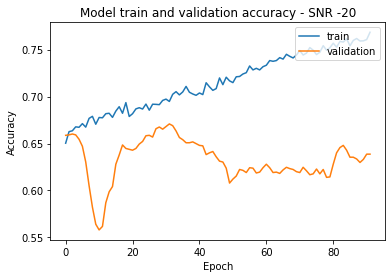

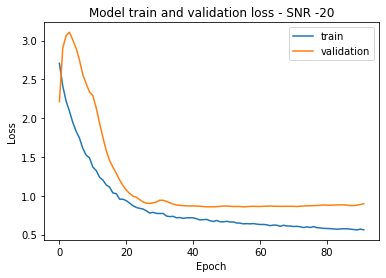


Training SNR = -20 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 1s 61ms/step - loss: 1.7645 - accuracy: 0.6423 - val_loss: 2.0368 - val_accuracy: 0.6583
Epoch 2/200
7/7 [==============================] - 0s 8ms/step - loss: 1.5467 - accuracy: 0.6575 - val_loss: 2.8636 - val_accuracy: 0.6587
Epoch 3/200
7/7 [==============================] - 0s 8ms/step - loss: 1.4373 - accuracy: 0.6583 - val_loss: 3.2366 - val_accuracy: 0.6587
Epoch 4/200
7/7 [==============================] - 0s 8ms/step - loss: 1.3241 - accuracy: 0.6664 - val_loss: 3.0563 - val_accuracy: 0.6597
Epoch 5/200
7/7 [==============================] - 0s 9ms/step - loss: 1.2160 - accuracy: 0.6747 - val_loss: 2.6706 - val_accuracy: 0.6620
Epoch 6/200
7/7 [==============================] - 0s 8ms/step - loss: 1.1692 - accuracy: 0.6785 - val_loss: 2.2294 - val_accuracy: 0.6611
Epoch 7/200
7/7 [==============================] - 0s 10ms/step - loss: 1.1502 - accuracy: 0.6662 - val_loss

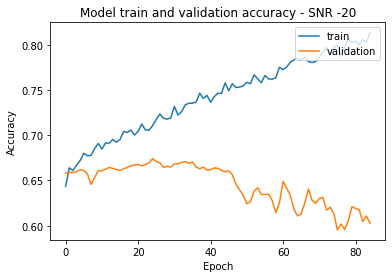

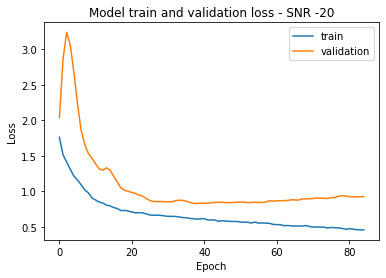


Score of SNR on All SNR model without Transfer Learning -18 = 67.45920777320862
Score of SNR on High SNR model without Transfer Learning -18 = 67.78554916381836
Score of SNR on low SNR model without Transfer Learning -18 = 67.08624958992004

Training SNR = -18 Data

Epoch 1/200
7/7 [==============================] - 1s 64ms/step - loss: 1.2748 - accuracy: 0.3810 - val_loss: 1.0862 - val_accuracy: 0.4392
Epoch 2/200
7/7 [==============================] - 0s 8ms/step - loss: 1.0314 - accuracy: 0.4937 - val_loss: 1.0380 - val_accuracy: 0.6126
Epoch 3/200
7/7 [==============================] - 0s 8ms/step - loss: 0.9196 - accuracy: 0.5731 - val_loss: 1.0113 - val_accuracy: 0.6396
Epoch 4/200
7/7 [==============================] - 0s 8ms/step - loss: 0.8776 - accuracy: 0.6168 - val_loss: 0.9980 - val_accuracy: 0.6508
Epoch 5/200
7/7 [==============================] - 0s 8ms/step - loss: 0.8298 - accuracy: 0.6384 - val_loss: 0.9841 - val_accuracy: 0.6578
Epoch 6/200
7/7 [===================

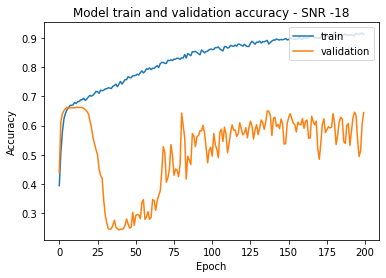

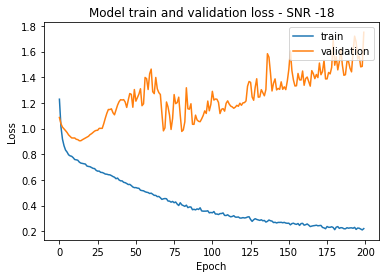


Training SNR = -18 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 1s 63ms/step - loss: 2.3249 - accuracy: 0.6579 - val_loss: 1.2929 - val_accuracy: 0.6671
Epoch 2/200
7/7 [==============================] - 0s 8ms/step - loss: 2.0326 - accuracy: 0.6724 - val_loss: 1.5790 - val_accuracy: 0.6424
Epoch 3/200
7/7 [==============================] - 0s 8ms/step - loss: 1.8265 - accuracy: 0.6888 - val_loss: 1.8403 - val_accuracy: 0.6145
Epoch 4/200
7/7 [==============================] - 0s 8ms/step - loss: 1.7090 - accuracy: 0.6894 - val_loss: 2.0773 - val_accuracy: 0.5772
Epoch 5/200
7/7 [==============================] - 0s 9ms/step - loss: 1.6663 - accuracy: 0.6829 - val_loss: 2.1920 - val_accuracy: 0.5650
Epoch 6/200
7/7 [==============================] - 0s 8ms/step - loss: 1.5128 - accuracy: 0.6895 - val_loss: 2.2936 - val_accuracy: 0.5152
Epoch 7/200
7/7 [==============================] - 0s 8ms/step - loss: 1.4960 - accuracy: 0.6889 - val_loss:

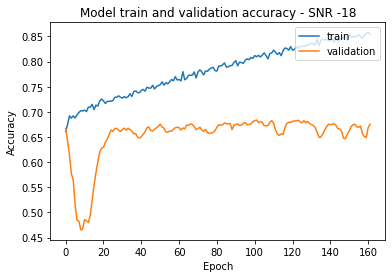

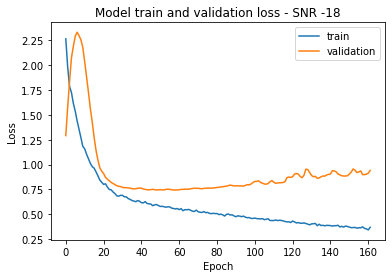


Training SNR = -18 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 1s 62ms/step - loss: 2.2339 - accuracy: 0.6732 - val_loss: 1.3827 - val_accuracy: 0.6378
Epoch 2/200
7/7 [==============================] - 0s 9ms/step - loss: 1.9479 - accuracy: 0.6828 - val_loss: 1.6770 - val_accuracy: 0.5981
Epoch 3/200
7/7 [==============================] - 0s 8ms/step - loss: 1.7787 - accuracy: 0.6909 - val_loss: 1.9839 - val_accuracy: 0.5469
Epoch 4/200
7/7 [==============================] - 0s 9ms/step - loss: 1.7257 - accuracy: 0.6877 - val_loss: 2.2147 - val_accuracy: 0.5086
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 1.5911 - accuracy: 0.6895 - val_loss: 2.3593 - val_accuracy: 0.4797
Epoch 6/200
7/7 [==============================] - 0s 8ms/step - loss: 1.4712 - accuracy: 0.6960 - val_loss: 2.3905 - val_accuracy: 0.4779
Epoch 7/200
7/7 [==============================] - 0s 9ms/step - loss: 1.4352 - accuracy: 0.6921 - val_los

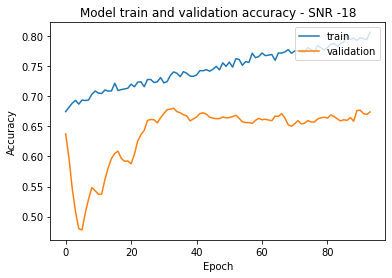

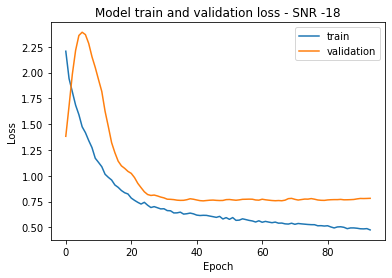


Training SNR = -18 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 1s 64ms/step - loss: 1.3650 - accuracy: 0.6845 - val_loss: 1.3841 - val_accuracy: 0.6685
Epoch 2/200
7/7 [==============================] - 0s 8ms/step - loss: 1.2559 - accuracy: 0.6861 - val_loss: 1.4952 - val_accuracy: 0.6573
Epoch 3/200
7/7 [==============================] - 0s 8ms/step - loss: 1.1196 - accuracy: 0.6984 - val_loss: 1.5958 - val_accuracy: 0.6508
Epoch 4/200
7/7 [==============================] - 0s 8ms/step - loss: 1.0559 - accuracy: 0.7079 - val_loss: 1.6359 - val_accuracy: 0.6089
Epoch 5/200
7/7 [==============================] - 0s 9ms/step - loss: 0.9600 - accuracy: 0.7090 - val_loss: 1.6653 - val_accuracy: 0.5841
Epoch 6/200
7/7 [==============================] - 0s 8ms/step - loss: 0.9330 - accuracy: 0.7047 - val_loss: 1.6326 - val_accuracy: 0.5781
Epoch 7/200
7/7 [==============================] - 0s 8ms/step - loss: 0.9033 - accuracy: 0.7058 - val_loss:

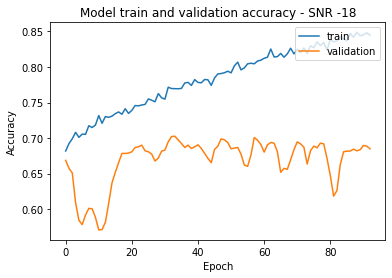

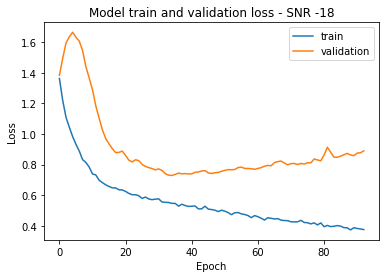


Score of SNR on All SNR model without Transfer Learning -16 = 69.18414831161499
Score of SNR on High SNR model without Transfer Learning -16 = 68.67132782936096
Score of SNR on low SNR model without Transfer Learning -16 = 68.48484873771667

Training SNR = -16 Data

Epoch 1/200
7/7 [==============================] - 2s 68ms/step - loss: 1.6211 - accuracy: 0.2368 - val_loss: 1.0374 - val_accuracy: 0.6252
Epoch 2/200
7/7 [==============================] - 0s 8ms/step - loss: 1.3031 - accuracy: 0.3369 - val_loss: 1.0070 - val_accuracy: 0.6685
Epoch 3/200
7/7 [==============================] - 0s 8ms/step - loss: 1.1237 - accuracy: 0.4389 - val_loss: 0.9940 - val_accuracy: 0.6751
Epoch 4/200
7/7 [==============================] - 0s 8ms/step - loss: 1.0282 - accuracy: 0.5057 - val_loss: 0.9828 - val_accuracy: 0.6788
Epoch 5/200
7/7 [==============================] - 0s 8ms/step - loss: 0.9379 - accuracy: 0.5599 - val_loss: 0.9675 - val_accuracy: 0.6807
Epoch 6/200
7/7 [===================

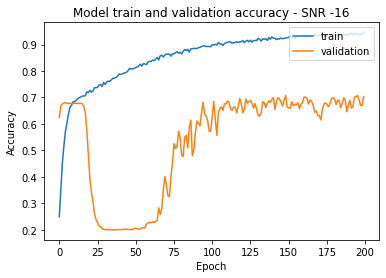

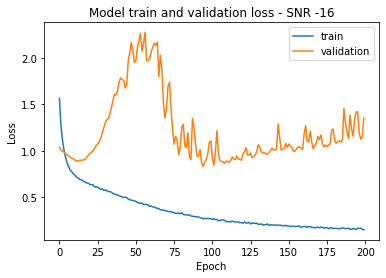


Training SNR = -16 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 1s 62ms/step - loss: 1.6361 - accuracy: 0.7042 - val_loss: 1.0511 - val_accuracy: 0.7170
Epoch 2/200
7/7 [==============================] - 0s 9ms/step - loss: 1.3603 - accuracy: 0.7365 - val_loss: 1.5670 - val_accuracy: 0.7082
Epoch 3/200
7/7 [==============================] - 0s 8ms/step - loss: 1.2417 - accuracy: 0.7363 - val_loss: 1.9642 - val_accuracy: 0.7068
Epoch 4/200
7/7 [==============================] - 0s 9ms/step - loss: 1.2081 - accuracy: 0.7327 - val_loss: 2.2491 - val_accuracy: 0.7049
Epoch 5/200
7/7 [==============================] - 0s 8ms/step - loss: 1.1619 - accuracy: 0.7463 - val_loss: 2.2668 - val_accuracy: 0.7002
Epoch 6/200
7/7 [==============================] - 0s 9ms/step - loss: 1.0642 - accuracy: 0.7466 - val_loss: 2.1685 - val_accuracy: 0.6937
Epoch 7/200
7/7 [==============================] - 0s 8ms/step - loss: 0.9718 - accuracy: 0.7521 - val_loss:

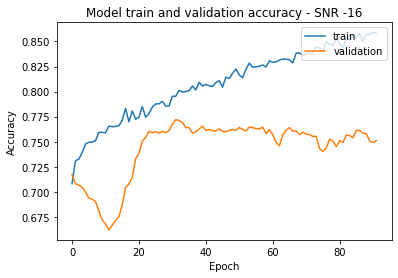

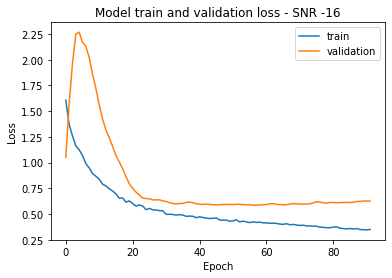


Training SNR = -16 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 2s 66ms/step - loss: 1.6514 - accuracy: 0.7096 - val_loss: 1.1875 - val_accuracy: 0.7100
Epoch 2/200
7/7 [==============================] - 0s 9ms/step - loss: 1.4261 - accuracy: 0.7313 - val_loss: 1.5728 - val_accuracy: 0.7058
Epoch 3/200
7/7 [==============================] - 0s 9ms/step - loss: 1.2760 - accuracy: 0.7344 - val_loss: 1.7789 - val_accuracy: 0.7119
Epoch 4/200
7/7 [==============================] - 0s 9ms/step - loss: 1.1496 - accuracy: 0.7473 - val_loss: 1.9136 - val_accuracy: 0.7147
Epoch 5/200
7/7 [==============================] - 0s 9ms/step - loss: 1.0950 - accuracy: 0.7539 - val_loss: 1.8857 - val_accuracy: 0.7128
Epoch 6/200
7/7 [==============================] - 0s 9ms/step - loss: 1.0588 - accuracy: 0.7516 - val_loss: 1.7917 - val_accuracy: 0.7114
Epoch 7/200
7/7 [==============================] - 0s 9ms/step - loss: 1.0380 - accuracy: 0.7463 - val_loss

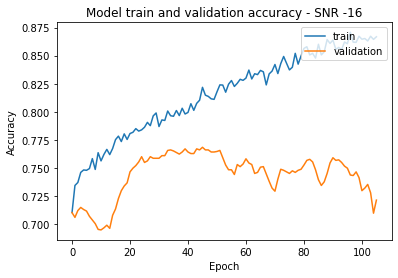

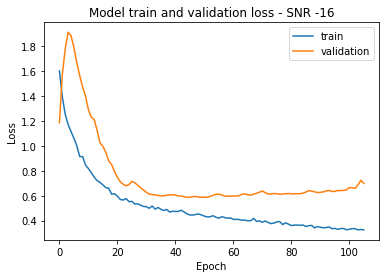


Training SNR = -16 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 1s 63ms/step - loss: 0.9384 - accuracy: 0.7382 - val_loss: 1.3414 - val_accuracy: 0.7016
Epoch 2/200
7/7 [==============================] - 0s 9ms/step - loss: 0.8374 - accuracy: 0.7530 - val_loss: 1.6091 - val_accuracy: 0.7114
Epoch 3/200
7/7 [==============================] - 0s 9ms/step - loss: 0.7576 - accuracy: 0.7605 - val_loss: 1.7033 - val_accuracy: 0.7170
Epoch 4/200
7/7 [==============================] - 0s 9ms/step - loss: 0.7237 - accuracy: 0.7580 - val_loss: 1.8703 - val_accuracy: 0.7170
Epoch 5/200
7/7 [==============================] - 0s 9ms/step - loss: 0.6782 - accuracy: 0.7647 - val_loss: 1.7981 - val_accuracy: 0.7198
Epoch 6/200
7/7 [==============================] - 0s 9ms/step - loss: 0.6522 - accuracy: 0.7653 - val_loss: 1.6012 - val_accuracy: 0.7221
Epoch 7/200
7/7 [==============================] - 0s 9ms/step - loss: 0.6116 - accuracy: 0.7738 - val_loss:

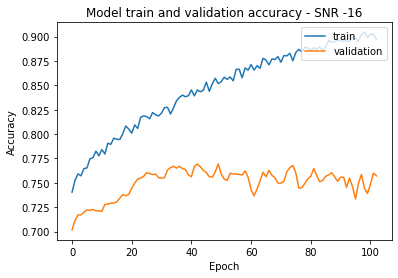

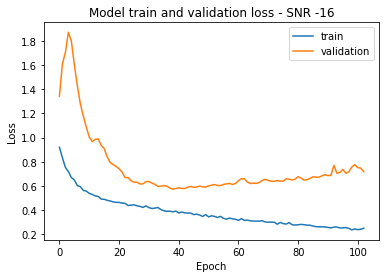


Score of SNR on All SNR model without Transfer Learning -14 = 72.72727489471436
Score of SNR on High SNR model without Transfer Learning -14 = 71.79487347602844
Score of SNR on low SNR model without Transfer Learning -14 = 70.53613066673279

Training SNR = -14 Data

Epoch 1/200
7/7 [==============================] - 2s 63ms/step - loss: 1.2448 - accuracy: 0.3737 - val_loss: 1.0364 - val_accuracy: 0.6606
Epoch 2/200
7/7 [==============================] - 0s 8ms/step - loss: 0.9387 - accuracy: 0.5394 - val_loss: 1.0274 - val_accuracy: 0.6564
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 0.8184 - accuracy: 0.6192 - val_loss: 1.0147 - val_accuracy: 0.6653
Epoch 4/200
7/7 [==============================] - 0s 9ms/step - loss: 0.7578 - accuracy: 0.6627 - val_loss: 0.9968 - val_accuracy: 0.6802
Epoch 5/200
7/7 [==============================] - 0s 9ms/step - loss: 0.7206 - accuracy: 0.6899 - val_loss: 0.9767 - val_accuracy: 0.6802
Epoch 6/200
7/7 [==================

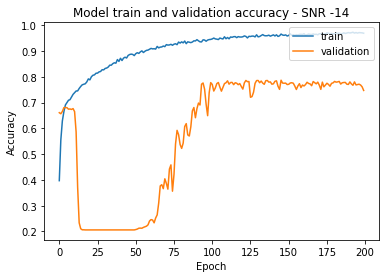

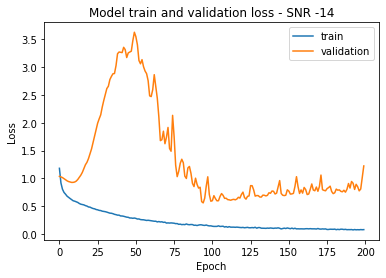


Training SNR = -14 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 1s 63ms/step - loss: 0.9733 - accuracy: 0.7741 - val_loss: 0.6862 - val_accuracy: 0.7231
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 0.7996 - accuracy: 0.8011 - val_loss: 0.8697 - val_accuracy: 0.6979
Epoch 3/200
7/7 [==============================] - 0s 8ms/step - loss: 0.6793 - accuracy: 0.8141 - val_loss: 1.0311 - val_accuracy: 0.6788
Epoch 4/200
7/7 [==============================] - 0s 9ms/step - loss: 0.6628 - accuracy: 0.8200 - val_loss: 1.1348 - val_accuracy: 0.6690
Epoch 5/200
7/7 [==============================] - 0s 9ms/step - loss: 0.6398 - accuracy: 0.8271 - val_loss: 1.1626 - val_accuracy: 0.6685
Epoch 6/200
7/7 [==============================] - 0s 9ms/step - loss: 0.5887 - accuracy: 0.8300 - val_loss: 1.1458 - val_accuracy: 0.6681
Epoch 7/200
7/7 [==============================] - 0s 8ms/step - loss: 0.5562 - accuracy: 0.8335 - val_loss

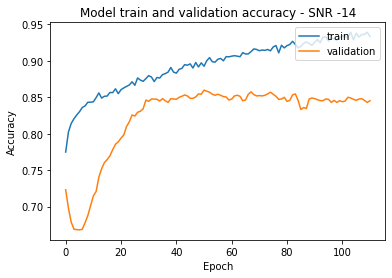

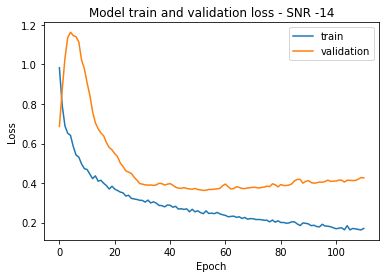


Training SNR = -14 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 2s 64ms/step - loss: 0.9777 - accuracy: 0.7722 - val_loss: 0.7746 - val_accuracy: 0.7105
Epoch 2/200
7/7 [==============================] - 0s 12ms/step - loss: 0.7903 - accuracy: 0.8008 - val_loss: 0.9413 - val_accuracy: 0.6834
Epoch 3/200
7/7 [==============================] - 0s 8ms/step - loss: 0.7001 - accuracy: 0.8106 - val_loss: 1.0371 - val_accuracy: 0.6788
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.6553 - accuracy: 0.8226 - val_loss: 1.0846 - val_accuracy: 0.6853
Epoch 5/200
7/7 [==============================] - 0s 9ms/step - loss: 0.6157 - accuracy: 0.8285 - val_loss: 1.1156 - val_accuracy: 0.6834
Epoch 6/200
7/7 [==============================] - 0s 10ms/step - loss: 0.5579 - accuracy: 0.8390 - val_loss: 1.1442 - val_accuracy: 0.6765
Epoch 7/200
7/7 [==============================] - 0s 11ms/step - loss: 0.5462 - accuracy: 0.8336 - val_

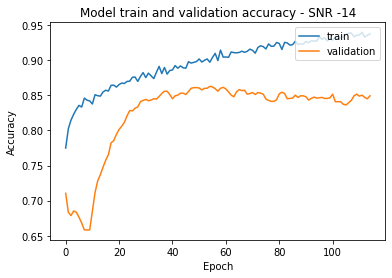

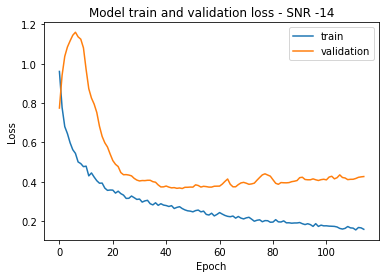


Training SNR = -14 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 2s 64ms/step - loss: 0.5174 - accuracy: 0.8168 - val_loss: 0.7054 - val_accuracy: 0.7291
Epoch 2/200
7/7 [==============================] - 0s 9ms/step - loss: 0.4637 - accuracy: 0.8279 - val_loss: 0.8095 - val_accuracy: 0.7273
Epoch 3/200
7/7 [==============================] - 0s 9ms/step - loss: 0.4361 - accuracy: 0.8410 - val_loss: 0.9444 - val_accuracy: 0.7221
Epoch 4/200
7/7 [==============================] - 0s 10ms/step - loss: 0.4131 - accuracy: 0.8372 - val_loss: 1.0154 - val_accuracy: 0.7114
Epoch 5/200
7/7 [==============================] - 0s 9ms/step - loss: 0.3795 - accuracy: 0.8500 - val_loss: 1.0070 - val_accuracy: 0.6928
Epoch 6/200
7/7 [==============================] - 0s 9ms/step - loss: 0.3842 - accuracy: 0.8511 - val_loss: 1.0035 - val_accuracy: 0.6881
Epoch 7/200
7/7 [==============================] - 0s 10ms/step - loss: 0.3540 - accuracy: 0.8546 - val_los

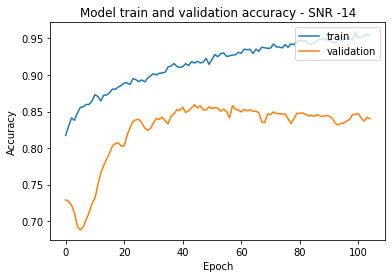

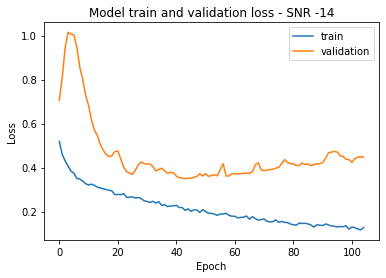


Score of SNR on All SNR model without Transfer Learning -12 = 78.04195880889893
Score of SNR on High SNR model without Transfer Learning -12 = 76.96969509124756
Score of SNR on low SNR model without Transfer Learning -12 = 74.26573634147644

Training SNR = -12 Data

Epoch 1/200
7/7 [==============================] - 2s 68ms/step - loss: 1.0825 - accuracy: 0.4940 - val_loss: 1.0109 - val_accuracy: 0.7007
Epoch 2/200
7/7 [==============================] - 0s 9ms/step - loss: 0.8085 - accuracy: 0.6521 - val_loss: 0.9977 - val_accuracy: 0.7063
Epoch 3/200
7/7 [==============================] - 0s 8ms/step - loss: 0.6962 - accuracy: 0.6970 - val_loss: 0.9928 - val_accuracy: 0.7124
Epoch 4/200
7/7 [==============================] - 0s 9ms/step - loss: 0.6293 - accuracy: 0.7273 - val_loss: 0.9921 - val_accuracy: 0.7133
Epoch 5/200
7/7 [==============================] - 0s 8ms/step - loss: 0.5942 - accuracy: 0.7454 - val_loss: 1.0018 - val_accuracy: 0.6765
Epoch 6/200
7/7 [===================

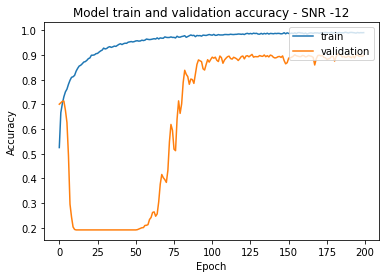

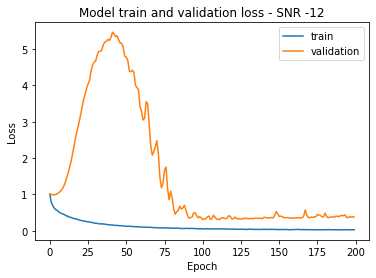


Training SNR = -12 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 1s 62ms/step - loss: 0.5077 - accuracy: 0.8517 - val_loss: 0.4605 - val_accuracy: 0.8196
Epoch 2/200
7/7 [==============================] - 0s 9ms/step - loss: 0.3431 - accuracy: 0.8906 - val_loss: 0.5825 - val_accuracy: 0.8075
Epoch 3/200
7/7 [==============================] - 0s 10ms/step - loss: 0.2991 - accuracy: 0.8988 - val_loss: 0.7041 - val_accuracy: 0.7869
Epoch 4/200
7/7 [==============================] - 0s 12ms/step - loss: 0.2721 - accuracy: 0.9096 - val_loss: 0.8106 - val_accuracy: 0.7730
Epoch 5/200
7/7 [==============================] - 0s 9ms/step - loss: 0.2510 - accuracy: 0.9121 - val_loss: 0.8518 - val_accuracy: 0.7688
Epoch 6/200
7/7 [==============================] - 0s 9ms/step - loss: 0.2502 - accuracy: 0.9175 - val_loss: 0.7952 - val_accuracy: 0.7818
Epoch 7/200
7/7 [==============================] - 0s 10ms/step - loss: 0.2182 - accuracy: 0.9242 - val_lo

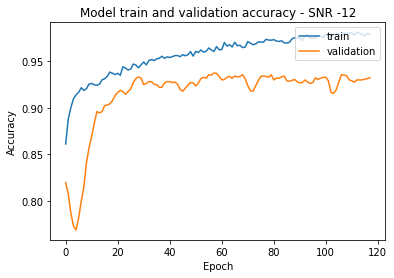

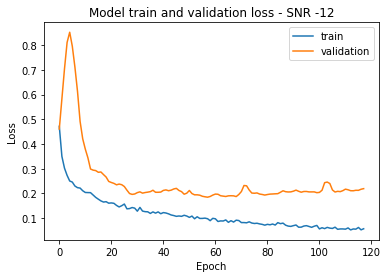


Training SNR = -12 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 1s 61ms/step - loss: 0.5208 - accuracy: 0.8468 - val_loss: 0.5556 - val_accuracy: 0.8159
Epoch 2/200
7/7 [==============================] - 0s 12ms/step - loss: 0.3619 - accuracy: 0.8827 - val_loss: 0.7287 - val_accuracy: 0.7916
Epoch 3/200
7/7 [==============================] - 0s 9ms/step - loss: 0.2917 - accuracy: 0.9058 - val_loss: 0.7785 - val_accuracy: 0.7786
Epoch 4/200
7/7 [==============================] - 0s 9ms/step - loss: 0.2913 - accuracy: 0.9024 - val_loss: 0.7396 - val_accuracy: 0.7818
Epoch 5/200
7/7 [==============================] - 0s 9ms/step - loss: 0.2499 - accuracy: 0.9125 - val_loss: 0.6844 - val_accuracy: 0.7939
Epoch 6/200
7/7 [==============================] - 0s 9ms/step - loss: 0.2386 - accuracy: 0.9215 - val_loss: 0.6432 - val_accuracy: 0.8033
Epoch 7/200
7/7 [==============================] - 0s 10ms/step - loss: 0.2218 - accuracy: 0.9232 - val_lo

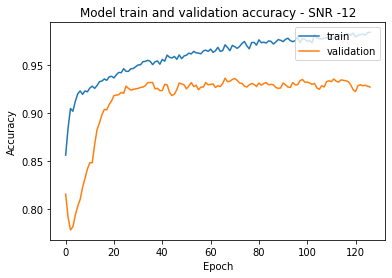

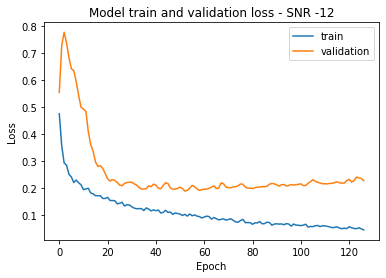


Training SNR = -12 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 2s 65ms/step - loss: 0.2937 - accuracy: 0.8918 - val_loss: 0.5322 - val_accuracy: 0.8145
Epoch 2/200
7/7 [==============================] - 0s 9ms/step - loss: 0.2301 - accuracy: 0.9090 - val_loss: 0.6183 - val_accuracy: 0.7874
Epoch 3/200
7/7 [==============================] - 0s 10ms/step - loss: 0.2194 - accuracy: 0.9171 - val_loss: 0.5810 - val_accuracy: 0.7823
Epoch 4/200
7/7 [==============================] - 0s 10ms/step - loss: 0.2098 - accuracy: 0.9201 - val_loss: 0.5649 - val_accuracy: 0.7818
Epoch 5/200
7/7 [==============================] - 0s 9ms/step - loss: 0.1979 - accuracy: 0.9214 - val_loss: 0.5267 - val_accuracy: 0.7991
Epoch 6/200
7/7 [==============================] - 0s 11ms/step - loss: 0.1903 - accuracy: 0.9250 - val_loss: 0.4930 - val_accuracy: 0.8107
Epoch 7/200
7/7 [==============================] - 0s 9ms/step - loss: 0.1817 - accuracy: 0.9283 - val_lo

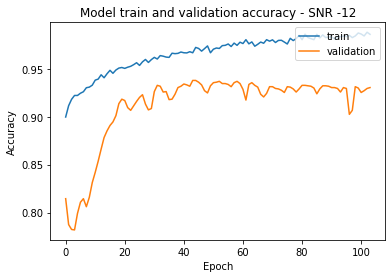

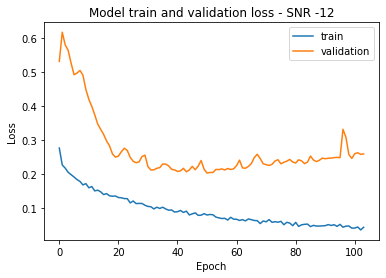


Score of SNR on All SNR model without Transfer Learning -10 = 86.80652976036072
Score of SNR on High SNR model without Transfer Learning -10 = 86.24708652496338
Score of SNR on low SNR model without Transfer Learning -10 = 83.49650502204895

Training SNR = -10 Data

Epoch 1/200
7/7 [==============================] - 2s 63ms/step - loss: 1.3337 - accuracy: 0.3777 - val_loss: 1.0797 - val_accuracy: 0.3198
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 0.9412 - accuracy: 0.5945 - val_loss: 1.1018 - val_accuracy: 0.1758
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 0.7725 - accuracy: 0.6951 - val_loss: 1.1027 - val_accuracy: 0.1688
Epoch 4/200
7/7 [==============================] - 0s 10ms/step - loss: 0.6642 - accuracy: 0.7446 - val_loss: 1.0938 - val_accuracy: 0.2737
Epoch 5/200
7/7 [==============================] - 0s 9ms/step - loss: 0.5741 - accuracy: 0.7900 - val_loss: 1.0833 - val_accuracy: 0.3664
Epoch 6/200
7/7 [================

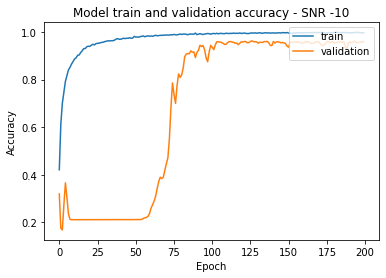

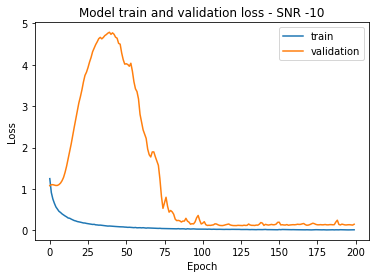


Training SNR = -10 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 1s 63ms/step - loss: 0.2069 - accuracy: 0.9238 - val_loss: 0.6736 - val_accuracy: 0.8364
Epoch 2/200
7/7 [==============================] - 0s 9ms/step - loss: 0.1456 - accuracy: 0.9456 - val_loss: 1.0356 - val_accuracy: 0.7888
Epoch 3/200
7/7 [==============================] - 0s 9ms/step - loss: 0.1309 - accuracy: 0.9518 - val_loss: 1.1588 - val_accuracy: 0.7683
Epoch 4/200
7/7 [==============================] - 0s 9ms/step - loss: 0.1158 - accuracy: 0.9567 - val_loss: 1.1923 - val_accuracy: 0.7660
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 0.1025 - accuracy: 0.9593 - val_loss: 1.1131 - val_accuracy: 0.7781
Epoch 6/200
7/7 [==============================] - 0s 9ms/step - loss: 0.1059 - accuracy: 0.9609 - val_loss: 1.0194 - val_accuracy: 0.7888
Epoch 7/200
7/7 [==============================] - 0s 14ms/step - loss: 0.1118 - accuracy: 0.9615 - val_los

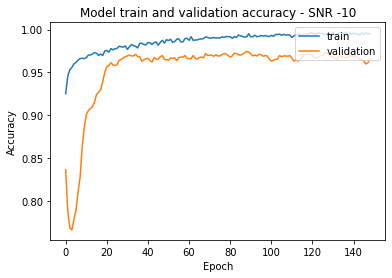

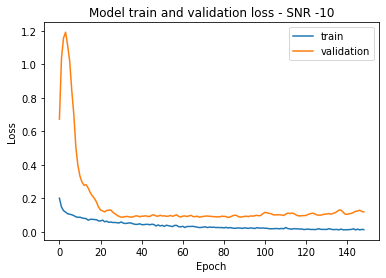


Training SNR = -10 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 2s 64ms/step - loss: 0.2222 - accuracy: 0.9244 - val_loss: 0.6473 - val_accuracy: 0.8382
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 0.1557 - accuracy: 0.9455 - val_loss: 1.1612 - val_accuracy: 0.7762
Epoch 3/200
7/7 [==============================] - 0s 10ms/step - loss: 0.1255 - accuracy: 0.9559 - val_loss: 1.3676 - val_accuracy: 0.7473
Epoch 4/200
7/7 [==============================] - 0s 14ms/step - loss: 0.1269 - accuracy: 0.9560 - val_loss: 1.3872 - val_accuracy: 0.7441
Epoch 5/200
7/7 [==============================] - 0s 9ms/step - loss: 0.1001 - accuracy: 0.9647 - val_loss: 1.3613 - val_accuracy: 0.7469
Epoch 6/200
7/7 [==============================] - 0s 11ms/step - loss: 0.1059 - accuracy: 0.9614 - val_loss: 1.1339 - val_accuracy: 0.7748
Epoch 7/200
7/7 [==============================] - 0s 9ms/step - loss: 0.0978 - accuracy: 0.9684 - val_

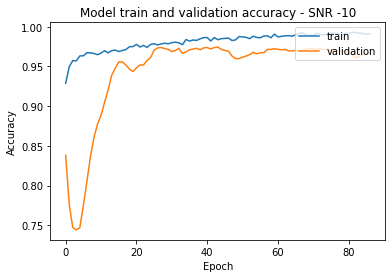

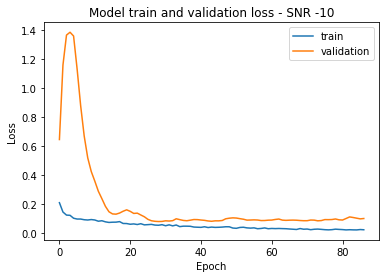


Training SNR = -10 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 2s 64ms/step - loss: 0.1589 - accuracy: 0.9409 - val_loss: 1.1135 - val_accuracy: 0.7417
Epoch 2/200
7/7 [==============================] - 0s 9ms/step - loss: 0.1189 - accuracy: 0.9580 - val_loss: 1.3508 - val_accuracy: 0.6928
Epoch 3/200
7/7 [==============================] - 0s 9ms/step - loss: 0.1083 - accuracy: 0.9593 - val_loss: 0.9770 - val_accuracy: 0.7538
Epoch 4/200
7/7 [==============================] - 0s 9ms/step - loss: 0.1094 - accuracy: 0.9587 - val_loss: 0.6686 - val_accuracy: 0.8177
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 0.1019 - accuracy: 0.9638 - val_loss: 0.5266 - val_accuracy: 0.8494
Epoch 6/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0904 - accuracy: 0.9692 - val_loss: 0.4561 - val_accuracy: 0.8597
Epoch 7/200
7/7 [==============================] - 0s 10ms/step - loss: 0.0942 - accuracy: 0.9687 - val_lo

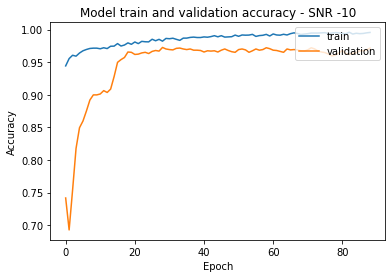

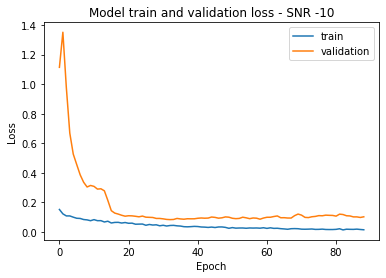


Score of SNR on All SNR model without Transfer Learning -8 = 91.60839319229126
Score of SNR on High SNR model without Transfer Learning -8 = 91.65500998497009
Score of SNR on low SNR model without Transfer Learning -8 = 89.37063217163086

Training SNR = -8 Data

Epoch 1/200
7/7 [==============================] - 1s 65ms/step - loss: 1.3492 - accuracy: 0.3787 - val_loss: 1.1000 - val_accuracy: 0.3366
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 0.9240 - accuracy: 0.5979 - val_loss: 1.1153 - val_accuracy: 0.2485
Epoch 3/200
7/7 [==============================] - 0s 10ms/step - loss: 0.7092 - accuracy: 0.7311 - val_loss: 1.1489 - val_accuracy: 0.2042
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.6020 - accuracy: 0.7937 - val_loss: 1.1619 - val_accuracy: 0.2732
Epoch 5/200
7/7 [==============================] - 0s 9ms/step - loss: 0.5051 - accuracy: 0.8405 - val_loss: 1.1708 - val_accuracy: 0.3207
Epoch 6/200
7/7 [====================

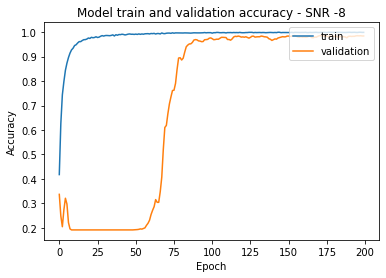

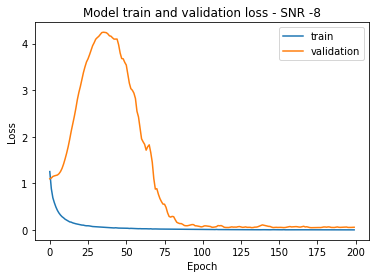


Training SNR = -8 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 2s 65ms/step - loss: 0.0797 - accuracy: 0.9700 - val_loss: 0.7040 - val_accuracy: 0.8340
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0489 - accuracy: 0.9834 - val_loss: 1.1629 - val_accuracy: 0.7814
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0429 - accuracy: 0.9853 - val_loss: 1.4085 - val_accuracy: 0.7483
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0403 - accuracy: 0.9879 - val_loss: 1.4293 - val_accuracy: 0.7464
Epoch 5/200
7/7 [==============================] - 0s 9ms/step - loss: 0.0423 - accuracy: 0.9866 - val_loss: 1.3442 - val_accuracy: 0.7566
Epoch 6/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0328 - accuracy: 0.9897 - val_loss: 1.2082 - val_accuracy: 0.7716
Epoch 7/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0286 - accuracy: 0.9912 - val_l

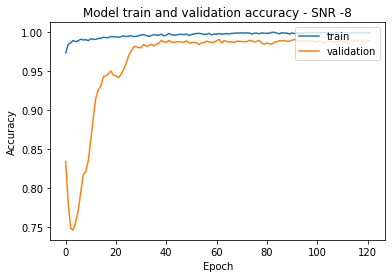

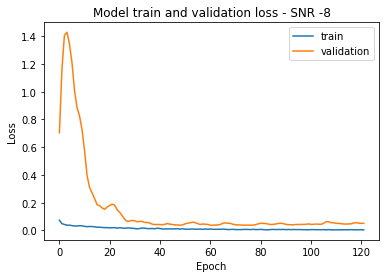


Training SNR = -8 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 1s 63ms/step - loss: 0.0948 - accuracy: 0.9658 - val_loss: 0.5500 - val_accuracy: 0.8573
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 0.0607 - accuracy: 0.9793 - val_loss: 1.0252 - val_accuracy: 0.7953
Epoch 3/200
7/7 [==============================] - 0s 10ms/step - loss: 0.0464 - accuracy: 0.9855 - val_loss: 1.3459 - val_accuracy: 0.7562
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0448 - accuracy: 0.9853 - val_loss: 1.4256 - val_accuracy: 0.7455
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 0.0395 - accuracy: 0.9856 - val_loss: 1.3628 - val_accuracy: 0.7515
Epoch 6/200
7/7 [==============================] - 0s 13ms/step - loss: 0.0370 - accuracy: 0.9882 - val_loss: 1.2920 - val_accuracy: 0.7571
Epoch 7/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0320 - accuracy: 0.9903 - val

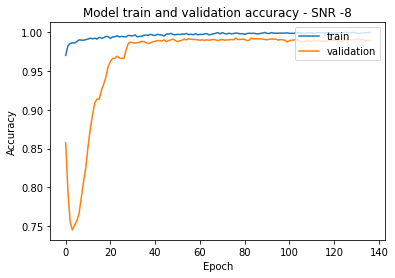

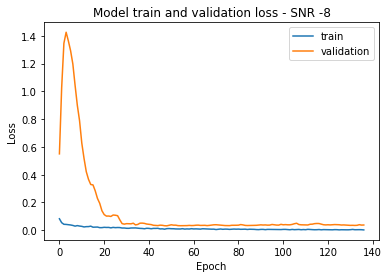


Training SNR = -8 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 2s 66ms/step - loss: 0.0905 - accuracy: 0.9684 - val_loss: 1.1037 - val_accuracy: 0.7538
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0566 - accuracy: 0.9841 - val_loss: 1.8532 - val_accuracy: 0.6238
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0526 - accuracy: 0.9857 - val_loss: 1.6646 - val_accuracy: 0.6531
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0501 - accuracy: 0.9836 - val_loss: 1.3058 - val_accuracy: 0.7166
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0402 - accuracy: 0.9897 - val_loss: 1.0269 - val_accuracy: 0.7599
Epoch 6/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0442 - accuracy: 0.9862 - val_loss: 0.8063 - val_accuracy: 0.8075
Epoch 7/200
7/7 [==============================] - 0s 10ms/step - loss: 0.0373 - accuracy: 0.9897 - val_

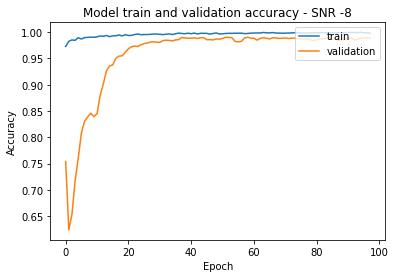

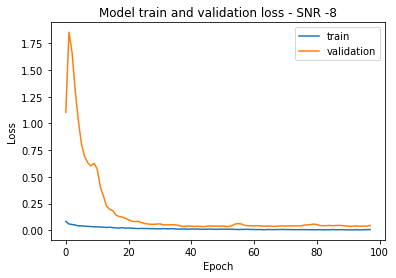


Score of SNR on All SNR model without Transfer Learning -6 = 95.57109475135803
Score of SNR on High SNR model without Transfer Learning -6 = 95.80419659614563
Score of SNR on low SNR model without Transfer Learning -6 = 95.5244779586792

Training SNR = -6 Data

Epoch 1/200
7/7 [==============================] - 2s 66ms/step - loss: 1.0988 - accuracy: 0.4946 - val_loss: 1.0950 - val_accuracy: 0.3566
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 0.6537 - accuracy: 0.7617 - val_loss: 1.0947 - val_accuracy: 0.3744
Epoch 3/200
7/7 [==============================] - 0s 10ms/step - loss: 0.4783 - accuracy: 0.8491 - val_loss: 1.1121 - val_accuracy: 0.3305
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.3626 - accuracy: 0.9004 - val_loss: 1.1405 - val_accuracy: 0.2690
Epoch 5/200
7/7 [==============================] - 0s 14ms/step - loss: 0.2995 - accuracy: 0.9273 - val_loss: 1.2015 - val_accuracy: 0.2000
Epoch 6/200
7/7 [====================

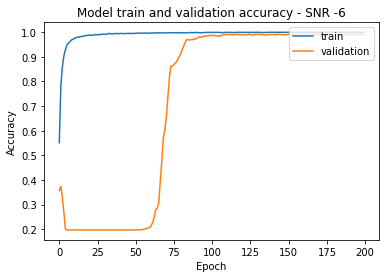

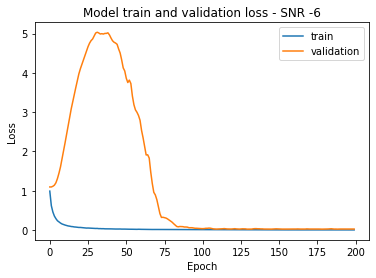


Training SNR = -6 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 2s 64ms/step - loss: 0.0515 - accuracy: 0.9853 - val_loss: 0.3964 - val_accuracy: 0.8914
Epoch 2/200
7/7 [==============================] - 0s 14ms/step - loss: 0.0304 - accuracy: 0.9916 - val_loss: 0.6949 - val_accuracy: 0.8406
Epoch 3/200
7/7 [==============================] - 0s 13ms/step - loss: 0.0222 - accuracy: 0.9931 - val_loss: 0.8729 - val_accuracy: 0.8117
Epoch 4/200
7/7 [==============================] - 0s 13ms/step - loss: 0.0208 - accuracy: 0.9941 - val_loss: 0.8985 - val_accuracy: 0.8103
Epoch 5/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0177 - accuracy: 0.9934 - val_loss: 0.8093 - val_accuracy: 0.8238
Epoch 6/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0202 - accuracy: 0.9934 - val_loss: 0.7677 - val_accuracy: 0.8242
Epoch 7/200
7/7 [==============================] - 0s 10ms/step - loss: 0.0119 - accuracy: 0.9969 - val_

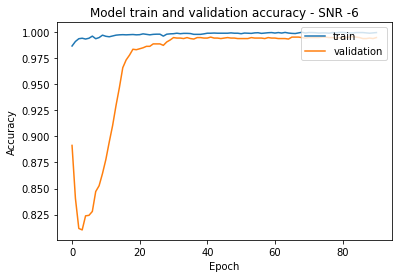

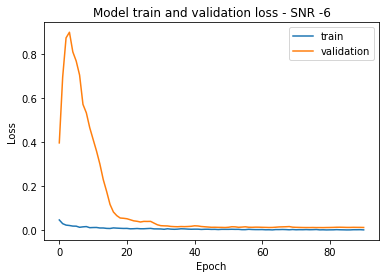


Training SNR = -6 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 2s 63ms/step - loss: 0.0508 - accuracy: 0.9824 - val_loss: 0.4868 - val_accuracy: 0.8769
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0319 - accuracy: 0.9906 - val_loss: 0.8809 - val_accuracy: 0.8126
Epoch 3/200
7/7 [==============================] - 0s 9ms/step - loss: 0.0225 - accuracy: 0.9933 - val_loss: 1.0569 - val_accuracy: 0.7925
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0179 - accuracy: 0.9944 - val_loss: 0.9246 - val_accuracy: 0.8079
Epoch 5/200
7/7 [==============================] - 0s 9ms/step - loss: 0.0184 - accuracy: 0.9945 - val_loss: 0.8255 - val_accuracy: 0.8256
Epoch 6/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0158 - accuracy: 0.9951 - val_loss: 0.7858 - val_accuracy: 0.8284
Epoch 7/200
7/7 [==============================] - 0s 10ms/step - loss: 0.0177 - accuracy: 0.9950 - val_l

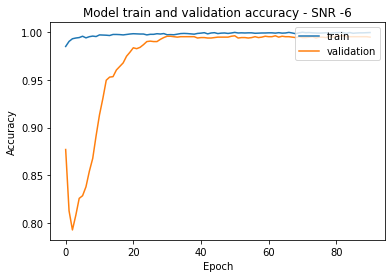

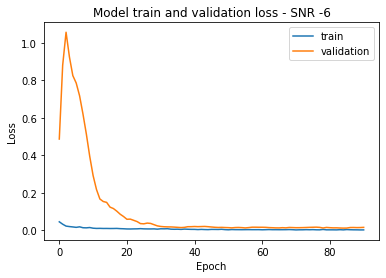


Training SNR = -6 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 2s 64ms/step - loss: 0.0722 - accuracy: 0.9786 - val_loss: 0.7201 - val_accuracy: 0.8266
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 0.0328 - accuracy: 0.9914 - val_loss: 1.5122 - val_accuracy: 0.6816
Epoch 3/200
7/7 [==============================] - 0s 13ms/step - loss: 0.0325 - accuracy: 0.9937 - val_loss: 1.6827 - val_accuracy: 0.6508
Epoch 4/200
7/7 [==============================] - 0s 10ms/step - loss: 0.0247 - accuracy: 0.9948 - val_loss: 1.4897 - val_accuracy: 0.6830
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0225 - accuracy: 0.9954 - val_loss: 1.1211 - val_accuracy: 0.7347
Epoch 6/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0199 - accuracy: 0.9954 - val_loss: 0.7917 - val_accuracy: 0.8065
Epoch 7/200
7/7 [==============================] - 0s 10ms/step - loss: 0.0195 - accuracy: 0.9956 - val_

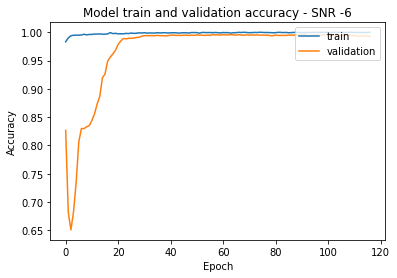

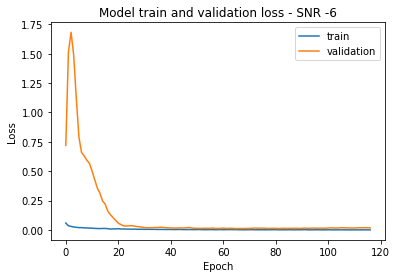


Score of SNR on All SNR model without Transfer Learning -4 = 97.24941849708557
Score of SNR on High SNR model without Transfer Learning -4 = 97.529137134552
Score of SNR on low SNR model without Transfer Learning -4 = 97.15617895126343

Training SNR = -4 Data

Epoch 1/200
7/7 [==============================] - 2s 67ms/step - loss: 0.8996 - accuracy: 0.6064 - val_loss: 1.0904 - val_accuracy: 0.3375
Epoch 2/200
7/7 [==============================] - 0s 12ms/step - loss: 0.4847 - accuracy: 0.8377 - val_loss: 1.1095 - val_accuracy: 0.3319
Epoch 3/200
7/7 [==============================] - 0s 14ms/step - loss: 0.3261 - accuracy: 0.9064 - val_loss: 1.1529 - val_accuracy: 0.2681
Epoch 4/200
7/7 [==============================] - 0s 14ms/step - loss: 0.2493 - accuracy: 0.9397 - val_loss: 1.2364 - val_accuracy: 0.1958
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 0.1921 - accuracy: 0.9580 - val_loss: 1.3503 - val_accuracy: 0.1958
Epoch 6/200
7/7 [=====================

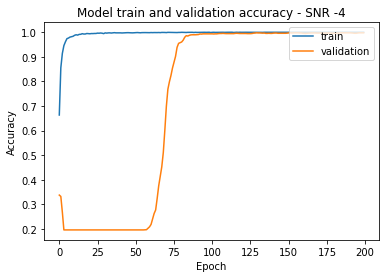

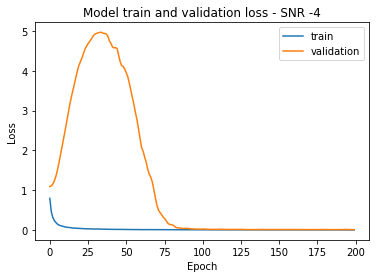


Training SNR = -4 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 2s 67ms/step - loss: 0.0283 - accuracy: 0.9911 - val_loss: 0.2147 - val_accuracy: 0.9343
Epoch 2/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0151 - accuracy: 0.9954 - val_loss: 0.4122 - val_accuracy: 0.8932
Epoch 3/200
7/7 [==============================] - 0s 13ms/step - loss: 0.0126 - accuracy: 0.9969 - val_loss: 0.5598 - val_accuracy: 0.8583
Epoch 4/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0102 - accuracy: 0.9976 - val_loss: 0.5979 - val_accuracy: 0.8485
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 0.0104 - accuracy: 0.9974 - val_loss: 0.6283 - val_accuracy: 0.8406
Epoch 6/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0065 - accuracy: 0.9986 - val_loss: 0.6014 - val_accuracy: 0.8462
Epoch 7/200
7/7 [==============================] - 0s 10ms/step - loss: 0.0067 - accuracy: 0.9990 - val_

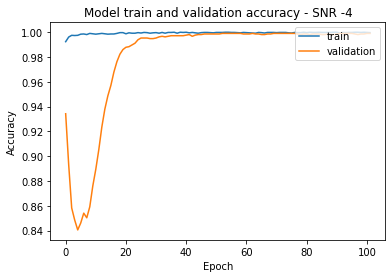

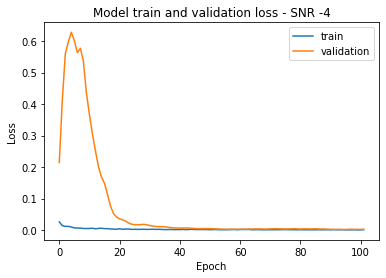


Training SNR = -4 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 2s 64ms/step - loss: 0.0316 - accuracy: 0.9911 - val_loss: 0.1898 - val_accuracy: 0.9436
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 0.0149 - accuracy: 0.9967 - val_loss: 0.3936 - val_accuracy: 0.8970
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0155 - accuracy: 0.9958 - val_loss: 0.5923 - val_accuracy: 0.8494
Epoch 4/200
7/7 [==============================] - 0s 14ms/step - loss: 0.0083 - accuracy: 0.9976 - val_loss: 0.6300 - val_accuracy: 0.8448
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0067 - accuracy: 0.9985 - val_loss: 0.5840 - val_accuracy: 0.8573
Epoch 6/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0074 - accuracy: 0.9980 - val_loss: 0.5903 - val_accuracy: 0.8531
Epoch 7/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0050 - accuracy: 0.9989 - val

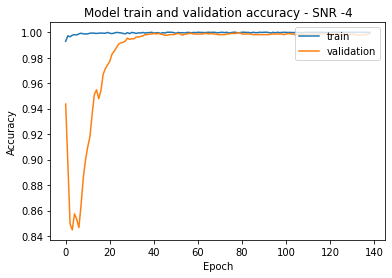

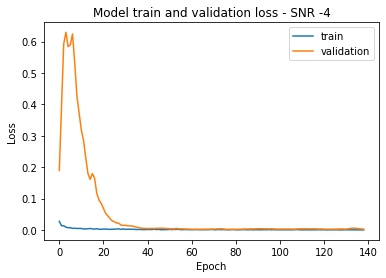


Training SNR = -4 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 2s 64ms/step - loss: 0.0555 - accuracy: 0.9837 - val_loss: 0.2876 - val_accuracy: 0.9193
Epoch 2/200
7/7 [==============================] - 0s 13ms/step - loss: 0.0273 - accuracy: 0.9940 - val_loss: 0.7867 - val_accuracy: 0.7930
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0224 - accuracy: 0.9964 - val_loss: 1.1416 - val_accuracy: 0.7198
Epoch 4/200
7/7 [==============================] - 0s 10ms/step - loss: 0.0188 - accuracy: 0.9967 - val_loss: 1.1595 - val_accuracy: 0.7170
Epoch 5/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0151 - accuracy: 0.9972 - val_loss: 0.9631 - val_accuracy: 0.7566
Epoch 6/200
7/7 [==============================] - 0s 10ms/step - loss: 0.0126 - accuracy: 0.9976 - val_loss: 0.8300 - val_accuracy: 0.7921
Epoch 7/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0104 - accuracy: 0.9980 - val_

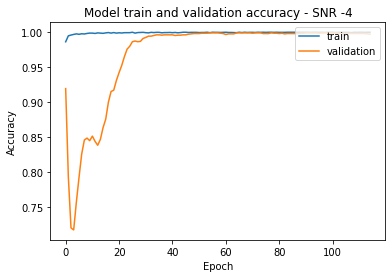

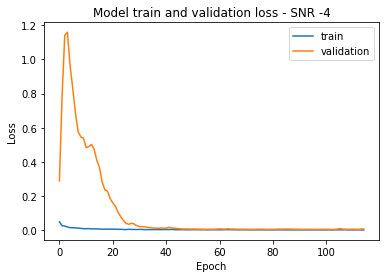


Score of SNR on All SNR model without Transfer Learning -2 = 98.8811194896698
Score of SNR on High SNR model without Transfer Learning -2 = 98.97435903549194
Score of SNR on low SNR model without Transfer Learning -2 = 98.50816130638123

Training SNR = -2 Data

Epoch 1/200
7/7 [==============================] - 1s 62ms/step - loss: 1.4149 - accuracy: 0.3449 - val_loss: 1.1127 - val_accuracy: 0.2904
Epoch 2/200
7/7 [==============================] - 0s 9ms/step - loss: 0.8016 - accuracy: 0.7193 - val_loss: 1.1656 - val_accuracy: 0.3235
Epoch 3/200
7/7 [==============================] - 0s 10ms/step - loss: 0.5631 - accuracy: 0.8391 - val_loss: 1.2313 - val_accuracy: 0.2900
Epoch 4/200
7/7 [==============================] - 0s 10ms/step - loss: 0.4199 - accuracy: 0.8905 - val_loss: 1.3024 - val_accuracy: 0.2117
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 0.3306 - accuracy: 0.9243 - val_loss: 1.3849 - val_accuracy: 0.2065
Epoch 6/200
7/7 [=====================

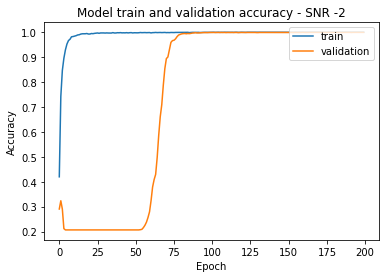

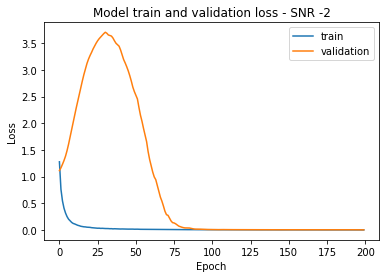


Training SNR = -2 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 2s 64ms/step - loss: 0.0214 - accuracy: 0.9931 - val_loss: 0.1045 - val_accuracy: 0.9692
Epoch 2/200
7/7 [==============================] - 0s 13ms/step - loss: 0.0105 - accuracy: 0.9976 - val_loss: 0.1728 - val_accuracy: 0.9520
Epoch 3/200
7/7 [==============================] - 0s 13ms/step - loss: 0.0067 - accuracy: 0.9991 - val_loss: 0.2184 - val_accuracy: 0.9366
Epoch 4/200
7/7 [==============================] - 0s 10ms/step - loss: 0.0070 - accuracy: 0.9988 - val_loss: 0.2355 - val_accuracy: 0.9301
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 0.0053 - accuracy: 0.9984 - val_loss: 0.2283 - val_accuracy: 0.9338
Epoch 6/200
7/7 [==============================] - 0s 13ms/step - loss: 0.0037 - accuracy: 0.9993 - val_loss: 0.2106 - val_accuracy: 0.9389
Epoch 7/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0030 - accuracy: 0.9991 - val_

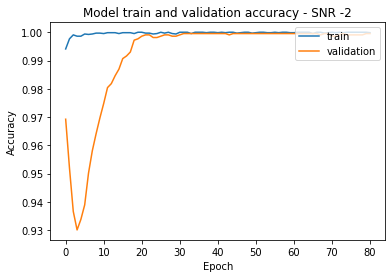

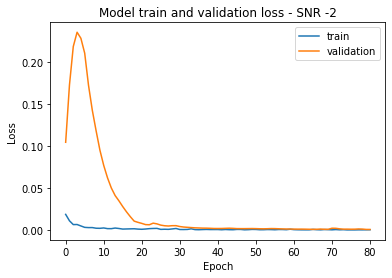


Training SNR = -2 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 2s 62ms/step - loss: 0.0242 - accuracy: 0.9936 - val_loss: 0.0793 - val_accuracy: 0.9767
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 0.0089 - accuracy: 0.9978 - val_loss: 0.1256 - val_accuracy: 0.9655
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0057 - accuracy: 0.9986 - val_loss: 0.1470 - val_accuracy: 0.9576
Epoch 4/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0050 - accuracy: 0.9986 - val_loss: 0.1581 - val_accuracy: 0.9562
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0045 - accuracy: 0.9991 - val_loss: 0.1595 - val_accuracy: 0.9576
Epoch 6/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0044 - accuracy: 0.9984 - val_loss: 0.1460 - val_accuracy: 0.9608
Epoch 7/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0025 - accuracy: 0.9999 - val

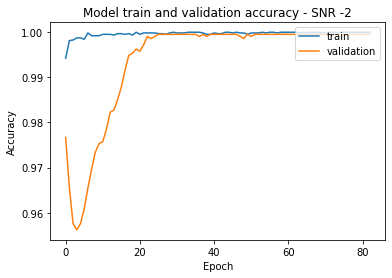

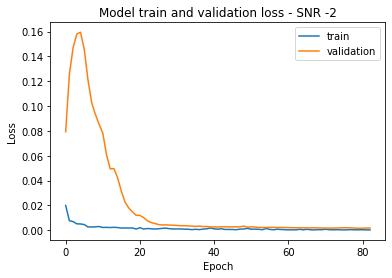


Training SNR = -2 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 2s 65ms/step - loss: 0.0468 - accuracy: 0.9848 - val_loss: 0.1172 - val_accuracy: 0.9674
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0205 - accuracy: 0.9972 - val_loss: 0.2465 - val_accuracy: 0.9231
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0143 - accuracy: 0.9978 - val_loss: 0.3452 - val_accuracy: 0.8862
Epoch 4/200
7/7 [==============================] - 0s 13ms/step - loss: 0.0122 - accuracy: 0.9977 - val_loss: 0.3441 - val_accuracy: 0.8881
Epoch 5/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0094 - accuracy: 0.9985 - val_loss: 0.2881 - val_accuracy: 0.9124
Epoch 6/200
7/7 [==============================] - 0s 15ms/step - loss: 0.0074 - accuracy: 0.9993 - val_loss: 0.2176 - val_accuracy: 0.9329
Epoch 7/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0101 - accuracy: 0.9980 - val_

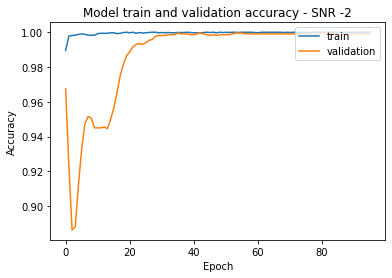

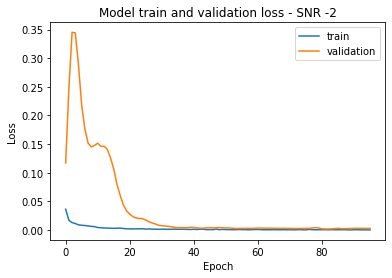

In [ ]:
#es

for i in range(0, 10):

  x_data_mag = np.absolute(x_data_fft_data[:,:,:,:,0] + 1j*x_data_fft_data[:,:,:,:,1]) 
  x_data_fft_curr = np.reshape(x_data_mag[:,i], (x_dim[0]*x_dim[2], x_dim[3]))

  y_labels_fft_curr = y_labels_data[:,i].flatten()
  y_data_fft_curr = np.zeros(shape=(y_labels_fft_curr.shape[0], 3))
  
  for j in range(y_labels_fft_curr.shape[0]):
    if(0<=y_labels_fft_curr[j] and y_labels_fft_curr[j]<=9):
      y_data_fft_curr[j][0] = 1
    elif(10<=y_labels_fft_curr[j] and y_labels_fft_curr[j]<=12):
      y_data_fft_curr[j][1] = 1
    else:
      y_data_fft_curr[j][2] = 1

  X_train_curr, X_test_valid_curr, Y_train_curr, Y_test_valid_curr = train_test_split(x_data_fft_curr, y_data_fft_curr, test_size=0.4)
  X_validation_curr, X_test_curr, Y_validation_curr, Y_test_curr = train_test_split(X_test_valid_curr, Y_test_valid_curr, test_size=0.5)

  Testing(X_test_curr, Y_test_curr, i)
  train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_all_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_high_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_low_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)


Score of SNR on All SNR model without Transfer Learning 0 = 99.39393997192383
Score of SNR on High SNR model without Transfer Learning 0 = 99.48717951774597
Score of SNR on low SNR model without Transfer Learning 0 = 99.02098178863525

Training SNR = 0 Data

Epoch 1/200
7/7 [==============================] - 2s 66ms/step - loss: 1.1906 - accuracy: 0.4814 - val_loss: 1.1200 - val_accuracy: 0.2159
Epoch 2/200
7/7 [==============================] - 0s 7ms/step - loss: 0.6568 - accuracy: 0.7599 - val_loss: 1.1716 - val_accuracy: 0.2051
Epoch 3/200
7/7 [==============================] - 0s 7ms/step - loss: 0.4308 - accuracy: 0.8744 - val_loss: 1.2481 - val_accuracy: 0.2028
Epoch 4/200
7/7 [==============================] - 0s 7ms/step - loss: 0.3085 - accuracy: 0.9229 - val_loss: 1.3345 - val_accuracy: 0.2028
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 0.2337 - accuracy: 0.9496 - val_loss: 1.4298 - val_accuracy: 0.2028
Epoch 6/200
7/7 [==========================

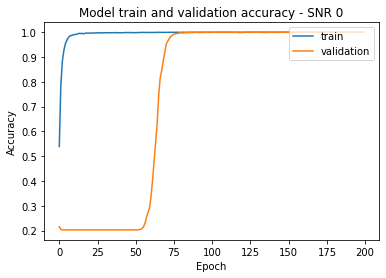

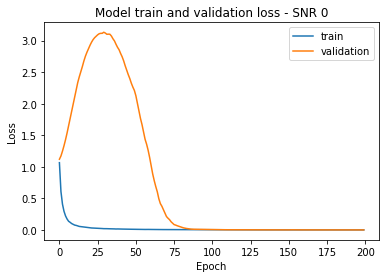


Score of SNR on All SNR model without Transfer Learning 2 = 99.48717951774597
Score of SNR on High SNR model without Transfer Learning 2 = 99.58041906356812
Score of SNR on low SNR model without Transfer Learning 2 = 99.06759858131409

Training SNR = 2 Data

Epoch 1/200
7/7 [==============================] - 2s 65ms/step - loss: 1.2250 - accuracy: 0.4297 - val_loss: 1.0993 - val_accuracy: 0.3431
Epoch 2/200
7/7 [==============================] - 0s 7ms/step - loss: 0.6676 - accuracy: 0.7647 - val_loss: 1.1548 - val_accuracy: 0.2653
Epoch 3/200
7/7 [==============================] - 0s 8ms/step - loss: 0.4361 - accuracy: 0.8656 - val_loss: 1.2339 - val_accuracy: 0.2196
Epoch 4/200
7/7 [==============================] - 0s 8ms/step - loss: 0.3105 - accuracy: 0.9164 - val_loss: 1.3337 - val_accuracy: 0.2196
Epoch 5/200
7/7 [==============================] - 0s 8ms/step - loss: 0.2230 - accuracy: 0.9527 - val_loss: 1.4543 - val_accuracy: 0.2196
Epoch 6/200
7/7 [===========================

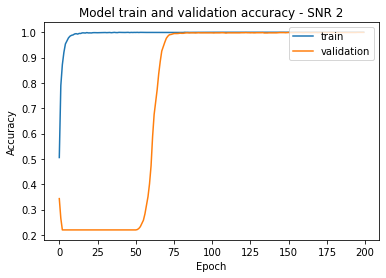

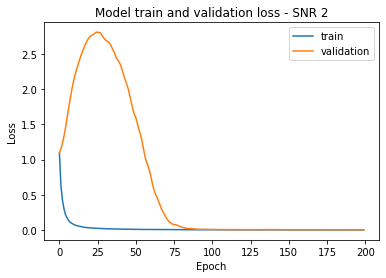


Score of SNR on All SNR model without Transfer Learning 4 = 99.58041906356812
Score of SNR on High SNR model without Transfer Learning 4 = 99.67365860939026
Score of SNR on low SNR model without Transfer Learning 4 = 99.39393997192383

Training SNR = 4 Data

Epoch 1/200
7/7 [==============================] - 2s 62ms/step - loss: 1.0361 - accuracy: 0.5180 - val_loss: 1.0716 - val_accuracy: 0.4531
Epoch 2/200
7/7 [==============================] - 0s 8ms/step - loss: 0.4484 - accuracy: 0.8780 - val_loss: 1.1015 - val_accuracy: 0.2629
Epoch 3/200
7/7 [==============================] - 0s 8ms/step - loss: 0.2670 - accuracy: 0.9349 - val_loss: 1.1622 - val_accuracy: 0.2047
Epoch 4/200
7/7 [==============================] - 0s 7ms/step - loss: 0.1787 - accuracy: 0.9703 - val_loss: 1.2403 - val_accuracy: 0.2047
Epoch 5/200
7/7 [==============================] - 0s 7ms/step - loss: 0.1327 - accuracy: 0.9799 - val_loss: 1.3364 - val_accuracy: 0.2047
Epoch 6/200
7/7 [===========================

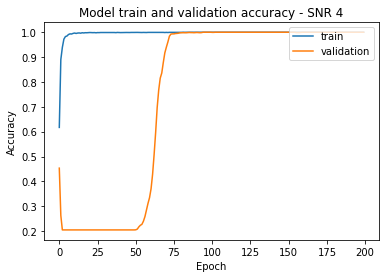

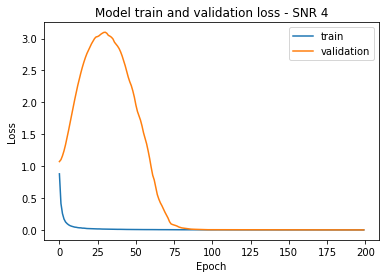


Score of SNR on All SNR model without Transfer Learning 6 = 99.67365860939026
Score of SNR on High SNR model without Transfer Learning 6 = 99.72028136253357
Score of SNR on low SNR model without Transfer Learning 6 = 99.39393997192383

Training SNR = 6 Data

Epoch 1/200
7/7 [==============================] - 2s 63ms/step - loss: 1.1534 - accuracy: 0.4870 - val_loss: 1.0991 - val_accuracy: 0.2597
Epoch 2/200
7/7 [==============================] - 0s 8ms/step - loss: 0.5270 - accuracy: 0.8345 - val_loss: 1.1376 - val_accuracy: 0.2177
Epoch 3/200
7/7 [==============================] - 0s 8ms/step - loss: 0.3218 - accuracy: 0.9129 - val_loss: 1.2140 - val_accuracy: 0.1911
Epoch 4/200
7/7 [==============================] - 0s 8ms/step - loss: 0.2112 - accuracy: 0.9587 - val_loss: 1.3236 - val_accuracy: 0.1902
Epoch 5/200
7/7 [==============================] - 0s 8ms/step - loss: 0.1610 - accuracy: 0.9719 - val_loss: 1.4517 - val_accuracy: 0.1902
Epoch 6/200
7/7 [===========================

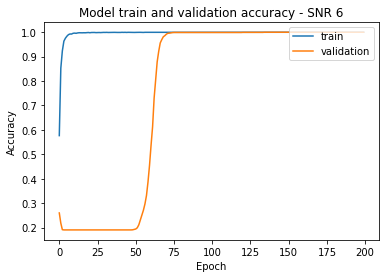

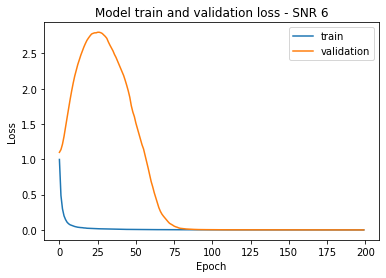


Score of SNR on All SNR model without Transfer Learning 8 = 99.86013770103455
Score of SNR on High SNR model without Transfer Learning 8 = 99.90676045417786
Score of SNR on low SNR model without Transfer Learning 8 = 99.72028136253357

Training SNR = 8 Data

Epoch 1/200
7/7 [==============================] - 2s 65ms/step - loss: 1.1094 - accuracy: 0.4863 - val_loss: 1.1071 - val_accuracy: 0.2681
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 0.5179 - accuracy: 0.8261 - val_loss: 1.1585 - val_accuracy: 0.2228
Epoch 3/200
7/7 [==============================] - 0s 8ms/step - loss: 0.3164 - accuracy: 0.9139 - val_loss: 1.2267 - val_accuracy: 0.1958
Epoch 4/200
7/7 [==============================] - 0s 8ms/step - loss: 0.2267 - accuracy: 0.9537 - val_loss: 1.3031 - val_accuracy: 0.1958
Epoch 5/200
7/7 [==============================] - 0s 9ms/step - loss: 0.1636 - accuracy: 0.9715 - val_loss: 1.3857 - val_accuracy: 0.1958
Epoch 6/200
7/7 [==========================

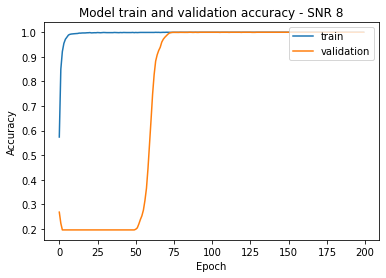

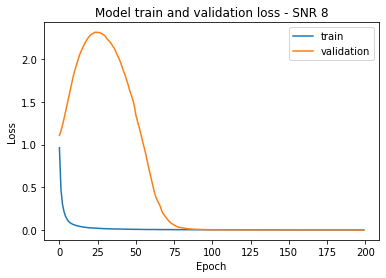


Score of SNR on All SNR model without Transfer Learning 10 = 99.67365860939026
Score of SNR on High SNR model without Transfer Learning 10 = 99.7668981552124
Score of SNR on low SNR model without Transfer Learning 10 = 99.39393997192383

Training SNR = 10 Data

Epoch 1/200
7/7 [==============================] - 1s 63ms/step - loss: 1.1445 - accuracy: 0.4895 - val_loss: 1.0813 - val_accuracy: 0.3096
Epoch 2/200
7/7 [==============================] - 0s 8ms/step - loss: 0.5412 - accuracy: 0.8177 - val_loss: 1.1186 - val_accuracy: 0.2126
Epoch 3/200
7/7 [==============================] - 0s 8ms/step - loss: 0.3312 - accuracy: 0.9106 - val_loss: 1.1959 - val_accuracy: 0.1944
Epoch 4/200
7/7 [==============================] - 0s 8ms/step - loss: 0.2403 - accuracy: 0.9476 - val_loss: 1.2931 - val_accuracy: 0.1944
Epoch 5/200
7/7 [==============================] - 0s 9ms/step - loss: 0.1666 - accuracy: 0.9703 - val_loss: 1.3958 - val_accuracy: 0.1944
Epoch 6/200
7/7 [========================

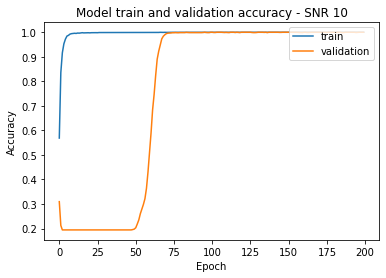

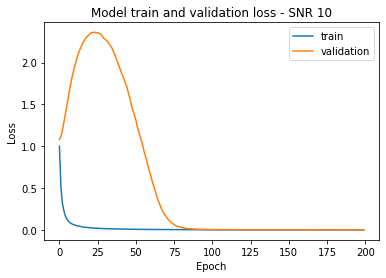


Score of SNR on All SNR model without Transfer Learning 12 = 99.7668981552124
Score of SNR on High SNR model without Transfer Learning 12 = 99.72028136253357
Score of SNR on low SNR model without Transfer Learning 12 = 99.48717951774597

Training SNR = 12 Data

Epoch 1/200
7/7 [==============================] - 1s 67ms/step - loss: 0.9377 - accuracy: 0.5865 - val_loss: 1.0789 - val_accuracy: 0.3464
Epoch 2/200
7/7 [==============================] - 0s 9ms/step - loss: 0.4059 - accuracy: 0.8802 - val_loss: 1.1013 - val_accuracy: 0.2932
Epoch 3/200
7/7 [==============================] - 0s 8ms/step - loss: 0.2292 - accuracy: 0.9484 - val_loss: 1.1513 - val_accuracy: 0.1972
Epoch 4/200
7/7 [==============================] - 0s 9ms/step - loss: 0.1577 - accuracy: 0.9752 - val_loss: 1.2170 - val_accuracy: 0.1939
Epoch 5/200
7/7 [==============================] - 0s 8ms/step - loss: 0.1164 - accuracy: 0.9843 - val_loss: 1.2860 - val_accuracy: 0.1939
Epoch 6/200
7/7 [========================

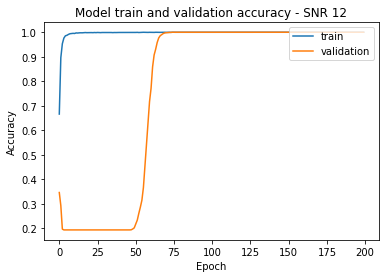

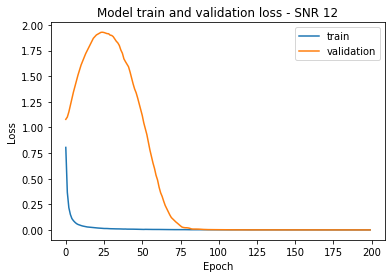


Score of SNR on All SNR model without Transfer Learning 14 = 99.95337724685669
Score of SNR on High SNR model without Transfer Learning 14 = 100.0
Score of SNR on low SNR model without Transfer Learning 14 = 99.72028136253357

Training SNR = 14 Data

Epoch 1/200
7/7 [==============================] - 1s 65ms/step - loss: 1.1611 - accuracy: 0.4799 - val_loss: 1.1024 - val_accuracy: 0.3333
Epoch 2/200
7/7 [==============================] - 0s 8ms/step - loss: 0.5224 - accuracy: 0.8273 - val_loss: 1.1388 - val_accuracy: 0.2830
Epoch 3/200
7/7 [==============================] - 0s 9ms/step - loss: 0.3052 - accuracy: 0.9227 - val_loss: 1.1947 - val_accuracy: 0.2098
Epoch 4/200
7/7 [==============================] - 0s 9ms/step - loss: 0.2149 - accuracy: 0.9533 - val_loss: 1.2582 - val_accuracy: 0.2037
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 0.1573 - accuracy: 0.9751 - val_loss: 1.3261 - val_accuracy: 0.2037
Epoch 6/200
7/7 [==============================] - 

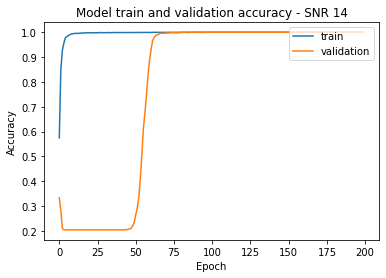

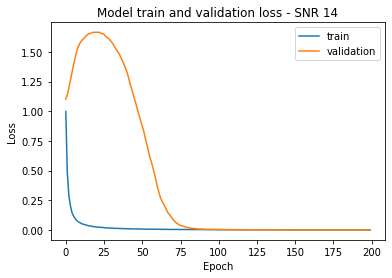


Score of SNR on All SNR model without Transfer Learning 16 = 99.95337724685669
Score of SNR on High SNR model without Transfer Learning 16 = 99.95337724685669
Score of SNR on low SNR model without Transfer Learning 16 = 99.86013770103455

Training SNR = 16 Data

Epoch 1/200
7/7 [==============================] - 2s 70ms/step - loss: 1.1699 - accuracy: 0.4604 - val_loss: 1.0668 - val_accuracy: 0.2984
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 0.5165 - accuracy: 0.8140 - val_loss: 1.0915 - val_accuracy: 0.1991
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 0.3274 - accuracy: 0.9083 - val_loss: 1.1495 - val_accuracy: 0.1977
Epoch 4/200
7/7 [==============================] - 0s 9ms/step - loss: 0.2308 - accuracy: 0.9447 - val_loss: 1.2287 - val_accuracy: 0.1977
Epoch 5/200
7/7 [==============================] - 0s 8ms/step - loss: 0.1666 - accuracy: 0.9691 - val_loss: 1.3189 - val_accuracy: 0.1977
Epoch 6/200
7/7 [=====================

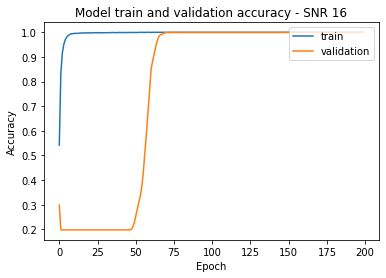

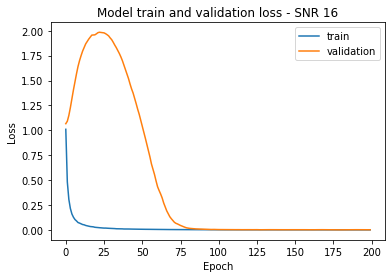


Score of SNR on All SNR model without Transfer Learning 18 = 99.81352090835571
Score of SNR on High SNR model without Transfer Learning 18 = 99.7668981552124
Score of SNR on low SNR model without Transfer Learning 18 = 99.25407767295837

Training SNR = 18 Data

Epoch 1/200
7/7 [==============================] - 2s 62ms/step - loss: 0.9970 - accuracy: 0.5436 - val_loss: 1.0676 - val_accuracy: 0.4280
Epoch 2/200
7/7 [==============================] - 0s 9ms/step - loss: 0.4138 - accuracy: 0.8760 - val_loss: 1.1026 - val_accuracy: 0.2303
Epoch 3/200
7/7 [==============================] - 0s 8ms/step - loss: 0.2480 - accuracy: 0.9465 - val_loss: 1.1635 - val_accuracy: 0.2023
Epoch 4/200
7/7 [==============================] - 0s 9ms/step - loss: 0.1723 - accuracy: 0.9664 - val_loss: 1.2419 - val_accuracy: 0.2019
Epoch 5/200
7/7 [==============================] - 0s 9ms/step - loss: 0.1255 - accuracy: 0.9803 - val_loss: 1.3214 - val_accuracy: 0.2019
Epoch 6/200
7/7 [========================

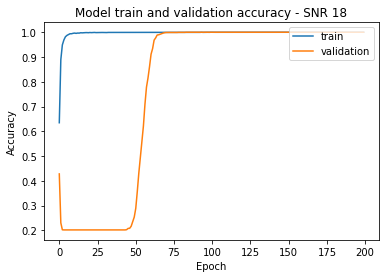

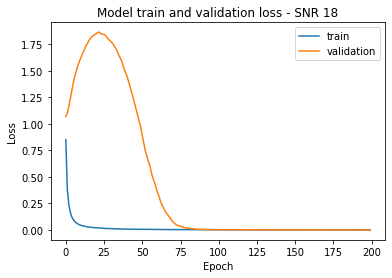


Score of SNR on All SNR model without Transfer Learning 20 = 99.86013770103455
Score of SNR on High SNR model without Transfer Learning 20 = 99.90676045417786
Score of SNR on low SNR model without Transfer Learning 20 = 99.48717951774597

Training SNR = 20 Data

Epoch 1/200
7/7 [==============================] - 2s 65ms/step - loss: 1.0019 - accuracy: 0.5722 - val_loss: 1.1032 - val_accuracy: 0.2890
Epoch 2/200
7/7 [==============================] - 0s 8ms/step - loss: 0.4316 - accuracy: 0.8727 - val_loss: 1.1348 - val_accuracy: 0.2219
Epoch 3/200
7/7 [==============================] - 0s 9ms/step - loss: 0.2505 - accuracy: 0.9392 - val_loss: 1.1831 - val_accuracy: 0.1925
Epoch 4/200
7/7 [==============================] - 0s 9ms/step - loss: 0.1612 - accuracy: 0.9732 - val_loss: 1.2333 - val_accuracy: 0.1902
Epoch 5/200
7/7 [==============================] - 0s 9ms/step - loss: 0.1190 - accuracy: 0.9820 - val_loss: 1.2853 - val_accuracy: 0.1902
Epoch 6/200
7/7 [=======================

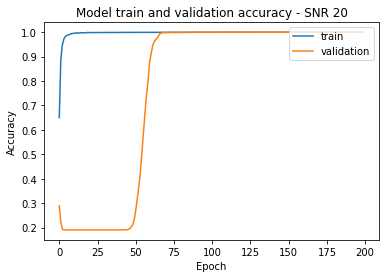

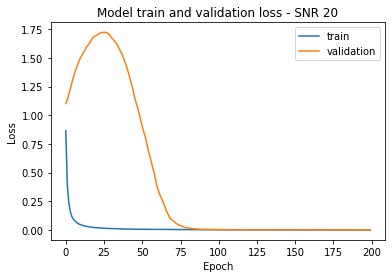

In [ ]:
#es

for i in range(10, 21):

  x_data_mag = np.absolute(x_data_fft_data[:,:,:,:,0] + 1j*x_data_fft_data[:,:,:,:,1]) 
  x_data_fft_curr = np.reshape(x_data_mag[:,i], (x_dim[0]*x_dim[2], x_dim[3]))

  y_labels_fft_curr = y_labels_data[:,i].flatten()
  y_data_fft_curr = np.zeros(shape=(y_labels_fft_curr.shape[0], 3))
  
  for j in range(y_labels_fft_curr.shape[0]):
    if(0<=y_labels_fft_curr[j] and y_labels_fft_curr[j]<=9):
      y_data_fft_curr[j][0] = 1
    elif(10<=y_labels_fft_curr[j] and y_labels_fft_curr[j]<=12):
      y_data_fft_curr[j][1] = 1
    else:
      y_data_fft_curr[j][2] = 1

  X_train_curr, X_test_valid_curr, Y_train_curr, Y_test_valid_curr = train_test_split(x_data_fft_curr, y_data_fft_curr, test_size=0.4)
  X_validation_curr, X_test_curr, Y_validation_curr, Y_test_curr = train_test_split(X_test_valid_curr, Y_test_valid_curr, test_size=0.5)

  Testing(X_test_curr, Y_test_curr, i)
  train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)


Score of SNR on All SNR model without Transfer Learning -20 = 67.31934547424316
Score of SNR on High SNR model without Transfer Learning -20 = 67.55244731903076
Score of SNR on low SNR model without Transfer Learning -20 = 67.78554916381836

Training SNR = -20 Data

Epoch 1/200
7/7 [==============================] - 2s 81ms/step - loss: 1.2410 - accuracy: 0.3534 - val_loss: 1.0726 - val_accuracy: 0.3888
Epoch 2/200
7/7 [==============================] - 0s 12ms/step - loss: 1.0426 - accuracy: 0.4714 - val_loss: 1.0294 - val_accuracy: 0.5921
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 0.9568 - accuracy: 0.5520 - val_loss: 1.0102 - val_accuracy: 0.6387
Epoch 4/200
7/7 [==============================] - 0s 10ms/step - loss: 0.8987 - accuracy: 0.6008 - val_loss: 0.9845 - val_accuracy: 0.6522
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 0.8761 - accuracy: 0.6264 - val_loss: 0.9604 - val_accuracy: 0.6578
Epoch 6/200
7/7 [===============

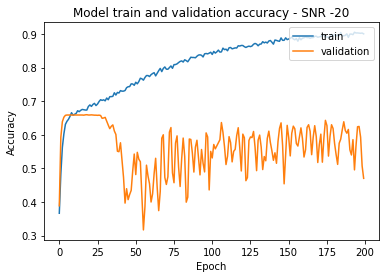

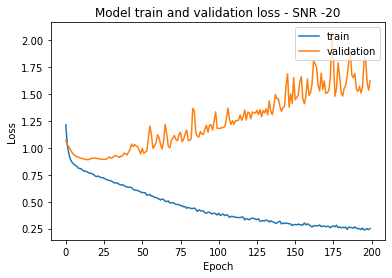


Training SNR = -20 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 2s 74ms/step - loss: 2.6998 - accuracy: 0.6500 - val_loss: 2.1000 - val_accuracy: 0.6611
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 2.3544 - accuracy: 0.6563 - val_loss: 2.6526 - val_accuracy: 0.6620
Epoch 3/200
7/7 [==============================] - 0s 10ms/step - loss: 2.2247 - accuracy: 0.6673 - val_loss: 2.8702 - val_accuracy: 0.6573
Epoch 4/200
7/7 [==============================] - 0s 10ms/step - loss: 2.1264 - accuracy: 0.6630 - val_loss: 2.8376 - val_accuracy: 0.6536
Epoch 5/200
7/7 [==============================] - 0s 13ms/step - loss: 1.9874 - accuracy: 0.6649 - val_loss: 2.8316 - val_accuracy: 0.6536
Epoch 6/200
7/7 [==============================] - 0s 10ms/step - loss: 1.8597 - accuracy: 0.6714 - val_loss: 2.6574 - val_accuracy: 0.6434
Epoch 7/200
7/7 [==============================] - 0s 10ms/step - loss: 1.7543 - accuracy: 0.6703 - val

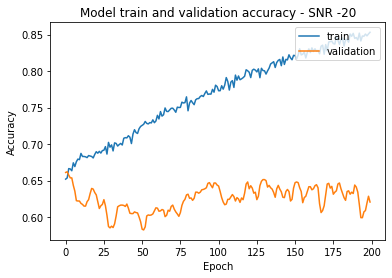

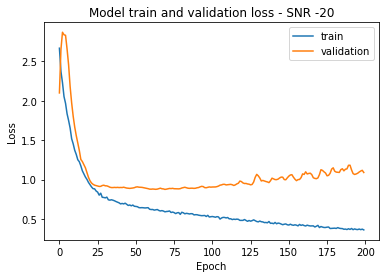


Training SNR = -20 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 2s 80ms/step - loss: 2.6832 - accuracy: 0.6576 - val_loss: 2.0703 - val_accuracy: 0.6578
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 2.4245 - accuracy: 0.6546 - val_loss: 2.4333 - val_accuracy: 0.6550
Epoch 3/200
7/7 [==============================] - 0s 10ms/step - loss: 2.2417 - accuracy: 0.6583 - val_loss: 2.7382 - val_accuracy: 0.6545
Epoch 4/200
7/7 [==============================] - 0s 12ms/step - loss: 2.1012 - accuracy: 0.6695 - val_loss: 2.7579 - val_accuracy: 0.6503
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 1.9536 - accuracy: 0.6674 - val_loss: 2.6466 - val_accuracy: 0.6424
Epoch 6/200
7/7 [==============================] - 0s 12ms/step - loss: 1.8124 - accuracy: 0.6684 - val_loss: 2.4929 - val_accuracy: 0.6359
Epoch 7/200
7/7 [==============================] - 0s 12ms/step - loss: 1.7080 - accuracy: 0.6698 - va

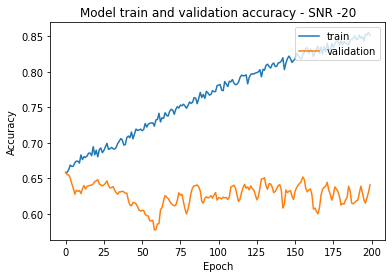

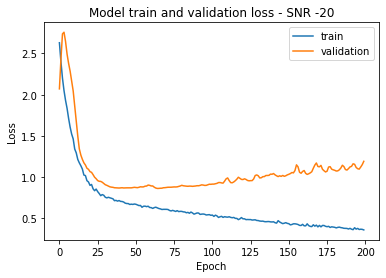


Training SNR = -20 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 2s 83ms/step - loss: 1.7524 - accuracy: 0.6517 - val_loss: 2.1773 - val_accuracy: 0.6573
Epoch 2/200
7/7 [==============================] - 0s 13ms/step - loss: 1.5678 - accuracy: 0.6527 - val_loss: 2.3546 - val_accuracy: 0.6592
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 1.4139 - accuracy: 0.6642 - val_loss: 2.3153 - val_accuracy: 0.6597
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 1.3213 - accuracy: 0.6719 - val_loss: 2.0889 - val_accuracy: 0.6569
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 1.2378 - accuracy: 0.6678 - val_loss: 1.9559 - val_accuracy: 0.6536
Epoch 6/200
7/7 [==============================] - 0s 10ms/step - loss: 1.1651 - accuracy: 0.6781 - val_loss: 1.7818 - val_accuracy: 0.6522
Epoch 7/200
7/7 [==============================] - 0s 10ms/step - loss: 1.0796 - accuracy: 0.6799 - val

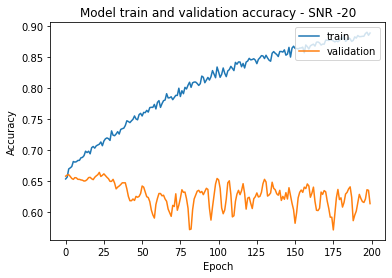

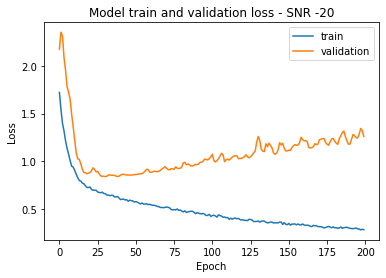


Score of SNR on All SNR model without Transfer Learning -18 = 66.57342910766602
Score of SNR on High SNR model without Transfer Learning -18 = 66.01398587226868
Score of SNR on low SNR model without Transfer Learning -18 = 65.78088402748108

Training SNR = -18 Data

Epoch 1/200
7/7 [==============================] - 2s 76ms/step - loss: 1.3078 - accuracy: 0.3398 - val_loss: 1.0637 - val_accuracy: 0.5366
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 1.0519 - accuracy: 0.4779 - val_loss: 1.0250 - val_accuracy: 0.6354
Epoch 3/200
7/7 [==============================] - 0s 10ms/step - loss: 0.9573 - accuracy: 0.5421 - val_loss: 1.0180 - val_accuracy: 0.6359
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.8927 - accuracy: 0.5969 - val_loss: 1.0033 - val_accuracy: 0.6559
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 0.8561 - accuracy: 0.6299 - val_loss: 0.9895 - val_accuracy: 0.6625
Epoch 6/200
7/7 [===============

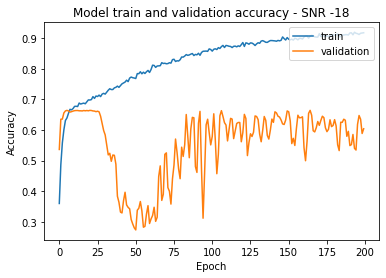

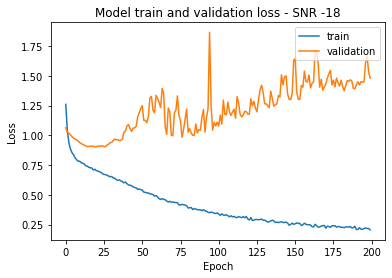


Training SNR = -18 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 2s 77ms/step - loss: 2.2369 - accuracy: 0.6738 - val_loss: 1.4322 - val_accuracy: 0.6695
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 1.9094 - accuracy: 0.6939 - val_loss: 1.8006 - val_accuracy: 0.6592
Epoch 3/200
7/7 [==============================] - 0s 13ms/step - loss: 1.7879 - accuracy: 0.6912 - val_loss: 2.0580 - val_accuracy: 0.6569
Epoch 4/200
7/7 [==============================] - 0s 10ms/step - loss: 1.7123 - accuracy: 0.6904 - val_loss: 2.2212 - val_accuracy: 0.6578
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 1.6320 - accuracy: 0.6959 - val_loss: 2.1698 - val_accuracy: 0.6503
Epoch 6/200
7/7 [==============================] - 0s 10ms/step - loss: 1.4823 - accuracy: 0.7020 - val_loss: 2.0710 - val_accuracy: 0.6378
Epoch 7/200
7/7 [==============================] - 0s 13ms/step - loss: 1.4490 - accuracy: 0.7032 - val

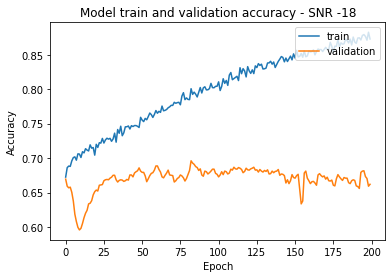

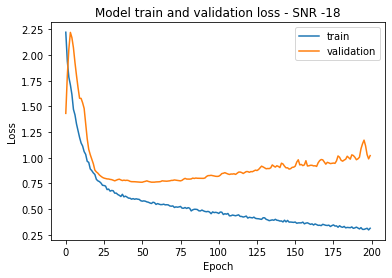


Training SNR = -18 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 2s 80ms/step - loss: 2.2711 - accuracy: 0.6704 - val_loss: 1.4611 - val_accuracy: 0.6629
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 1.9666 - accuracy: 0.6800 - val_loss: 1.8772 - val_accuracy: 0.6625
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 1.8110 - accuracy: 0.6919 - val_loss: 2.0511 - val_accuracy: 0.6601
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 1.6119 - accuracy: 0.7020 - val_loss: 2.1148 - val_accuracy: 0.6569
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 1.5787 - accuracy: 0.6992 - val_loss: 2.1122 - val_accuracy: 0.6513
Epoch 6/200
7/7 [==============================] - 0s 11ms/step - loss: 1.4624 - accuracy: 0.7007 - val_loss: 2.0051 - val_accuracy: 0.6476
Epoch 7/200
7/7 [==============================] - 0s 11ms/step - loss: 1.3962 - accuracy: 0.6884 - va

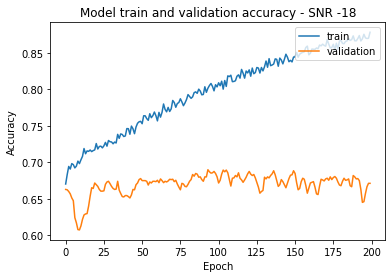

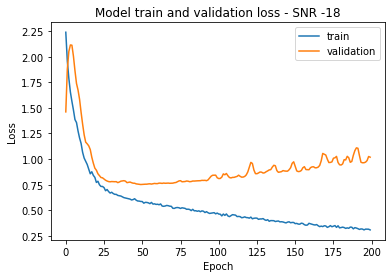


Training SNR = -18 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 2s 81ms/step - loss: 1.3835 - accuracy: 0.6805 - val_loss: 1.2613 - val_accuracy: 0.6704
Epoch 2/200
7/7 [==============================] - 0s 12ms/step - loss: 1.1844 - accuracy: 0.6986 - val_loss: 1.4850 - val_accuracy: 0.6704
Epoch 3/200
7/7 [==============================] - 0s 14ms/step - loss: 1.1416 - accuracy: 0.6950 - val_loss: 1.6641 - val_accuracy: 0.6727
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 1.0604 - accuracy: 0.6970 - val_loss: 1.6936 - val_accuracy: 0.6671
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 0.9459 - accuracy: 0.7147 - val_loss: 1.7187 - val_accuracy: 0.6699
Epoch 6/200
7/7 [==============================] - 0s 10ms/step - loss: 0.9121 - accuracy: 0.7072 - val_loss: 1.5733 - val_accuracy: 0.6699
Epoch 7/200
7/7 [==============================] - 0s 10ms/step - loss: 0.8842 - accuracy: 0.7081 - val

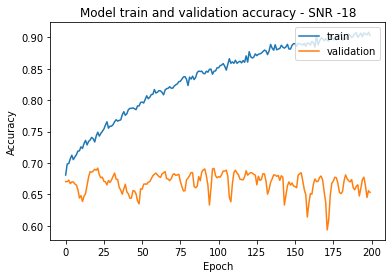

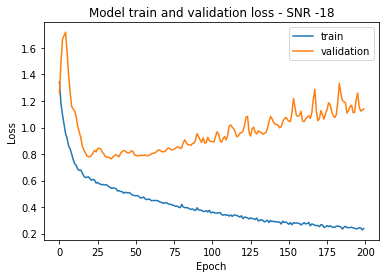


Score of SNR on All SNR model without Transfer Learning -16 = 70.25641202926636
Score of SNR on High SNR model without Transfer Learning -16 = 69.74359154701233
Score of SNR on low SNR model without Transfer Learning -16 = 68.95104646682739

Training SNR = -16 Data

Epoch 1/200
7/7 [==============================] - 2s 83ms/step - loss: 1.2924 - accuracy: 0.3453 - val_loss: 1.0524 - val_accuracy: 0.5259
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 1.0306 - accuracy: 0.4944 - val_loss: 1.0280 - val_accuracy: 0.6182
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 0.9104 - accuracy: 0.5774 - val_loss: 1.0051 - val_accuracy: 0.6517
Epoch 4/200
7/7 [==============================] - 0s 12ms/step - loss: 0.8546 - accuracy: 0.6196 - val_loss: 0.9921 - val_accuracy: 0.6527
Epoch 5/200
7/7 [==============================] - 0s 13ms/step - loss: 0.8085 - accuracy: 0.6416 - val_loss: 0.9784 - val_accuracy: 0.6448
Epoch 6/200
7/7 [===============

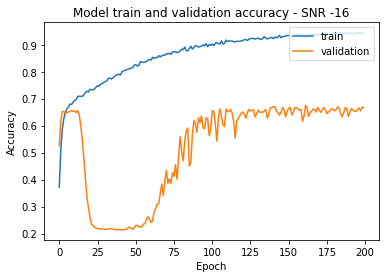

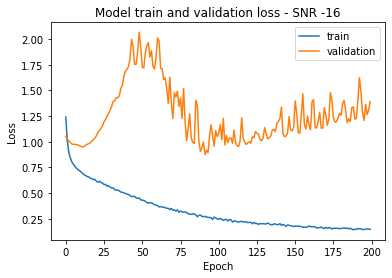


Training SNR = -16 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 2s 79ms/step - loss: 1.6180 - accuracy: 0.7161 - val_loss: 1.2885 - val_accuracy: 0.6774
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 1.3958 - accuracy: 0.7263 - val_loss: 1.8748 - val_accuracy: 0.6765
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 1.2270 - accuracy: 0.7444 - val_loss: 2.2153 - val_accuracy: 0.6765
Epoch 4/200
7/7 [==============================] - 0s 10ms/step - loss: 1.1403 - accuracy: 0.7497 - val_loss: 2.3717 - val_accuracy: 0.6765
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 1.0531 - accuracy: 0.7543 - val_loss: 2.4093 - val_accuracy: 0.6765
Epoch 6/200
7/7 [==============================] - 0s 10ms/step - loss: 1.0301 - accuracy: 0.7544 - val_loss: 2.1772 - val_accuracy: 0.6807
Epoch 7/200
7/7 [==============================] - 0s 11ms/step - loss: 0.9965 - accuracy: 0.7556 - val

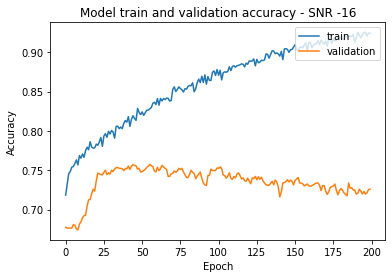

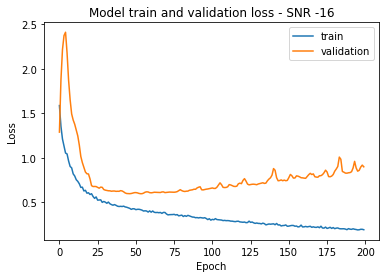


Training SNR = -16 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 2s 76ms/step - loss: 1.5664 - accuracy: 0.7119 - val_loss: 1.4123 - val_accuracy: 0.6802
Epoch 2/200
7/7 [==============================] - 0s 12ms/step - loss: 1.3507 - accuracy: 0.7347 - val_loss: 1.7616 - val_accuracy: 0.6834
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 1.2615 - accuracy: 0.7365 - val_loss: 2.0362 - val_accuracy: 0.6839
Epoch 4/200
7/7 [==============================] - 0s 12ms/step - loss: 1.0979 - accuracy: 0.7528 - val_loss: 2.0893 - val_accuracy: 0.6853
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 1.0931 - accuracy: 0.7485 - val_loss: 1.8825 - val_accuracy: 0.6839
Epoch 6/200
7/7 [==============================] - 0s 11ms/step - loss: 0.9993 - accuracy: 0.7580 - val_loss: 1.7290 - val_accuracy: 0.6695
Epoch 7/200
7/7 [==============================] - 0s 15ms/step - loss: 0.9730 - accuracy: 0.7604 - va

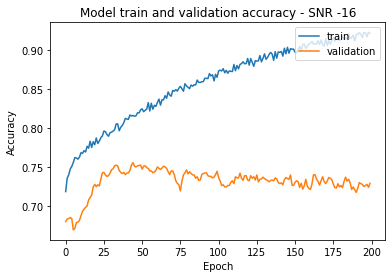

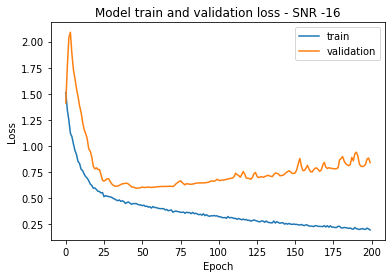


Training SNR = -16 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 2s 81ms/step - loss: 0.9629 - accuracy: 0.7283 - val_loss: 1.5445 - val_accuracy: 0.6625
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 0.8343 - accuracy: 0.7531 - val_loss: 1.7509 - val_accuracy: 0.6681
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 0.7253 - accuracy: 0.7635 - val_loss: 1.7524 - val_accuracy: 0.6755
Epoch 4/200
7/7 [==============================] - 0s 12ms/step - loss: 0.6832 - accuracy: 0.7690 - val_loss: 1.6765 - val_accuracy: 0.6802
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 0.6601 - accuracy: 0.7654 - val_loss: 1.5824 - val_accuracy: 0.6834
Epoch 6/200
7/7 [==============================] - 0s 10ms/step - loss: 0.6210 - accuracy: 0.7772 - val_loss: 1.4387 - val_accuracy: 0.6876
Epoch 7/200
7/7 [==============================] - 0s 12ms/step - loss: 0.5949 - accuracy: 0.7752 - val

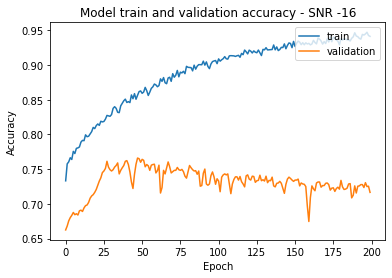

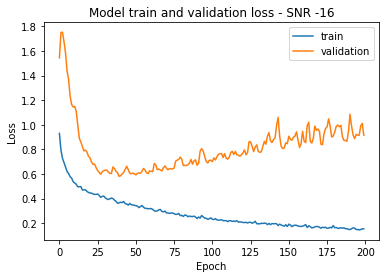


Score of SNR on All SNR model without Transfer Learning -14 = 73.14685583114624
Score of SNR on High SNR model without Transfer Learning -14 = 71.93472981452942
Score of SNR on low SNR model without Transfer Learning -14 = 71.0023283958435

Training SNR = -14 Data

Epoch 1/200
7/7 [==============================] - 2s 79ms/step - loss: 1.4746 - accuracy: 0.2833 - val_loss: 1.0609 - val_accuracy: 0.5874
Epoch 2/200
7/7 [==============================] - 0s 12ms/step - loss: 1.1422 - accuracy: 0.4462 - val_loss: 1.0291 - val_accuracy: 0.6699
Epoch 3/200
7/7 [==============================] - 0s 13ms/step - loss: 0.9851 - accuracy: 0.5352 - val_loss: 1.0160 - val_accuracy: 0.6797
Epoch 4/200
7/7 [==============================] - 0s 12ms/step - loss: 0.8754 - accuracy: 0.5987 - val_loss: 1.0008 - val_accuracy: 0.6709
Epoch 5/200
7/7 [==============================] - 0s 12ms/step - loss: 0.7946 - accuracy: 0.6456 - val_loss: 0.9873 - val_accuracy: 0.6643
Epoch 6/200
7/7 [================

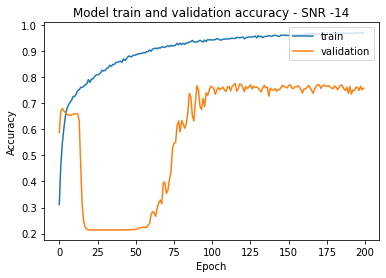

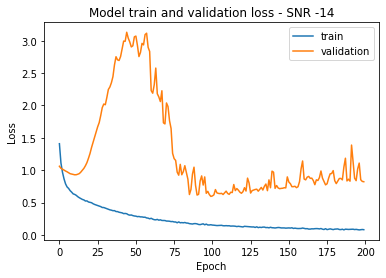


Training SNR = -14 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 2s 78ms/step - loss: 0.9757 - accuracy: 0.7724 - val_loss: 0.8060 - val_accuracy: 0.7291
Epoch 2/200
7/7 [==============================] - 0s 13ms/step - loss: 0.8034 - accuracy: 0.7973 - val_loss: 0.9923 - val_accuracy: 0.7175
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 0.6881 - accuracy: 0.8204 - val_loss: 1.1154 - val_accuracy: 0.7114
Epoch 4/200
7/7 [==============================] - 0s 14ms/step - loss: 0.6703 - accuracy: 0.8166 - val_loss: 1.1558 - val_accuracy: 0.7096
Epoch 5/200
7/7 [==============================] - 0s 12ms/step - loss: 0.6097 - accuracy: 0.8273 - val_loss: 1.1298 - val_accuracy: 0.6960
Epoch 6/200
7/7 [==============================] - 0s 14ms/step - loss: 0.5778 - accuracy: 0.8338 - val_loss: 1.1345 - val_accuracy: 0.6928
Epoch 7/200
7/7 [==============================] - 0s 14ms/step - loss: 0.5292 - accuracy: 0.8371 - val

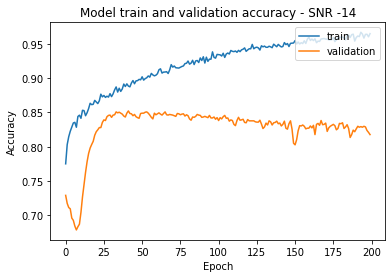

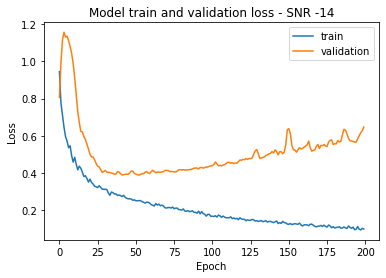


Training SNR = -14 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 2s 77ms/step - loss: 0.9619 - accuracy: 0.7800 - val_loss: 0.6680 - val_accuracy: 0.7417
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 0.7842 - accuracy: 0.8048 - val_loss: 0.7748 - val_accuracy: 0.7156
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 0.6849 - accuracy: 0.8151 - val_loss: 0.8846 - val_accuracy: 0.7170
Epoch 4/200
7/7 [==============================] - 0s 14ms/step - loss: 0.6256 - accuracy: 0.8231 - val_loss: 0.9984 - val_accuracy: 0.7170
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 0.5980 - accuracy: 0.8299 - val_loss: 1.0477 - val_accuracy: 0.7133
Epoch 6/200
7/7 [==============================] - 0s 13ms/step - loss: 0.5594 - accuracy: 0.8383 - val_loss: 1.0201 - val_accuracy: 0.7156
Epoch 7/200
7/7 [==============================] - 0s 11ms/step - loss: 0.5121 - accuracy: 0.8450 - va

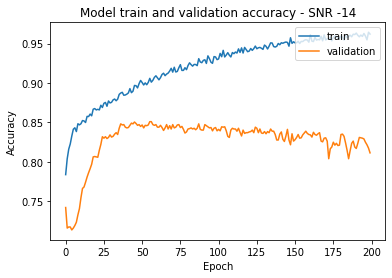

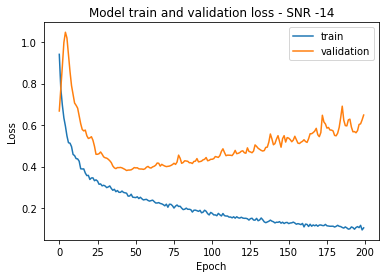


Training SNR = -14 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 2s 82ms/step - loss: 0.5339 - accuracy: 0.8165 - val_loss: 0.6931 - val_accuracy: 0.7427
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 0.4653 - accuracy: 0.8276 - val_loss: 0.8101 - val_accuracy: 0.7329
Epoch 3/200
7/7 [==============================] - 0s 14ms/step - loss: 0.4231 - accuracy: 0.8428 - val_loss: 0.8638 - val_accuracy: 0.7315
Epoch 4/200
7/7 [==============================] - 0s 15ms/step - loss: 0.3948 - accuracy: 0.8385 - val_loss: 0.9081 - val_accuracy: 0.7282
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 0.3725 - accuracy: 0.8558 - val_loss: 0.8772 - val_accuracy: 0.7277
Epoch 6/200
7/7 [==============================] - 0s 11ms/step - loss: 0.3686 - accuracy: 0.8504 - val_loss: 0.8333 - val_accuracy: 0.7254
Epoch 7/200
7/7 [==============================] - 0s 12ms/step - loss: 0.3475 - accuracy: 0.8621 - val

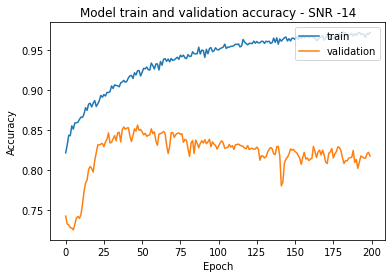

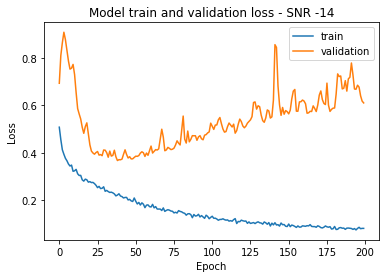


Score of SNR on All SNR model without Transfer Learning -12 = 79.67365980148315
Score of SNR on High SNR model without Transfer Learning -12 = 77.5291383266449
Score of SNR on low SNR model without Transfer Learning -12 = 74.68531727790833

Training SNR = -12 Data

Epoch 1/200
7/7 [==============================] - 2s 82ms/step - loss: 1.2105 - accuracy: 0.3986 - val_loss: 0.9966 - val_accuracy: 0.7054
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 0.9172 - accuracy: 0.5824 - val_loss: 1.0031 - val_accuracy: 0.6970
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 0.7795 - accuracy: 0.6587 - val_loss: 1.0086 - val_accuracy: 0.6779
Epoch 4/200
7/7 [==============================] - 0s 10ms/step - loss: 0.7085 - accuracy: 0.6988 - val_loss: 1.0135 - val_accuracy: 0.6578
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 0.6400 - accuracy: 0.7372 - val_loss: 1.0231 - val_accuracy: 0.6256
Epoch 6/200
7/7 [================

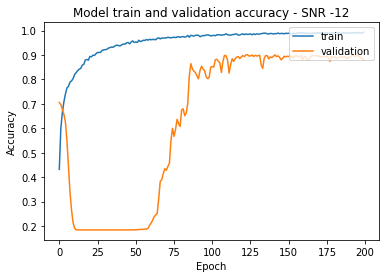

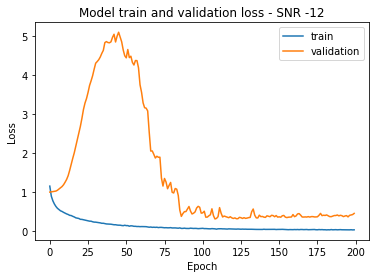


Training SNR = -12 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 2s 76ms/step - loss: 0.4978 - accuracy: 0.8526 - val_loss: 0.5420 - val_accuracy: 0.8252
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 0.3697 - accuracy: 0.8828 - val_loss: 0.6860 - val_accuracy: 0.7986
Epoch 3/200
7/7 [==============================] - 0s 14ms/step - loss: 0.3027 - accuracy: 0.9005 - val_loss: 0.6881 - val_accuracy: 0.8000
Epoch 4/200
7/7 [==============================] - 0s 13ms/step - loss: 0.2629 - accuracy: 0.9085 - val_loss: 0.6157 - val_accuracy: 0.8107
Epoch 5/200
7/7 [==============================] - 0s 16ms/step - loss: 0.2788 - accuracy: 0.9025 - val_loss: 0.5632 - val_accuracy: 0.8233
Epoch 6/200
7/7 [==============================] - 0s 15ms/step - loss: 0.2386 - accuracy: 0.9196 - val_loss: 0.5572 - val_accuracy: 0.8233
Epoch 7/200
7/7 [==============================] - 0s 11ms/step - loss: 0.2451 - accuracy: 0.9161 - val

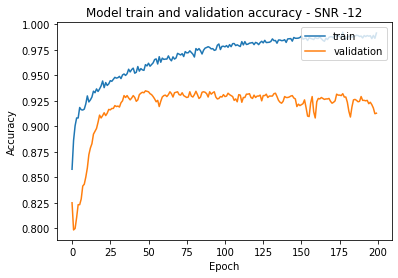

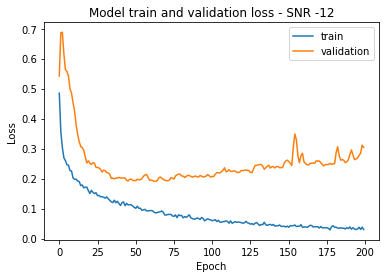


Training SNR = -12 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 2s 81ms/step - loss: 0.5109 - accuracy: 0.8449 - val_loss: 0.5377 - val_accuracy: 0.8154
Epoch 2/200
7/7 [==============================] - 0s 17ms/step - loss: 0.3414 - accuracy: 0.8928 - val_loss: 0.8354 - val_accuracy: 0.7776
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 0.2826 - accuracy: 0.9052 - val_loss: 0.9540 - val_accuracy: 0.7613
Epoch 4/200
7/7 [==============================] - 0s 13ms/step - loss: 0.2762 - accuracy: 0.9075 - val_loss: 0.8356 - val_accuracy: 0.7781
Epoch 5/200
7/7 [==============================] - 0s 13ms/step - loss: 0.2551 - accuracy: 0.9142 - val_loss: 0.7197 - val_accuracy: 0.7944
Epoch 6/200
7/7 [==============================] - 0s 14ms/step - loss: 0.2401 - accuracy: 0.9184 - val_loss: 0.6673 - val_accuracy: 0.8056
Epoch 7/200
7/7 [==============================] - 0s 12ms/step - loss: 0.2338 - accuracy: 0.9214 - va

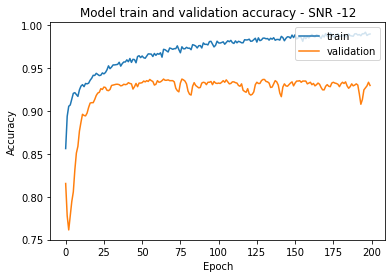

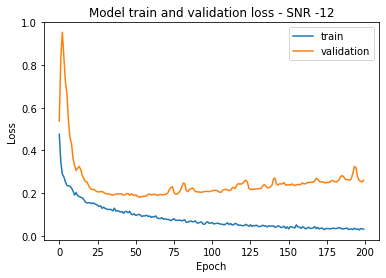


Training SNR = -12 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 2s 84ms/step - loss: 0.2692 - accuracy: 0.8954 - val_loss: 0.5134 - val_accuracy: 0.8182
Epoch 2/200
7/7 [==============================] - 0s 12ms/step - loss: 0.2285 - accuracy: 0.9123 - val_loss: 0.5171 - val_accuracy: 0.8145
Epoch 3/200
7/7 [==============================] - 0s 16ms/step - loss: 0.2117 - accuracy: 0.9163 - val_loss: 0.4436 - val_accuracy: 0.8303
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.1975 - accuracy: 0.9197 - val_loss: 0.3916 - val_accuracy: 0.8326
Epoch 5/200
7/7 [==============================] - 0s 13ms/step - loss: 0.1901 - accuracy: 0.9256 - val_loss: 0.4016 - val_accuracy: 0.8326
Epoch 6/200
7/7 [==============================] - 0s 17ms/step - loss: 0.1889 - accuracy: 0.9237 - val_loss: 0.4289 - val_accuracy: 0.8247
Epoch 7/200
7/7 [==============================] - 0s 11ms/step - loss: 0.1788 - accuracy: 0.9315 - val

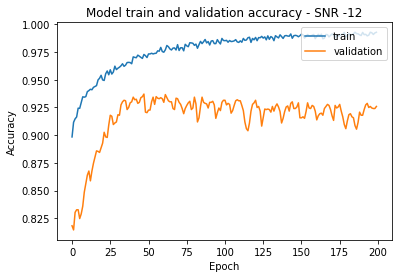

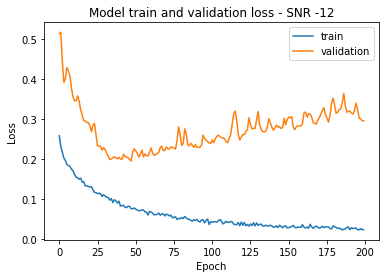

In [ ]:
for i in range(0, 5):

  x_data_mag = np.absolute(x_data_fft_data[:,:,:,:,0] + 1j*x_data_fft_data[:,:,:,:,1]) 
  x_data_fft_curr = np.reshape(x_data_mag[:,i], (x_dim[0]*x_dim[2], x_dim[3]))

  y_labels_fft_curr = y_labels_data[:,i].flatten()
  y_data_fft_curr = np.zeros(shape=(y_labels_fft_curr.shape[0], 3))
  
  for j in range(y_labels_fft_curr.shape[0]):
    if(0<=y_labels_fft_curr[j] and y_labels_fft_curr[j]<=9):
      y_data_fft_curr[j][0] = 1
    elif(10<=y_labels_fft_curr[j] and y_labels_fft_curr[j]<=12):
      y_data_fft_curr[j][1] = 1
    else:
      y_data_fft_curr[j][2] = 1

  X_train_curr, X_test_valid_curr, Y_train_curr, Y_test_valid_curr = train_test_split(x_data_fft_curr, y_data_fft_curr, test_size=0.4)
  X_validation_curr, X_test_curr, Y_validation_curr, Y_test_curr = train_test_split(X_test_valid_curr, Y_test_valid_curr, test_size=0.5)

  Testing(X_test_curr, Y_test_curr, i)
  train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_all_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_high_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_low_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)


Score of SNR on All SNR model without Transfer Learning -10 = 85.45454740524292
Score of SNR on High SNR model without Transfer Learning -10 = 85.54778695106506
Score of SNR on low SNR model without Transfer Learning -10 = 82.84382224082947

Training SNR = -10 Data

Epoch 1/200
7/7 [==============================] - 2s 82ms/step - loss: 1.2308 - accuracy: 0.3751 - val_loss: 1.0632 - val_accuracy: 0.5744
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 0.8688 - accuracy: 0.6247 - val_loss: 1.0511 - val_accuracy: 0.5730
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 0.7245 - accuracy: 0.7169 - val_loss: 1.0427 - val_accuracy: 0.6117
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.6212 - accuracy: 0.7650 - val_loss: 1.0332 - val_accuracy: 0.6765
Epoch 5/200
7/7 [==============================] - 0s 12ms/step - loss: 0.5392 - accuracy: 0.8109 - val_loss: 1.0367 - val_accuracy: 0.7179
Epoch 6/200
7/7 [===============

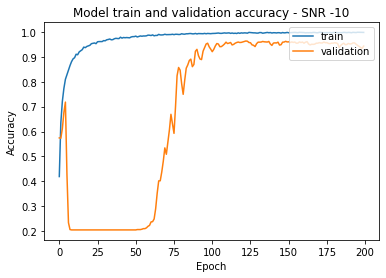

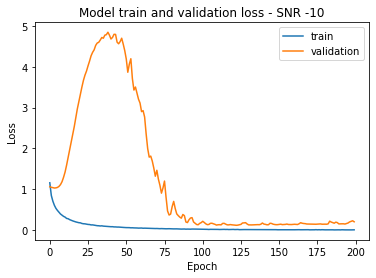


Training SNR = -10 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 2s 85ms/step - loss: 0.1948 - accuracy: 0.9330 - val_loss: 0.6871 - val_accuracy: 0.8280
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 0.1471 - accuracy: 0.9484 - val_loss: 1.0182 - val_accuracy: 0.7795
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 0.1111 - accuracy: 0.9592 - val_loss: 1.1122 - val_accuracy: 0.7669
Epoch 4/200
7/7 [==============================] - 0s 10ms/step - loss: 0.1049 - accuracy: 0.9609 - val_loss: 1.0575 - val_accuracy: 0.7767
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 0.1060 - accuracy: 0.9639 - val_loss: 1.0288 - val_accuracy: 0.7786
Epoch 6/200
7/7 [==============================] - 0s 11ms/step - loss: 0.1048 - accuracy: 0.9617 - val_loss: 0.8517 - val_accuracy: 0.8023
Epoch 7/200
7/7 [==============================] - 0s 10ms/step - loss: 0.1026 - accuracy: 0.9607 - val

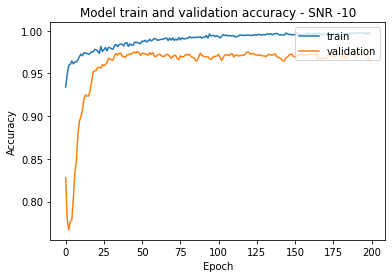

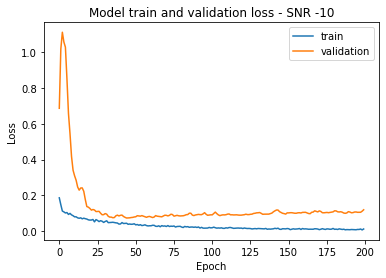


Training SNR = -10 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 2s 79ms/step - loss: 0.2223 - accuracy: 0.9232 - val_loss: 0.7010 - val_accuracy: 0.8261
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 0.1530 - accuracy: 0.9457 - val_loss: 1.1724 - val_accuracy: 0.7571
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 0.1246 - accuracy: 0.9555 - val_loss: 1.2367 - val_accuracy: 0.7487
Epoch 4/200
7/7 [==============================] - 0s 10ms/step - loss: 0.1150 - accuracy: 0.9577 - val_loss: 1.0754 - val_accuracy: 0.7655
Epoch 5/200
7/7 [==============================] - 0s 12ms/step - loss: 0.1041 - accuracy: 0.9617 - val_loss: 0.9130 - val_accuracy: 0.7911
Epoch 6/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0985 - accuracy: 0.9643 - val_loss: 0.7996 - val_accuracy: 0.8093
Epoch 7/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0896 - accuracy: 0.9666 - va

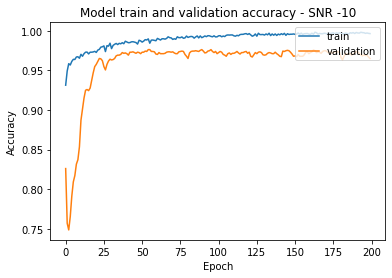

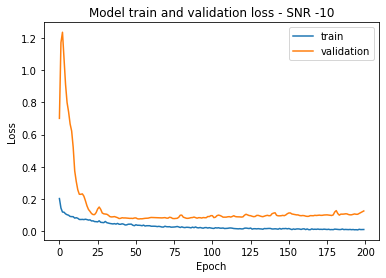


Training SNR = -10 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 2s 84ms/step - loss: 0.1600 - accuracy: 0.9420 - val_loss: 1.2210 - val_accuracy: 0.7263
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 0.1258 - accuracy: 0.9554 - val_loss: 1.6392 - val_accuracy: 0.6601
Epoch 3/200
7/7 [==============================] - 0s 13ms/step - loss: 0.1097 - accuracy: 0.9611 - val_loss: 1.1600 - val_accuracy: 0.7179
Epoch 4/200
7/7 [==============================] - 0s 13ms/step - loss: 0.1036 - accuracy: 0.9647 - val_loss: 0.7462 - val_accuracy: 0.7967
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0940 - accuracy: 0.9677 - val_loss: 0.5251 - val_accuracy: 0.8378
Epoch 6/200
7/7 [==============================] - 0s 13ms/step - loss: 0.0906 - accuracy: 0.9688 - val_loss: 0.4459 - val_accuracy: 0.8569
Epoch 7/200
7/7 [==============================] - 0s 10ms/step - loss: 0.0859 - accuracy: 0.9695 - val

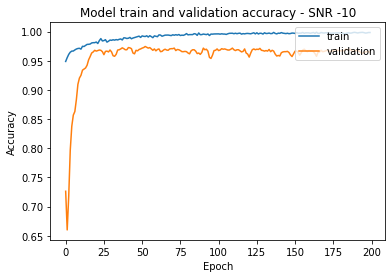

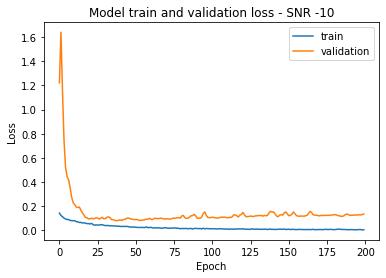


Score of SNR on All SNR model without Transfer Learning -8 = 92.72727370262146
Score of SNR on High SNR model without Transfer Learning -8 = 93.14685463905334
Score of SNR on low SNR model without Transfer Learning -8 = 90.5827522277832

Training SNR = -8 Data

Epoch 1/200
7/7 [==============================] - 2s 77ms/step - loss: 1.5152 - accuracy: 0.3426 - val_loss: 1.1303 - val_accuracy: 0.1828
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 1.0164 - accuracy: 0.6083 - val_loss: 1.1391 - val_accuracy: 0.2681
Epoch 3/200
7/7 [==============================] - 0s 10ms/step - loss: 0.8075 - accuracy: 0.7155 - val_loss: 1.1402 - val_accuracy: 0.3538
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.6602 - accuracy: 0.7814 - val_loss: 1.1514 - val_accuracy: 0.2848
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 0.5510 - accuracy: 0.8263 - val_loss: 1.1874 - val_accuracy: 0.2145
Epoch 6/200
7/7 [====================

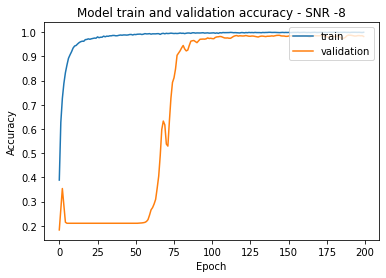

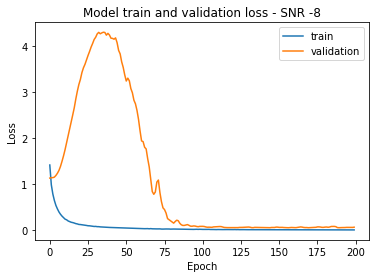


Training SNR = -8 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 2s 80ms/step - loss: 0.0869 - accuracy: 0.9698 - val_loss: 0.6086 - val_accuracy: 0.8513
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0528 - accuracy: 0.9819 - val_loss: 1.0689 - val_accuracy: 0.7865
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0466 - accuracy: 0.9850 - val_loss: 1.3803 - val_accuracy: 0.7338
Epoch 4/200
7/7 [==============================] - 0s 14ms/step - loss: 0.0434 - accuracy: 0.9862 - val_loss: 1.2830 - val_accuracy: 0.7492
Epoch 5/200
7/7 [==============================] - 0s 13ms/step - loss: 0.0371 - accuracy: 0.9890 - val_loss: 1.0661 - val_accuracy: 0.7809
Epoch 6/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0361 - accuracy: 0.9866 - val_loss: 0.8713 - val_accuracy: 0.8117
Epoch 7/200
7/7 [==============================] - 0s 14ms/step - loss: 0.0312 - accuracy: 0.9889 - val_

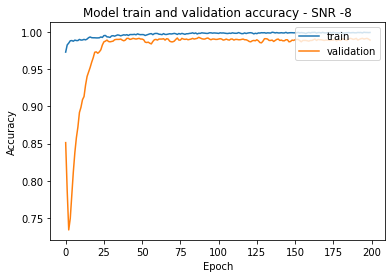

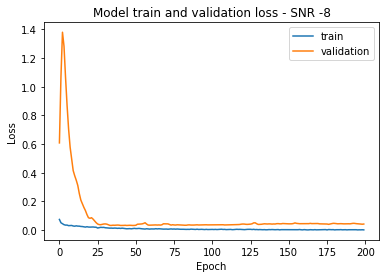


Training SNR = -8 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 2s 81ms/step - loss: 0.0815 - accuracy: 0.9726 - val_loss: 0.5858 - val_accuracy: 0.8592
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0560 - accuracy: 0.9810 - val_loss: 1.0252 - val_accuracy: 0.7963
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0392 - accuracy: 0.9871 - val_loss: 1.2892 - val_accuracy: 0.7473
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0393 - accuracy: 0.9872 - val_loss: 1.2677 - val_accuracy: 0.7464
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0403 - accuracy: 0.9862 - val_loss: 1.1526 - val_accuracy: 0.7646
Epoch 6/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0422 - accuracy: 0.9852 - val_loss: 0.9745 - val_accuracy: 0.7935
Epoch 7/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0347 - accuracy: 0.9876 - val

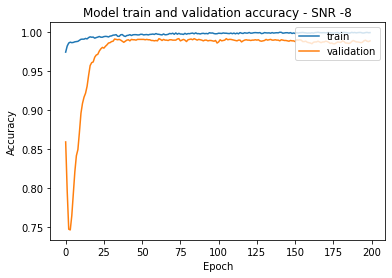

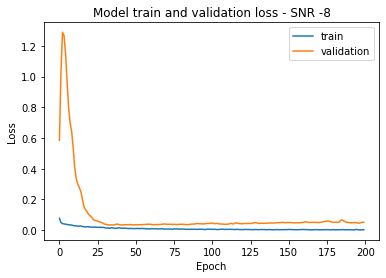


Training SNR = -8 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 2s 79ms/step - loss: 0.1021 - accuracy: 0.9672 - val_loss: 0.9374 - val_accuracy: 0.7851
Epoch 2/200
7/7 [==============================] - 0s 13ms/step - loss: 0.0594 - accuracy: 0.9806 - val_loss: 1.8508 - val_accuracy: 0.6233
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0531 - accuracy: 0.9835 - val_loss: 1.6555 - val_accuracy: 0.6429
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0468 - accuracy: 0.9844 - val_loss: 1.1603 - val_accuracy: 0.7254
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0417 - accuracy: 0.9883 - val_loss: 0.7759 - val_accuracy: 0.8070
Epoch 6/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0370 - accuracy: 0.9912 - val_loss: 0.5814 - val_accuracy: 0.8457
Epoch 7/200
7/7 [==============================] - 0s 10ms/step - loss: 0.0342 - accuracy: 0.9899 - val_

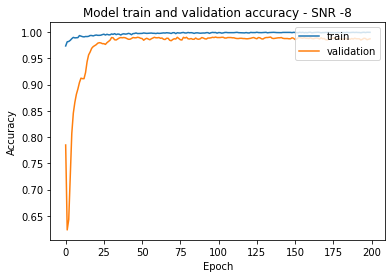

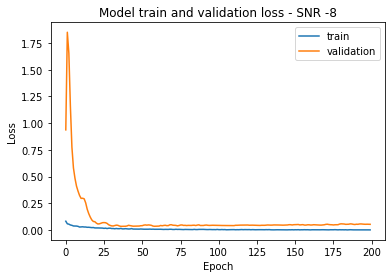


Score of SNR on All SNR model without Transfer Learning -6 = 95.85081338882446
Score of SNR on High SNR model without Transfer Learning -6 = 95.85081338882446
Score of SNR on low SNR model without Transfer Learning -6 = 95.5244779586792

Training SNR = -6 Data

Epoch 1/200
7/7 [==============================] - 2s 83ms/step - loss: 1.1665 - accuracy: 0.4247 - val_loss: 1.0942 - val_accuracy: 0.4186
Epoch 2/200
7/7 [==============================] - 0s 12ms/step - loss: 0.7346 - accuracy: 0.7248 - val_loss: 1.1098 - val_accuracy: 0.3492
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 0.5397 - accuracy: 0.8313 - val_loss: 1.1264 - val_accuracy: 0.3068
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.4232 - accuracy: 0.8816 - val_loss: 1.1546 - val_accuracy: 0.2247
Epoch 5/200
7/7 [==============================] - 0s 13ms/step - loss: 0.3407 - accuracy: 0.9149 - val_loss: 1.2049 - val_accuracy: 0.2042
Epoch 6/200
7/7 [====================

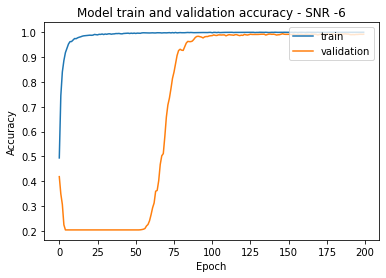

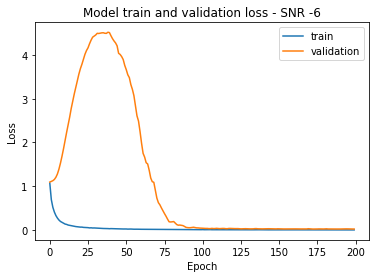


Training SNR = -6 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 2s 78ms/step - loss: 0.0458 - accuracy: 0.9867 - val_loss: 0.4381 - val_accuracy: 0.8895
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0257 - accuracy: 0.9925 - val_loss: 0.7220 - val_accuracy: 0.8457
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0220 - accuracy: 0.9933 - val_loss: 0.9046 - val_accuracy: 0.8266
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0220 - accuracy: 0.9928 - val_loss: 0.9528 - val_accuracy: 0.8145
Epoch 5/200
7/7 [==============================] - 0s 13ms/step - loss: 0.0205 - accuracy: 0.9929 - val_loss: 0.9840 - val_accuracy: 0.8070
Epoch 6/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0148 - accuracy: 0.9956 - val_loss: 1.0232 - val_accuracy: 0.7977
Epoch 7/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0142 - accuracy: 0.9951 - val_

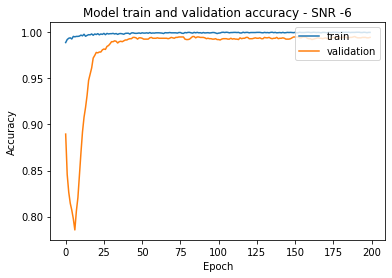

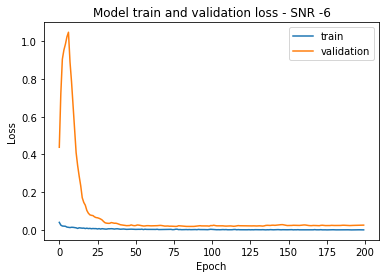


Training SNR = -6 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 2s 78ms/step - loss: 0.0465 - accuracy: 0.9848 - val_loss: 0.4443 - val_accuracy: 0.8918
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 0.0320 - accuracy: 0.9919 - val_loss: 0.7326 - val_accuracy: 0.8517
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0186 - accuracy: 0.9954 - val_loss: 0.9164 - val_accuracy: 0.8322
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0231 - accuracy: 0.9931 - val_loss: 0.9769 - val_accuracy: 0.8159
Epoch 5/200
7/7 [==============================] - 0s 14ms/step - loss: 0.0162 - accuracy: 0.9954 - val_loss: 0.9501 - val_accuracy: 0.8182
Epoch 6/200
7/7 [==============================] - 0s 10ms/step - loss: 0.0179 - accuracy: 0.9951 - val_loss: 0.9680 - val_accuracy: 0.8075
Epoch 7/200
7/7 [==============================] - 0s 14ms/step - loss: 0.0147 - accuracy: 0.9950 - val

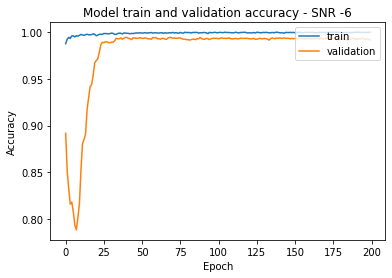

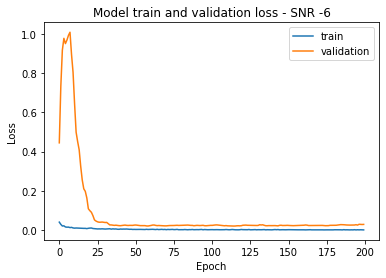


Training SNR = -6 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 2s 81ms/step - loss: 0.0699 - accuracy: 0.9750 - val_loss: 0.6682 - val_accuracy: 0.8438
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0392 - accuracy: 0.9889 - val_loss: 1.2991 - val_accuracy: 0.7170
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0324 - accuracy: 0.9924 - val_loss: 1.3845 - val_accuracy: 0.6904
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0265 - accuracy: 0.9939 - val_loss: 1.1405 - val_accuracy: 0.7441
Epoch 5/200
7/7 [==============================] - 0s 13ms/step - loss: 0.0243 - accuracy: 0.9941 - val_loss: 0.9317 - val_accuracy: 0.7865
Epoch 6/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0224 - accuracy: 0.9940 - val_loss: 0.7948 - val_accuracy: 0.8177
Epoch 7/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0188 - accuracy: 0.9959 - val_

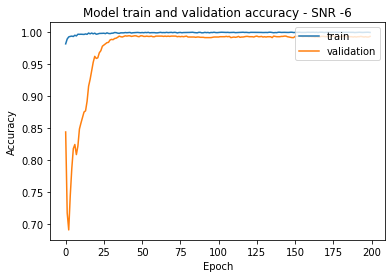

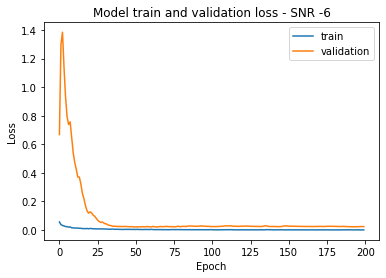


Score of SNR on All SNR model without Transfer Learning -4 = 97.7622389793396
Score of SNR on High SNR model without Transfer Learning -4 = 98.18181991577148
Score of SNR on low SNR model without Transfer Learning -4 = 97.85547852516174

Training SNR = -4 Data

Epoch 1/200
7/7 [==============================] - 2s 82ms/step - loss: 1.0816 - accuracy: 0.4723 - val_loss: 1.0882 - val_accuracy: 0.2998
Epoch 2/200
7/7 [==============================] - 0s 12ms/step - loss: 0.6065 - accuracy: 0.7898 - val_loss: 1.1184 - val_accuracy: 0.2862
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 0.4249 - accuracy: 0.8711 - val_loss: 1.1544 - val_accuracy: 0.2466
Epoch 4/200
7/7 [==============================] - 0s 12ms/step - loss: 0.3250 - accuracy: 0.9168 - val_loss: 1.2093 - val_accuracy: 0.2033
Epoch 5/200
7/7 [==============================] - 0s 13ms/step - loss: 0.2512 - accuracy: 0.9437 - val_loss: 1.2867 - val_accuracy: 0.1958
Epoch 6/200
7/7 [====================

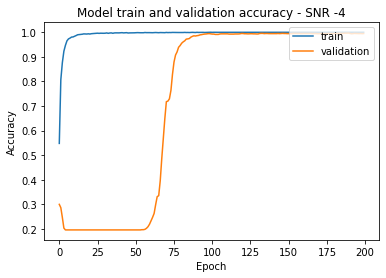

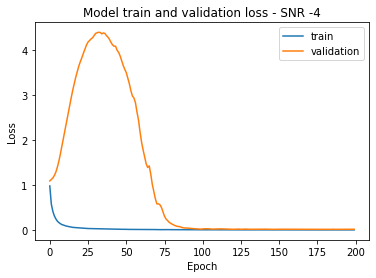


Training SNR = -4 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 2s 86ms/step - loss: 0.0330 - accuracy: 0.9908 - val_loss: 0.2788 - val_accuracy: 0.9217
Epoch 2/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0121 - accuracy: 0.9970 - val_loss: 0.5325 - val_accuracy: 0.8765
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0100 - accuracy: 0.9973 - val_loss: 0.7118 - val_accuracy: 0.8438
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0135 - accuracy: 0.9963 - val_loss: 0.7462 - val_accuracy: 0.8303
Epoch 5/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0090 - accuracy: 0.9972 - val_loss: 0.6817 - val_accuracy: 0.8420
Epoch 6/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0058 - accuracy: 0.9991 - val_loss: 0.6147 - val_accuracy: 0.8531
Epoch 7/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0059 - accuracy: 0.9984 - val_

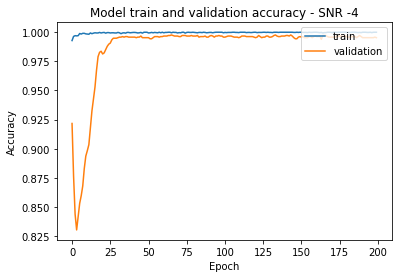

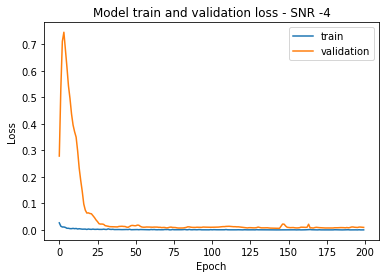


Training SNR = -4 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 2s 83ms/step - loss: 0.0318 - accuracy: 0.9905 - val_loss: 0.2411 - val_accuracy: 0.9249
Epoch 2/200
7/7 [==============================] - 0s 13ms/step - loss: 0.0205 - accuracy: 0.9938 - val_loss: 0.5453 - val_accuracy: 0.8769
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0095 - accuracy: 0.9985 - val_loss: 0.7886 - val_accuracy: 0.8331
Epoch 4/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0093 - accuracy: 0.9977 - val_loss: 0.8802 - val_accuracy: 0.8079
Epoch 5/200
7/7 [==============================] - 0s 15ms/step - loss: 0.0069 - accuracy: 0.9977 - val_loss: 0.7682 - val_accuracy: 0.8284
Epoch 6/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0069 - accuracy: 0.9982 - val_loss: 0.6246 - val_accuracy: 0.8545
Epoch 7/200
7/7 [==============================] - 0s 16ms/step - loss: 0.0063 - accuracy: 0.9981 - val

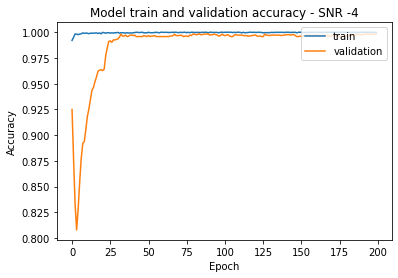

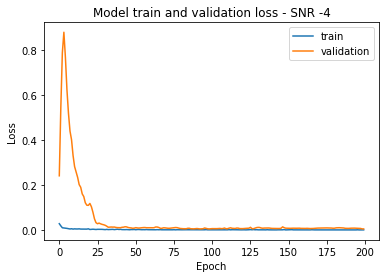


Training SNR = -4 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 2s 78ms/step - loss: 0.0561 - accuracy: 0.9822 - val_loss: 0.3929 - val_accuracy: 0.8988
Epoch 2/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0258 - accuracy: 0.9945 - val_loss: 1.0629 - val_accuracy: 0.7408
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0193 - accuracy: 0.9970 - val_loss: 1.5859 - val_accuracy: 0.6410
Epoch 4/200
7/7 [==============================] - 0s 16ms/step - loss: 0.0182 - accuracy: 0.9969 - val_loss: 1.5129 - val_accuracy: 0.6494
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 0.0143 - accuracy: 0.9981 - val_loss: 1.2794 - val_accuracy: 0.6914
Epoch 6/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0131 - accuracy: 0.9978 - val_loss: 0.9812 - val_accuracy: 0.7450
Epoch 7/200
7/7 [==============================] - 0s 16ms/step - loss: 0.0105 - accuracy: 0.9983 - val_

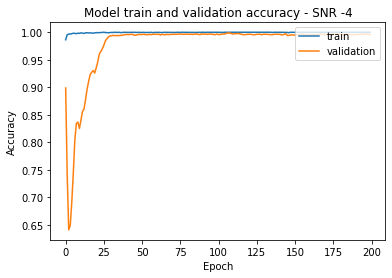

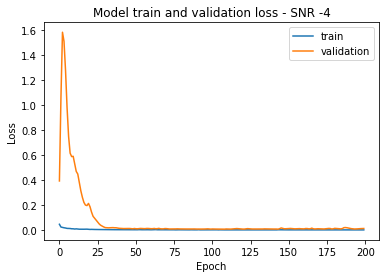


Score of SNR on All SNR model without Transfer Learning -2 = 98.6480176448822
Score of SNR on High SNR model without Transfer Learning -2 = 98.8811194896698
Score of SNR on low SNR model without Transfer Learning -2 = 98.36829900741577

Training SNR = -2 Data

Epoch 1/200
7/7 [==============================] - 2s 86ms/step - loss: 1.0637 - accuracy: 0.4881 - val_loss: 1.0969 - val_accuracy: 0.3562
Epoch 2/200
7/7 [==============================] - 0s 12ms/step - loss: 0.5965 - accuracy: 0.8010 - val_loss: 1.1444 - val_accuracy: 0.2238
Epoch 3/200
7/7 [==============================] - 0s 10ms/step - loss: 0.3950 - accuracy: 0.8937 - val_loss: 1.2100 - val_accuracy: 0.1925
Epoch 4/200
7/7 [==============================] - 0s 13ms/step - loss: 0.2886 - accuracy: 0.9407 - val_loss: 1.3000 - val_accuracy: 0.1925
Epoch 5/200
7/7 [==============================] - 0s 13ms/step - loss: 0.2185 - accuracy: 0.9554 - val_loss: 1.4097 - val_accuracy: 0.1925
Epoch 6/200
7/7 [=====================

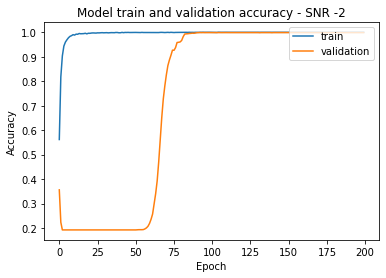

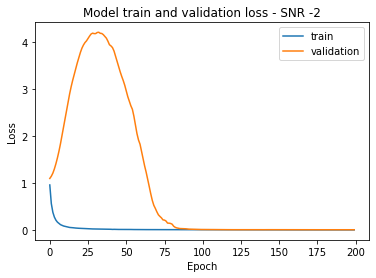


Training SNR = -2 Data on a pre-trained All SNR model

Epoch 1/200
7/7 [==============================] - 2s 79ms/step - loss: 0.0184 - accuracy: 0.9966 - val_loss: 0.1116 - val_accuracy: 0.9655
Epoch 2/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0067 - accuracy: 0.9989 - val_loss: 0.1930 - val_accuracy: 0.9431
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0051 - accuracy: 0.9987 - val_loss: 0.2346 - val_accuracy: 0.9338
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0042 - accuracy: 0.9992 - val_loss: 0.2432 - val_accuracy: 0.9273
Epoch 5/200
7/7 [==============================] - 0s 13ms/step - loss: 0.0032 - accuracy: 0.9997 - val_loss: 0.2181 - val_accuracy: 0.9343
Epoch 6/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0025 - accuracy: 0.9996 - val_loss: 0.1789 - val_accuracy: 0.9478
Epoch 7/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0021 - accuracy: 0.9997 - val_

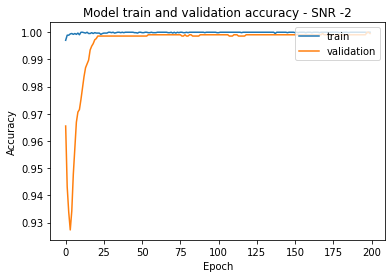

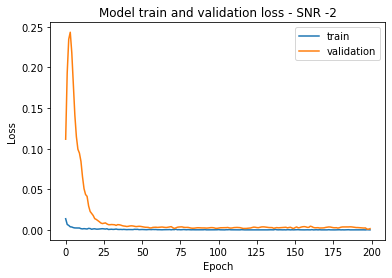


Training SNR = -2 Data on a pre-trained High SNR model

Epoch 1/200
7/7 [==============================] - 2s 80ms/step - loss: 0.0196 - accuracy: 0.9955 - val_loss: 0.1310 - val_accuracy: 0.9571
Epoch 2/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0073 - accuracy: 0.9978 - val_loss: 0.2305 - val_accuracy: 0.9366
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 0.0056 - accuracy: 0.9986 - val_loss: 0.2813 - val_accuracy: 0.9226
Epoch 4/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0064 - accuracy: 0.9992 - val_loss: 0.2917 - val_accuracy: 0.9184
Epoch 5/200
7/7 [==============================] - 0s 16ms/step - loss: 0.0048 - accuracy: 0.9987 - val_loss: 0.2491 - val_accuracy: 0.9301
Epoch 6/200
7/7 [==============================] - 0s 14ms/step - loss: 0.0028 - accuracy: 0.9994 - val_loss: 0.1993 - val_accuracy: 0.9385
Epoch 7/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0020 - accuracy: 0.9999 - val

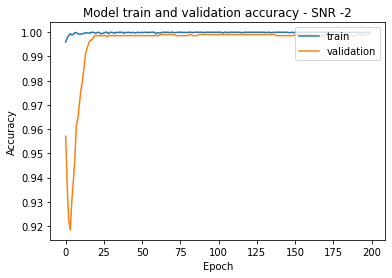

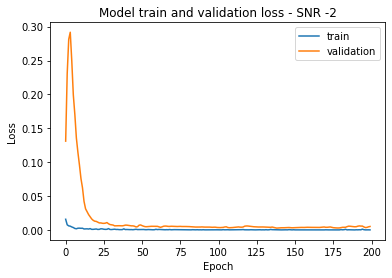


Training SNR = -2 Data on a pre-trained Low SNR model

Epoch 1/200
7/7 [==============================] - 2s 85ms/step - loss: 0.0437 - accuracy: 0.9869 - val_loss: 0.1145 - val_accuracy: 0.9678
Epoch 2/200
7/7 [==============================] - 0s 15ms/step - loss: 0.0162 - accuracy: 0.9979 - val_loss: 0.2631 - val_accuracy: 0.9147
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0144 - accuracy: 0.9982 - val_loss: 0.3549 - val_accuracy: 0.8867
Epoch 4/200
7/7 [==============================] - 0s 21ms/step - loss: 0.0091 - accuracy: 0.9992 - val_loss: 0.3297 - val_accuracy: 0.8909
Epoch 5/200
7/7 [==============================] - 0s 17ms/step - loss: 0.0082 - accuracy: 0.9983 - val_loss: 0.2543 - val_accuracy: 0.9193
Epoch 6/200
7/7 [==============================] - 0s 12ms/step - loss: 0.0082 - accuracy: 0.9988 - val_loss: 0.2050 - val_accuracy: 0.9352
Epoch 7/200
7/7 [==============================] - 0s 14ms/step - loss: 0.0064 - accuracy: 0.9988 - val_

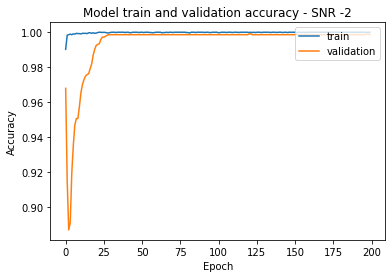

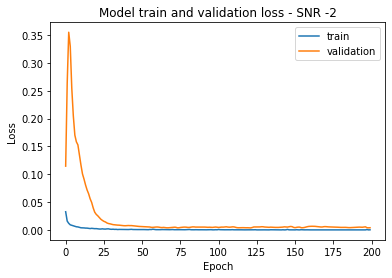

In [ ]:
for i in range(5, 10):

  x_data_mag = np.absolute(x_data_fft_data[:,:,:,:,0] + 1j*x_data_fft_data[:,:,:,:,1]) 
  x_data_fft_curr = np.reshape(x_data_mag[:,i], (x_dim[0]*x_dim[2], x_dim[3]))

  y_labels_fft_curr = y_labels_data[:,i].flatten()
  y_data_fft_curr = np.zeros(shape=(y_labels_fft_curr.shape[0], 3))
  
  for j in range(y_labels_fft_curr.shape[0]):
    if(0<=y_labels_fft_curr[j] and y_labels_fft_curr[j]<=9):
      y_data_fft_curr[j][0] = 1
    elif(10<=y_labels_fft_curr[j] and y_labels_fft_curr[j]<=12):
      y_data_fft_curr[j][1] = 1
    else:
      y_data_fft_curr[j][2] = 1

  X_train_curr, X_test_valid_curr, Y_train_curr, Y_test_valid_curr = train_test_split(x_data_fft_curr, y_data_fft_curr, test_size=0.4)
  X_validation_curr, X_test_curr, Y_validation_curr, Y_test_curr = train_test_split(X_test_valid_curr, Y_test_valid_curr, test_size=0.5)

  Testing(X_test_curr, Y_test_curr, i)
  train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_all_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_high_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_low_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)


Score of SNR on All SNR model without Transfer Learning 0 = 99.44055676460266
Score of SNR on High SNR model without Transfer Learning 0 = 99.44055676460266
Score of SNR on low SNR model without Transfer Learning 0 = 98.92773628234863

Training SNR = 0 Data

Epoch 1/200
7/7 [==============================] - 2s 75ms/step - loss: 0.9903 - accuracy: 0.5293 - val_loss: 1.0883 - val_accuracy: 0.3347
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 0.5264 - accuracy: 0.8288 - val_loss: 1.1033 - val_accuracy: 0.2396
Epoch 3/200
7/7 [==============================] - 0s 10ms/step - loss: 0.3505 - accuracy: 0.9097 - val_loss: 1.1348 - val_accuracy: 0.1967
Epoch 4/200
7/7 [==============================] - 0s 10ms/step - loss: 0.2425 - accuracy: 0.9486 - val_loss: 1.1866 - val_accuracy: 0.1958
Epoch 5/200
7/7 [==============================] - 0s 12ms/step - loss: 0.1890 - accuracy: 0.9637 - val_loss: 1.2577 - val_accuracy: 0.1958
Epoch 6/200
7/7 [=======================

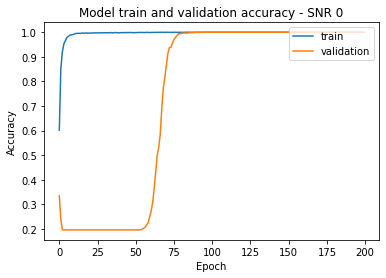

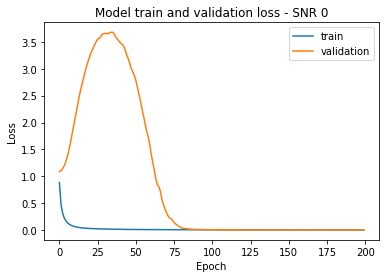


Score of SNR on All SNR model without Transfer Learning 2 = 99.25407767295837
Score of SNR on High SNR model without Transfer Learning 2 = 99.34731721878052
Score of SNR on low SNR model without Transfer Learning 2 = 99.1142213344574

Training SNR = 2 Data

Epoch 1/200
7/7 [==============================] - 2s 80ms/step - loss: 1.0742 - accuracy: 0.4974 - val_loss: 1.0909 - val_accuracy: 0.2909
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 0.5575 - accuracy: 0.8180 - val_loss: 1.1488 - val_accuracy: 0.2918
Epoch 3/200
7/7 [==============================] - 0s 10ms/step - loss: 0.3566 - accuracy: 0.9043 - val_loss: 1.2129 - val_accuracy: 0.2648
Epoch 4/200
7/7 [==============================] - 0s 10ms/step - loss: 0.2572 - accuracy: 0.9378 - val_loss: 1.2821 - val_accuracy: 0.2089
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 0.1786 - accuracy: 0.9699 - val_loss: 1.3630 - val_accuracy: 0.1925
Epoch 6/200
7/7 [========================

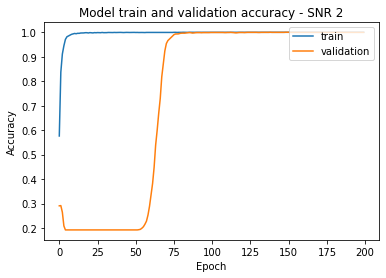

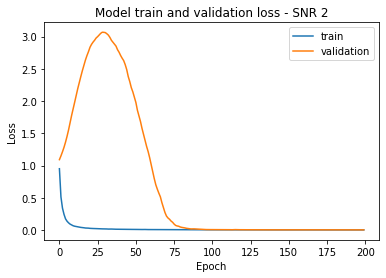


Score of SNR on All SNR model without Transfer Learning 4 = 99.72028136253357
Score of SNR on High SNR model without Transfer Learning 4 = 99.7668981552124
Score of SNR on low SNR model without Transfer Learning 4 = 99.44055676460266

Training SNR = 4 Data

Epoch 1/200
7/7 [==============================] - 2s 77ms/step - loss: 1.1140 - accuracy: 0.4469 - val_loss: 1.0821 - val_accuracy: 0.3664
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 0.5460 - accuracy: 0.8284 - val_loss: 1.1187 - val_accuracy: 0.3082
Epoch 3/200
7/7 [==============================] - 0s 10ms/step - loss: 0.3473 - accuracy: 0.9210 - val_loss: 1.1726 - val_accuracy: 0.2242
Epoch 4/200
7/7 [==============================] - 0s 10ms/step - loss: 0.2535 - accuracy: 0.9494 - val_loss: 1.2366 - val_accuracy: 0.2023
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 0.1846 - accuracy: 0.9692 - val_loss: 1.3115 - val_accuracy: 0.2023
Epoch 6/200
7/7 [========================

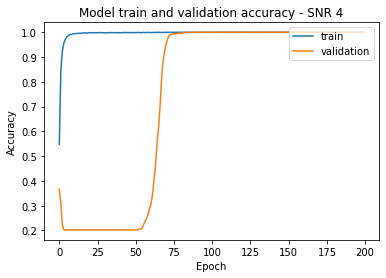

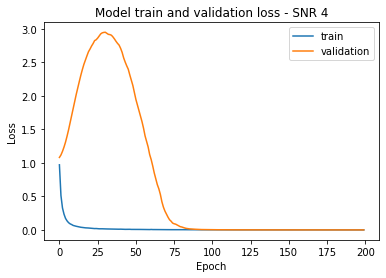


Score of SNR on All SNR model without Transfer Learning 6 = 99.72028136253357
Score of SNR on High SNR model without Transfer Learning 6 = 99.72028136253357
Score of SNR on low SNR model without Transfer Learning 6 = 99.44055676460266

Training SNR = 6 Data

Epoch 1/200
7/7 [==============================] - 2s 80ms/step - loss: 1.1472 - accuracy: 0.4675 - val_loss: 1.1123 - val_accuracy: 0.2727
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 0.5461 - accuracy: 0.8329 - val_loss: 1.1592 - val_accuracy: 0.2042
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 0.3449 - accuracy: 0.9166 - val_loss: 1.2250 - val_accuracy: 0.2000
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.2426 - accuracy: 0.9549 - val_loss: 1.2998 - val_accuracy: 0.2000
Epoch 5/200
7/7 [==============================] - 0s 13ms/step - loss: 0.1762 - accuracy: 0.9717 - val_loss: 1.3801 - val_accuracy: 0.2000
Epoch 6/200
7/7 [=======================

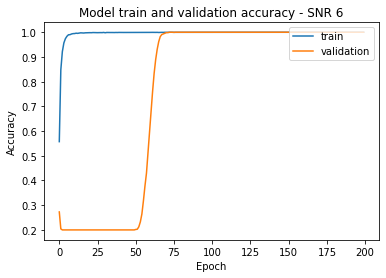

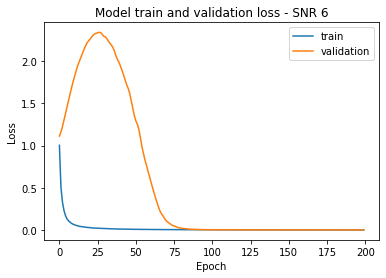


Score of SNR on All SNR model without Transfer Learning 8 = 99.90676045417786
Score of SNR on High SNR model without Transfer Learning 8 = 99.86013770103455
Score of SNR on low SNR model without Transfer Learning 8 = 99.72028136253357

Training SNR = 8 Data

Epoch 1/200
7/7 [==============================] - 2s 85ms/step - loss: 0.9933 - accuracy: 0.5334 - val_loss: 1.0839 - val_accuracy: 0.2620
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 0.4629 - accuracy: 0.8586 - val_loss: 1.1148 - val_accuracy: 0.1972
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 0.2877 - accuracy: 0.9313 - val_loss: 1.1658 - val_accuracy: 0.1930
Epoch 4/200
7/7 [==============================] - 0s 13ms/step - loss: 0.2007 - accuracy: 0.9647 - val_loss: 1.2353 - val_accuracy: 0.1930
Epoch 5/200
7/7 [==============================] - 0s 12ms/step - loss: 0.1446 - accuracy: 0.9803 - val_loss: 1.3172 - val_accuracy: 0.1930
Epoch 6/200
7/7 [=======================

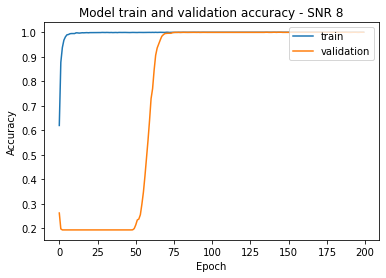

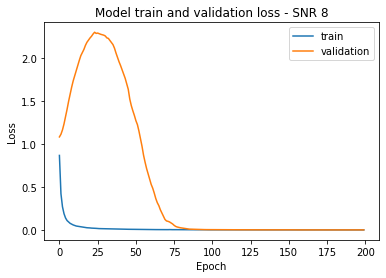

In [ ]:
for i in range(10, 15):

  x_data_mag = np.absolute(x_data_fft_data[:,:,:,:,0] + 1j*x_data_fft_data[:,:,:,:,1]) 
  x_data_fft_curr = np.reshape(x_data_mag[:,i], (x_dim[0]*x_dim[2], x_dim[3]))

  y_labels_fft_curr = y_labels_data[:,i].flatten()
  y_data_fft_curr = np.zeros(shape=(y_labels_fft_curr.shape[0], 3))
  
  for j in range(y_labels_fft_curr.shape[0]):
    if(0<=y_labels_fft_curr[j] and y_labels_fft_curr[j]<=9):
      y_data_fft_curr[j][0] = 1
    elif(10<=y_labels_fft_curr[j] and y_labels_fft_curr[j]<=12):
      y_data_fft_curr[j][1] = 1
    else:
      y_data_fft_curr[j][2] = 1

  X_train_curr, X_test_valid_curr, Y_train_curr, Y_test_valid_curr = train_test_split(x_data_fft_curr, y_data_fft_curr, test_size=0.4)
  X_validation_curr, X_test_curr, Y_validation_curr, Y_test_curr = train_test_split(X_test_valid_curr, Y_test_valid_curr, test_size=0.5)

  Testing(X_test_curr, Y_test_curr, i)
  train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)


Score of SNR on All SNR model without Transfer Learning 10 = 99.72028136253357
Score of SNR on High SNR model without Transfer Learning 10 = 99.72028136253357
Score of SNR on low SNR model without Transfer Learning 10 = 99.48717951774597

Training SNR = 10 Data

Epoch 1/200
7/7 [==============================] - 2s 84ms/step - loss: 1.1485 - accuracy: 0.4418 - val_loss: 1.0720 - val_accuracy: 0.4242
Epoch 2/200
7/7 [==============================] - 0s 12ms/step - loss: 0.5143 - accuracy: 0.8328 - val_loss: 1.0878 - val_accuracy: 0.2438
Epoch 3/200
7/7 [==============================] - 0s 10ms/step - loss: 0.3309 - accuracy: 0.9147 - val_loss: 1.1325 - val_accuracy: 0.1986
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.2313 - accuracy: 0.9545 - val_loss: 1.2016 - val_accuracy: 0.1986
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 0.1653 - accuracy: 0.9744 - val_loss: 1.2854 - val_accuracy: 0.1986
Epoch 6/200
7/7 [===================

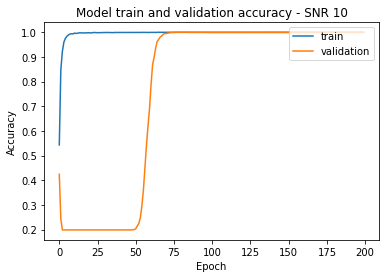

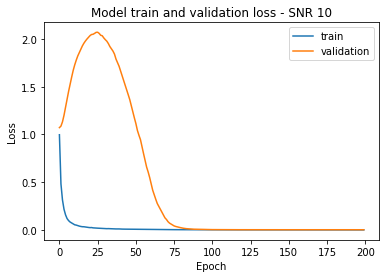


Score of SNR on All SNR model without Transfer Learning 12 = 99.81352090835571
Score of SNR on High SNR model without Transfer Learning 12 = 99.81352090835571
Score of SNR on low SNR model without Transfer Learning 12 = 99.58041906356812

Training SNR = 12 Data

Epoch 1/200
7/7 [==============================] - 2s 80ms/step - loss: 0.9331 - accuracy: 0.5465 - val_loss: 1.0697 - val_accuracy: 0.3427
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 0.3988 - accuracy: 0.8911 - val_loss: 1.1047 - val_accuracy: 0.2275
Epoch 3/200
7/7 [==============================] - 0s 10ms/step - loss: 0.2423 - accuracy: 0.9527 - val_loss: 1.1511 - val_accuracy: 0.2098
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.1657 - accuracy: 0.9719 - val_loss: 1.2055 - val_accuracy: 0.2047
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 0.1200 - accuracy: 0.9856 - val_loss: 1.2697 - val_accuracy: 0.2047
Epoch 6/200
7/7 [===================

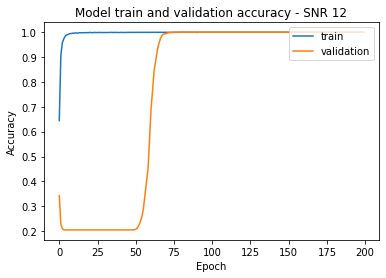

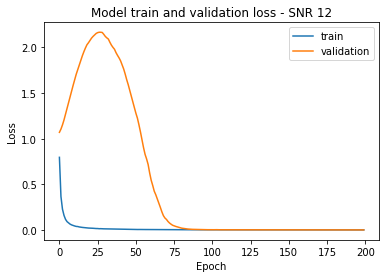


Score of SNR on All SNR model without Transfer Learning 14 = 99.81352090835571
Score of SNR on High SNR model without Transfer Learning 14 = 99.86013770103455
Score of SNR on low SNR model without Transfer Learning 14 = 99.53380227088928

Training SNR = 14 Data

Epoch 1/200
7/7 [==============================] - 2s 77ms/step - loss: 0.9428 - accuracy: 0.5811 - val_loss: 1.0765 - val_accuracy: 0.3716
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 0.4089 - accuracy: 0.8757 - val_loss: 1.1066 - val_accuracy: 0.3077
Epoch 3/200
7/7 [==============================] - 0s 12ms/step - loss: 0.2503 - accuracy: 0.9473 - val_loss: 1.1361 - val_accuracy: 0.2471
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.1815 - accuracy: 0.9671 - val_loss: 1.1712 - val_accuracy: 0.2140
Epoch 5/200
7/7 [==============================] - 0s 10ms/step - loss: 0.1313 - accuracy: 0.9789 - val_loss: 1.2097 - val_accuracy: 0.2065
Epoch 6/200
7/7 [===================

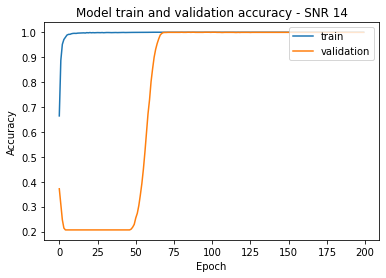

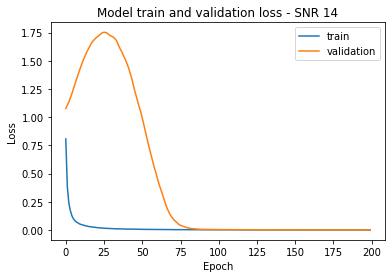


Score of SNR on All SNR model without Transfer Learning 16 = 99.90676045417786
Score of SNR on High SNR model without Transfer Learning 16 = 99.86013770103455
Score of SNR on low SNR model without Transfer Learning 16 = 99.67365860939026

Training SNR = 16 Data

Epoch 1/200
7/7 [==============================] - 2s 80ms/step - loss: 0.8334 - accuracy: 0.6575 - val_loss: 1.0546 - val_accuracy: 0.5161
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 0.3432 - accuracy: 0.9046 - val_loss: 1.0627 - val_accuracy: 0.3590
Epoch 3/200
7/7 [==============================] - 0s 10ms/step - loss: 0.1951 - accuracy: 0.9531 - val_loss: 1.0913 - val_accuracy: 0.2107
Epoch 4/200
7/7 [==============================] - 0s 12ms/step - loss: 0.1355 - accuracy: 0.9778 - val_loss: 1.1281 - val_accuracy: 0.1972
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 0.1012 - accuracy: 0.9870 - val_loss: 1.1713 - val_accuracy: 0.1972
Epoch 6/200
7/7 [===================

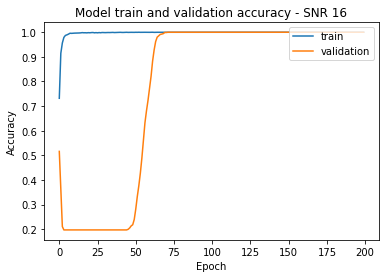

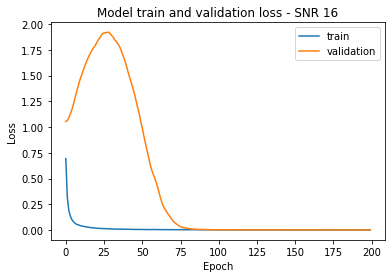


Score of SNR on All SNR model without Transfer Learning 18 = 99.86013770103455
Score of SNR on High SNR model without Transfer Learning 18 = 99.86013770103455
Score of SNR on low SNR model without Transfer Learning 18 = 99.39393997192383

Training SNR = 18 Data

Epoch 1/200
7/7 [==============================] - 2s 80ms/step - loss: 1.0626 - accuracy: 0.4874 - val_loss: 1.0557 - val_accuracy: 0.4224
Epoch 2/200
7/7 [==============================] - 0s 10ms/step - loss: 0.4801 - accuracy: 0.8345 - val_loss: 1.0593 - val_accuracy: 0.2625
Epoch 3/200
7/7 [==============================] - 0s 13ms/step - loss: 0.2779 - accuracy: 0.9385 - val_loss: 1.0831 - val_accuracy: 0.2145
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.2003 - accuracy: 0.9640 - val_loss: 1.1140 - val_accuracy: 0.2126
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 0.1434 - accuracy: 0.9778 - val_loss: 1.1542 - val_accuracy: 0.2121
Epoch 6/200
7/7 [===================

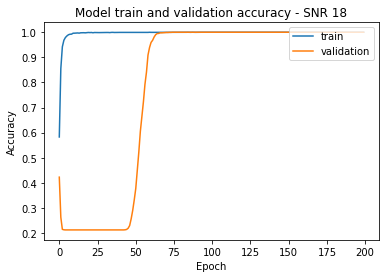

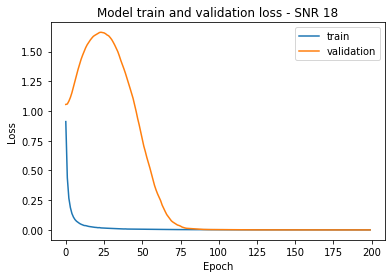


Score of SNR on All SNR model without Transfer Learning 20 = 99.90676045417786
Score of SNR on High SNR model without Transfer Learning 20 = 99.95337724685669
Score of SNR on low SNR model without Transfer Learning 20 = 99.67365860939026

Training SNR = 20 Data

Epoch 1/200
7/7 [==============================] - 2s 82ms/step - loss: 1.0696 - accuracy: 0.5253 - val_loss: 1.0808 - val_accuracy: 0.2946
Epoch 2/200
7/7 [==============================] - 0s 11ms/step - loss: 0.4590 - accuracy: 0.8534 - val_loss: 1.1001 - val_accuracy: 0.2382
Epoch 3/200
7/7 [==============================] - 0s 11ms/step - loss: 0.2663 - accuracy: 0.9286 - val_loss: 1.1369 - val_accuracy: 0.2084
Epoch 4/200
7/7 [==============================] - 0s 11ms/step - loss: 0.1780 - accuracy: 0.9679 - val_loss: 1.1947 - val_accuracy: 0.2056
Epoch 5/200
7/7 [==============================] - 0s 11ms/step - loss: 0.1200 - accuracy: 0.9837 - val_loss: 1.2614 - val_accuracy: 0.2056
Epoch 6/200
7/7 [===================

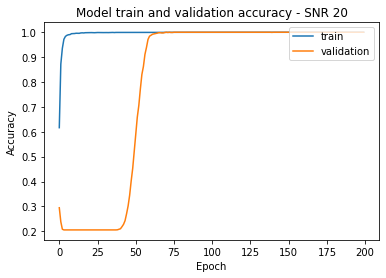

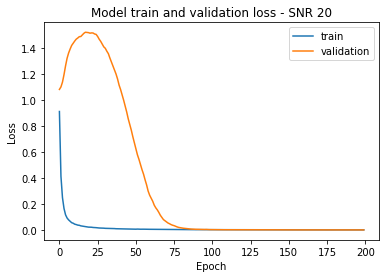

In [ ]:
for i in range(15, 21):

  x_data_mag = np.absolute(x_data_fft_data[:,:,:,:,0] + 1j*x_data_fft_data[:,:,:,:,1]) 
  x_data_fft_curr = np.reshape(x_data_mag[:,i], (x_dim[0]*x_dim[2], x_dim[3]))

  y_labels_fft_curr = y_labels_data[:,i].flatten()
  y_data_fft_curr = np.zeros(shape=(y_labels_fft_curr.shape[0], 3))
  
  for j in range(y_labels_fft_curr.shape[0]):
    if(0<=y_labels_fft_curr[j] and y_labels_fft_curr[j]<=9):
      y_data_fft_curr[j][0] = 1
    elif(10<=y_labels_fft_curr[j] and y_labels_fft_curr[j]<=12):
      y_data_fft_curr[j][1] = 1
    else:
      y_data_fft_curr[j][2] = 1

  X_train_curr, X_test_valid_curr, Y_train_curr, Y_test_valid_curr = train_test_split(x_data_fft_curr, y_data_fft_curr, test_size=0.4)
  X_validation_curr, X_test_curr, Y_validation_curr, Y_test_curr = train_test_split(X_test_valid_curr, Y_test_valid_curr, test_size=0.5)

  Testing(X_test_curr, Y_test_curr, i)
  train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)

# Bluetooth

## Whole data

In [ ]:
x_data_fft_bluetooth = x_data_fft_data[0:10]
y_labels_bluetooth = y_labels_data[0:10]

print(x_data_fft_bluetooth.shape)
print(y_labels_bluetooth.shape)

(10, 21, 715, 128, 2)
(10, 21, 715)


In [ ]:
x_dim = x_data_fft_bluetooth.shape
total_num_snapshots = x_dim[0]*x_dim[1]*x_dim[2]
num_snapshots_per_tech = x_dim[1]*x_dim[2]
num_tech = x_dim[0]
num_samples = x_dim[3]
print(num_snapshots_per_tech)

15015


In [ ]:
from sklearn.preprocessing import MinMaxScaler

# Bin wise scalers for FFT data from sklearn
scaler_01 = MinMaxScaler(feature_range=(0,1))

x_data_fft_all_SNR_1d = np.reshape(x_data_fft_bluetooth, (total_num_snapshots, num_samples*x_dim[4]))
fft_data_complex = np.reshape(x_data_fft_all_SNR_1d.flatten()[::2] + 1j*x_data_fft_all_SNR_1d.flatten()[1::2], (total_num_snapshots, num_samples))
x_data_fft_all_SNR_1d = scaler_01.fit_transform(np.absolute(fft_data_complex))

In [ ]:
from keras.utils.np_utils import to_categorical

y_labels_all_SNR = y_labels_bluetooth.flatten()
y_labels_one_hot_all_SNR = to_categorical(y_labels_all_SNR)

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test_valid, Y_train, Y_test_valid = train_test_split(x_data_fft_all_SNR_1d, y_labels_one_hot_all_SNR, test_size=0.4)
X_validation, X_test, Y_validation, Y_test = train_test_split(X_test_valid, Y_test_valid, test_size=0.5)

In [ ]:
from keras.callbacks import EarlyStopping
ES = EarlyStopping(monitor = 'val_accuracy', mode = 'max', min_delta = 0.00001, patience = 200, verbose = 1)

import logging
logging.disable(logging.WARNING)

Epoch 1/200
88/88 [==============================] - 3s 13ms/step - loss: 0.8785 - accuracy: 0.7715 - val_loss: 1.4418 - val_accuracy: 0.9389
Epoch 2/200
88/88 [==============================] - 1s 8ms/step - loss: 0.2270 - accuracy: 0.9394 - val_loss: 0.9395 - val_accuracy: 0.9482
Epoch 3/200
88/88 [==============================] - 1s 8ms/step - loss: 0.1939 - accuracy: 0.9478 - val_loss: 0.5174 - val_accuracy: 0.9500
Epoch 4/200
88/88 [==============================] - 1s 7ms/step - loss: 0.1796 - accuracy: 0.9500 - val_loss: 0.2762 - val_accuracy: 0.9500
Epoch 5/200
88/88 [==============================] - 1s 8ms/step - loss: 0.1747 - accuracy: 0.9503 - val_loss: 0.1925 - val_accuracy: 0.9511
Epoch 6/200
88/88 [==============================] - 1s 8ms/step - loss: 0.1682 - accuracy: 0.9506 - val_loss: 0.1682 - val_accuracy: 0.9513
Epoch 7/200
88/88 [==============================] - 1s 7ms/step - loss: 0.1660 - accuracy: 0.9510 - val_loss: 0.1613 - val_accuracy: 0.9522
Epoch 8/200


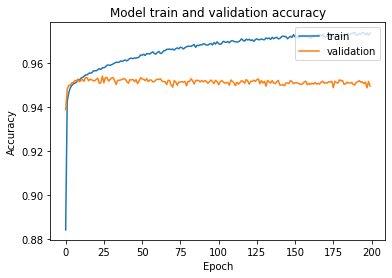

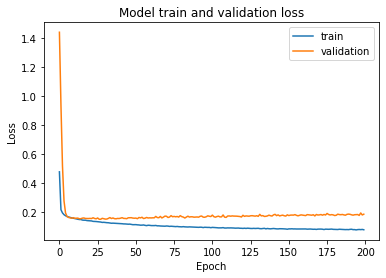


Training Accuracy Array:  [0.8842712640762329, 0.942624032497406, 0.9466200470924377, 0.9488511681556702, 0.9499056339263916, 0.9506604671478271, 0.9509934782981873, 0.9514041543006897, 0.9524253606796265, 0.952392041683197, 0.9532578587532043, 0.9535464644432068, 0.9541125297546387, 0.9547119736671448, 0.9547563791275024, 0.9553890824317932, 0.9556110501289368, 0.955622136592865, 0.9564879536628723, 0.956665575504303, 0.9565767645835876, 0.9570984840393066, 0.9575757384300232, 0.9571983814239502, 0.9580197334289551, 0.9579753875732422, 0.9583749771118164, 0.9591408371925354, 0.9592074751853943, 0.9590853452682495, 0.9593517780303955, 0.9597402811050415, 0.9601398706436157, 0.9604950547218323, 0.9604173898696899, 0.9605505466461182, 0.9610944390296936, 0.96087247133255, 0.9612942337989807, 0.9615273475646973, 0.9611166715621948, 0.9615939855575562, 0.9622710347175598, 0.9623265862464905, 0.9620934724807739, 0.9624597430229187, 0.9623487591743469, 0.9625707864761353, 0.9628260731697083

In [ ]:
fcn_learning = fcn_model_bluetooth()

epochs = 200
batch_size = 1024

history = fcn_learning.fit(X_train, Y_train, epochs=epochs, batch_size=batch_size,  validation_data = (X_validation, Y_validation), shuffle=True, callbacks=[ES])

score = fcn_learning.evaluate(X_test, Y_test, verbose=0)
print('\nEvaluating on Test data : Score of SNR  = ' + str(score[1]*100) +'\n')

summarize_model(history)
fcn_learning.save("/gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_allSNR_bluetooth.tf")

print("\nTraining Accuracy Array: ", history.history['accuracy'])
print("\nValidation Accuracy Array: ", history.history['val_accuracy'])

## High SNR

In [ ]:
x_data_fft_high_SNR_bluetooth = x_data_fft_data[0:10,10:21]
y_labels_high_SNR_bluetooth = y_labels_data[0:10,10:21]

print(x_data_fft_high_SNR_bluetooth.shape)
print(y_labels_high_SNR_bluetooth.shape)

(10, 11, 715, 128, 2)
(10, 11, 715)


In [ ]:
x_dim = x_data_fft_high_SNR_bluetooth.shape
total_num_snapshots = x_dim[0]*x_dim[1]*x_dim[2]
num_snapshots_per_tech = x_dim[1]*x_dim[2]
num_tech = x_dim[0]
num_samples = x_dim[3]
print(num_snapshots_per_tech)

7865


In [ ]:
from sklearn.preprocessing import MinMaxScaler

# Bin wise scalers for FFT data from sklearn
scaler_01 = MinMaxScaler(feature_range=(0,1))

x_data_fft_high_SNR_bluetooth_1d = np.reshape(x_data_fft_high_SNR_bluetooth, (total_num_snapshots, num_samples*x_dim[4]))
fft_data_complex = np.reshape(x_data_fft_high_SNR_bluetooth_1d.flatten()[::2] + 1j*x_data_fft_high_SNR_bluetooth_1d.flatten()[1::2], (total_num_snapshots, num_samples))
x_data_fft_high_SNR_bluetooth_1d = scaler_01.fit_transform(np.absolute(fft_data_complex))

In [ ]:
from keras.utils.np_utils import to_categorical

y_labels_high_SNR_bluetooth = y_labels_high_SNR_bluetooth.flatten()
y_labels_one_hot_high_SNR_bluetooth = to_categorical(y_labels_high_SNR_bluetooth)

In [ ]:
from keras.callbacks import EarlyStopping
ES = EarlyStopping(monitor = 'val_accuracy', mode = 'max', min_delta = 0.00001, patience = 200, verbose = 1)

import logging
logging.disable(logging.WARNING)

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test_valid, Y_train, Y_test_valid = train_test_split(x_data_fft_high_SNR_bluetooth_1d, y_labels_one_hot_high_SNR_bluetooth, test_size=0.4)
X_validation, X_test, Y_validation, Y_test = train_test_split(X_test_valid, Y_test_valid, test_size=0.5)

Epoch 1/200
47/47 [==============================] - 2s 17ms/step - loss: 0.7678 - accuracy: 0.7979 - val_loss: 1.3393 - val_accuracy: 1.0000
Epoch 2/200
47/47 [==============================] - 0s 8ms/step - loss: 0.0319 - accuracy: 1.0000 - val_loss: 1.1236 - val_accuracy: 1.0000
Epoch 3/200
47/47 [==============================] - 0s 8ms/step - loss: 0.0185 - accuracy: 1.0000 - val_loss: 0.8713 - val_accuracy: 1.0000
Epoch 4/200
47/47 [==============================] - 0s 8ms/step - loss: 0.0122 - accuracy: 1.0000 - val_loss: 0.6026 - val_accuracy: 1.0000
Epoch 5/200
47/47 [==============================] - 0s 8ms/step - loss: 0.0088 - accuracy: 1.0000 - val_loss: 0.3651 - val_accuracy: 1.0000
Epoch 6/200
47/47 [==============================] - 0s 8ms/step - loss: 0.0067 - accuracy: 1.0000 - val_loss: 0.1914 - val_accuracy: 1.0000
Epoch 7/200
47/47 [==============================] - 0s 8ms/step - loss: 0.0052 - accuracy: 1.0000 - val_loss: 0.0884 - val_accuracy: 1.0000
Epoch 8/200


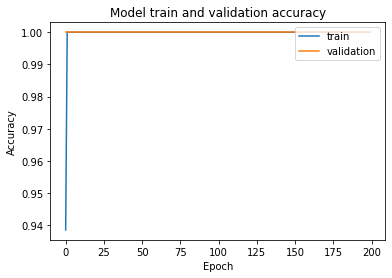

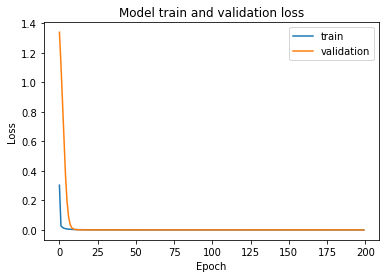


Training Accuracy Array:  [0.9385886788368225, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.

In [ ]:
fcn_learning_high_SNR_bluetooth = fcn_model_bluetooth()

epochs = 200
batch_size = 1024

history = fcn_learning_high_SNR_bluetooth.fit(X_train, Y_train, epochs=epochs, batch_size=batch_size,  validation_data = (X_validation, Y_validation), shuffle=True, callbacks=[ES])

score = fcn_learning_high_SNR_bluetooth.evaluate(X_test, Y_test, verbose=0)
print('\nEvaluating on Test data : Score of SNR = ' + str(score[1]*100) +'\n')

summarize_model(history)
fcn_learning_high_SNR_bluetooth.save("/gdrive/My Drive/Signal Identification Model FCN/fcnFFTdata_highSNR_bluetooth.tf")

print("\nTraining Accuracy Array: ", history.history['accuracy'])
print("\nValidation Accuracy Array: ", history.history['val_accuracy'])

## Low SNR

In [ ]:
x_data_fft_low_SNR_bluetooth = x_data_fft_data[0:10,0:10]
y_labels_low_SNR_bluetooth = y_labels_data[0:10,0:10]

print(x_data_fft_low_SNR_bluetooth.shape)
print(y_labels_low_SNR_bluetooth.shape)

(10, 10, 715, 128, 2)
(10, 10, 715)


In [ ]:
x_dim = x_data_fft_low_SNR_bluetooth.shape
total_num_snapshots = x_dim[0]*x_dim[1]*x_dim[2]
num_snapshots_per_tech = x_dim[1]*x_dim[2]
num_tech = x_dim[0]
num_samples = x_dim[3]
print(num_snapshots_per_tech)

7150


In [ ]:
from sklearn.preprocessing import MinMaxScaler

# Bin wise scalers for FFT data from sklearn
scaler_01 = MinMaxScaler(feature_range=(0,1))

x_data_fft_low_SNR_bluetooth_1d = np.reshape(x_data_fft_low_SNR_bluetooth, (total_num_snapshots, num_samples*x_dim[4]))
fft_data_complex = np.reshape(x_data_fft_low_SNR_bluetooth_1d.flatten()[::2] + 1j*x_data_fft_low_SNR_bluetooth_1d.flatten()[1::2], (total_num_snapshots, num_samples))
x_data_fft_low_SNR_bluetooth_1d = scaler_01.fit_transform(np.absolute(fft_data_complex))

In [ ]:
from keras.utils.np_utils import to_categorical

y_labels_low_SNR_bluetooth = y_labels_low_SNR_bluetooth.flatten()
y_labels_one_hot_low_SNR_bluetooth = to_categorical(y_labels_low_SNR_bluetooth)

In [ ]:
from keras.callbacks import EarlyStopping
ES = EarlyStopping(monitor = 'val_accuracy', mode = 'max', min_delta = 0.00001, patience = 200, verbose = 1)

import logging
logging.disable(logging.WARNING)

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test_valid, Y_train, Y_test_valid = train_test_split(x_data_fft_low_SNR_bluetooth_1d, y_labels_one_hot_low_SNR_bluetooth, test_size=0.4)
X_validation, X_test, Y_validation, Y_test = train_test_split(X_test_valid, Y_test_valid, test_size=0.5)

Epoch 1/200
42/42 [==============================] - 2s 18ms/step - loss: 1.5242 - accuracy: 0.5491 - val_loss: 1.8676 - val_accuracy: 0.8042
Epoch 2/200
42/42 [==============================] - 0s 8ms/step - loss: 0.4756 - accuracy: 0.8723 - val_loss: 1.5700 - val_accuracy: 0.8471
Epoch 3/200
42/42 [==============================] - 0s 8ms/step - loss: 0.3919 - accuracy: 0.8911 - val_loss: 1.3180 - val_accuracy: 0.8705
Epoch 4/200
42/42 [==============================] - 0s 8ms/step - loss: 0.3613 - accuracy: 0.8949 - val_loss: 1.0839 - val_accuracy: 0.8783
Epoch 5/200
42/42 [==============================] - 0s 8ms/step - loss: 0.3522 - accuracy: 0.8963 - val_loss: 0.8776 - val_accuracy: 0.8715
Epoch 6/200
42/42 [==============================] - 0s 8ms/step - loss: 0.3374 - accuracy: 0.8990 - val_loss: 0.6835 - val_accuracy: 0.8917
Epoch 7/200
42/42 [==============================] - 0s 8ms/step - loss: 0.3267 - accuracy: 0.9003 - val_loss: 0.5529 - val_accuracy: 0.8956
Epoch 8/200


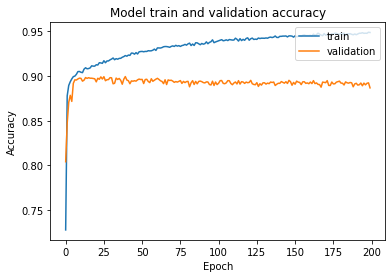

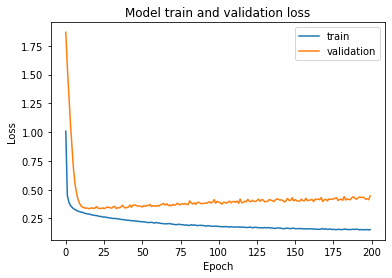


Training Accuracy Array:  [0.7280885577201843, 0.8777389526367188, 0.8893240094184875, 0.8934499025344849, 0.896643340587616, 0.8991608619689941, 0.8997436165809631, 0.9017249345779419, 0.9047785401344299, 0.9049184322357178, 0.9040326476097107, 0.9036363363265991, 0.9075058102607727, 0.9090675711631775, 0.9079254269599915, 0.9082051515579224, 0.9089044332504272, 0.9112354516983032, 0.910885751247406, 0.910885751247406, 0.9124242663383484, 0.9121445417404175, 0.9146853089332581, 0.9144755005836487, 0.9140093326568604, 0.9169231057167053, 0.9146853089332581, 0.9166666865348816, 0.9166899919509888, 0.9179254174232483, 0.918764591217041, 0.9199767112731934, 0.9180419445037842, 0.9192540645599365, 0.918601393699646, 0.9195570945739746, 0.9196270108222961, 0.9208158254623413, 0.921515166759491, 0.9227039813995361, 0.9219580292701721, 0.923240065574646, 0.9228904247283936, 0.9254778623580933, 0.9253379702568054, 0.9242424368858337, 0.9259673953056335, 0.9244521856307983, 0.9268531203269958,

In [ ]:
fcn_learning_low_SNR_bluetooth = fcn_model_bluetooth()

epochs = 200
batch_size = 1024

history = fcn_learning_low_SNR_bluetooth.fit(X_train, Y_train, epochs=epochs, batch_size=batch_size,  validation_data = (X_validation, Y_validation), shuffle=True, callbacks=[ES])

score = fcn_learning_low_SNR_bluetooth.evaluate(X_test, Y_test, verbose=0)
print('\nEvaluating on Test data : Score of SNR = ' + str(score[1]*100) +'\n')

summarize_model(history)
fcn_learning_low_SNR_bluetooth.save("/gdrive/My Drive/Signal Identification Model FCN/fcnFFTdata_lowSNR_bluetooth.tf")

print("\nTraining Accuracy Array: ", history.history['accuracy'])
print("\nValidation Accuracy Array: ", history.history['val_accuracy'])

## Channel Classification on each SNR separately and Transfer Learning

In [ ]:
x_data_fft_bluetooth = x_data_fft_data[0:10]
y_labels_bluetooth = y_labels_data[0:10]

print(x_data_fft_bluetooth.shape)
print(y_labels_bluetooth.shape)

(10, 21, 715, 128, 2)
(10, 21, 715)


In [ ]:
x_dim = x_data_fft_bluetooth.shape
total_num_snapshots = x_dim[0]*x_dim[1]*x_dim[2]
num_snapshots_per_tech = x_dim[1]*x_dim[2]
num_tech = x_dim[0]
num_samples = x_dim[3]
print(num_snapshots_per_tech)

15015


In [ ]:
from sklearn.model_selection import train_test_split
from keras.utils.np_utils import to_categorical
from keras import models
import math

X_train_curr = np.zeros((math.floor(0.6*total_num_snapshots/21), num_samples, 2))
X_validation_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_samples, 2))
X_test_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_samples, 2))
Y_train_curr = np.zeros((math.floor(0.6*total_num_snapshots/21), num_tech))
Y_validation_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_tech))
Y_test_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_tech))

X_test_valid_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_samples, 2))
Y_test_valid_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_tech))

In [ ]:
print('X_train_curr.shape = ' + str(X_train_curr.shape))
print('X_validation_curr.shape = ' + str(X_validation_curr.shape))
print('X_test_curr.shape = ' + str(X_test_curr.shape))
print('Y_train_curr.shape = ' + str(Y_train_curr.shape))
print('Y_validation_curr.shape = ' + str(Y_validation_curr.shape))
print('Y_test_curr.shape = ' + str(Y_test_curr.shape))

X_train_curr.shape = (4290, 128, 2)
X_validation_curr.shape = (1430, 128, 2)
X_test_curr.shape = (1430, 128, 2)
Y_train_curr.shape = (4290, 10)
Y_validation_curr.shape = (1430, 10)
Y_test_curr.shape = (1430, 10)


In [ ]:
from matplotlib import pyplot

def summarize_model(history, i):

  pyplot.plot(history.history['accuracy'])
  pyplot.plot(history.history['val_accuracy']) 
  pyplot.title('Model train and validation accuracy - Bluetooth SNR ' + str(2*i-20))
  pyplot.ylabel('Accuracy')
  pyplot.xlabel('Epoch')
  pyplot.legend(['train', 'validation'], loc='upper right')
  pyplot.show()

  pyplot.plot(history.history['loss'])
  pyplot.plot(history.history['val_loss'])  
  pyplot.title('Model train and validation loss - Bluetooth SNR ' + str(2*i-20))
  pyplot.ylabel('Loss')
  pyplot.xlabel('Epoch')
  pyplot.legend(['train', 'validation'], loc='upper right')
  pyplot.show()

In [ ]:
from keras.callbacks import EarlyStopping

ES = EarlyStopping(monitor = 'val_accuracy', mode = 'max', min_delta = 0.000001, patience = 200, verbose = 1)

In [ ]:
def Testing(X_test_curr, Y_test_curr, i):
  
  all_snr_model = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_allSNR_bluetooth.tf"))

  score = all_snr_model.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('\nScore of SNR on All SNR model without Transfer Learning ' + str(2*i-20) + ' = ' + str(score[1]*100))

  high_snr_model = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_highSNR_bluetooth.tf"))

  score = high_snr_model.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('Score of SNR on High SNR model without Transfer Learning ' + str(2*i-20) + ' = ' + str(score[1]*100))

  low_snr_model = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_lowSNR_bluetooth.tf"))

  score = low_snr_model.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('Score of SNR on low SNR model without Transfer Learning ' + str(2*i-20) + ' = ' + str(score[1]*100))

In [ ]:
def train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i):
  
  print("\nTraining SNR = "+str(2*i-20)+" Data\n")

  lstm_model_cur = fcn_model_bluetooth()
  history = lstm_model_cur.fit(X_train_curr, Y_train_curr, validation_data = (X_validation_curr, Y_validation_curr), epochs=200, batch_size=1024, callbacks=[ES])

  score = lstm_model_cur.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('\nEvaluating on Test data : Score of SNR ' + str(2*i-20) + ' = ' + str(score[1]*100) +'\n')

  summarize_model(history, i)
  lstm_model_cur.save("/gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_SNR_"+str(2*i-20)+"_bluetooth.tf")

In [ ]:
def train_data_on_all_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i):
  
  print("\nTraining SNR = "+str(2*i-20)+" Data on a pre-trained All SNR model\n")

  lstm_model_cur = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_allSNR_bluetooth.tf"))
  lstm_model_cur.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
  history = lstm_model_cur.fit(X_train_curr, Y_train_curr, validation_data = (X_validation_curr, Y_validation_curr), epochs=200, batch_size=1024, callbacks=[ES])

  score = lstm_model_cur.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('\nEvaluating on Test data : Score of SNR ' + str(2*i-20) + ' = ' + str(score[1]*100) +'\n')

  summarize_model(history, i)
  lstm_model_cur.save("/gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_allSNR_to_SNR_"+str(2*i-20)+"_bluetooth.tf")

In [ ]:
def train_data_on_high_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i):
  
  print("\nTraining SNR = "+str(2*i-20)+" Data on a pre-trained High SNR model\n")

  lstm_model_cur = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_highSNR_bluetooth.tf"))
  lstm_model_cur.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
  history = lstm_model_cur.fit(X_train_curr, Y_train_curr, validation_data = (X_validation_curr, Y_validation_curr), epochs=200, batch_size=1024, callbacks=[ES])

  score = lstm_model_cur.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('\nEvaluating on Test data : Score of SNR ' + str(2*i-20) + ' = ' + str(score[1]*100) +'\n')

  summarize_model(history, i)
  lstm_model_cur.save("/gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_highSNR_to_SNR_"+str(2*i-20)+"_bluetooth.tf")

In [ ]:
def train_data_on_low_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i):
  
  print("\nTraining SNR = "+str(2*i-20)+" Data on a pre-trained Low SNR model\n")

  lstm_model_cur = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_lowSNR_bluetooth.tf"))  
  lstm_model_cur.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
  history = lstm_model_cur.fit(X_train_curr, Y_train_curr, validation_data = (X_validation_curr, Y_validation_curr), epochs=200, batch_size=1024, callbacks=[ES])

  score = lstm_model_cur.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('\nEvaluating on Test data : Score of SNR ' + str(2*i-20) + ' = ' + str(score[1]*100) +'\n')

  summarize_model(history, i)
  lstm_model_cur.save("/gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_lowSNR_to_SNR_"+str(2*i-20)+"_bluetooth.tf")
  


Score of SNR on All SNR model without Transfer Learning -20 = 51.04895234107971
Score of SNR on High SNR model without Transfer Learning -20 = 38.81118893623352
Score of SNR on low SNR model without Transfer Learning -20 = 49.79020953178406

Training SNR = -20 Data

Epoch 1/200
5/5 [==============================] - 3s 95ms/step - loss: 2.6319 - accuracy: 0.0994 - val_loss: 2.2894 - val_accuracy: 0.1406
Epoch 2/200
5/5 [==============================] - 0s 9ms/step - loss: 2.3367 - accuracy: 0.1721 - val_loss: 2.2651 - val_accuracy: 0.1811
Epoch 3/200
5/5 [==============================] - 0s 11ms/step - loss: 2.1466 - accuracy: 0.2350 - val_loss: 2.2437 - val_accuracy: 0.2098
Epoch 4/200
5/5 [==============================] - 0s 11ms/step - loss: 1.9881 - accuracy: 0.3059 - val_loss: 2.2238 - val_accuracy: 0.2287
Epoch 5/200
5/5 [==============================] - 0s 11ms/step - loss: 1.8851 - accuracy: 0.3467 - val_loss: 2.2050 - val_accuracy: 0.2545
Epoch 6/200
5/5 [================

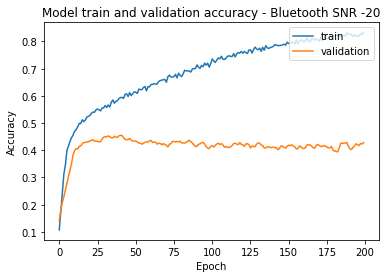

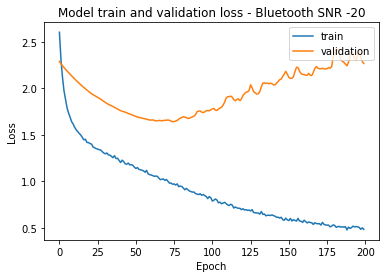

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_SNR_-20_bluetooth.tf/assets

Training SNR = -20 Data on a pre-trained All SNR model

Epoch 1/200
5/5 [==============================] - 2s 99ms/step - loss: 4.1346 - accuracy: 0.4916 - val_loss: 2.9747 - val_accuracy: 0.5175
Epoch 2/200
5/5 [==============================] - 0s 9ms/step - loss: 3.9130 - accuracy: 0.4843 - val_loss: 2.8147 - val_accuracy: 0.5189
Epoch 3/200
5/5 [==============================] - 0s 10ms/step - loss: 3.6518 - accuracy: 0.5109 - val_loss: 2.6341 - val_accuracy: 0.5315
Epoch 4/200
5/5 [==============================] - 0s 10ms/step - loss: 3.4114 - accuracy: 0.5194 - val_loss: 2.4610 - val_accuracy: 0.5315
Epoch 5/200
5/5 [==============================] - 0s 10ms/step - loss: 3.2752 - accuracy: 0.5227 - val_loss: 2.2828 - val_accuracy: 0.5315
Epoch 6/200
5/5 [==============================] - 0s 10ms/step - loss: 3.2038 - accuracy: 0.5146 - val_loss: 2

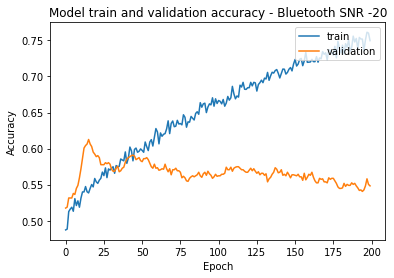

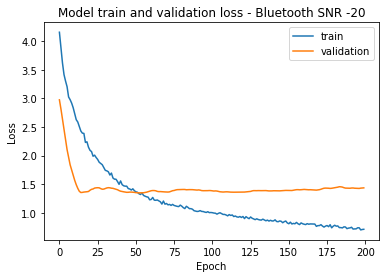

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_allSNR_to_SNR_-20_bluetooth.tf/assets

Training SNR = -20 Data on a pre-trained High SNR model

Epoch 1/200
5/5 [==============================] - 1s 91ms/step - loss: 3.4594 - accuracy: 0.4278 - val_loss: 3.8045 - val_accuracy: 0.3944
Epoch 2/200
5/5 [==============================] - 0s 11ms/step - loss: 3.1070 - accuracy: 0.4472 - val_loss: 3.6746 - val_accuracy: 0.4014
Epoch 3/200
5/5 [==============================] - 0s 10ms/step - loss: 2.8682 - accuracy: 0.4465 - val_loss: 3.5615 - val_accuracy: 0.4028
Epoch 4/200
5/5 [==============================] - 0s 10ms/step - loss: 2.6040 - accuracy: 0.4765 - val_loss: 3.4145 - val_accuracy: 0.3951
Epoch 5/200
5/5 [==============================] - 0s 9ms/step - loss: 2.4761 - accuracy: 0.4765 - val_loss: 3.2238 - val_accuracy: 0.3909
Epoch 6/200
5/5 [==============================] - 0s 10ms/step - loss: 2.3362 - accuracy: 0.4860 - 

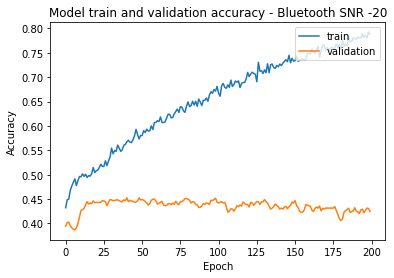

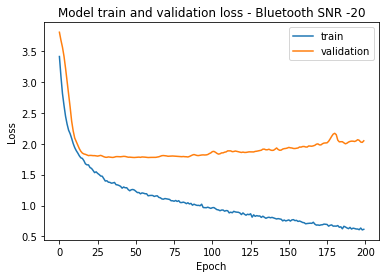

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_highSNR_to_SNR_-20_bluetooth.tf/assets

Training SNR = -20 Data on a pre-trained Low SNR model

Epoch 1/200
5/5 [==============================] - 2s 90ms/step - loss: 3.1952 - accuracy: 0.5010 - val_loss: 2.8409 - val_accuracy: 0.5308
Epoch 2/200
5/5 [==============================] - 0s 11ms/step - loss: 2.8829 - accuracy: 0.5124 - val_loss: 2.6927 - val_accuracy: 0.5273
Epoch 3/200
5/5 [==============================] - 0s 11ms/step - loss: 2.7220 - accuracy: 0.5316 - val_loss: 2.4710 - val_accuracy: 0.5343
Epoch 4/200
5/5 [==============================] - 0s 10ms/step - loss: 2.5494 - accuracy: 0.5346 - val_loss: 2.2767 - val_accuracy: 0.5385
Epoch 5/200
5/5 [==============================] - 0s 10ms/step - loss: 2.4029 - accuracy: 0.5555 - val_loss: 2.0898 - val_accuracy: 0.5483
Epoch 6/200
5/5 [==============================] - 0s 10ms/step - loss: 2.2978 - accuracy: 0.5624 -

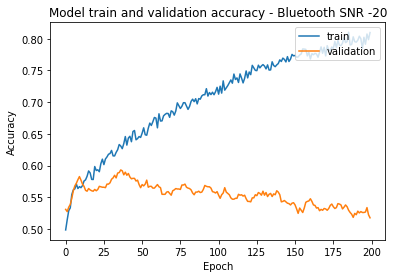

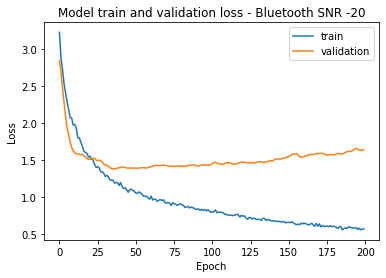

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_lowSNR_to_SNR_-20_bluetooth.tf/assets

Score of SNR on All SNR model without Transfer Learning -18 = 63.006991147994995
Score of SNR on High SNR model without Transfer Learning -18 = 54.615384340286255
Score of SNR on low SNR model without Transfer Learning -18 = 63.35664391517639

Training SNR = -18 Data

Epoch 1/200
5/5 [==============================] - 1s 96ms/step - loss: 2.5733 - accuracy: 0.1199 - val_loss: 2.2647 - val_accuracy: 0.1483
Epoch 2/200
5/5 [==============================] - 0s 10ms/step - loss: 2.1486 - accuracy: 0.2380 - val_loss: 2.2146 - val_accuracy: 0.3203
Epoch 3/200
5/5 [==============================] - 0s 11ms/step - loss: 1.8689 - accuracy: 0.3416 - val_loss: 2.1736 - val_accuracy: 0.3622
Epoch 4/200
5/5 [==============================] - 0s 10ms/step - loss: 1.6482 - accuracy: 0.4444 - val_loss: 2.1380 - val_accuracy: 0.4063
Epoch 5/200
5/5 [==========

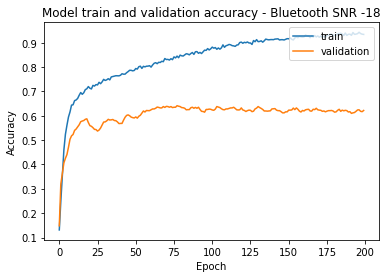

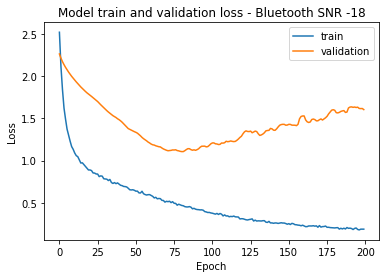

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_SNR_-18_bluetooth.tf/assets

Training SNR = -18 Data on a pre-trained All SNR model

Epoch 1/200
5/5 [==============================] - 2s 99ms/step - loss: 2.3322 - accuracy: 0.6454 - val_loss: 2.0902 - val_accuracy: 0.6364
Epoch 2/200
5/5 [==============================] - 0s 11ms/step - loss: 2.0565 - accuracy: 0.6640 - val_loss: 1.9909 - val_accuracy: 0.6448
Epoch 3/200
5/5 [==============================] - 0s 11ms/step - loss: 1.9189 - accuracy: 0.6718 - val_loss: 1.9238 - val_accuracy: 0.6441
Epoch 4/200
5/5 [==============================] - 0s 11ms/step - loss: 1.8142 - accuracy: 0.6860 - val_loss: 1.8273 - val_accuracy: 0.6462
Epoch 5/200
5/5 [==============================] - 0s 11ms/step - loss: 1.8000 - accuracy: 0.6885 - val_loss: 1.7212 - val_accuracy: 0.6490
Epoch 6/200
5/5 [==============================] - 0s 10ms/step - loss: 1.6352 - accuracy: 0.7045 - val_loss: 

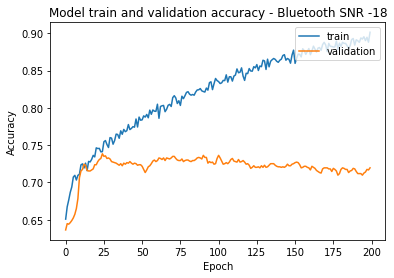

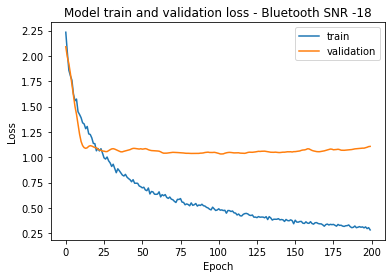

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_allSNR_to_SNR_-18_bluetooth.tf/assets

Training SNR = -18 Data on a pre-trained High SNR model

Epoch 1/200
5/5 [==============================] - 2s 97ms/step - loss: 2.0077 - accuracy: 0.5976 - val_loss: 2.4864 - val_accuracy: 0.5399
Epoch 2/200
5/5 [==============================] - 0s 11ms/step - loss: 1.7786 - accuracy: 0.6202 - val_loss: 2.4003 - val_accuracy: 0.5462
Epoch 3/200
5/5 [==============================] - 0s 12ms/step - loss: 1.5439 - accuracy: 0.6527 - val_loss: 2.2411 - val_accuracy: 0.5517
Epoch 4/200
5/5 [==============================] - 0s 10ms/step - loss: 1.4227 - accuracy: 0.6623 - val_loss: 2.1051 - val_accuracy: 0.5566
Epoch 5/200
5/5 [==============================] - 0s 11ms/step - loss: 1.3938 - accuracy: 0.6655 - val_loss: 1.9628 - val_accuracy: 0.5573
Epoch 6/200
5/5 [==============================] - 0s 10ms/step - loss: 1.2732 - accuracy: 0.6725 -

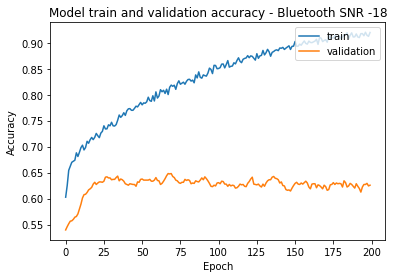

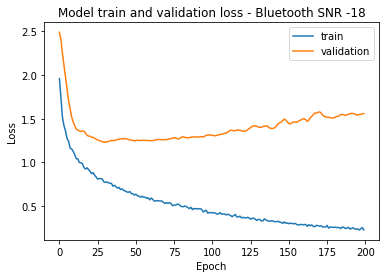

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_highSNR_to_SNR_-18_bluetooth.tf/assets

Training SNR = -18 Data on a pre-trained Low SNR model

Epoch 1/200
5/5 [==============================] - 2s 98ms/step - loss: 1.7804 - accuracy: 0.6715 - val_loss: 2.0608 - val_accuracy: 0.6399
Epoch 2/200
5/5 [==============================] - 0s 11ms/step - loss: 1.5248 - accuracy: 0.7018 - val_loss: 1.9864 - val_accuracy: 0.6392
Epoch 3/200
5/5 [==============================] - 0s 11ms/step - loss: 1.3595 - accuracy: 0.7144 - val_loss: 1.8932 - val_accuracy: 0.6434
Epoch 4/200
5/5 [==============================] - 0s 11ms/step - loss: 1.2558 - accuracy: 0.7168 - val_loss: 1.7704 - val_accuracy: 0.6462
Epoch 5/200
5/5 [==============================] - 0s 11ms/step - loss: 1.2292 - accuracy: 0.7289 - val_loss: 1.6790 - val_accuracy: 0.6524
Epoch 6/200
5/5 [==============================] - 0s 11ms/step - loss: 1.2064 - accuracy: 0.7270 -

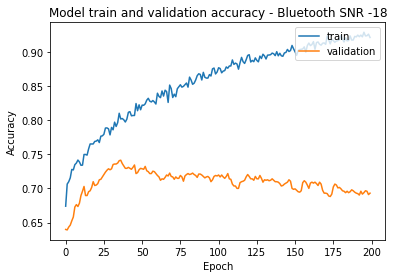

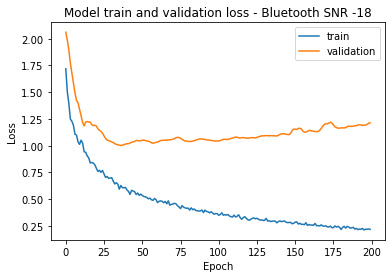

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_lowSNR_to_SNR_-18_bluetooth.tf/assets

Score of SNR on All SNR model without Transfer Learning -16 = 72.37762212753296
Score of SNR on High SNR model without Transfer Learning -16 = 67.83216595649719
Score of SNR on low SNR model without Transfer Learning -16 = 72.9370653629303

Training SNR = -16 Data

Epoch 1/200
5/5 [==============================] - 2s 98ms/step - loss: 2.5560 - accuracy: 0.1409 - val_loss: 2.2396 - val_accuracy: 0.2650
Epoch 2/200
5/5 [==============================] - 0s 13ms/step - loss: 1.9177 - accuracy: 0.3324 - val_loss: 2.1860 - val_accuracy: 0.3811
Epoch 3/200
5/5 [==============================] - 0s 11ms/step - loss: 1.5146 - accuracy: 0.5112 - val_loss: 2.1363 - val_accuracy: 0.4434
Epoch 4/200
5/5 [==============================] - 0s 11ms/step - loss: 1.2407 - accuracy: 0.6346 - val_loss: 2.0884 - val_accuracy: 0.4874
Epoch 5/200
5/5 [=============

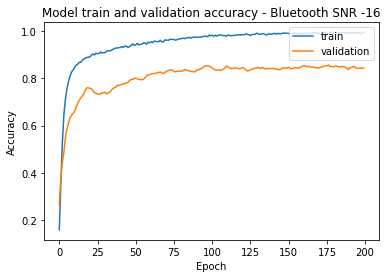

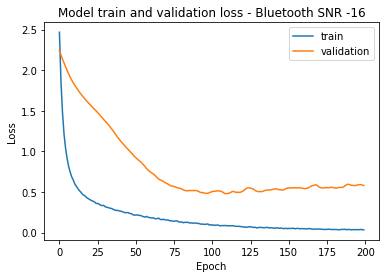

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_SNR_-16_bluetooth.tf/assets

Training SNR = -16 Data on a pre-trained All SNR model

Epoch 1/200
5/5 [==============================] - 2s 95ms/step - loss: 0.8263 - accuracy: 0.8380 - val_loss: 1.4370 - val_accuracy: 0.7524
Epoch 2/200
5/5 [==============================] - 0s 11ms/step - loss: 0.7721 - accuracy: 0.8438 - val_loss: 1.4751 - val_accuracy: 0.7545
Epoch 3/200
5/5 [==============================] - 0s 11ms/step - loss: 0.6935 - accuracy: 0.8503 - val_loss: 1.4587 - val_accuracy: 0.7573
Epoch 4/200
5/5 [==============================] - 0s 13ms/step - loss: 0.6684 - accuracy: 0.8493 - val_loss: 1.4160 - val_accuracy: 0.7559
Epoch 5/200
5/5 [==============================] - 0s 12ms/step - loss: 0.6010 - accuracy: 0.8680 - val_loss: 1.3465 - val_accuracy: 0.7601
Epoch 6/200
5/5 [==============================] - 0s 11ms/step - loss: 0.6066 - accuracy: 0.8589 - val_loss: 

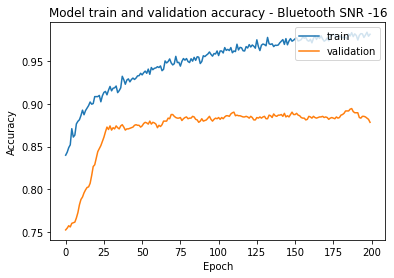

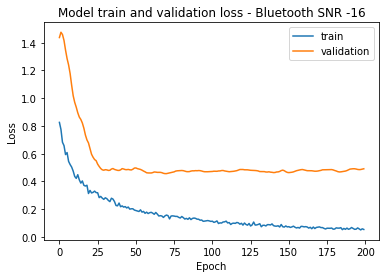

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_allSNR_to_SNR_-16_bluetooth.tf/assets

Training SNR = -16 Data on a pre-trained High SNR model

Epoch 1/200
5/5 [==============================] - 2s 100ms/step - loss: 0.7853 - accuracy: 0.7991 - val_loss: 1.5338 - val_accuracy: 0.7105
Epoch 2/200
5/5 [==============================] - 0s 11ms/step - loss: 0.6406 - accuracy: 0.8327 - val_loss: 1.5628 - val_accuracy: 0.7140
Epoch 3/200
5/5 [==============================] - 0s 12ms/step - loss: 0.5241 - accuracy: 0.8540 - val_loss: 1.5630 - val_accuracy: 0.7119
Epoch 4/200
5/5 [==============================] - 0s 12ms/step - loss: 0.4942 - accuracy: 0.8602 - val_loss: 1.4974 - val_accuracy: 0.7056
Epoch 5/200
5/5 [==============================] - 0s 13ms/step - loss: 0.4608 - accuracy: 0.8655 - val_loss: 1.3994 - val_accuracy: 0.7000
Epoch 6/200
5/5 [==============================] - 0s 11ms/step - loss: 0.4323 - accuracy: 0.8660 

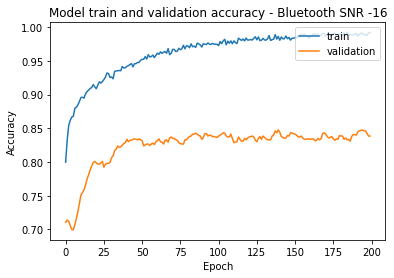

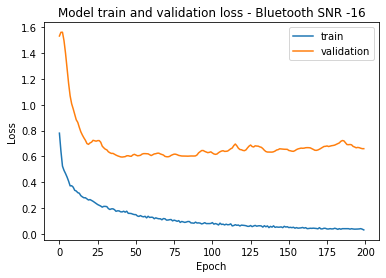

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_highSNR_to_SNR_-16_bluetooth.tf/assets

Training SNR = -16 Data on a pre-trained Low SNR model

Epoch 1/200
5/5 [==============================] - 1s 92ms/step - loss: 0.6140 - accuracy: 0.8516 - val_loss: 1.3924 - val_accuracy: 0.7678
Epoch 2/200
5/5 [==============================] - 0s 11ms/step - loss: 0.5006 - accuracy: 0.8650 - val_loss: 1.3952 - val_accuracy: 0.7643
Epoch 3/200
5/5 [==============================] - 0s 14ms/step - loss: 0.4488 - accuracy: 0.8735 - val_loss: 1.3660 - val_accuracy: 0.7657
Epoch 4/200
5/5 [==============================] - 0s 14ms/step - loss: 0.4232 - accuracy: 0.8821 - val_loss: 1.2921 - val_accuracy: 0.7720
Epoch 5/200
5/5 [==============================] - 0s 12ms/step - loss: 0.3548 - accuracy: 0.9007 - val_loss: 1.2101 - val_accuracy: 0.7678
Epoch 6/200
5/5 [==============================] - 0s 12ms/step - loss: 0.3817 - accuracy: 0.8925 -

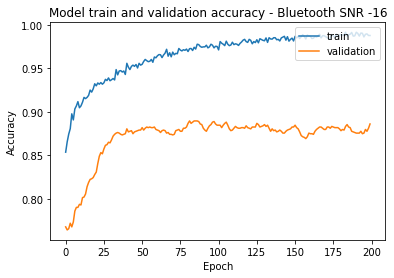

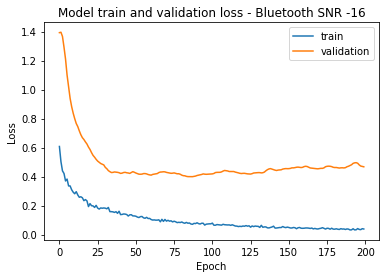

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_lowSNR_to_SNR_-16_bluetooth.tf/assets

Score of SNR on All SNR model without Transfer Learning -14 = 80.90909123420715
Score of SNR on High SNR model without Transfer Learning -14 = 79.23076748847961
Score of SNR on low SNR model without Transfer Learning -14 = 83.07692408561707

Training SNR = -14 Data

Epoch 1/200
5/5 [==============================] - 2s 92ms/step - loss: 2.4192 - accuracy: 0.1563 - val_loss: 2.2305 - val_accuracy: 0.3280
Epoch 2/200
5/5 [==============================] - 0s 15ms/step - loss: 1.6201 - accuracy: 0.4698 - val_loss: 2.1651 - val_accuracy: 0.5056
Epoch 3/200
5/5 [==============================] - 0s 12ms/step - loss: 1.1292 - accuracy: 0.7131 - val_loss: 2.1009 - val_accuracy: 0.6021
Epoch 4/200
5/5 [==============================] - 0s 13ms/step - loss: 0.8238 - accuracy: 0.8295 - val_loss: 2.0401 - val_accuracy: 0.6538
Epoch 5/200
5/5 [============

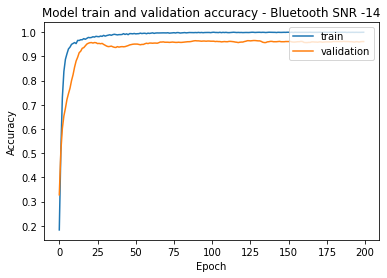

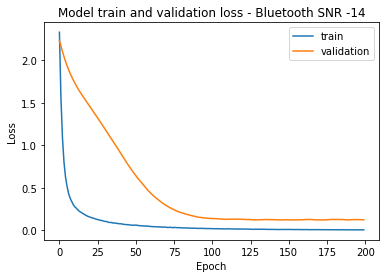

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_SNR_-14_bluetooth.tf/assets

Training SNR = -14 Data on a pre-trained All SNR model

Epoch 1/200
5/5 [==============================] - 2s 94ms/step - loss: 0.2658 - accuracy: 0.9363 - val_loss: 1.0967 - val_accuracy: 0.7986
Epoch 2/200
5/5 [==============================] - 0s 11ms/step - loss: 0.1897 - accuracy: 0.9529 - val_loss: 1.1203 - val_accuracy: 0.8007
Epoch 3/200
5/5 [==============================] - 0s 12ms/step - loss: 0.1460 - accuracy: 0.9579 - val_loss: 1.1255 - val_accuracy: 0.8007
Epoch 4/200
5/5 [==============================] - 0s 12ms/step - loss: 0.1350 - accuracy: 0.9608 - val_loss: 1.0737 - val_accuracy: 0.8056
Epoch 5/200
5/5 [==============================] - 0s 13ms/step - loss: 0.1267 - accuracy: 0.9634 - val_loss: 1.0243 - val_accuracy: 0.8091
Epoch 6/200
5/5 [==============================] - 0s 11ms/step - loss: 0.1068 - accuracy: 0.9685 - val_loss: 

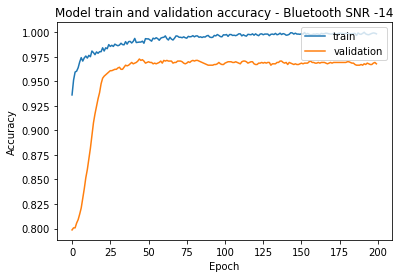

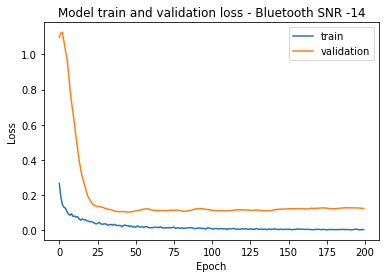

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_allSNR_to_SNR_-14_bluetooth.tf/assets

Training SNR = -14 Data on a pre-trained High SNR model

Epoch 1/200
5/5 [==============================] - 2s 99ms/step - loss: 0.2302 - accuracy: 0.9315 - val_loss: 1.0263 - val_accuracy: 0.7818
Epoch 2/200
5/5 [==============================] - 0s 11ms/step - loss: 0.1639 - accuracy: 0.9502 - val_loss: 1.0808 - val_accuracy: 0.7790
Epoch 3/200
5/5 [==============================] - 0s 11ms/step - loss: 0.1193 - accuracy: 0.9607 - val_loss: 1.0477 - val_accuracy: 0.7776
Epoch 4/200
5/5 [==============================] - 0s 12ms/step - loss: 0.1138 - accuracy: 0.9593 - val_loss: 0.9930 - val_accuracy: 0.7832
Epoch 5/200
5/5 [==============================] - 0s 12ms/step - loss: 0.0948 - accuracy: 0.9694 - val_loss: 0.9023 - val_accuracy: 0.7909
Epoch 6/200
5/5 [==============================] - 0s 12ms/step - loss: 0.0657 - accuracy: 0.9785 -

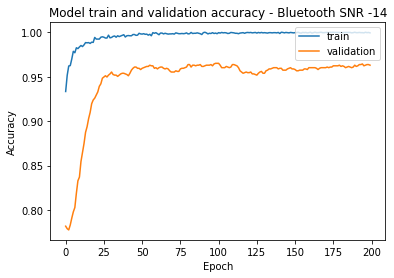

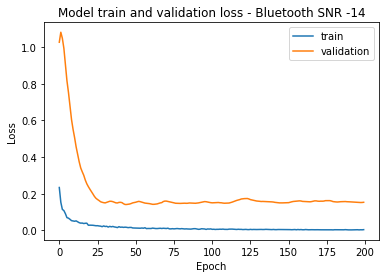

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_highSNR_to_SNR_-14_bluetooth.tf/assets

Training SNR = -14 Data on a pre-trained Low SNR model

Epoch 1/200
5/5 [==============================] - 2s 95ms/step - loss: 0.1597 - accuracy: 0.9537 - val_loss: 0.9775 - val_accuracy: 0.8280
Epoch 2/200
5/5 [==============================] - 0s 12ms/step - loss: 0.1216 - accuracy: 0.9600 - val_loss: 1.0213 - val_accuracy: 0.8245
Epoch 3/200
5/5 [==============================] - 0s 14ms/step - loss: 0.1008 - accuracy: 0.9663 - val_loss: 0.9907 - val_accuracy: 0.8252
Epoch 4/200
5/5 [==============================] - 0s 11ms/step - loss: 0.0877 - accuracy: 0.9719 - val_loss: 0.8995 - val_accuracy: 0.8378
Epoch 5/200
5/5 [==============================] - 0s 12ms/step - loss: 0.0776 - accuracy: 0.9733 - val_loss: 0.8014 - val_accuracy: 0.8476
Epoch 6/200
5/5 [==============================] - 0s 13ms/step - loss: 0.0684 - accuracy: 0.9752 -

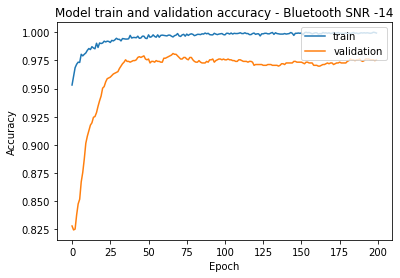

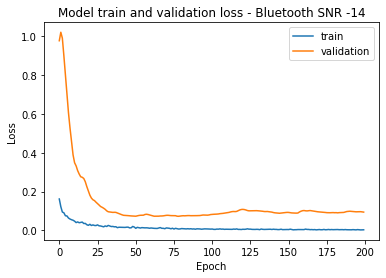

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_lowSNR_to_SNR_-14_bluetooth.tf/assets

Score of SNR on All SNR model without Transfer Learning -12 = 88.32167983055115
Score of SNR on High SNR model without Transfer Learning -12 = 84.33566689491272
Score of SNR on low SNR model without Transfer Learning -12 = 89.3006980419159

Training SNR = -12 Data

Epoch 1/200
5/5 [==============================] - 1s 95ms/step - loss: 2.4005 - accuracy: 0.1835 - val_loss: 2.2126 - val_accuracy: 0.3601
Epoch 2/200
5/5 [==============================] - 0s 11ms/step - loss: 1.3667 - accuracy: 0.5806 - val_loss: 2.1267 - val_accuracy: 0.6336
Epoch 3/200
5/5 [==============================] - 0s 11ms/step - loss: 0.8307 - accuracy: 0.8360 - val_loss: 2.0509 - val_accuracy: 0.7371
Epoch 4/200
5/5 [==============================] - 0s 11ms/step - loss: 0.5645 - accuracy: 0.9275 - val_loss: 1.9861 - val_accuracy: 0.7629
Epoch 5/200
5/5 [=============

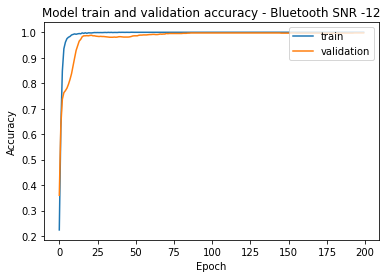

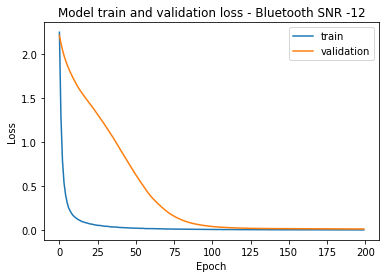

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_SNR_-12_bluetooth.tf/assets

Training SNR = -12 Data on a pre-trained All SNR model

Epoch 1/200
5/5 [==============================] - 2s 99ms/step - loss: 0.0535 - accuracy: 0.9839 - val_loss: 0.5821 - val_accuracy: 0.8699
Epoch 2/200
5/5 [==============================] - 0s 13ms/step - loss: 0.0329 - accuracy: 0.9902 - val_loss: 0.6124 - val_accuracy: 0.8692
Epoch 3/200
5/5 [==============================] - 0s 11ms/step - loss: 0.0269 - accuracy: 0.9911 - val_loss: 0.5905 - val_accuracy: 0.8741
Epoch 4/200
5/5 [==============================] - 0s 11ms/step - loss: 0.0186 - accuracy: 0.9932 - val_loss: 0.5200 - val_accuracy: 0.8832
Epoch 5/200
5/5 [==============================] - 0s 16ms/step - loss: 0.0110 - accuracy: 0.9970 - val_loss: 0.4476 - val_accuracy: 0.8937
Epoch 6/200
5/5 [==============================] - 0s 13ms/step - loss: 0.0144 - accuracy: 0.9947 - val_loss: 

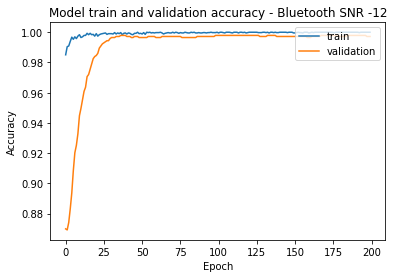

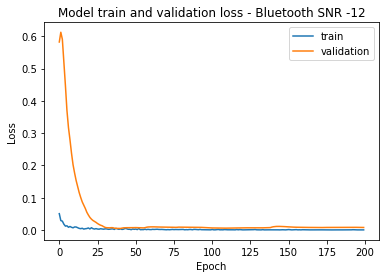

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_allSNR_to_SNR_-12_bluetooth.tf/assets

Training SNR = -12 Data on a pre-trained High SNR model

Epoch 1/200
5/5 [==============================] - 2s 96ms/step - loss: 0.0309 - accuracy: 0.9909 - val_loss: 0.5886 - val_accuracy: 0.8420
Epoch 2/200
5/5 [==============================] - 0s 12ms/step - loss: 0.0115 - accuracy: 0.9971 - val_loss: 0.6419 - val_accuracy: 0.8420
Epoch 3/200
5/5 [==============================] - 0s 13ms/step - loss: 0.0123 - accuracy: 0.9966 - val_loss: 0.6167 - val_accuracy: 0.8476
Epoch 4/200
5/5 [==============================] - 0s 13ms/step - loss: 0.0098 - accuracy: 0.9970 - val_loss: 0.5344 - val_accuracy: 0.8608
Epoch 5/200
5/5 [==============================] - 0s 12ms/step - loss: 0.0054 - accuracy: 0.9991 - val_loss: 0.4586 - val_accuracy: 0.8783
Epoch 6/200
5/5 [==============================] - 0s 12ms/step - loss: 0.0043 - accuracy: 0.9991 -

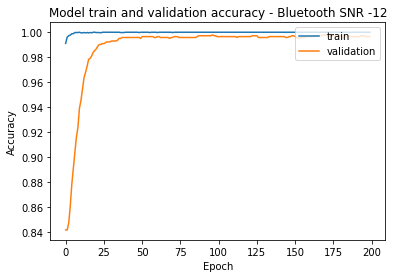

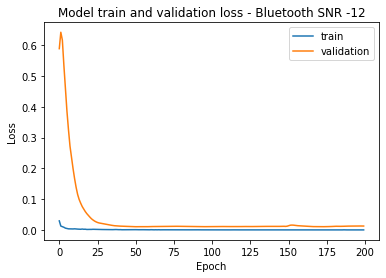

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_highSNR_to_SNR_-12_bluetooth.tf/assets

Training SNR = -12 Data on a pre-trained Low SNR model

Epoch 1/200
5/5 [==============================] - 2s 95ms/step - loss: 0.0369 - accuracy: 0.9875 - val_loss: 0.6957 - val_accuracy: 0.8678
Epoch 2/200
5/5 [==============================] - 0s 16ms/step - loss: 0.0138 - accuracy: 0.9957 - val_loss: 0.8002 - val_accuracy: 0.8629
Epoch 3/200
5/5 [==============================] - 0s 12ms/step - loss: 0.0180 - accuracy: 0.9924 - val_loss: 0.8134 - val_accuracy: 0.8608
Epoch 4/200
5/5 [==============================] - 0s 13ms/step - loss: 0.0124 - accuracy: 0.9962 - val_loss: 0.7653 - val_accuracy: 0.8636
Epoch 5/200
5/5 [==============================] - 0s 11ms/step - loss: 0.0087 - accuracy: 0.9972 - val_loss: 0.6736 - val_accuracy: 0.8734
Epoch 6/200
5/5 [==============================] - 0s 13ms/step - loss: 0.0087 - accuracy: 0.9970 -

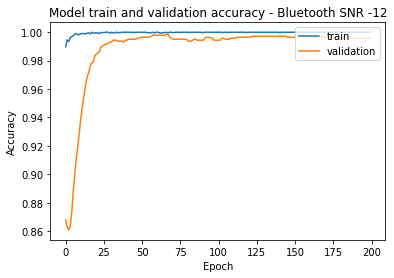

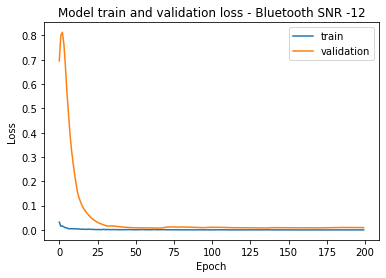

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_lowSNR_to_SNR_-12_bluetooth.tf/assets


In [ ]:
for i in range(0, 5):

  x_data_mag = np.absolute(x_data_fft_bluetooth[:,:,:,:,0] + 1j*x_data_fft_bluetooth[:,:,:,:,1]) 
  x_data_fft_curr = np.reshape(x_data_mag[:,i], (x_dim[0]*x_dim[2], x_dim[3]))

  y_data_fft_curr = to_categorical(y_labels_bluetooth[:,i].flatten())

  X_train_curr, X_test_valid_curr, Y_train_curr, Y_test_valid_curr = train_test_split(x_data_fft_curr, y_data_fft_curr, test_size=0.4)
  X_validation_curr, X_test_curr, Y_validation_curr, Y_test_curr = train_test_split(X_test_valid_curr, Y_test_valid_curr, test_size=0.5)

  Testing(X_test_curr, Y_test_curr, i)
  train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_all_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_high_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_low_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)


Score of SNR on All SNR model without Transfer Learning -10 = 94.96503472328186
Score of SNR on High SNR model without Transfer Learning -10 = 92.23776459693909
Score of SNR on low SNR model without Transfer Learning -10 = 96.15384340286255

Training SNR = -10 Data

Epoch 1/200
5/5 [==============================] - 1s 95ms/step - loss: 2.3155 - accuracy: 0.1941 - val_loss: 2.2107 - val_accuracy: 0.4028
Epoch 2/200
5/5 [==============================] - 0s 11ms/step - loss: 1.1689 - accuracy: 0.7002 - val_loss: 2.1258 - val_accuracy: 0.7462
Epoch 3/200
5/5 [==============================] - 0s 10ms/step - loss: 0.6175 - accuracy: 0.9196 - val_loss: 2.0491 - val_accuracy: 0.8084
Epoch 4/200
5/5 [==============================] - 0s 9ms/step - loss: 0.3773 - accuracy: 0.9757 - val_loss: 1.9834 - val_accuracy: 0.8371
Epoch 5/200
5/5 [==============================] - 0s 11ms/step - loss: 0.2597 - accuracy: 0.9911 - val_loss: 1.9283 - val_accuracy: 0.8706
Epoch 6/200
5/5 [================

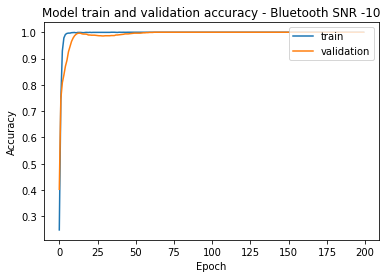

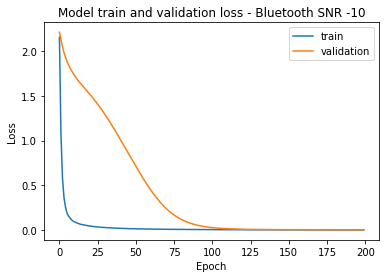

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_SNR_-10_bluetooth.tf/assets

Training SNR = -10 Data on a pre-trained All SNR model

Epoch 1/200
5/5 [==============================] - 2s 94ms/step - loss: 0.0089 - accuracy: 0.9971 - val_loss: 0.1844 - val_accuracy: 0.9420
Epoch 2/200
5/5 [==============================] - 0s 10ms/step - loss: 0.0047 - accuracy: 0.9982 - val_loss: 0.1945 - val_accuracy: 0.9406
Epoch 3/200
5/5 [==============================] - 0s 10ms/step - loss: 0.0032 - accuracy: 0.9990 - val_loss: 0.1879 - val_accuracy: 0.9427
Epoch 4/200
5/5 [==============================] - 0s 10ms/step - loss: 0.0017 - accuracy: 0.9995 - val_loss: 0.1650 - val_accuracy: 0.9524
Epoch 5/200
5/5 [==============================] - 0s 10ms/step - loss: 0.0015 - accuracy: 0.9996 - val_loss: 0.1338 - val_accuracy: 0.9580
Epoch 6/200
5/5 [==============================] - 0s 10ms/step - loss: 0.0017 - accuracy: 0.9993 - val_loss: 

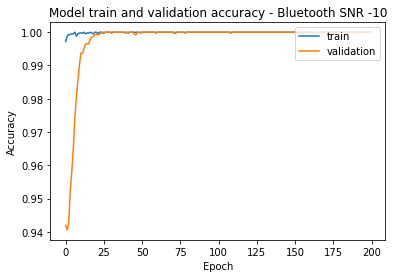

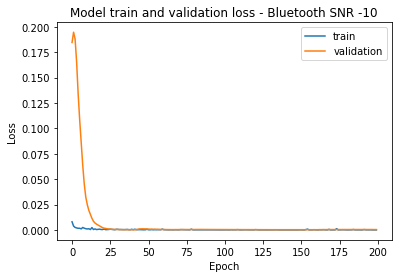

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_allSNR_to_SNR_-10_bluetooth.tf/assets

Training SNR = -10 Data on a pre-trained High SNR model

Epoch 1/200
5/5 [==============================] - 1s 92ms/step - loss: 0.0076 - accuracy: 0.9973 - val_loss: 0.3341 - val_accuracy: 0.8895
Epoch 2/200
5/5 [==============================] - 0s 10ms/step - loss: 0.0028 - accuracy: 0.9993 - val_loss: 0.3560 - val_accuracy: 0.8874
Epoch 3/200
5/5 [==============================] - 0s 10ms/step - loss: 0.0012 - accuracy: 1.0000 - val_loss: 0.3020 - val_accuracy: 0.9021
Epoch 4/200
5/5 [==============================] - 0s 10ms/step - loss: 9.7079e-04 - accuracy: 0.9999 - val_loss: 0.2174 - val_accuracy: 0.9231
Epoch 5/200
5/5 [==============================] - 0s 10ms/step - loss: 0.0012 - accuracy: 0.9997 - val_loss: 0.1382 - val_accuracy: 0.9545
Epoch 6/200
5/5 [==============================] - 0s 9ms/step - loss: 8.6468e-04 - accuracy: 1

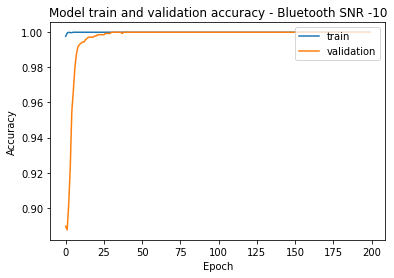

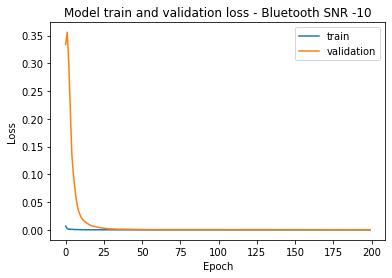

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_highSNR_to_SNR_-10_bluetooth.tf/assets

Training SNR = -10 Data on a pre-trained Low SNR model

Epoch 1/200
5/5 [==============================] - 1s 97ms/step - loss: 0.0071 - accuracy: 0.9979 - val_loss: 0.2603 - val_accuracy: 0.9350
Epoch 2/200
5/5 [==============================] - 0s 11ms/step - loss: 0.0032 - accuracy: 0.9993 - val_loss: 0.2559 - val_accuracy: 0.9406
Epoch 3/200
5/5 [==============================] - 0s 10ms/step - loss: 0.0027 - accuracy: 0.9991 - val_loss: 0.1863 - val_accuracy: 0.9503
Epoch 4/200
5/5 [==============================] - 0s 10ms/step - loss: 0.0012 - accuracy: 1.0000 - val_loss: 0.1318 - val_accuracy: 0.9636
Epoch 5/200
5/5 [==============================] - 0s 10ms/step - loss: 0.0013 - accuracy: 0.9998 - val_loss: 0.0918 - val_accuracy: 0.9720
Epoch 6/200
5/5 [==============================] - 0s 10ms/step - loss: 0.0011 - accuracy: 1.0000 -

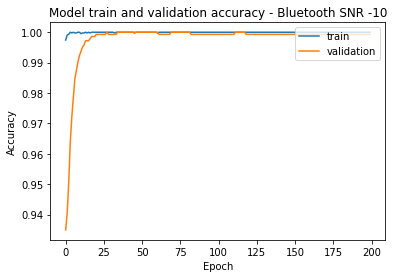

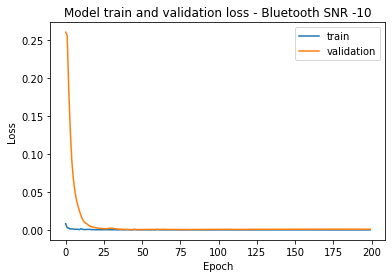

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_lowSNR_to_SNR_-10_bluetooth.tf/assets

Score of SNR on All SNR model without Transfer Learning -8 = 98.95104765892029
Score of SNR on High SNR model without Transfer Learning -8 = 98.04195761680603
Score of SNR on low SNR model without Transfer Learning -8 = 99.16083812713623

Training SNR = -8 Data

Epoch 1/200
5/5 [==============================] - 2s 95ms/step - loss: 2.4121 - accuracy: 0.1912 - val_loss: 2.2057 - val_accuracy: 0.3937
Epoch 2/200
5/5 [==============================] - 0s 10ms/step - loss: 1.0568 - accuracy: 0.7817 - val_loss: 2.1012 - val_accuracy: 0.7091
Epoch 3/200
5/5 [==============================] - 0s 11ms/step - loss: 0.4838 - accuracy: 0.9763 - val_loss: 2.0122 - val_accuracy: 0.7769
Epoch 4/200
5/5 [==============================] - 0s 11ms/step - loss: 0.2761 - accuracy: 0.9961 - val_loss: 1.9417 - val_accuracy: 0.8007
Epoch 5/200
5/5 [================

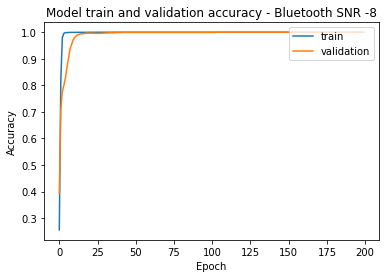

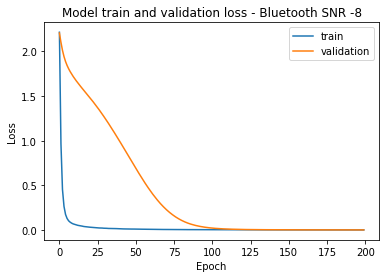

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_SNR_-8_bluetooth.tf/assets

Training SNR = -8 Data on a pre-trained All SNR model

Epoch 1/200
5/5 [==============================] - 1s 95ms/step - loss: 0.0010 - accuracy: 0.9996 - val_loss: 0.0365 - val_accuracy: 0.9888
Epoch 2/200
5/5 [==============================] - 0s 11ms/step - loss: 0.0014 - accuracy: 0.9997 - val_loss: 0.0453 - val_accuracy: 0.9846
Epoch 3/200
5/5 [==============================] - 0s 10ms/step - loss: 2.2549e-04 - accuracy: 1.0000 - val_loss: 0.0464 - val_accuracy: 0.9853
Epoch 4/200
5/5 [==============================] - 0s 11ms/step - loss: 5.9267e-04 - accuracy: 0.9996 - val_loss: 0.0381 - val_accuracy: 0.9888
Epoch 5/200
5/5 [==============================] - 0s 10ms/step - loss: 1.3127e-04 - accuracy: 1.0000 - val_loss: 0.0296 - val_accuracy: 0.9895
Epoch 6/200
5/5 [==============================] - 0s 10ms/step - loss: 5.8290e-05 - accuracy: 1.000

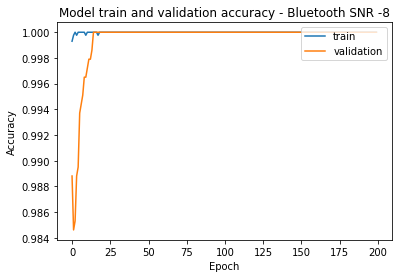

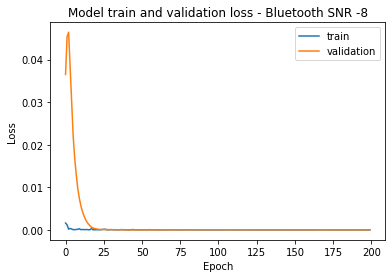

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_allSNR_to_SNR_-8_bluetooth.tf/assets

Training SNR = -8 Data on a pre-trained High SNR model

Epoch 1/200
5/5 [==============================] - 1s 94ms/step - loss: 0.0027 - accuracy: 0.9993 - val_loss: 0.1601 - val_accuracy: 0.9545
Epoch 2/200
5/5 [==============================] - 0s 10ms/step - loss: 2.7062e-04 - accuracy: 1.0000 - val_loss: 0.1712 - val_accuracy: 0.9517
Epoch 3/200
5/5 [==============================] - 0s 10ms/step - loss: 1.9448e-04 - accuracy: 1.0000 - val_loss: 0.1313 - val_accuracy: 0.9643
Epoch 4/200
5/5 [==============================] - 0s 10ms/step - loss: 1.2478e-04 - accuracy: 1.0000 - val_loss: 0.1028 - val_accuracy: 0.9706
Epoch 5/200
5/5 [==============================] - 0s 11ms/step - loss: 9.1822e-05 - accuracy: 1.0000 - val_loss: 0.0787 - val_accuracy: 0.9783
Epoch 6/200
5/5 [==============================] - 0s 10ms/step - loss: 1.0593e-04 - 

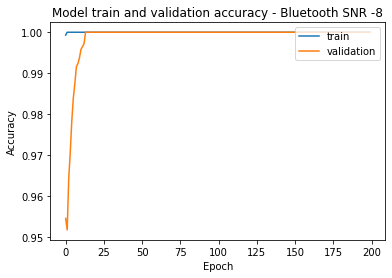

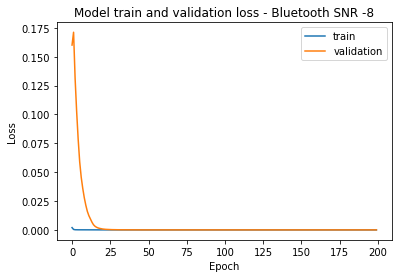

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_highSNR_to_SNR_-8_bluetooth.tf/assets

Training SNR = -8 Data on a pre-trained Low SNR model

Epoch 1/200
5/5 [==============================] - 1s 93ms/step - loss: 0.0018 - accuracy: 0.9995 - val_loss: 0.0611 - val_accuracy: 0.9811
Epoch 2/200
5/5 [==============================] - 0s 11ms/step - loss: 1.4170e-04 - accuracy: 1.0000 - val_loss: 0.0638 - val_accuracy: 0.9804
Epoch 3/200
5/5 [==============================] - 0s 11ms/step - loss: 2.6108e-04 - accuracy: 1.0000 - val_loss: 0.0570 - val_accuracy: 0.9818
Epoch 4/200
5/5 [==============================] - 0s 10ms/step - loss: 2.0328e-04 - accuracy: 1.0000 - val_loss: 0.0439 - val_accuracy: 0.9881
Epoch 5/200
5/5 [==============================] - 0s 10ms/step - loss: 8.7061e-05 - accuracy: 1.0000 - val_loss: 0.0328 - val_accuracy: 0.9909
Epoch 6/200
5/5 [==============================] - 0s 10ms/step - loss: 1.4021e-04 - 

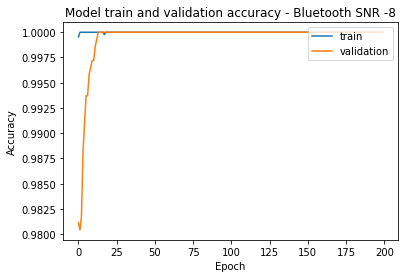

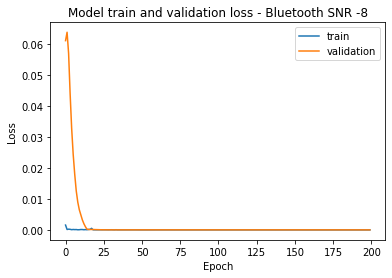

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_lowSNR_to_SNR_-8_bluetooth.tf/assets

Score of SNR on All SNR model without Transfer Learning -6 = 99.72028136253357
Score of SNR on High SNR model without Transfer Learning -6 = 99.72028136253357
Score of SNR on low SNR model without Transfer Learning -6 = 99.86013770103455

Training SNR = -6 Data

Epoch 1/200
5/5 [==============================] - 1s 94ms/step - loss: 2.1746 - accuracy: 0.2570 - val_loss: 2.1875 - val_accuracy: 0.4448
Epoch 2/200
5/5 [==============================] - 0s 15ms/step - loss: 0.8334 - accuracy: 0.8604 - val_loss: 2.0783 - val_accuracy: 0.8301
Epoch 3/200
5/5 [==============================] - 0s 13ms/step - loss: 0.3546 - accuracy: 0.9946 - val_loss: 1.9858 - val_accuracy: 0.9042
Epoch 4/200
5/5 [==============================] - 0s 11ms/step - loss: 0.2004 - accuracy: 0.9996 - val_loss: 1.9127 - val_accuracy: 0.9399
Epoch 5/200
5/5 [=================

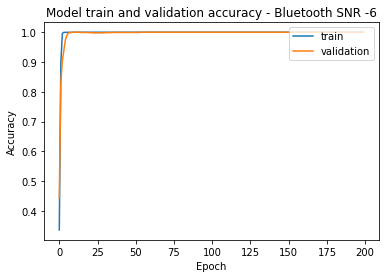

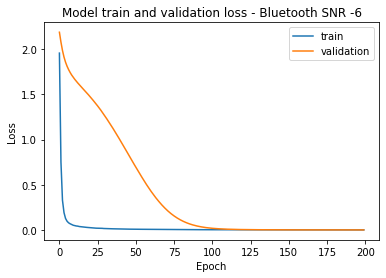

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_SNR_-6_bluetooth.tf/assets

Training SNR = -6 Data on a pre-trained All SNR model

Epoch 1/200
5/5 [==============================] - 1s 92ms/step - loss: 3.1593e-04 - accuracy: 1.0000 - val_loss: 0.0020 - val_accuracy: 0.9993
Epoch 2/200
5/5 [==============================] - 0s 10ms/step - loss: 2.0282e-05 - accuracy: 1.0000 - val_loss: 0.0020 - val_accuracy: 0.9993
Epoch 3/200
5/5 [==============================] - 0s 11ms/step - loss: 2.2802e-05 - accuracy: 1.0000 - val_loss: 0.0017 - val_accuracy: 0.9993
Epoch 4/200
5/5 [==============================] - 0s 11ms/step - loss: 9.0757e-06 - accuracy: 1.0000 - val_loss: 0.0014 - val_accuracy: 1.0000
Epoch 5/200
5/5 [==============================] - 0s 10ms/step - loss: 1.1386e-05 - accuracy: 1.0000 - val_loss: 0.0010 - val_accuracy: 1.0000
Epoch 6/200
5/5 [==============================] - 0s 10ms/step - loss: 1.7564e-05 - accurac

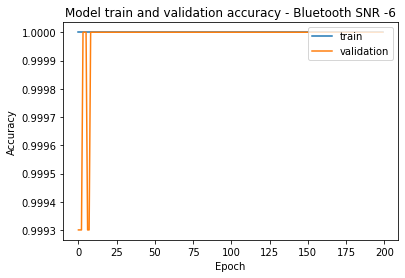

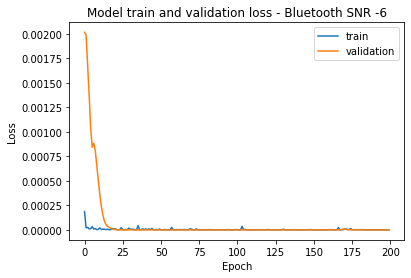

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_allSNR_to_SNR_-6_bluetooth.tf/assets

Training SNR = -6 Data on a pre-trained High SNR model

Epoch 1/200
5/5 [==============================] - 1s 90ms/step - loss: 1.4695e-04 - accuracy: 1.0000 - val_loss: 0.0225 - val_accuracy: 0.9979
Epoch 2/200
5/5 [==============================] - 0s 12ms/step - loss: 2.6746e-05 - accuracy: 1.0000 - val_loss: 0.0179 - val_accuracy: 0.9979
Epoch 3/200
5/5 [==============================] - 0s 11ms/step - loss: 2.5762e-05 - accuracy: 1.0000 - val_loss: 0.0125 - val_accuracy: 0.9979
Epoch 4/200
5/5 [==============================] - 0s 12ms/step - loss: 2.8228e-05 - accuracy: 1.0000 - val_loss: 0.0084 - val_accuracy: 0.9986
Epoch 5/200
5/5 [==============================] - 0s 11ms/step - loss: 1.6920e-05 - accuracy: 1.0000 - val_loss: 0.0057 - val_accuracy: 1.0000
Epoch 6/200
5/5 [==============================] - 0s 12ms/step - loss: 2.8524e-0

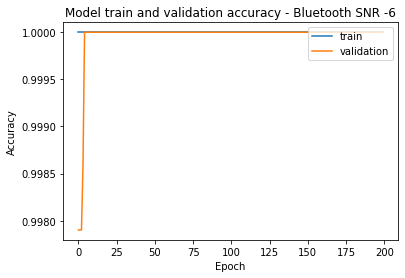

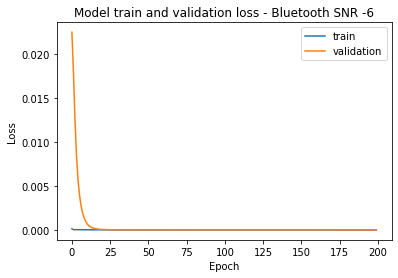

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_highSNR_to_SNR_-6_bluetooth.tf/assets

Training SNR = -6 Data on a pre-trained Low SNR model

Epoch 1/200
5/5 [==============================] - 2s 93ms/step - loss: 8.8034e-05 - accuracy: 1.0000 - val_loss: 0.0055 - val_accuracy: 0.9979
Epoch 2/200
5/5 [==============================] - 0s 11ms/step - loss: 2.3439e-05 - accuracy: 1.0000 - val_loss: 0.0068 - val_accuracy: 0.9979
Epoch 3/200
5/5 [==============================] - 0s 12ms/step - loss: 2.9576e-05 - accuracy: 1.0000 - val_loss: 0.0045 - val_accuracy: 0.9986
Epoch 4/200
5/5 [==============================] - 0s 11ms/step - loss: 2.7274e-05 - accuracy: 1.0000 - val_loss: 0.0019 - val_accuracy: 0.9993
Epoch 5/200
5/5 [==============================] - 0s 11ms/step - loss: 1.2450e-05 - accuracy: 1.0000 - val_loss: 7.5357e-04 - val_accuracy: 1.0000
Epoch 6/200
5/5 [==============================] - 0s 12ms/step - loss: 2.359

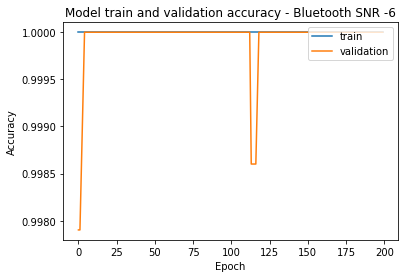

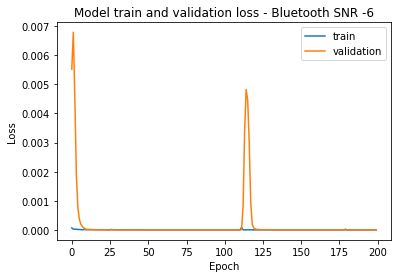

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_lowSNR_to_SNR_-6_bluetooth.tf/assets

Score of SNR on All SNR model without Transfer Learning -4 = 100.0
Score of SNR on High SNR model without Transfer Learning -4 = 100.0
Score of SNR on low SNR model without Transfer Learning -4 = 100.0

Training SNR = -4 Data

Epoch 1/200
5/5 [==============================] - 2s 101ms/step - loss: 2.3405 - accuracy: 0.2333 - val_loss: 2.1778 - val_accuracy: 0.8497
Epoch 2/200
5/5 [==============================] - 0s 12ms/step - loss: 0.8345 - accuracy: 0.8599 - val_loss: 2.0616 - val_accuracy: 0.9881
Epoch 3/200
5/5 [==============================] - 0s 14ms/step - loss: 0.3489 - accuracy: 0.9935 - val_loss: 1.9699 - val_accuracy: 0.9972
Epoch 4/200
5/5 [==============================] - 0s 12ms/step - loss: 0.1973 - accuracy: 0.9995 - val_loss: 1.8998 - val_accuracy: 0.9993
Epoch 5/200
5/5 [==============================] - 0s 11ms/step - los

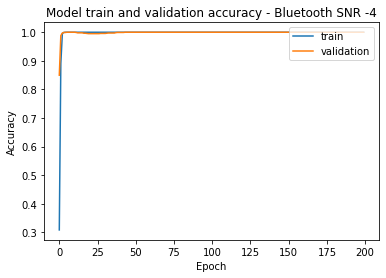

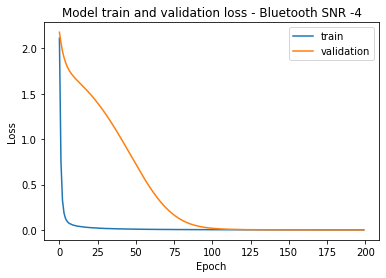

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_SNR_-4_bluetooth.tf/assets

Training SNR = -4 Data on a pre-trained All SNR model

Epoch 1/200
5/5 [==============================] - 2s 90ms/step - loss: 1.9107e-04 - accuracy: 1.0000 - val_loss: 2.6555e-04 - val_accuracy: 1.0000
Epoch 2/200
5/5 [==============================] - 0s 11ms/step - loss: 1.8258e-05 - accuracy: 1.0000 - val_loss: 2.0307e-04 - val_accuracy: 1.0000
Epoch 3/200
5/5 [==============================] - 0s 10ms/step - loss: 3.3175e-06 - accuracy: 1.0000 - val_loss: 1.3475e-04 - val_accuracy: 1.0000
Epoch 4/200
5/5 [==============================] - 0s 11ms/step - loss: 1.7391e-05 - accuracy: 1.0000 - val_loss: 9.3225e-05 - val_accuracy: 1.0000
Epoch 5/200
5/5 [==============================] - 0s 11ms/step - loss: 1.2913e-05 - accuracy: 1.0000 - val_loss: 6.4380e-05 - val_accuracy: 1.0000
Epoch 6/200
5/5 [==============================] - 0s 11ms/step - loss: 

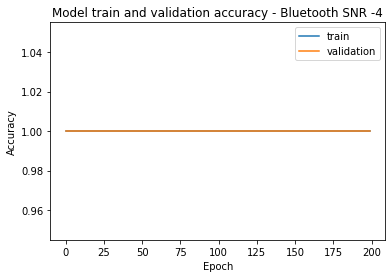

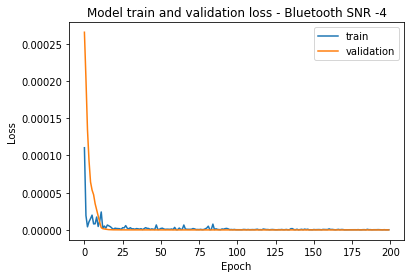

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_allSNR_to_SNR_-4_bluetooth.tf/assets

Training SNR = -4 Data on a pre-trained High SNR model

Epoch 1/200
5/5 [==============================] - 1s 90ms/step - loss: 5.1905e-05 - accuracy: 1.0000 - val_loss: 0.0075 - val_accuracy: 1.0000
Epoch 2/200
5/5 [==============================] - 0s 11ms/step - loss: 1.7771e-05 - accuracy: 1.0000 - val_loss: 0.0047 - val_accuracy: 1.0000
Epoch 3/200
5/5 [==============================] - 0s 11ms/step - loss: 1.6671e-05 - accuracy: 1.0000 - val_loss: 0.0030 - val_accuracy: 1.0000
Epoch 4/200
5/5 [==============================] - 0s 10ms/step - loss: 1.1161e-05 - accuracy: 1.0000 - val_loss: 0.0019 - val_accuracy: 1.0000
Epoch 5/200
5/5 [==============================] - 0s 12ms/step - loss: 1.2092e-05 - accuracy: 1.0000 - val_loss: 0.0012 - val_accuracy: 1.0000
Epoch 6/200
5/5 [==============================] - 0s 14ms/step - loss: 9.9400e-0

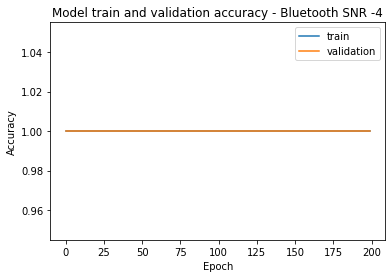

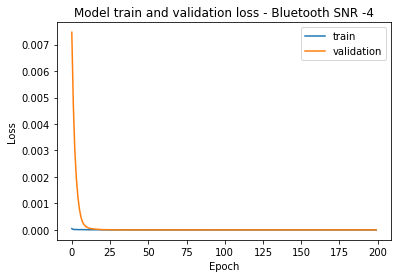

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_highSNR_to_SNR_-4_bluetooth.tf/assets

Training SNR = -4 Data on a pre-trained Low SNR model

Epoch 1/200
5/5 [==============================] - 1s 94ms/step - loss: 4.4960e-05 - accuracy: 1.0000 - val_loss: 2.0849e-04 - val_accuracy: 1.0000
Epoch 2/200
5/5 [==============================] - 0s 11ms/step - loss: 1.7638e-05 - accuracy: 1.0000 - val_loss: 2.8017e-04 - val_accuracy: 1.0000
Epoch 3/200
5/5 [==============================] - 0s 11ms/step - loss: 2.5521e-05 - accuracy: 1.0000 - val_loss: 1.7324e-04 - val_accuracy: 1.0000
Epoch 4/200
5/5 [==============================] - 0s 11ms/step - loss: 1.2231e-05 - accuracy: 1.0000 - val_loss: 1.0997e-04 - val_accuracy: 1.0000
Epoch 5/200
5/5 [==============================] - 0s 13ms/step - loss: 1.8660e-05 - accuracy: 1.0000 - val_loss: 7.1727e-05 - val_accuracy: 1.0000
Epoch 6/200
5/5 [==============================] - 0s 12ms/st

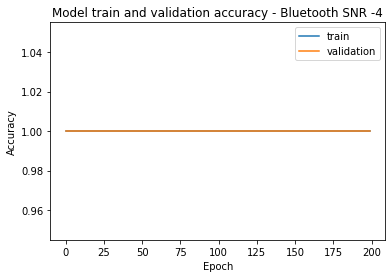

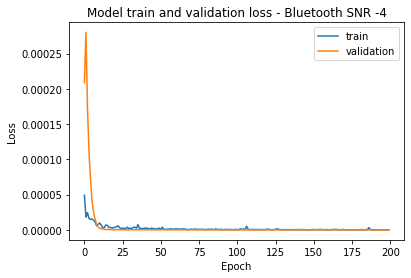

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_lowSNR_to_SNR_-4_bluetooth.tf/assets

Score of SNR on All SNR model without Transfer Learning -2 = 100.0
Score of SNR on High SNR model without Transfer Learning -2 = 100.0
Score of SNR on low SNR model without Transfer Learning -2 = 100.0

Training SNR = -2 Data

Epoch 1/200
5/5 [==============================] - 1s 94ms/step - loss: 2.0967 - accuracy: 0.2737 - val_loss: 2.1627 - val_accuracy: 0.8538
Epoch 2/200
5/5 [==============================] - 0s 12ms/step - loss: 0.7190 - accuracy: 0.9142 - val_loss: 2.0534 - val_accuracy: 0.9790
Epoch 3/200
5/5 [==============================] - 0s 12ms/step - loss: 0.3121 - accuracy: 0.9954 - val_loss: 1.9675 - val_accuracy: 0.9958
Epoch 4/200
5/5 [==============================] - 0s 13ms/step - loss: 0.1747 - accuracy: 0.9992 - val_loss: 1.9016 - val_accuracy: 0.9993
Epoch 5/200
5/5 [==============================] - 0s 15ms/step - loss

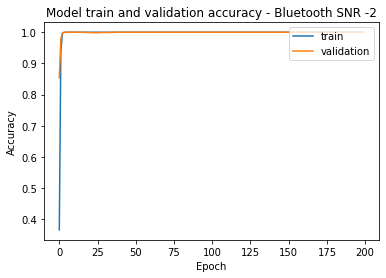

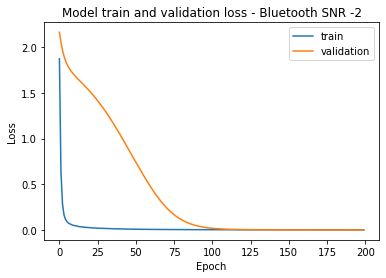

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_SNR_-2_bluetooth.tf/assets

Training SNR = -2 Data on a pre-trained All SNR model

Epoch 1/200
5/5 [==============================] - 2s 90ms/step - loss: 1.5649e-05 - accuracy: 1.0000 - val_loss: 3.3670e-05 - val_accuracy: 1.0000
Epoch 2/200
5/5 [==============================] - 0s 11ms/step - loss: 3.1196e-06 - accuracy: 1.0000 - val_loss: 2.8313e-05 - val_accuracy: 1.0000
Epoch 3/200
5/5 [==============================] - 0s 11ms/step - loss: 1.1490e-06 - accuracy: 1.0000 - val_loss: 2.1762e-05 - val_accuracy: 1.0000
Epoch 4/200
5/5 [==============================] - 0s 11ms/step - loss: 2.7285e-06 - accuracy: 1.0000 - val_loss: 1.5421e-05 - val_accuracy: 1.0000
Epoch 5/200
5/5 [==============================] - 0s 14ms/step - loss: 2.0439e-06 - accuracy: 1.0000 - val_loss: 1.0603e-05 - val_accuracy: 1.0000
Epoch 6/200
5/5 [==============================] - 0s 12ms/step - loss: 

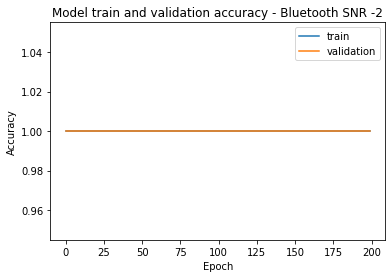

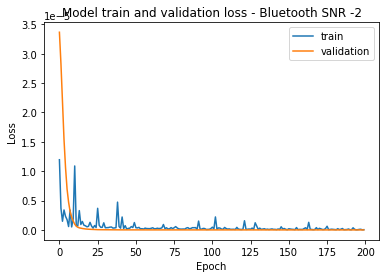

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_allSNR_to_SNR_-2_bluetooth.tf/assets

Training SNR = -2 Data on a pre-trained High SNR model

Epoch 1/200
5/5 [==============================] - 1s 94ms/step - loss: 3.1708e-05 - accuracy: 1.0000 - val_loss: 0.0033 - val_accuracy: 1.0000
Epoch 2/200
5/5 [==============================] - 0s 12ms/step - loss: 8.9220e-06 - accuracy: 1.0000 - val_loss: 0.0027 - val_accuracy: 1.0000
Epoch 3/200
5/5 [==============================] - 0s 12ms/step - loss: 7.3488e-06 - accuracy: 1.0000 - val_loss: 0.0022 - val_accuracy: 1.0000
Epoch 4/200
5/5 [==============================] - 0s 11ms/step - loss: 4.2298e-06 - accuracy: 1.0000 - val_loss: 0.0016 - val_accuracy: 1.0000
Epoch 5/200
5/5 [==============================] - 0s 11ms/step - loss: 4.2763e-06 - accuracy: 1.0000 - val_loss: 0.0011 - val_accuracy: 1.0000
Epoch 6/200
5/5 [==============================] - 0s 12ms/step - loss: 3.5251e-0

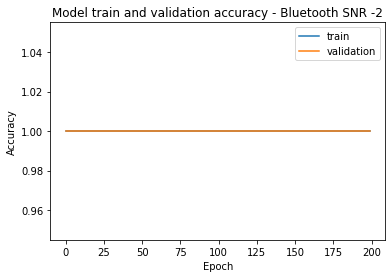

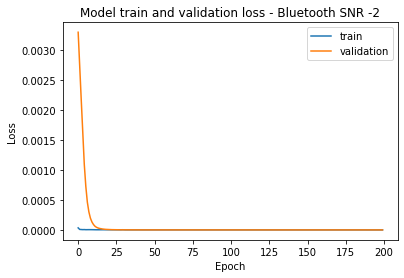

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_highSNR_to_SNR_-2_bluetooth.tf/assets

Training SNR = -2 Data on a pre-trained Low SNR model

Epoch 1/200
5/5 [==============================] - 1s 94ms/step - loss: 5.1671e-05 - accuracy: 1.0000 - val_loss: 7.5740e-05 - val_accuracy: 1.0000
Epoch 2/200
5/5 [==============================] - 0s 11ms/step - loss: 1.3087e-05 - accuracy: 1.0000 - val_loss: 9.5580e-05 - val_accuracy: 1.0000
Epoch 3/200
5/5 [==============================] - 0s 11ms/step - loss: 7.7861e-06 - accuracy: 1.0000 - val_loss: 8.2396e-05 - val_accuracy: 1.0000
Epoch 4/200
5/5 [==============================] - 0s 13ms/step - loss: 5.5740e-06 - accuracy: 1.0000 - val_loss: 6.4193e-05 - val_accuracy: 1.0000
Epoch 5/200
5/5 [==============================] - 0s 13ms/step - loss: 1.5174e-05 - accuracy: 1.0000 - val_loss: 5.4475e-05 - val_accuracy: 1.0000
Epoch 6/200
5/5 [==============================] - 0s 15ms/st

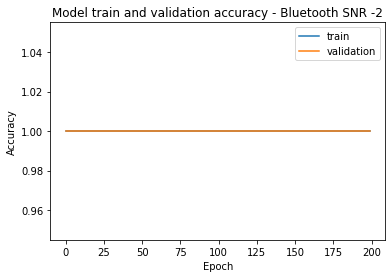

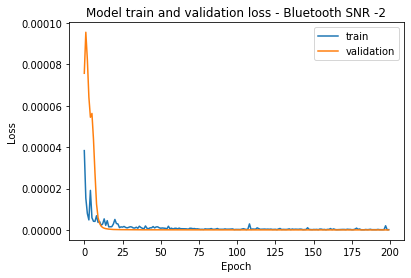

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_lowSNR_to_SNR_-2_bluetooth.tf/assets


In [ ]:
for i in range(5, 10):

  x_data_mag = np.absolute(x_data_fft_bluetooth[:,:,:,:,0] + 1j*x_data_fft_bluetooth[:,:,:,:,1]) 
  x_data_fft_curr = np.reshape(x_data_mag[:,i], (x_dim[0]*x_dim[2], x_dim[3]))
  
  y_data_fft_curr = to_categorical(y_labels_bluetooth[:,i].flatten())

  X_train_curr, X_test_valid_curr, Y_train_curr, Y_test_valid_curr = train_test_split(x_data_fft_curr, y_data_fft_curr, test_size=0.4)
  X_validation_curr, X_test_curr, Y_validation_curr, Y_test_curr = train_test_split(X_test_valid_curr, Y_test_valid_curr, test_size=0.5)

  Testing(X_test_curr, Y_test_curr, i)
  train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_all_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_high_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_low_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)


Score of SNR on All SNR model without Transfer Learning 0 = 100.0
Score of SNR on High SNR model without Transfer Learning 0 = 100.0
Score of SNR on low SNR model without Transfer Learning 0 = 100.0

Training SNR = 0 Data

Epoch 1/200
5/5 [==============================] - 1s 92ms/step - loss: 2.3339 - accuracy: 0.2271 - val_loss: 2.1737 - val_accuracy: 0.9000
Epoch 2/200
5/5 [==============================] - 0s 9ms/step - loss: 0.7315 - accuracy: 0.9303 - val_loss: 2.0460 - val_accuracy: 0.9979
Epoch 3/200
5/5 [==============================] - 0s 10ms/step - loss: 0.2830 - accuracy: 0.9989 - val_loss: 1.9480 - val_accuracy: 1.0000
Epoch 4/200
5/5 [==============================] - 0s 9ms/step - loss: 0.1532 - accuracy: 0.9996 - val_loss: 1.8757 - val_accuracy: 1.0000
Epoch 5/200
5/5 [==============================] - 0s 10ms/step - loss: 0.0997 - accuracy: 1.0000 - val_loss: 1.8219 - val_accuracy: 1.0000
Epoch 6/200
5/5 [==============================] - 0s 9ms/step - loss: 0.0734 

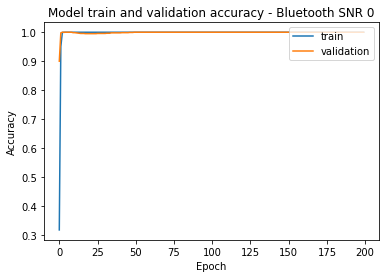

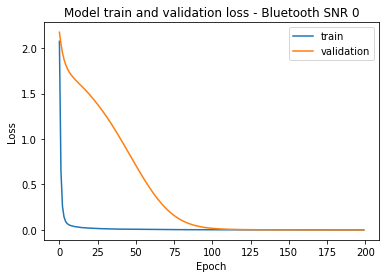

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_SNR_0_bluetooth.tf/assets

Score of SNR on All SNR model without Transfer Learning 2 = 100.0
Score of SNR on High SNR model without Transfer Learning 2 = 100.0
Score of SNR on low SNR model without Transfer Learning 2 = 100.0

Training SNR = 2 Data

Epoch 1/200
5/5 [==============================] - 1s 97ms/step - loss: 2.1005 - accuracy: 0.3076 - val_loss: 2.1566 - val_accuracy: 0.9713
Epoch 2/200
5/5 [==============================] - 0s 10ms/step - loss: 0.6632 - accuracy: 0.9394 - val_loss: 2.0459 - val_accuracy: 0.9909
Epoch 3/200
5/5 [==============================] - 0s 9ms/step - loss: 0.2730 - accuracy: 0.9958 - val_loss: 1.9594 - val_accuracy: 0.9930
Epoch 4/200
5/5 [==============================] - 0s 10ms/step - loss: 0.1598 - accuracy: 0.9992 - val_loss: 1.8926 - val_accuracy: 0.9916
Epoch 5/200
5/5 [==============================] - 0s 10ms/step - loss: 0.1126 - accur

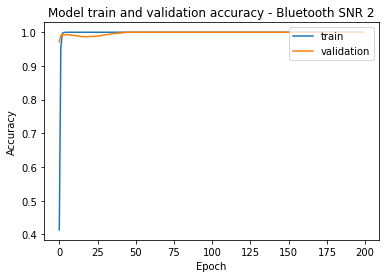

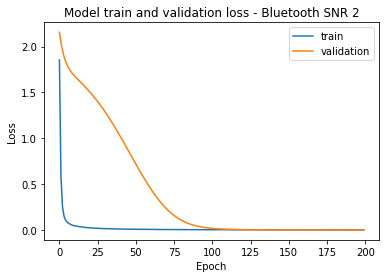

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_SNR_2_bluetooth.tf/assets

Score of SNR on All SNR model without Transfer Learning 4 = 100.0
Score of SNR on High SNR model without Transfer Learning 4 = 100.0
Score of SNR on low SNR model without Transfer Learning 4 = 100.0

Training SNR = 4 Data

Epoch 1/200
5/5 [==============================] - 1s 95ms/step - loss: 2.1628 - accuracy: 0.2648 - val_loss: 2.1557 - val_accuracy: 0.8378
Epoch 2/200
5/5 [==============================] - 0s 10ms/step - loss: 0.6794 - accuracy: 0.9224 - val_loss: 2.0302 - val_accuracy: 0.9825
Epoch 3/200
5/5 [==============================] - 0s 10ms/step - loss: 0.2753 - accuracy: 0.9988 - val_loss: 1.9322 - val_accuracy: 0.9979
Epoch 4/200
5/5 [==============================] - 0s 11ms/step - loss: 0.1525 - accuracy: 1.0000 - val_loss: 1.8580 - val_accuracy: 1.0000
Epoch 5/200
5/5 [==============================] - 0s 9ms/step - loss: 0.0998 - accur

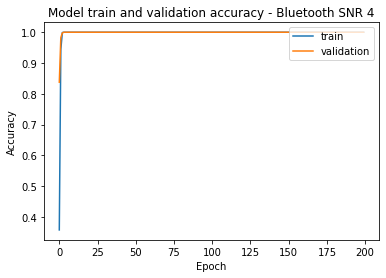

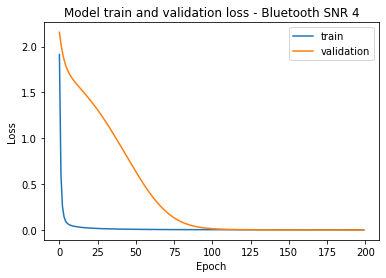

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_SNR_4_bluetooth.tf/assets

Score of SNR on All SNR model without Transfer Learning 6 = 100.0
Score of SNR on High SNR model without Transfer Learning 6 = 100.0
Score of SNR on low SNR model without Transfer Learning 6 = 100.0

Training SNR = 6 Data

Epoch 1/200
5/5 [==============================] - 2s 92ms/step - loss: 2.2522 - accuracy: 0.2532 - val_loss: 2.1557 - val_accuracy: 0.9755
Epoch 2/200
5/5 [==============================] - 0s 11ms/step - loss: 0.7391 - accuracy: 0.9104 - val_loss: 2.0383 - val_accuracy: 1.0000
Epoch 3/200
5/5 [==============================] - 0s 10ms/step - loss: 0.2912 - accuracy: 0.9963 - val_loss: 1.9481 - val_accuracy: 1.0000
Epoch 4/200
5/5 [==============================] - 0s 10ms/step - loss: 0.1575 - accuracy: 0.9993 - val_loss: 1.8807 - val_accuracy: 1.0000
Epoch 5/200
5/5 [==============================] - 0s 9ms/step - loss: 0.1102 - accur

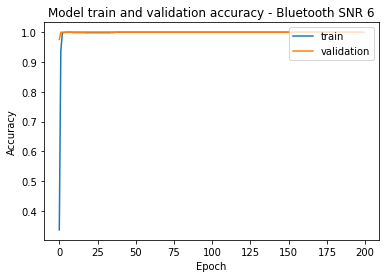

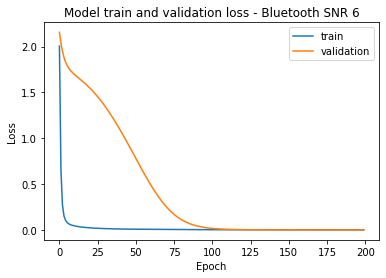

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_SNR_6_bluetooth.tf/assets

Score of SNR on All SNR model without Transfer Learning 8 = 100.0
Score of SNR on High SNR model without Transfer Learning 8 = 100.0
Score of SNR on low SNR model without Transfer Learning 8 = 100.0

Training SNR = 8 Data

Epoch 1/200
5/5 [==============================] - 1s 91ms/step - loss: 2.0970 - accuracy: 0.2993 - val_loss: 2.1451 - val_accuracy: 0.9175
Epoch 2/200
5/5 [==============================] - 0s 10ms/step - loss: 0.6933 - accuracy: 0.9273 - val_loss: 2.0283 - val_accuracy: 1.0000
Epoch 3/200
5/5 [==============================] - 0s 11ms/step - loss: 0.2923 - accuracy: 0.9977 - val_loss: 1.9411 - val_accuracy: 1.0000
Epoch 4/200
5/5 [==============================] - 0s 10ms/step - loss: 0.1625 - accuracy: 0.9992 - val_loss: 1.8746 - val_accuracy: 1.0000
Epoch 5/200
5/5 [==============================] - 0s 10ms/step - loss: 0.1092 - accu

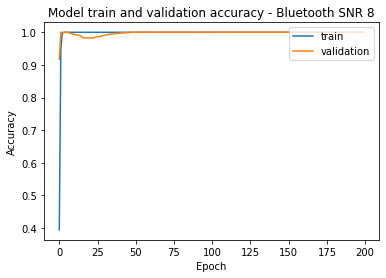

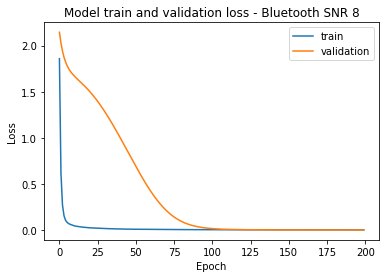

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_SNR_8_bluetooth.tf/assets


In [ ]:
for i in range(10, 15):

  x_data_mag = np.absolute(x_data_fft_bluetooth[:,:,:,:,0] + 1j*x_data_fft_bluetooth[:,:,:,:,1]) 
  x_data_fft_curr = np.reshape(x_data_mag[:,i], (x_dim[0]*x_dim[2], x_dim[3]))
  
  y_data_fft_curr = to_categorical(y_labels_bluetooth[:,i].flatten())

  X_train_curr, X_test_valid_curr, Y_train_curr, Y_test_valid_curr = train_test_split(x_data_fft_curr, y_data_fft_curr, test_size=0.4)
  X_validation_curr, X_test_curr, Y_validation_curr, Y_test_curr = train_test_split(X_test_valid_curr, Y_test_valid_curr, test_size=0.5)

  Testing(X_test_curr, Y_test_curr, i)
  train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)


Score of SNR on All SNR model without Transfer Learning 10 = 100.0
Score of SNR on High SNR model without Transfer Learning 10 = 100.0
Score of SNR on low SNR model without Transfer Learning 10 = 100.0

Training SNR = 10 Data

Epoch 1/200
5/5 [==============================] - 1s 88ms/step - loss: 2.0969 - accuracy: 0.2791 - val_loss: 2.1501 - val_accuracy: 0.9811
Epoch 2/200
5/5 [==============================] - 0s 8ms/step - loss: 0.6540 - accuracy: 0.9501 - val_loss: 2.0177 - val_accuracy: 1.0000
Epoch 3/200
5/5 [==============================] - 0s 8ms/step - loss: 0.2550 - accuracy: 0.9990 - val_loss: 1.9159 - val_accuracy: 1.0000
Epoch 4/200
5/5 [==============================] - 0s 9ms/step - loss: 0.1427 - accuracy: 1.0000 - val_loss: 1.8397 - val_accuracy: 1.0000
Epoch 5/200
5/5 [==============================] - 0s 8ms/step - loss: 0.1009 - accuracy: 0.9996 - val_loss: 1.7832 - val_accuracy: 1.0000
Epoch 6/200
5/5 [==============================] - 0s 8ms/step - loss: 0.078

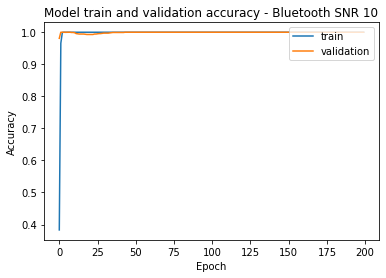

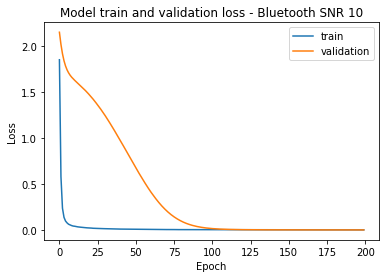

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_SNR_10_bluetooth.tf/assets

Score of SNR on All SNR model without Transfer Learning 12 = 100.0
Score of SNR on High SNR model without Transfer Learning 12 = 100.0
Score of SNR on low SNR model without Transfer Learning 12 = 100.0

Training SNR = 12 Data

Epoch 1/200
5/5 [==============================] - 1s 89ms/step - loss: 1.9944 - accuracy: 0.3378 - val_loss: 2.1304 - val_accuracy: 0.9986
Epoch 2/200
5/5 [==============================] - 0s 9ms/step - loss: 0.5630 - accuracy: 0.9710 - val_loss: 1.9972 - val_accuracy: 1.0000
Epoch 3/200
5/5 [==============================] - 0s 9ms/step - loss: 0.2200 - accuracy: 0.9981 - val_loss: 1.8947 - val_accuracy: 1.0000
Epoch 4/200
5/5 [==============================] - 0s 9ms/step - loss: 0.1249 - accuracy: 0.9997 - val_loss: 1.8182 - val_accuracy: 1.0000
Epoch 5/200
5/5 [==============================] - 0s 8ms/step - loss: 0.0881 - acc

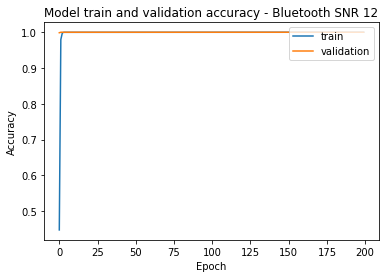

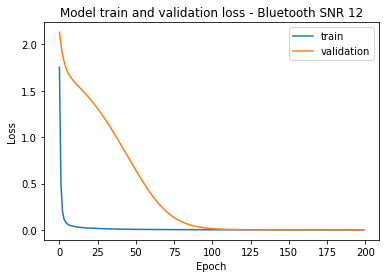

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_SNR_12_bluetooth.tf/assets

Score of SNR on All SNR model without Transfer Learning 14 = 100.0
Score of SNR on High SNR model without Transfer Learning 14 = 100.0
Score of SNR on low SNR model without Transfer Learning 14 = 100.0

Training SNR = 14 Data

Epoch 1/200
5/5 [==============================] - 1s 90ms/step - loss: 2.0666 - accuracy: 0.3414 - val_loss: 2.1388 - val_accuracy: 0.9951
Epoch 2/200
5/5 [==============================] - 0s 12ms/step - loss: 0.5703 - accuracy: 0.9662 - val_loss: 2.0218 - val_accuracy: 1.0000
Epoch 3/200
5/5 [==============================] - 0s 10ms/step - loss: 0.2307 - accuracy: 0.9970 - val_loss: 1.9327 - val_accuracy: 1.0000
Epoch 4/200
5/5 [==============================] - 0s 13ms/step - loss: 0.1331 - accuracy: 0.9996 - val_loss: 1.8655 - val_accuracy: 1.0000
Epoch 5/200
5/5 [==============================] - 0s 10ms/step - loss: 0.0922 -

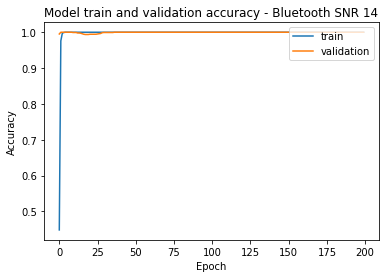

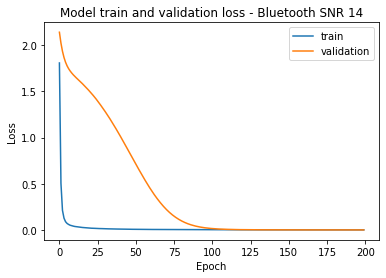

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_SNR_14_bluetooth.tf/assets

Score of SNR on All SNR model without Transfer Learning 16 = 100.0
Score of SNR on High SNR model without Transfer Learning 16 = 100.0
Score of SNR on low SNR model without Transfer Learning 16 = 100.0

Training SNR = 16 Data

Epoch 1/200
5/5 [==============================] - 1s 91ms/step - loss: 2.2957 - accuracy: 0.2356 - val_loss: 2.1590 - val_accuracy: 0.9769
Epoch 2/200
5/5 [==============================] - 0s 13ms/step - loss: 0.7066 - accuracy: 0.9359 - val_loss: 2.0297 - val_accuracy: 1.0000
Epoch 3/200
5/5 [==============================] - 0s 10ms/step - loss: 0.2598 - accuracy: 0.9970 - val_loss: 1.9272 - val_accuracy: 1.0000
Epoch 4/200
5/5 [==============================] - 0s 10ms/step - loss: 0.1432 - accuracy: 0.9996 - val_loss: 1.8492 - val_accuracy: 1.0000
Epoch 5/200
5/5 [==============================] - 0s 14ms/step - loss: 0.0988 -

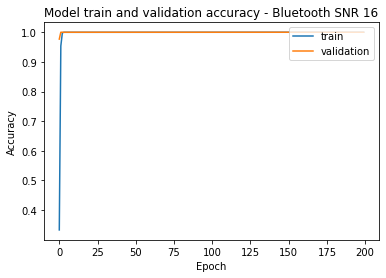

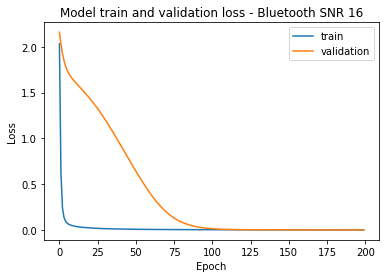

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_SNR_16_bluetooth.tf/assets

Score of SNR on All SNR model without Transfer Learning 18 = 100.0
Score of SNR on High SNR model without Transfer Learning 18 = 100.0
Score of SNR on low SNR model without Transfer Learning 18 = 100.0

Training SNR = 18 Data

Epoch 1/200
5/5 [==============================] - 1s 93ms/step - loss: 2.2529 - accuracy: 0.2649 - val_loss: 2.1503 - val_accuracy: 0.9476
Epoch 2/200
5/5 [==============================] - 0s 10ms/step - loss: 0.6849 - accuracy: 0.9142 - val_loss: 2.0170 - val_accuracy: 0.9993
Epoch 3/200
5/5 [==============================] - 0s 9ms/step - loss: 0.2839 - accuracy: 0.9927 - val_loss: 1.9168 - val_accuracy: 1.0000
Epoch 4/200
5/5 [==============================] - 0s 10ms/step - loss: 0.1567 - accuracy: 1.0000 - val_loss: 1.8431 - val_accuracy: 1.0000
Epoch 5/200
5/5 [==============================] - 0s 10ms/step - loss: 0.1037 - 

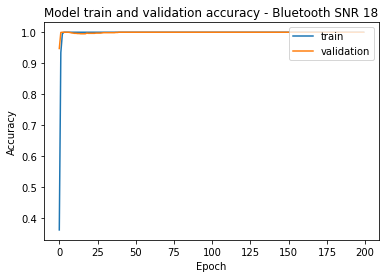

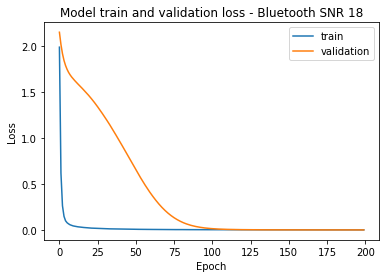

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_SNR_18_bluetooth.tf/assets

Score of SNR on All SNR model without Transfer Learning 20 = 100.0
Score of SNR on High SNR model without Transfer Learning 20 = 100.0
Score of SNR on low SNR model without Transfer Learning 20 = 100.0

Training SNR = 20 Data

Epoch 1/200
5/5 [==============================] - 1s 95ms/step - loss: 2.3649 - accuracy: 0.2020 - val_loss: 2.1604 - val_accuracy: 0.9224
Epoch 2/200
5/5 [==============================] - 0s 10ms/step - loss: 0.6980 - accuracy: 0.9207 - val_loss: 2.0348 - val_accuracy: 0.9965
Epoch 3/200
5/5 [==============================] - 0s 10ms/step - loss: 0.2552 - accuracy: 0.9980 - val_loss: 1.9371 - val_accuracy: 1.0000
Epoch 4/200
5/5 [==============================] - 0s 11ms/step - loss: 0.1449 - accuracy: 1.0000 - val_loss: 1.8636 - val_accuracy: 1.0000
Epoch 5/200
5/5 [==============================] - 0s 9ms/step - loss: 0.0979 - 

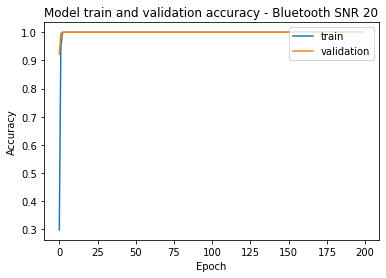

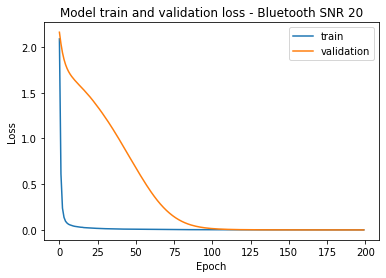

INFO:tensorflow:Assets written to: /gdrive/My Drive/Signal Identification Model FCN/Bluetooth/fcnFFTdata_SNR_20_bluetooth.tf/assets


In [ ]:
for i in range(15, 21):

  x_data_mag = np.absolute(x_data_fft_bluetooth[:,:,:,:,0] + 1j*x_data_fft_bluetooth[:,:,:,:,1]) 
  x_data_fft_curr = np.reshape(x_data_mag[:,i], (x_dim[0]*x_dim[2], x_dim[3]))
  
  y_data_fft_curr = to_categorical(y_labels_bluetooth[:,i].flatten())

  X_train_curr, X_test_valid_curr, Y_train_curr, Y_test_valid_curr = train_test_split(x_data_fft_curr, y_data_fft_curr, test_size=0.4)
  X_validation_curr, X_test_curr, Y_validation_curr, Y_test_curr = train_test_split(X_test_valid_curr, Y_test_valid_curr, test_size=0.5)

  Testing(X_test_curr, Y_test_curr, i)
  train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)

# Wi-Fi

## Whole data

In [ ]:
x_data_fft_wifi = x_data_fft_data[10:13]
y_labels_wifi = y_labels_data[10:13]

print(x_data_fft_wifi.shape)
print(y_labels_wifi.shape)

(3, 21, 715, 128, 2)
(3, 21, 715)


In [ ]:
x_dim = x_data_fft_wifi.shape
total_num_snapshots = x_dim[0]*x_dim[1]*x_dim[2]
num_snapshots_per_tech = x_dim[1]*x_dim[2]
num_tech = x_dim[0]
num_samples = x_dim[3]
print(num_snapshots_per_tech)

15015


In [ ]:
from sklearn.preprocessing import MinMaxScaler

# Bin wise scalers for FFT data from sklearn
scaler_01 = MinMaxScaler(feature_range=(0,1))

x_data_fft_wifi_1d = np.reshape(x_data_fft_wifi, (total_num_snapshots, num_samples*x_dim[4]))
fft_data_complex = np.reshape(x_data_fft_wifi_1d.flatten()[::2] + 1j*x_data_fft_wifi_1d.flatten()[1::2], (total_num_snapshots, num_samples))
x_data_fft_wifi_1d = scaler_01.fit_transform(np.absolute(fft_data_complex))

In [ ]:
from keras.utils.np_utils import to_categorical

y_labels_wifi = y_labels_wifi.flatten()
y_labels_wifi = y_labels_wifi - 10
y_labels_one_hot_wifi = to_categorical(y_labels_wifi)

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test_valid, Y_train, Y_test_valid = train_test_split(x_data_fft_wifi_1d, y_labels_one_hot_wifi, test_size=0.4)
X_validation, X_test, Y_validation, Y_test = train_test_split(X_test_valid, Y_test_valid, test_size=0.5)

In [ ]:
from keras.callbacks import EarlyStopping
ES = EarlyStopping(monitor = 'val_accuracy', mode = 'max', min_delta = 0.00001, patience = 200, verbose = 1)

import logging
logging.disable(logging.WARNING)

Epoch 1/200
27/27 [==============================] - 2s 25ms/step - loss: 0.9828 - accuracy: 0.5677 - val_loss: 1.0160 - val_accuracy: 0.6616
Epoch 2/200
27/27 [==============================] - 0s 9ms/step - loss: 0.6024 - accuracy: 0.7633 - val_loss: 0.9877 - val_accuracy: 0.3544
Epoch 3/200
27/27 [==============================] - 0s 10ms/step - loss: 0.5271 - accuracy: 0.7852 - val_loss: 1.0068 - val_accuracy: 0.3299
Epoch 4/200
27/27 [==============================] - 0s 8ms/step - loss: 0.4957 - accuracy: 0.7929 - val_loss: 1.0072 - val_accuracy: 0.3302
Epoch 5/200
27/27 [==============================] - 0s 9ms/step - loss: 0.4644 - accuracy: 0.8015 - val_loss: 1.0030 - val_accuracy: 0.3434
Epoch 6/200
27/27 [==============================] - 0s 9ms/step - loss: 0.4624 - accuracy: 0.7959 - val_loss: 0.9752 - val_accuracy: 0.3790
Epoch 7/200
27/27 [==============================] - 0s 9ms/step - loss: 0.4488 - accuracy: 0.7996 - val_loss: 0.9025 - val_accuracy: 0.4613
Epoch 8/200

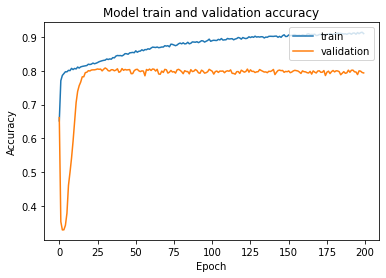

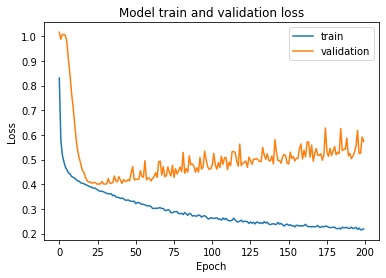


Training Accuracy Array:  [0.6521256566047668, 0.770895779132843, 0.786361813545227, 0.7917637825012207, 0.7972028255462646, 0.7969067692756653, 0.8013467788696289, 0.8004958033561707, 0.8071557879447937, 0.8036038279533386, 0.8070077896118164, 0.8054907917976379, 0.8110408186912537, 0.8081178069114685, 0.8115587830543518, 0.8129278421401978, 0.813778817653656, 0.8143708109855652, 0.8155918121337891, 0.819476842880249, 0.8185518383979797, 0.8196988105773926, 0.8228068351745605, 0.8208088278770447, 0.8222517967224121, 0.824249804019928, 0.8268028497695923, 0.8284308314323425, 0.8297628164291382, 0.8308728337287903, 0.831501841545105, 0.8349428176879883, 0.8333518505096436, 0.8351648449897766, 0.8342028260231018, 0.839012861251831, 0.838161826133728, 0.8434158563613892, 0.8452288508415222, 0.8447108268737793, 0.8450808525085449, 0.8439338207244873, 0.8465608358383179, 0.8506678342819214, 0.8503718376159668, 0.8488178253173828, 0.8528508543968201, 0.8535168766975403, 0.854330837726593, 0

In [ ]:
fcn_learning = fcn_model_wifi()

epochs = 200
batch_size = 1024

history = fcn_learning.fit(X_train, Y_train, epochs=epochs, batch_size=batch_size,  validation_data = (X_validation, Y_validation), shuffle=True, callbacks=[ES])

score = fcn_learning.evaluate(X_test, Y_test, verbose=0)
print('\nEvaluating on Test data : Score of SNR  = ' + str(score[1]*100) +'\n')

summarize_model(history)
fcn_learning.save("/gdrive/My Drive/Signal Identification Model FCN/Wi-Fi/fcnFFTdata_allSNR_wifi.tf")

print("\nTraining Accuracy Array: ", history.history['accuracy'])
print("\nValidation Accuracy Array: ", history.history['val_accuracy'])

## High SNR

In [ ]:
x_data_fft_high_SNR_wifi = x_data_fft_data[10:13,10:21]
y_labels_high_SNR_wifi = y_labels_data[10:13,10:21]

print(x_data_fft_high_SNR_wifi.shape)
print(y_labels_high_SNR_wifi.shape)

(3, 11, 715, 128, 2)
(3, 11, 715)


In [ ]:
x_dim = x_data_fft_high_SNR_wifi.shape
total_num_snapshots = x_dim[0]*x_dim[1]*x_dim[2]
num_snapshots_per_tech = x_dim[1]*x_dim[2]
num_tech = x_dim[0]
num_samples = x_dim[3]
print(num_snapshots_per_tech)

7865


In [ ]:
from sklearn.preprocessing import MinMaxScaler

# Bin wise scalers for FFT data from sklearn
scaler_01 = MinMaxScaler(feature_range=(0,1))

x_data_fft_high_SNR_wifi_1d = np.reshape(x_data_fft_high_SNR_wifi, (total_num_snapshots, num_samples*x_dim[4]))
fft_data_complex = np.reshape(x_data_fft_high_SNR_wifi_1d.flatten()[::2] + 1j*x_data_fft_high_SNR_wifi_1d.flatten()[1::2], (total_num_snapshots, num_samples))
x_data_fft_high_SNR_wifi_1d = scaler_01.fit_transform(np.absolute(fft_data_complex))

In [ ]:
from keras.utils.np_utils import to_categorical

y_labels_high_SNR_wifi = y_labels_high_SNR_wifi.flatten()
y_labels_high_SNR_wifi = y_labels_high_SNR_wifi - 10
y_labels_one_hot_high_SNR_wifi = to_categorical(y_labels_high_SNR_wifi)

In [ ]:
from keras.callbacks import EarlyStopping
ES = EarlyStopping(monitor = 'val_accuracy', mode = 'max', min_delta = 0.00001, patience = 200, verbose = 1)

import logging
logging.disable(logging.WARNING)

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test_valid, Y_train, Y_test_valid = train_test_split(x_data_fft_high_SNR_wifi_1d, y_labels_one_hot_high_SNR_wifi, test_size=0.4)
X_validation, X_test, Y_validation, Y_test = train_test_split(X_test_valid, Y_test_valid, test_size=0.5)

Epoch 1/200
14/14 [==============================] - 2s 34ms/step - loss: 0.8293 - accuracy: 0.6460 - val_loss: 1.2840 - val_accuracy: 0.3297
Epoch 2/200
14/14 [==============================] - 0s 6ms/step - loss: 0.1496 - accuracy: 0.9644 - val_loss: 1.0474 - val_accuracy: 0.3314
Epoch 3/200
14/14 [==============================] - 0s 6ms/step - loss: 0.0869 - accuracy: 0.9833 - val_loss: 0.8914 - val_accuracy: 0.3838
Epoch 4/200
14/14 [==============================] - 0s 6ms/step - loss: 0.0622 - accuracy: 0.9872 - val_loss: 0.8127 - val_accuracy: 0.4601
Epoch 5/200
14/14 [==============================] - 0s 6ms/step - loss: 0.0542 - accuracy: 0.9878 - val_loss: 0.6369 - val_accuracy: 0.6080
Epoch 6/200
14/14 [==============================] - 0s 7ms/step - loss: 0.0433 - accuracy: 0.9910 - val_loss: 0.4949 - val_accuracy: 0.7576
Epoch 7/200
14/14 [==============================] - 0s 7ms/step - loss: 0.0358 - accuracy: 0.9939 - val_loss: 0.3862 - val_accuracy: 0.8578
Epoch 8/200


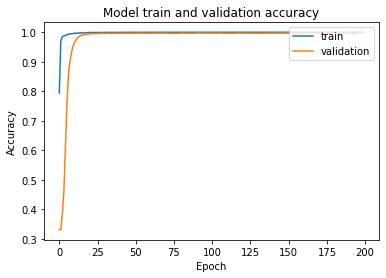

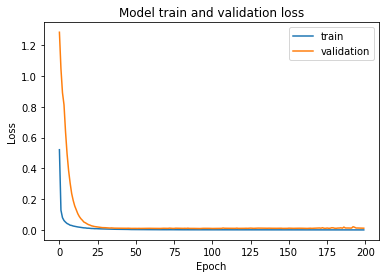


Training Accuracy Array:  [0.7938829064369202, 0.9716747999191284, 0.9848837852478027, 0.9872854351997375, 0.9889807105064392, 0.9916648864746094, 0.9930776357650757, 0.9948435425758362, 0.9946316480636597, 0.995691180229187, 0.9963975548744202, 0.9966800808906555, 0.9969626069068909, 0.9973158240318298, 0.9983753561973572, 0.9974570870399475, 0.9981634616851807, 0.9980928301811218, 0.9987285733222961, 0.9985872507095337, 0.9990817308425903, 0.9989404678344727, 0.9990110993385315, 0.9990817308425903, 0.9988698363304138, 0.9990817308425903, 0.9990817308425903, 0.999222993850708, 0.9989404678344727, 0.9994348883628845, 0.9994348883628845, 0.9996468424797058, 0.9993642568588257, 0.9993642568588257, 0.9992936253547668, 0.9997174739837646, 0.999576210975647, 0.999576210975647, 0.9996468424797058, 0.9993642568588257, 0.9996468424797058, 0.999576210975647, 0.999576210975647, 0.9996468424797058, 0.9997174739837646, 0.999576210975647, 1.0, 0.9998587369918823, 0.9998587369918823, 0.999717473983

In [ ]:
fcn_learning_high_SNR_wifi = fcn_model_wifi()

epochs = 200
batch_size = 1024

history = fcn_learning_high_SNR_wifi.fit(X_train, Y_train, epochs=epochs, batch_size=batch_size,  validation_data = (X_validation, Y_validation), shuffle=True, callbacks=[ES])

score = fcn_learning_high_SNR_wifi.evaluate(X_test, Y_test, verbose=0)
print('\nEvaluating on Test data : Score of SNR = ' + str(score[1]*100) +'\n')

summarize_model(history)
fcn_learning_high_SNR_wifi.save("/gdrive/My Drive/Signal Identification Model FCN/Wi-Fi/fcnFFTdata_highSNR_wifi.tf")

print("\nTraining Accuracy Array: ", history.history['accuracy'])
print("\nValidation Accuracy Array: ", history.history['val_accuracy'])

## Low SNR

In [ ]:
x_data_fft_low_SNR_wifi = x_data_fft_data[10:13,10:21]
y_labels_low_SNR_wifi = y_labels_data[10:13,10:21]

print(x_data_fft_low_SNR_wifi.shape)
print(y_labels_low_SNR_wifi.shape)

(3, 11, 715, 128, 2)
(3, 11, 715)


In [ ]:
x_dim = x_data_fft_low_SNR_wifi.shape
total_num_snapshots = x_dim[0]*x_dim[1]*x_dim[2]
num_snapshots_per_tech = x_dim[1]*x_dim[2]
num_tech = x_dim[0]
num_samples = x_dim[3]
print(num_snapshots_per_tech)

7865


In [ ]:
from sklearn.preprocessing import MinMaxScaler

# Bin wise scalers for FFT data from sklearn
scaler_01 = MinMaxScaler(feature_range=(0,1))

x_data_fft_low_SNR_wifi_1d = np.reshape(x_data_fft_low_SNR_wifi, (total_num_snapshots, num_samples*x_dim[4]))
fft_data_complex = np.reshape(x_data_fft_low_SNR_wifi_1d.flatten()[::2] + 1j*x_data_fft_low_SNR_wifi_1d.flatten()[1::2], (total_num_snapshots, num_samples))
x_data_fft_low_SNR_wifi_1d = scaler_01.fit_transform(np.absolute(fft_data_complex))

In [ ]:
from keras.utils.np_utils import to_categorical

y_labels_low_SNR_wifi = y_labels_low_SNR_wifi.flatten()
y_labels_low_SNR_wifi = y_labels_low_SNR_wifi - 10
y_labels_one_hot_low_SNR_wifi = to_categorical(y_labels_low_SNR_wifi)

In [ ]:
from keras.callbacks import EarlyStopping
ES = EarlyStopping(monitor = 'val_accuracy', mode = 'max', min_delta = 0.00001, patience = 200, verbose = 1)

import logging
logging.disable(logging.WARNING)

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test_valid, Y_train, Y_test_valid = train_test_split(x_data_fft_low_SNR_wifi_1d, y_labels_one_hot_low_SNR_wifi, test_size=0.4)
X_validation, X_test, Y_validation, Y_test = train_test_split(X_test_valid, Y_test_valid, test_size=0.5)

Epoch 1/200
14/14 [==============================] - 1s 31ms/step - loss: 0.7522 - accuracy: 0.6754 - val_loss: 1.2231 - val_accuracy: 0.3384
Epoch 2/200
14/14 [==============================] - 0s 7ms/step - loss: 0.1487 - accuracy: 0.9675 - val_loss: 1.0821 - val_accuracy: 0.3397
Epoch 3/200
14/14 [==============================] - 0s 6ms/step - loss: 0.0828 - accuracy: 0.9823 - val_loss: 0.8583 - val_accuracy: 0.4016
Epoch 4/200
14/14 [==============================] - 0s 6ms/step - loss: 0.0603 - accuracy: 0.9884 - val_loss: 0.7512 - val_accuracy: 0.5035
Epoch 5/200
14/14 [==============================] - 0s 6ms/step - loss: 0.0475 - accuracy: 0.9913 - val_loss: 0.5704 - val_accuracy: 0.6773
Epoch 6/200
14/14 [==============================] - 0s 7ms/step - loss: 0.0427 - accuracy: 0.9918 - val_loss: 0.4332 - val_accuracy: 0.8127
Epoch 7/200
14/14 [==============================] - 0s 7ms/step - loss: 0.0372 - accuracy: 0.9924 - val_loss: 0.3225 - val_accuracy: 0.9000
Epoch 8/200


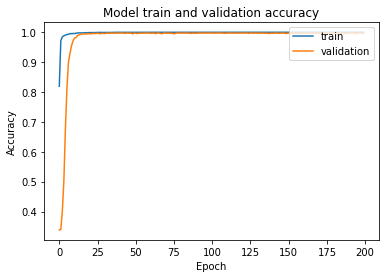

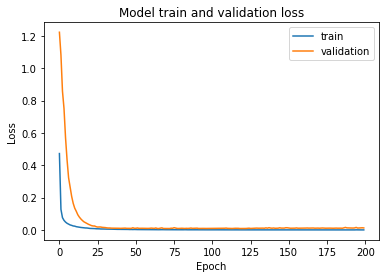


Training Accuracy Array:  [0.8193119764328003, 0.9722398519515991, 0.9846012592315674, 0.9879211783409119, 0.9906759858131409, 0.9925125241279602, 0.9930776357650757, 0.9952673316001892, 0.9952673316001892, 0.9958324432373047, 0.9955499172210693, 0.996891975402832, 0.9974570870399475, 0.9978809356689453, 0.9980928301811218, 0.9974570870399475, 0.9985166192054749, 0.9981634616851807, 0.9985872507095337, 0.9987285733222961, 0.9987285733222961, 0.9989404678344727, 0.9989404678344727, 0.998799204826355, 0.9992936253547668, 0.9994348883628845, 0.9991523623466492, 0.9996468424797058, 0.9991523623466492, 0.9992936253547668, 0.9996468424797058, 0.9995055198669434, 0.9995055198669434, 0.9991523623466492, 0.9993642568588257, 0.9996468424797058, 0.9997881054878235, 0.9997174739837646, 0.9997174739837646, 0.999576210975647, 0.9997881054878235, 0.999576210975647, 0.9998587369918823, 0.9996468424797058, 0.999576210975647, 0.999576210975647, 0.9998587369918823, 0.9997174739837646, 0.9998587369918823

In [ ]:
fcn_learning_low_SNR_wifi = fcn_model_wifi()

epochs = 200
batch_size = 1024

history = fcn_learning_low_SNR_wifi.fit(X_train, Y_train, epochs=epochs, batch_size=batch_size,  validation_data = (X_validation, Y_validation), shuffle=True, callbacks=[ES])

score = fcn_learning_low_SNR_wifi.evaluate(X_test, Y_test, verbose=0)
print('\nEvaluating on Test data : Score of SNR = ' + str(score[1]*100) +'\n')

summarize_model(history)
fcn_learning_low_SNR_wifi.save("/gdrive/My Drive/Signal Identification Model FCN/Wi-Fi/fcnFFTdata_lowSNR_wifi.tf")

print("\nTraining Accuracy Array: ", history.history['accuracy'])
print("\nValidation Accuracy Array: ", history.history['val_accuracy'])

## Channel Classification on each SNR separately and Transfer Learning

In [ ]:
x_data_fft_wifi = x_data_fft_data[10:13]
y_labels_wifi = y_labels_data[10:13]

print(x_data_fft_wifi.shape)
print(y_labels_wifi.shape)

y_labels_wifi = y_labels_wifi - 10

(3, 21, 715, 128, 2)
(3, 21, 715)


In [ ]:
x_dim = x_data_fft_wifi.shape
total_num_snapshots = x_dim[0]*x_dim[1]*x_dim[2]
num_snapshots_per_tech = x_dim[1]*x_dim[2]
num_tech = x_dim[0]
num_samples = x_dim[3]
print(num_snapshots_per_tech)

15015


In [ ]:
from sklearn.model_selection import train_test_split
from keras.utils.np_utils import to_categorical
from keras import models
import math

X_train_curr = np.zeros((math.floor(0.6*total_num_snapshots/21), num_samples, 2))
X_validation_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_samples, 2))
X_test_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_samples, 2))
Y_train_curr = np.zeros((math.floor(0.6*total_num_snapshots/21), num_tech))
Y_validation_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_tech))
Y_test_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_tech))

X_test_valid_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_samples, 2))
Y_test_valid_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_tech))

In [ ]:
print('X_train_curr.shape = ' + str(X_train_curr.shape))
print('X_validation_curr.shape = ' + str(X_validation_curr.shape))
print('X_test_curr.shape = ' + str(X_test_curr.shape))
print('Y_train_curr.shape = ' + str(Y_train_curr.shape))
print('Y_validation_curr.shape = ' + str(Y_validation_curr.shape))
print('Y_test_curr.shape = ' + str(Y_test_curr.shape))

X_train_curr.shape = (1287, 128, 2)
X_validation_curr.shape = (429, 128, 2)
X_test_curr.shape = (429, 128, 2)
Y_train_curr.shape = (1287, 3)
Y_validation_curr.shape = (429, 3)
Y_test_curr.shape = (429, 3)


In [ ]:
from matplotlib import pyplot

def summarize_model(history, i):

  pyplot.plot(history.history['accuracy'])
  pyplot.plot(history.history['val_accuracy']) 
  pyplot.title('Model train and validation accuracy - Wi-Fi SNR ' + str(2*i-20))
  pyplot.ylabel('Accuracy')
  pyplot.xlabel('Epoch')
  pyplot.legend(['train', 'validation'], loc='upper right')
  pyplot.show()

  pyplot.plot(history.history['loss'])
  pyplot.plot(history.history['val_loss'])  
  pyplot.title('Model train and validation loss - Wi-Fi SNR ' + str(2*i-20))
  pyplot.ylabel('Loss')
  pyplot.xlabel('Epoch')
  pyplot.legend(['train', 'validation'], loc='upper right')
  pyplot.show()

In [ ]:
from keras.callbacks import EarlyStopping

ES = EarlyStopping(monitor = 'val_accuracy', mode = 'max', min_delta = 0.000001, patience = 200, verbose = 1)

In [ ]:
def Testing(X_test_curr, Y_test_curr, i):
  
  all_snr_model = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/Wi-Fi/fcnFFTdata_allSNR_wifi.tf"))

  score = all_snr_model.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('\nScore of SNR on All SNR model without Transfer Learning ' + str(2*i-20) + ' = ' + str(score[1]*100))

  high_snr_model = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/Wi-Fi/fcnFFTdata_highSNR_wifi.tf"))

  score = high_snr_model.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('Score of SNR on High SNR model without Transfer Learning ' + str(2*i-20) + ' = ' + str(score[1]*100))

  low_snr_model = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/Wi-Fi/fcnFFTdata_lowSNR_wifi.tf"))

  score = low_snr_model.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('Score of SNR on low SNR model without Transfer Learning ' + str(2*i-20) + ' = ' + str(score[1]*100))

In [ ]:
def train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i):
  
  print("\nTraining SNR = "+str(2*i-20)+" Data\n")

  lstm_model_cur = fcn_model_wifi()
  history = lstm_model_cur.fit(X_train_curr, Y_train_curr, validation_data = (X_validation_curr, Y_validation_curr), epochs=200, batch_size=1024, callbacks=[ES])

  score = lstm_model_cur.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('\nEvaluating on Test data : Score of SNR ' + str(2*i-20) + ' = ' + str(score[1]*100) +'\n')

  summarize_model(history, i)
  lstm_model_cur.save("/gdrive/My Drive/Signal Identification Model FCN/Wi-Fi/fcnFFTdata_SNR_"+str(2*i-20)+"_wifi.tf")

In [ ]:
def train_data_on_all_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i):
  
  print("\nTraining SNR = "+str(2*i-20)+" Data on a pre-trained All SNR model\n")

  lstm_model_cur = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/Wi-Fi/fcnFFTdata_allSNR_wifi.tf"))
  lstm_model_cur.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
  history = lstm_model_cur.fit(X_train_curr, Y_train_curr, validation_data = (X_validation_curr, Y_validation_curr), epochs=200, batch_size=1024, callbacks=[ES])

  score = lstm_model_cur.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('\nEvaluating on Test data : Score of SNR ' + str(2*i-20) + ' = ' + str(score[1]*100) +'\n')

  summarize_model(history, i)
  lstm_model_cur.save("/gdrive/My Drive/Signal Identification Model FCN/Wi-Fi/fcnFFTdata_allSNR_to_SNR_"+str(2*i-20)+"_wifi.tf")

In [ ]:
def train_data_on_high_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i):
  
  print("\nTraining SNR = "+str(2*i-20)+" Data on a pre-trained High SNR model\n")

  lstm_model_cur = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/Wi-Fi/fcnFFTdata_highSNR_wifi.tf"))
  lstm_model_cur.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
  history = lstm_model_cur.fit(X_train_curr, Y_train_curr, validation_data = (X_validation_curr, Y_validation_curr), epochs=200, batch_size=1024, callbacks=[ES])

  score = lstm_model_cur.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('\nEvaluating on Test data : Score of SNR ' + str(2*i-20) + ' = ' + str(score[1]*100) +'\n')

  summarize_model(history, i)
  lstm_model_cur.save("/gdrive/My Drive/Signal Identification Model FCN/Wi-Fi/fcnFFTdata_highSNR_to_SNR_"+str(2*i-20)+"_wifi.tf")

In [ ]:
def train_data_on_low_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i):
  
  print("\nTraining SNR = "+str(2*i-20)+" Data on a pre-trained Low SNR model\n")

  lstm_model_cur = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/Wi-Fi/fcnFFTdata_lowSNR_wifi.tf"))  
  lstm_model_cur.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
  history = lstm_model_cur.fit(X_train_curr, Y_train_curr, validation_data = (X_validation_curr, Y_validation_curr), epochs=200, batch_size=1024, callbacks=[ES])

  score = lstm_model_cur.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('\nEvaluating on Test data : Score of SNR ' + str(2*i-20) + ' = ' + str(score[1]*100) +'\n')

  summarize_model(history, i)
  lstm_model_cur.save("/gdrive/My Drive/Signal Identification Model FCN/Wi-Fi/fcnFFTdata_lowSNR_to_SNR_"+str(2*i-20)+"_wifi.tf")
  


Score of SNR on All SNR model without Transfer Learning -20 = 39.627039432525635
Score of SNR on High SNR model without Transfer Learning -20 = 29.836830496788025
Score of SNR on low SNR model without Transfer Learning -20 = 30.069929361343384

Training SNR = -20 Data

Epoch 1/200
2/2 [==============================] - 1s 348ms/step - loss: 1.5140 - accuracy: 0.3311 - val_loss: 1.1019 - val_accuracy: 0.3543
Epoch 2/200
2/2 [==============================] - 0s 29ms/step - loss: 1.3627 - accuracy: 0.3590 - val_loss: 1.1031 - val_accuracy: 0.3497
Epoch 3/200
2/2 [==============================] - 0s 20ms/step - loss: 1.2642 - accuracy: 0.3934 - val_loss: 1.1046 - val_accuracy: 0.3473
Epoch 4/200
2/2 [==============================] - 0s 20ms/step - loss: 1.2262 - accuracy: 0.4070 - val_loss: 1.1053 - val_accuracy: 0.3427
Epoch 5/200
2/2 [==============================] - 0s 20ms/step - loss: 1.1852 - accuracy: 0.4343 - val_loss: 1.1049 - val_accuracy: 0.3287
Epoch 6/200
2/2 [===========

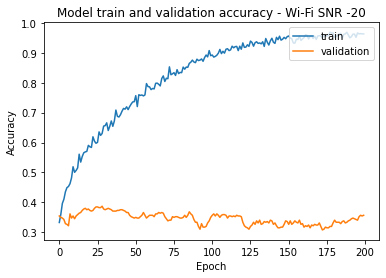

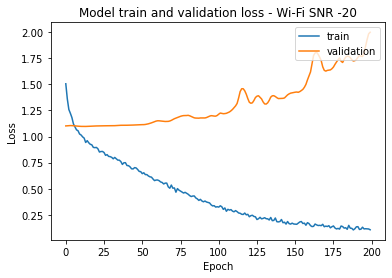


Training SNR = -20 Data on a pre-trained All SNR model

Epoch 1/200
2/2 [==============================] - 1s 340ms/step - loss: 3.8289 - accuracy: 0.4238 - val_loss: 1.9151 - val_accuracy: 0.4359
Epoch 2/200
2/2 [==============================] - 0s 21ms/step - loss: 3.2419 - accuracy: 0.4563 - val_loss: 2.3257 - val_accuracy: 0.4126
Epoch 3/200
2/2 [==============================] - 0s 20ms/step - loss: 2.7704 - accuracy: 0.4943 - val_loss: 2.6373 - val_accuracy: 0.3939
Epoch 4/200
2/2 [==============================] - 0s 20ms/step - loss: 2.3378 - accuracy: 0.5160 - val_loss: 2.8232 - val_accuracy: 0.3916
Epoch 5/200
2/2 [==============================] - 0s 21ms/step - loss: 2.1574 - accuracy: 0.5315 - val_loss: 2.9121 - val_accuracy: 0.3939
Epoch 6/200
2/2 [==============================] - 0s 20ms/step - loss: 1.8208 - accuracy: 0.5455 - val_loss: 2.8859 - val_accuracy: 0.3963
Epoch 7/200
2/2 [==============================] - 0s 21ms/step - loss: 1.7453 - accuracy: 0.5679 - va

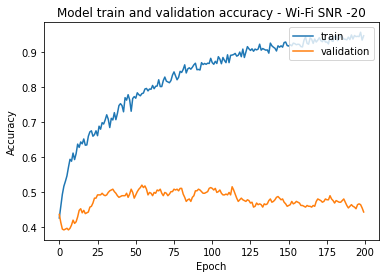

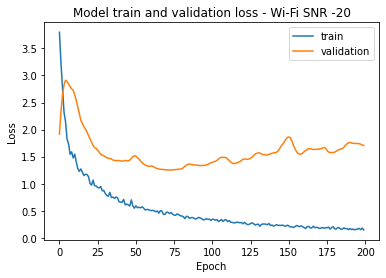


Training SNR = -20 Data on a pre-trained High SNR model

Epoch 1/200
2/2 [==============================] - 1s 334ms/step - loss: 7.1952 - accuracy: 0.3576 - val_loss: 12.0616 - val_accuracy: 0.3543
Epoch 2/200
2/2 [==============================] - 0s 22ms/step - loss: 6.6107 - accuracy: 0.3585 - val_loss: 10.3786 - val_accuracy: 0.3590
Epoch 3/200
2/2 [==============================] - 0s 22ms/step - loss: 6.1164 - accuracy: 0.3816 - val_loss: 8.6346 - val_accuracy: 0.3753
Epoch 4/200
2/2 [==============================] - 0s 22ms/step - loss: 5.5630 - accuracy: 0.3928 - val_loss: 7.0728 - val_accuracy: 0.3776
Epoch 5/200
2/2 [==============================] - 0s 22ms/step - loss: 5.1217 - accuracy: 0.3988 - val_loss: 5.7101 - val_accuracy: 0.3660
Epoch 6/200
2/2 [==============================] - 0s 22ms/step - loss: 4.5989 - accuracy: 0.3947 - val_loss: 4.4810 - val_accuracy: 0.3753
Epoch 7/200
2/2 [==============================] - 0s 22ms/step - loss: 4.1124 - accuracy: 0.4157 -

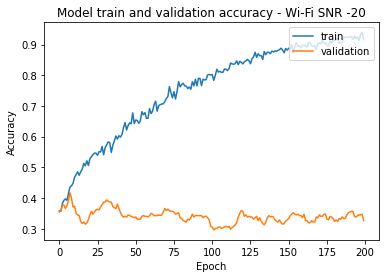

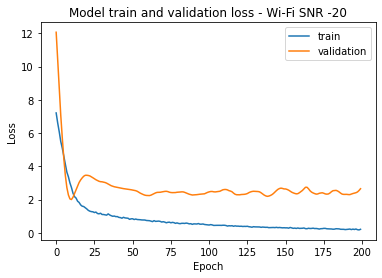


Training SNR = -20 Data on a pre-trained Low SNR model

Epoch 1/200
2/2 [==============================] - 1s 364ms/step - loss: 7.5171 - accuracy: 0.3620 - val_loss: 12.3215 - val_accuracy: 0.3590
Epoch 2/200
2/2 [==============================] - 0s 23ms/step - loss: 6.9177 - accuracy: 0.3659 - val_loss: 11.2471 - val_accuracy: 0.3613
Epoch 3/200
2/2 [==============================] - 0s 22ms/step - loss: 6.5682 - accuracy: 0.3771 - val_loss: 10.0735 - val_accuracy: 0.3590
Epoch 4/200
2/2 [==============================] - 0s 22ms/step - loss: 5.9655 - accuracy: 0.3829 - val_loss: 8.8045 - val_accuracy: 0.3613
Epoch 5/200
2/2 [==============================] - 0s 22ms/step - loss: 5.3720 - accuracy: 0.4006 - val_loss: 7.5845 - val_accuracy: 0.3613
Epoch 6/200
2/2 [==============================] - 0s 23ms/step - loss: 5.0288 - accuracy: 0.4087 - val_loss: 6.3319 - val_accuracy: 0.3613
Epoch 7/200
2/2 [==============================] - 0s 39ms/step - loss: 4.5429 - accuracy: 0.4283 -

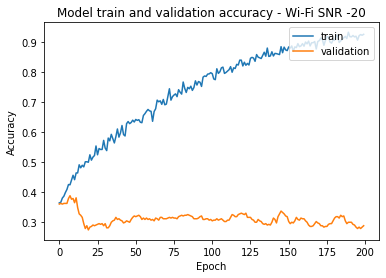

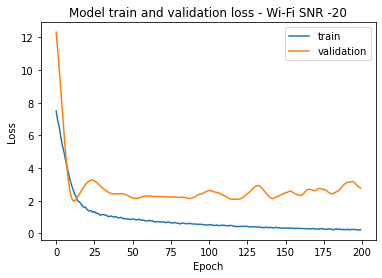


Score of SNR on All SNR model without Transfer Learning -18 = 43.822842836380005
Score of SNR on High SNR model without Transfer Learning -18 = 35.19813418388367
Score of SNR on low SNR model without Transfer Learning -18 = 34.49883460998535

Training SNR = -18 Data

Epoch 1/200
2/2 [==============================] - 1s 325ms/step - loss: 1.3933 - accuracy: 0.3241 - val_loss: 1.1109 - val_accuracy: 0.3310
Epoch 2/200
2/2 [==============================] - 0s 25ms/step - loss: 1.2745 - accuracy: 0.3598 - val_loss: 1.1052 - val_accuracy: 0.3357
Epoch 3/200
2/2 [==============================] - 0s 23ms/step - loss: 1.2044 - accuracy: 0.3936 - val_loss: 1.1033 - val_accuracy: 0.3497
Epoch 4/200
2/2 [==============================] - 0s 42ms/step - loss: 1.1449 - accuracy: 0.4322 - val_loss: 1.1036 - val_accuracy: 0.3566
Epoch 5/200
2/2 [==============================] - 0s 26ms/step - loss: 1.0941 - accuracy: 0.4309 - val_loss: 1.1047 - val_accuracy: 0.3497
Epoch 6/200
2/2 [=============

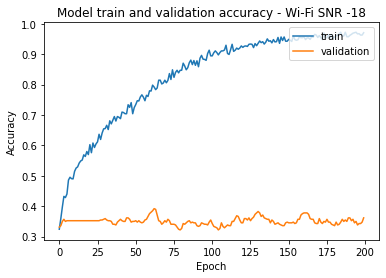

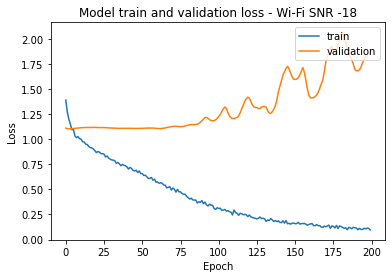


Training SNR = -18 Data on a pre-trained All SNR model

Epoch 1/200
2/2 [==============================] - 1s 338ms/step - loss: 3.5539 - accuracy: 0.4423 - val_loss: 2.2390 - val_accuracy: 0.4242
Epoch 2/200
2/2 [==============================] - 0s 26ms/step - loss: 3.0523 - accuracy: 0.4672 - val_loss: 2.6846 - val_accuracy: 0.3869
Epoch 3/200
2/2 [==============================] - 0s 23ms/step - loss: 2.7039 - accuracy: 0.4763 - val_loss: 3.0128 - val_accuracy: 0.3706
Epoch 4/200
2/2 [==============================] - 0s 24ms/step - loss: 2.3190 - accuracy: 0.5352 - val_loss: 3.3231 - val_accuracy: 0.3543
Epoch 5/200
2/2 [==============================] - 0s 24ms/step - loss: 2.0406 - accuracy: 0.5524 - val_loss: 3.5863 - val_accuracy: 0.3520
Epoch 6/200
2/2 [==============================] - 0s 25ms/step - loss: 1.8543 - accuracy: 0.5616 - val_loss: 3.7709 - val_accuracy: 0.3520
Epoch 7/200
2/2 [==============================] - 0s 25ms/step - loss: 1.6515 - accuracy: 0.5824 - va

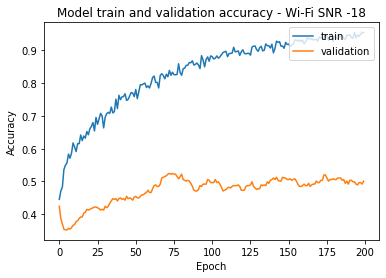

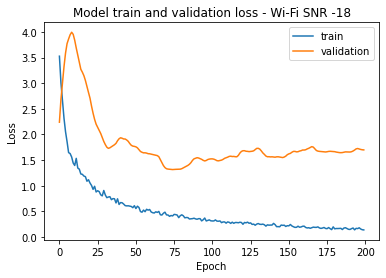


Training SNR = -18 Data on a pre-trained High SNR model

Epoch 1/200
2/2 [==============================] - 1s 367ms/step - loss: 7.1306 - accuracy: 0.3667 - val_loss: 4.6683 - val_accuracy: 0.3683
Epoch 2/200
2/2 [==============================] - 0s 23ms/step - loss: 6.4126 - accuracy: 0.3793 - val_loss: 4.1661 - val_accuracy: 0.3730
Epoch 3/200
2/2 [==============================] - 0s 24ms/step - loss: 5.8561 - accuracy: 0.3900 - val_loss: 3.7121 - val_accuracy: 0.3683
Epoch 4/200
2/2 [==============================] - 0s 26ms/step - loss: 5.4658 - accuracy: 0.4008 - val_loss: 3.3569 - val_accuracy: 0.3706
Epoch 5/200
2/2 [==============================] - 0s 28ms/step - loss: 4.9695 - accuracy: 0.4062 - val_loss: 3.1081 - val_accuracy: 0.3730
Epoch 6/200
2/2 [==============================] - 0s 26ms/step - loss: 4.4604 - accuracy: 0.4165 - val_loss: 2.9362 - val_accuracy: 0.3753
Epoch 7/200
2/2 [==============================] - 0s 31ms/step - loss: 3.9860 - accuracy: 0.4353 - v

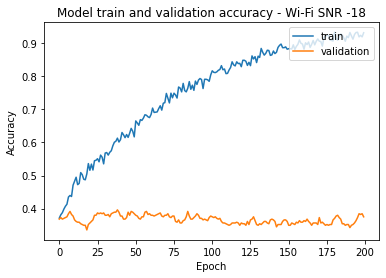

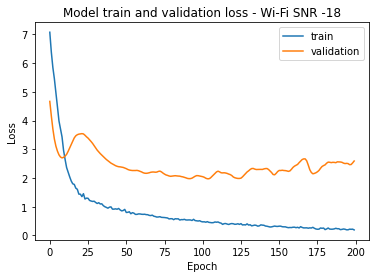


Training SNR = -18 Data on a pre-trained Low SNR model

Epoch 1/200
2/2 [==============================] - 1s 338ms/step - loss: 7.2127 - accuracy: 0.3559 - val_loss: 4.8308 - val_accuracy: 0.3636
Epoch 2/200
2/2 [==============================] - 0s 25ms/step - loss: 6.6822 - accuracy: 0.3757 - val_loss: 4.5230 - val_accuracy: 0.3520
Epoch 3/200
2/2 [==============================] - 0s 28ms/step - loss: 6.0699 - accuracy: 0.3942 - val_loss: 4.1893 - val_accuracy: 0.3636
Epoch 4/200
2/2 [==============================] - 0s 27ms/step - loss: 5.7689 - accuracy: 0.3941 - val_loss: 3.8233 - val_accuracy: 0.3683
Epoch 5/200
2/2 [==============================] - 0s 31ms/step - loss: 5.3614 - accuracy: 0.4011 - val_loss: 3.4820 - val_accuracy: 0.3683
Epoch 6/200
2/2 [==============================] - 0s 30ms/step - loss: 4.8268 - accuracy: 0.4047 - val_loss: 3.1642 - val_accuracy: 0.3636
Epoch 7/200
2/2 [==============================] - 0s 25ms/step - loss: 4.4309 - accuracy: 0.4213 - va

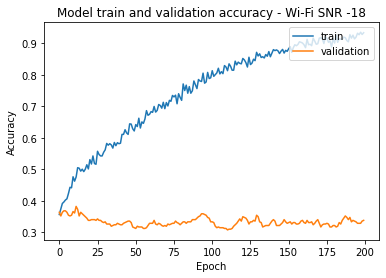

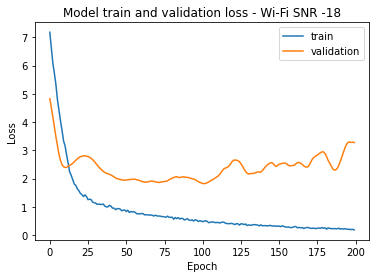


Score of SNR on All SNR model without Transfer Learning -16 = 42.65734255313873
Score of SNR on High SNR model without Transfer Learning -16 = 37.29603588581085
Score of SNR on low SNR model without Transfer Learning -16 = 36.829838156700134

Training SNR = -16 Data

Epoch 1/200
2/2 [==============================] - 1s 348ms/step - loss: 1.3343 - accuracy: 0.3359 - val_loss: 1.1029 - val_accuracy: 0.3357
Epoch 2/200
2/2 [==============================] - 0s 30ms/step - loss: 1.2480 - accuracy: 0.3588 - val_loss: 1.1067 - val_accuracy: 0.3357
Epoch 3/200
2/2 [==============================] - 0s 30ms/step - loss: 1.1713 - accuracy: 0.3952 - val_loss: 1.1126 - val_accuracy: 0.3357
Epoch 4/200
2/2 [==============================] - 0s 24ms/step - loss: 1.1303 - accuracy: 0.4069 - val_loss: 1.1190 - val_accuracy: 0.3357
Epoch 5/200
2/2 [==============================] - 0s 27ms/step - loss: 1.0729 - accuracy: 0.4501 - val_loss: 1.1250 - val_accuracy: 0.3357
Epoch 6/200
2/2 [=============

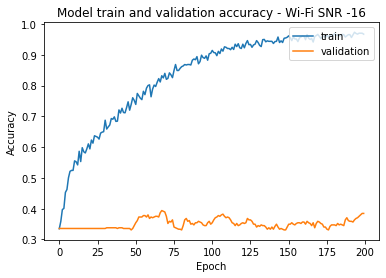

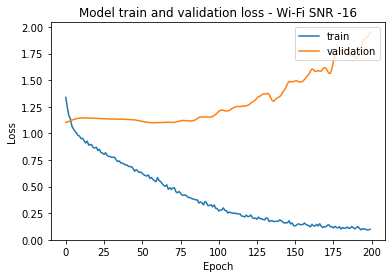


Training SNR = -16 Data on a pre-trained All SNR model

Epoch 1/200
2/2 [==============================] - 1s 362ms/step - loss: 2.9838 - accuracy: 0.5060 - val_loss: 3.0803 - val_accuracy: 0.3450
Epoch 2/200
2/2 [==============================] - 0s 32ms/step - loss: 2.6442 - accuracy: 0.5112 - val_loss: 4.7750 - val_accuracy: 0.3357
Epoch 3/200
2/2 [==============================] - 0s 28ms/step - loss: 2.2493 - accuracy: 0.5675 - val_loss: 6.2841 - val_accuracy: 0.3357
Epoch 4/200
2/2 [==============================] - 0s 27ms/step - loss: 2.0055 - accuracy: 0.5680 - val_loss: 7.5211 - val_accuracy: 0.3357
Epoch 5/200
2/2 [==============================] - 0s 27ms/step - loss: 1.8138 - accuracy: 0.5819 - val_loss: 8.4336 - val_accuracy: 0.3357
Epoch 6/200
2/2 [==============================] - 0s 27ms/step - loss: 1.7215 - accuracy: 0.6068 - val_loss: 9.0059 - val_accuracy: 0.3357
Epoch 7/200
2/2 [==============================] - 0s 29ms/step - loss: 1.5144 - accuracy: 0.6092 - va

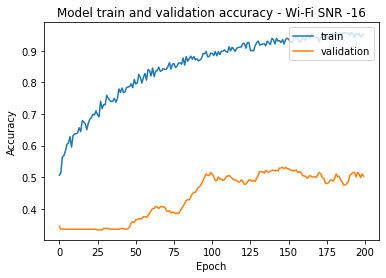

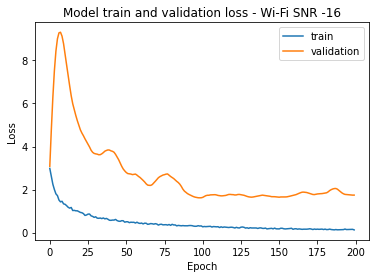


Training SNR = -16 Data on a pre-trained High SNR model

Epoch 1/200
2/2 [==============================] - 1s 337ms/step - loss: 6.0409 - accuracy: 0.4320 - val_loss: 2.5416 - val_accuracy: 0.3753
Epoch 2/200
2/2 [==============================] - 0s 28ms/step - loss: 5.6620 - accuracy: 0.4412 - val_loss: 2.3524 - val_accuracy: 0.3916
Epoch 3/200
2/2 [==============================] - 0s 47ms/step - loss: 5.1119 - accuracy: 0.4469 - val_loss: 2.2220 - val_accuracy: 0.3846
Epoch 4/200
2/2 [==============================] - 0s 25ms/step - loss: 4.7161 - accuracy: 0.4681 - val_loss: 2.1399 - val_accuracy: 0.3869
Epoch 5/200
2/2 [==============================] - 0s 27ms/step - loss: 4.4181 - accuracy: 0.4781 - val_loss: 2.1024 - val_accuracy: 0.3706
Epoch 6/200
2/2 [==============================] - 0s 29ms/step - loss: 3.9645 - accuracy: 0.4861 - val_loss: 2.1025 - val_accuracy: 0.3800
Epoch 7/200
2/2 [==============================] - 0s 30ms/step - loss: 3.6598 - accuracy: 0.4840 - v

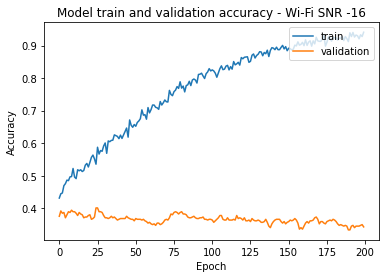

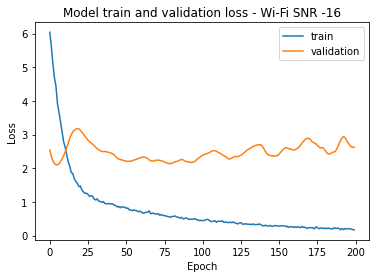


Training SNR = -16 Data on a pre-trained Low SNR model

Epoch 1/200
2/2 [==============================] - 1s 342ms/step - loss: 6.1882 - accuracy: 0.4221 - val_loss: 2.6657 - val_accuracy: 0.3776
Epoch 2/200
2/2 [==============================] - 0s 30ms/step - loss: 5.6909 - accuracy: 0.4417 - val_loss: 2.4520 - val_accuracy: 0.3963
Epoch 3/200
2/2 [==============================] - 0s 28ms/step - loss: 5.4451 - accuracy: 0.4374 - val_loss: 2.2918 - val_accuracy: 0.3893
Epoch 4/200
2/2 [==============================] - 0s 30ms/step - loss: 4.9965 - accuracy: 0.4630 - val_loss: 2.1436 - val_accuracy: 0.4079
Epoch 5/200
2/2 [==============================] - 0s 27ms/step - loss: 4.6079 - accuracy: 0.4587 - val_loss: 2.0083 - val_accuracy: 0.4056
Epoch 6/200
2/2 [==============================] - 0s 27ms/step - loss: 4.2067 - accuracy: 0.4628 - val_loss: 1.8971 - val_accuracy: 0.3963
Epoch 7/200
2/2 [==============================] - 0s 27ms/step - loss: 3.9352 - accuracy: 0.4720 - va

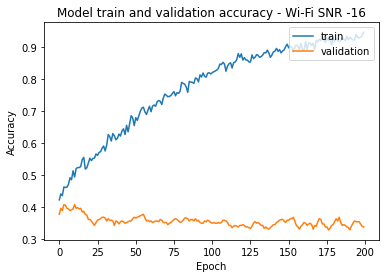

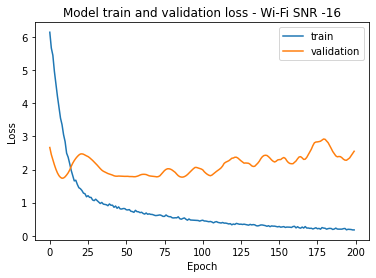


Score of SNR on All SNR model without Transfer Learning -14 = 46.38694524765015
Score of SNR on High SNR model without Transfer Learning -14 = 37.995338439941406
Score of SNR on low SNR model without Transfer Learning -14 = 33.799535036087036

Training SNR = -14 Data

Epoch 1/200
2/2 [==============================] - 1s 329ms/step - loss: 1.4395 - accuracy: 0.3286 - val_loss: 1.1116 - val_accuracy: 0.3403
Epoch 2/200
2/2 [==============================] - 0s 25ms/step - loss: 1.3132 - accuracy: 0.3612 - val_loss: 1.1137 - val_accuracy: 0.3287
Epoch 3/200
2/2 [==============================] - 0s 29ms/step - loss: 1.2172 - accuracy: 0.3886 - val_loss: 1.1160 - val_accuracy: 0.3287
Epoch 4/200
2/2 [==============================] - 0s 30ms/step - loss: 1.1342 - accuracy: 0.4391 - val_loss: 1.1199 - val_accuracy: 0.3287
Epoch 5/200
2/2 [==============================] - 0s 26ms/step - loss: 1.1115 - accuracy: 0.4335 - val_loss: 1.1241 - val_accuracy: 0.3287
Epoch 6/200
2/2 [============

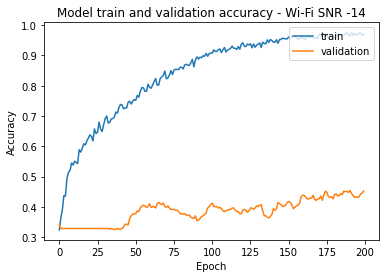

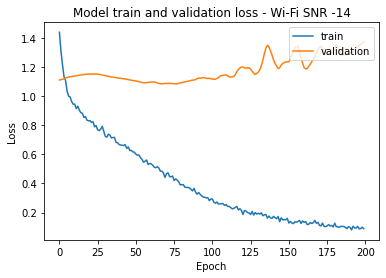


Training SNR = -14 Data on a pre-trained All SNR model

Epoch 1/200
2/2 [==============================] - 1s 350ms/step - loss: 2.6250 - accuracy: 0.5119 - val_loss: 2.7285 - val_accuracy: 0.3636
Epoch 2/200
2/2 [==============================] - 0s 29ms/step - loss: 2.2798 - accuracy: 0.5550 - val_loss: 4.0182 - val_accuracy: 0.3380
Epoch 3/200
2/2 [==============================] - 0s 27ms/step - loss: 2.0480 - accuracy: 0.5692 - val_loss: 5.1931 - val_accuracy: 0.3333
Epoch 4/200
2/2 [==============================] - 0s 25ms/step - loss: 1.7849 - accuracy: 0.5876 - val_loss: 6.2912 - val_accuracy: 0.3287
Epoch 5/200
2/2 [==============================] - 0s 31ms/step - loss: 1.6750 - accuracy: 0.6116 - val_loss: 7.3201 - val_accuracy: 0.3287
Epoch 6/200
2/2 [==============================] - 0s 25ms/step - loss: 1.5034 - accuracy: 0.6188 - val_loss: 8.1431 - val_accuracy: 0.3287
Epoch 7/200
2/2 [==============================] - 0s 27ms/step - loss: 1.4338 - accuracy: 0.6511 - va

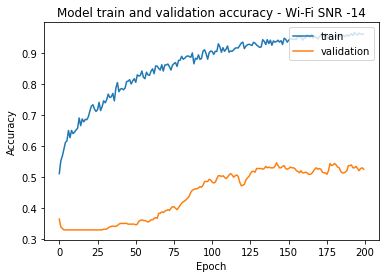

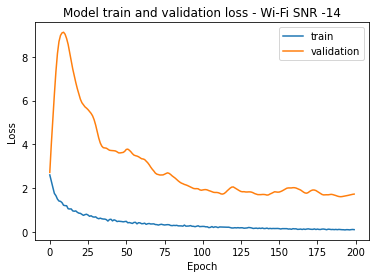


Training SNR = -14 Data on a pre-trained High SNR model

Epoch 1/200
2/2 [==============================] - 1s 340ms/step - loss: 5.5203 - accuracy: 0.4586 - val_loss: 2.6375 - val_accuracy: 0.3939
Epoch 2/200
2/2 [==============================] - 0s 34ms/step - loss: 5.0639 - accuracy: 0.4596 - val_loss: 2.4126 - val_accuracy: 0.3869
Epoch 3/200
2/2 [==============================] - 0s 30ms/step - loss: 4.7044 - accuracy: 0.4738 - val_loss: 2.2777 - val_accuracy: 0.3869
Epoch 4/200
2/2 [==============================] - 0s 27ms/step - loss: 4.2321 - accuracy: 0.5005 - val_loss: 2.1829 - val_accuracy: 0.4126
Epoch 5/200
2/2 [==============================] - 0s 31ms/step - loss: 3.9356 - accuracy: 0.5023 - val_loss: 2.1321 - val_accuracy: 0.4149
Epoch 6/200
2/2 [==============================] - 0s 27ms/step - loss: 3.6274 - accuracy: 0.4923 - val_loss: 2.1248 - val_accuracy: 0.4126
Epoch 7/200
2/2 [==============================] - 0s 24ms/step - loss: 3.3648 - accuracy: 0.5162 - v

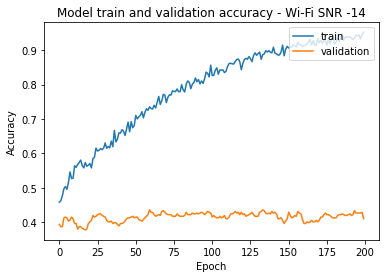

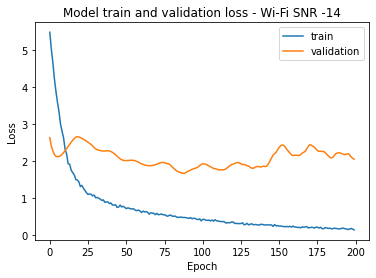


Training SNR = -14 Data on a pre-trained Low SNR model

Epoch 1/200
2/2 [==============================] - 1s 336ms/step - loss: 5.7093 - accuracy: 0.4591 - val_loss: 2.9594 - val_accuracy: 0.3683
Epoch 2/200
2/2 [==============================] - 0s 45ms/step - loss: 5.3989 - accuracy: 0.4554 - val_loss: 2.6579 - val_accuracy: 0.3753
Epoch 3/200
2/2 [==============================] - 0s 28ms/step - loss: 4.9258 - accuracy: 0.4763 - val_loss: 2.4347 - val_accuracy: 0.3706
Epoch 4/200
2/2 [==============================] - 0s 33ms/step - loss: 4.5743 - accuracy: 0.4887 - val_loss: 2.2501 - val_accuracy: 0.3800
Epoch 5/200
2/2 [==============================] - 0s 28ms/step - loss: 4.2362 - accuracy: 0.4985 - val_loss: 2.1315 - val_accuracy: 0.3776
Epoch 6/200
2/2 [==============================] - 0s 33ms/step - loss: 3.8767 - accuracy: 0.4984 - val_loss: 2.0565 - val_accuracy: 0.3869
Epoch 7/200
2/2 [==============================] - 0s 51ms/step - loss: 3.5368 - accuracy: 0.5182 - va

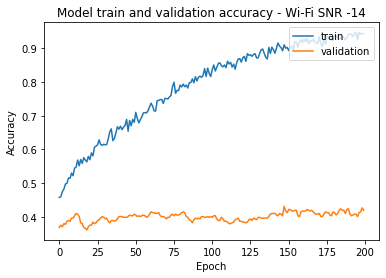

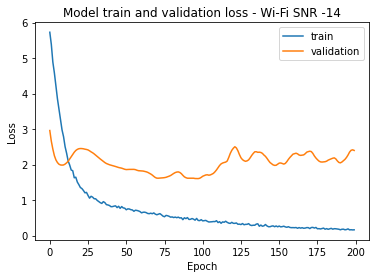


Score of SNR on All SNR model without Transfer Learning -12 = 47.31934666633606
Score of SNR on High SNR model without Transfer Learning -12 = 41.72494113445282
Score of SNR on low SNR model without Transfer Learning -12 = 36.829838156700134

Training SNR = -12 Data

Epoch 1/200
2/2 [==============================] - 1s 361ms/step - loss: 1.4549 - accuracy: 0.3540 - val_loss: 1.0994 - val_accuracy: 0.3333
Epoch 2/200
2/2 [==============================] - 0s 32ms/step - loss: 1.3289 - accuracy: 0.3893 - val_loss: 1.1034 - val_accuracy: 0.3427
Epoch 3/200
2/2 [==============================] - 0s 31ms/step - loss: 1.1925 - accuracy: 0.4409 - val_loss: 1.1094 - val_accuracy: 0.3403
Epoch 4/200
2/2 [==============================] - 0s 31ms/step - loss: 1.1104 - accuracy: 0.4690 - val_loss: 1.1174 - val_accuracy: 0.3403
Epoch 5/200
2/2 [==============================] - 0s 40ms/step - loss: 1.0311 - accuracy: 0.5196 - val_loss: 1.1255 - val_accuracy: 0.3403
Epoch 6/200
2/2 [=============

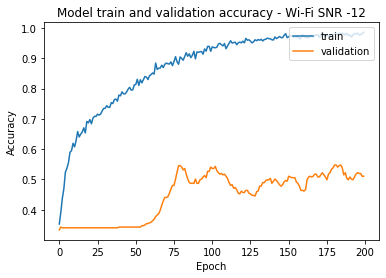

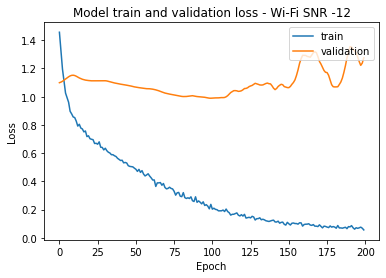


Training SNR = -12 Data on a pre-trained All SNR model

Epoch 1/200
2/2 [==============================] - 1s 352ms/step - loss: 1.8508 - accuracy: 0.6088 - val_loss: 2.3984 - val_accuracy: 0.4196
Epoch 2/200
2/2 [==============================] - 0s 43ms/step - loss: 1.6223 - accuracy: 0.6324 - val_loss: 3.7664 - val_accuracy: 0.3636
Epoch 3/200
2/2 [==============================] - 0s 32ms/step - loss: 1.4651 - accuracy: 0.6604 - val_loss: 5.0820 - val_accuracy: 0.3450
Epoch 4/200
2/2 [==============================] - 0s 33ms/step - loss: 1.3281 - accuracy: 0.6745 - val_loss: 6.2270 - val_accuracy: 0.3403
Epoch 5/200
2/2 [==============================] - 0s 30ms/step - loss: 1.2796 - accuracy: 0.6587 - val_loss: 7.1902 - val_accuracy: 0.3403
Epoch 6/200
2/2 [==============================] - 0s 29ms/step - loss: 1.1191 - accuracy: 0.7114 - val_loss: 7.9787 - val_accuracy: 0.3403
Epoch 7/200
2/2 [==============================] - 0s 28ms/step - loss: 1.1212 - accuracy: 0.7000 - va

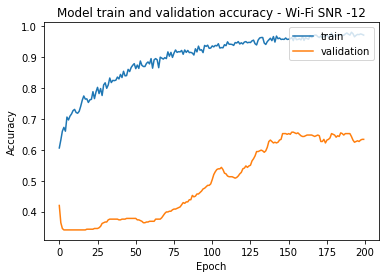

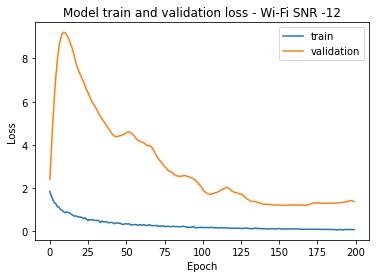


Training SNR = -12 Data on a pre-trained High SNR model

Epoch 1/200
2/2 [==============================] - 1s 348ms/step - loss: 4.2506 - accuracy: 0.5300 - val_loss: 2.8165 - val_accuracy: 0.4406
Epoch 2/200
2/2 [==============================] - 0s 27ms/step - loss: 3.7916 - accuracy: 0.5518 - val_loss: 2.6642 - val_accuracy: 0.4452
Epoch 3/200
2/2 [==============================] - 0s 25ms/step - loss: 3.4459 - accuracy: 0.5815 - val_loss: 2.5651 - val_accuracy: 0.4452
Epoch 4/200
2/2 [==============================] - 0s 36ms/step - loss: 3.1267 - accuracy: 0.5806 - val_loss: 2.5019 - val_accuracy: 0.4452
Epoch 5/200
2/2 [==============================] - 0s 26ms/step - loss: 2.8937 - accuracy: 0.6021 - val_loss: 2.4638 - val_accuracy: 0.4406
Epoch 6/200
2/2 [==============================] - 0s 38ms/step - loss: 2.6613 - accuracy: 0.6190 - val_loss: 2.4317 - val_accuracy: 0.4452
Epoch 7/200
2/2 [==============================] - 0s 28ms/step - loss: 2.4484 - accuracy: 0.6274 - v

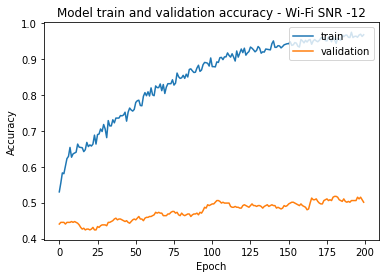

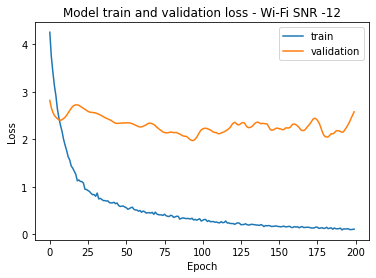


Training SNR = -12 Data on a pre-trained Low SNR model

Epoch 1/200
2/2 [==============================] - 1s 350ms/step - loss: 4.3886 - accuracy: 0.5482 - val_loss: 2.7875 - val_accuracy: 0.4033
Epoch 2/200
2/2 [==============================] - 0s 30ms/step - loss: 3.9890 - accuracy: 0.5472 - val_loss: 2.5978 - val_accuracy: 0.4149
Epoch 3/200
2/2 [==============================] - 0s 31ms/step - loss: 3.6100 - accuracy: 0.5609 - val_loss: 2.4403 - val_accuracy: 0.4312
Epoch 4/200
2/2 [==============================] - 0s 31ms/step - loss: 3.3621 - accuracy: 0.5650 - val_loss: 2.3242 - val_accuracy: 0.4476
Epoch 5/200
2/2 [==============================] - 0s 32ms/step - loss: 3.0745 - accuracy: 0.5884 - val_loss: 2.2483 - val_accuracy: 0.4522
Epoch 6/200
2/2 [==============================] - 0s 30ms/step - loss: 2.7453 - accuracy: 0.6082 - val_loss: 2.1914 - val_accuracy: 0.4569
Epoch 7/200
2/2 [==============================] - 0s 30ms/step - loss: 2.6553 - accuracy: 0.6065 - va

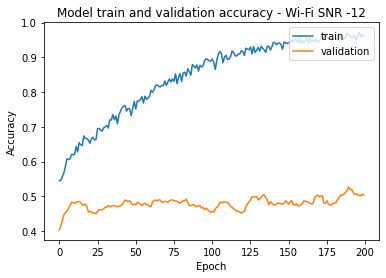

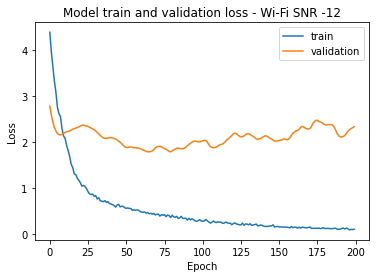

In [ ]:
for i in range(0, 5):

  x_data_mag = np.absolute(x_data_fft_wifi[:,:,:,:,0] + 1j*x_data_fft_wifi[:,:,:,:,1]) 
  x_data_fft_curr = np.reshape(x_data_mag[:,i], (x_dim[0]*x_dim[2], x_dim[3]))

  y_data_fft_curr = to_categorical(y_labels_wifi[:,i].flatten())

  X_train_curr, X_test_valid_curr, Y_train_curr, Y_test_valid_curr = train_test_split(x_data_fft_curr, y_data_fft_curr, test_size=0.4)
  X_validation_curr, X_test_curr, Y_validation_curr, Y_test_curr = train_test_split(X_test_valid_curr, Y_test_valid_curr, test_size=0.5)

  Testing(X_test_curr, Y_test_curr, i)
  train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_all_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_high_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_low_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)


Score of SNR on All SNR model without Transfer Learning -10 = 55.47785758972168
Score of SNR on High SNR model without Transfer Learning -10 = 47.0862478017807
Score of SNR on low SNR model without Transfer Learning -10 = 41.25874042510986

Training SNR = -10 Data

Epoch 1/200
2/2 [==============================] - 1s 338ms/step - loss: 1.3919 - accuracy: 0.3257 - val_loss: 1.0943 - val_accuracy: 0.3427
Epoch 2/200
2/2 [==============================] - 0s 22ms/step - loss: 1.1742 - accuracy: 0.4250 - val_loss: 1.0965 - val_accuracy: 0.3427
Epoch 3/200
2/2 [==============================] - 0s 21ms/step - loss: 1.0542 - accuracy: 0.4940 - val_loss: 1.1015 - val_accuracy: 0.3427
Epoch 4/200
2/2 [==============================] - 0s 21ms/step - loss: 0.9444 - accuracy: 0.5483 - val_loss: 1.1087 - val_accuracy: 0.3427
Epoch 5/200
2/2 [==============================] - 0s 21ms/step - loss: 0.8728 - accuracy: 0.6020 - val_loss: 1.1176 - val_accuracy: 0.3427
Epoch 6/200
2/2 [===============

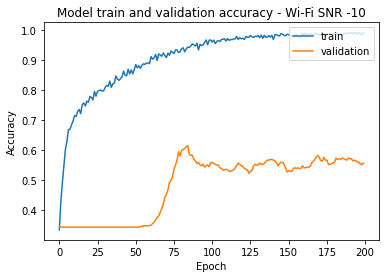

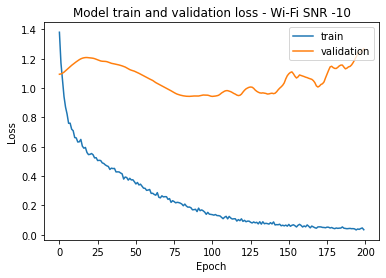


Training SNR = -10 Data on a pre-trained All SNR model

Epoch 1/200
2/2 [==============================] - 1s 322ms/step - loss: 1.4329 - accuracy: 0.6734 - val_loss: 3.1227 - val_accuracy: 0.4172
Epoch 2/200
2/2 [==============================] - 0s 22ms/step - loss: 1.2100 - accuracy: 0.7205 - val_loss: 5.1462 - val_accuracy: 0.3636
Epoch 3/200
2/2 [==============================] - 0s 21ms/step - loss: 1.0321 - accuracy: 0.7386 - val_loss: 6.9912 - val_accuracy: 0.3427
Epoch 4/200
2/2 [==============================] - 0s 20ms/step - loss: 0.9680 - accuracy: 0.7328 - val_loss: 8.5901 - val_accuracy: 0.3427
Epoch 5/200
2/2 [==============================] - 0s 21ms/step - loss: 0.8588 - accuracy: 0.7627 - val_loss: 9.9069 - val_accuracy: 0.3427
Epoch 6/200
2/2 [==============================] - 0s 21ms/step - loss: 0.7941 - accuracy: 0.7785 - val_loss: 10.9517 - val_accuracy: 0.3427
Epoch 7/200
2/2 [==============================] - 0s 21ms/step - loss: 0.7217 - accuracy: 0.7806 - v

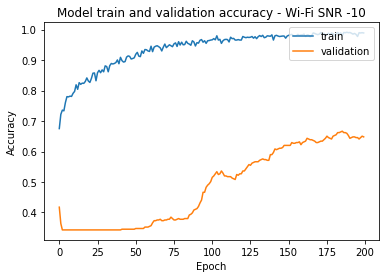

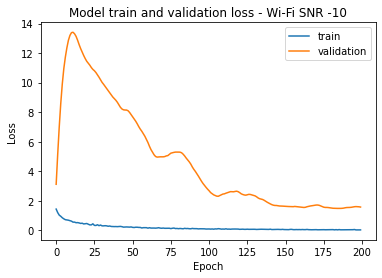


Training SNR = -10 Data on a pre-trained High SNR model

Epoch 1/200
2/2 [==============================] - 1s 337ms/step - loss: 2.9937 - accuracy: 0.6354 - val_loss: 2.9382 - val_accuracy: 0.4545
Epoch 2/200
2/2 [==============================] - 0s 24ms/step - loss: 2.6234 - accuracy: 0.6404 - val_loss: 2.7811 - val_accuracy: 0.4592
Epoch 3/200
2/2 [==============================] - 0s 28ms/step - loss: 2.3145 - accuracy: 0.6673 - val_loss: 2.6516 - val_accuracy: 0.4779
Epoch 4/200
2/2 [==============================] - 0s 23ms/step - loss: 2.0911 - accuracy: 0.6859 - val_loss: 2.5428 - val_accuracy: 0.4895
Epoch 5/200
2/2 [==============================] - 0s 23ms/step - loss: 1.8979 - accuracy: 0.6927 - val_loss: 2.4475 - val_accuracy: 0.5035
Epoch 6/200
2/2 [==============================] - 0s 24ms/step - loss: 1.8058 - accuracy: 0.7045 - val_loss: 2.3600 - val_accuracy: 0.5058
Epoch 7/200
2/2 [==============================] - 0s 23ms/step - loss: 1.6747 - accuracy: 0.7010 - v

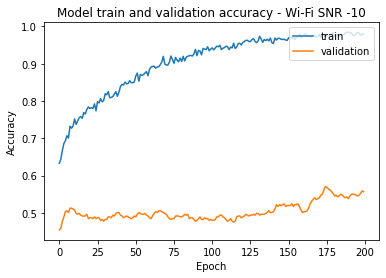

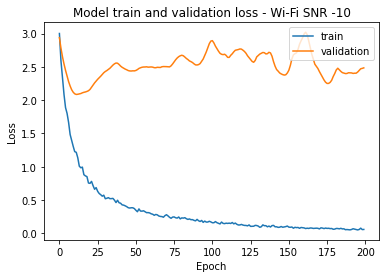


Training SNR = -10 Data on a pre-trained Low SNR model

Epoch 1/200
2/2 [==============================] - 1s 351ms/step - loss: 3.1032 - accuracy: 0.6212 - val_loss: 2.8801 - val_accuracy: 0.4126
Epoch 2/200
2/2 [==============================] - 0s 29ms/step - loss: 2.8298 - accuracy: 0.6474 - val_loss: 2.6038 - val_accuracy: 0.4242
Epoch 3/200
2/2 [==============================] - 0s 23ms/step - loss: 2.5290 - accuracy: 0.6668 - val_loss: 2.3700 - val_accuracy: 0.4336
Epoch 4/200
2/2 [==============================] - 0s 22ms/step - loss: 2.2553 - accuracy: 0.6717 - val_loss: 2.1853 - val_accuracy: 0.4452
Epoch 5/200
2/2 [==============================] - 0s 28ms/step - loss: 2.0156 - accuracy: 0.6834 - val_loss: 2.0335 - val_accuracy: 0.4499
Epoch 6/200
2/2 [==============================] - 0s 22ms/step - loss: 1.8995 - accuracy: 0.6983 - val_loss: 1.9070 - val_accuracy: 0.4592
Epoch 7/200
2/2 [==============================] - 0s 23ms/step - loss: 1.7674 - accuracy: 0.7025 - va

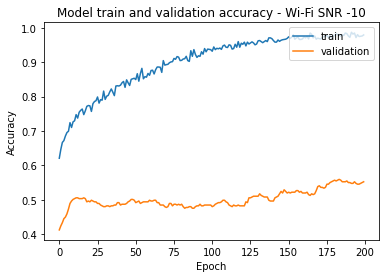

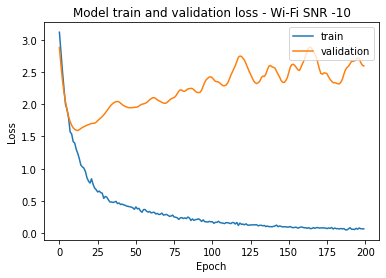


Score of SNR on All SNR model without Transfer Learning -8 = 59.67366099357605
Score of SNR on High SNR model without Transfer Learning -8 = 47.55244851112366
Score of SNR on low SNR model without Transfer Learning -8 = 37.52913773059845

Training SNR = -8 Data

Epoch 1/200
2/2 [==============================] - 2s 334ms/step - loss: 1.3582 - accuracy: 0.3024 - val_loss: 1.0989 - val_accuracy: 0.3100
Epoch 2/200
2/2 [==============================] - 0s 41ms/step - loss: 1.0911 - accuracy: 0.4543 - val_loss: 1.1032 - val_accuracy: 0.3100
Epoch 3/200
2/2 [==============================] - 0s 24ms/step - loss: 0.9527 - accuracy: 0.5470 - val_loss: 1.1112 - val_accuracy: 0.3100
Epoch 4/200
2/2 [==============================] - 0s 26ms/step - loss: 0.8023 - accuracy: 0.6539 - val_loss: 1.1223 - val_accuracy: 0.3100
Epoch 5/200
2/2 [==============================] - 0s 23ms/step - loss: 0.7371 - accuracy: 0.6836 - val_loss: 1.1361 - val_accuracy: 0.3100
Epoch 6/200
2/2 [==================

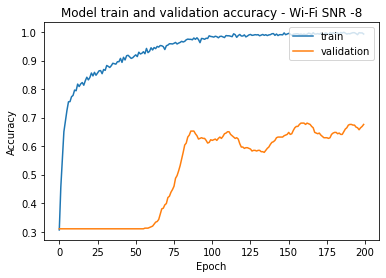

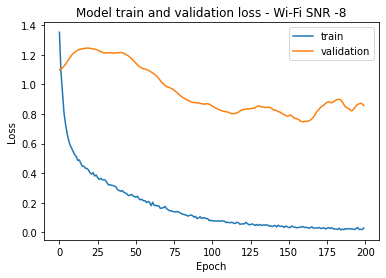


Training SNR = -8 Data on a pre-trained All SNR model

Epoch 1/200
2/2 [==============================] - 1s 354ms/step - loss: 0.8669 - accuracy: 0.7619 - val_loss: 3.4259 - val_accuracy: 0.4149
Epoch 2/200
2/2 [==============================] - 0s 26ms/step - loss: 0.6999 - accuracy: 0.7936 - val_loss: 5.7670 - val_accuracy: 0.3357
Epoch 3/200
2/2 [==============================] - 0s 26ms/step - loss: 0.6044 - accuracy: 0.8047 - val_loss: 7.7874 - val_accuracy: 0.3170
Epoch 4/200
2/2 [==============================] - 0s 25ms/step - loss: 0.6168 - accuracy: 0.8164 - val_loss: 9.4851 - val_accuracy: 0.3100
Epoch 5/200
2/2 [==============================] - 0s 27ms/step - loss: 0.5005 - accuracy: 0.8446 - val_loss: 10.8410 - val_accuracy: 0.3100
Epoch 6/200
2/2 [==============================] - 0s 26ms/step - loss: 0.4750 - accuracy: 0.8424 - val_loss: 11.8742 - val_accuracy: 0.3100
Epoch 7/200
2/2 [==============================] - 0s 25ms/step - loss: 0.4537 - accuracy: 0.8421 - v

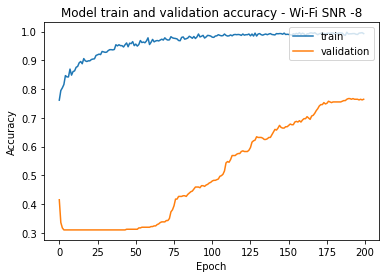

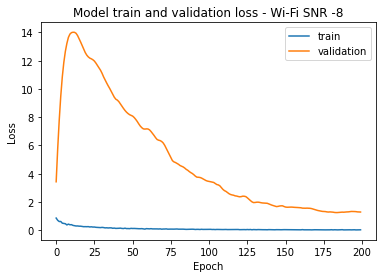


Training SNR = -8 Data on a pre-trained High SNR model

Epoch 1/200
2/2 [==============================] - 1s 353ms/step - loss: 1.8456 - accuracy: 0.7453 - val_loss: 2.7559 - val_accuracy: 0.5618
Epoch 2/200
2/2 [==============================] - 0s 26ms/step - loss: 1.5221 - accuracy: 0.7649 - val_loss: 2.6659 - val_accuracy: 0.5758
Epoch 3/200
2/2 [==============================] - 0s 28ms/step - loss: 1.2737 - accuracy: 0.7818 - val_loss: 2.5960 - val_accuracy: 0.5804
Epoch 4/200
2/2 [==============================] - 0s 27ms/step - loss: 1.1416 - accuracy: 0.8028 - val_loss: 2.5332 - val_accuracy: 0.5874
Epoch 5/200
2/2 [==============================] - 0s 26ms/step - loss: 1.0696 - accuracy: 0.8095 - val_loss: 2.4665 - val_accuracy: 0.5897
Epoch 6/200
2/2 [==============================] - 0s 25ms/step - loss: 1.0295 - accuracy: 0.8090 - val_loss: 2.4022 - val_accuracy: 0.5944
Epoch 7/200
2/2 [==============================] - 0s 32ms/step - loss: 0.8811 - accuracy: 0.8305 - va

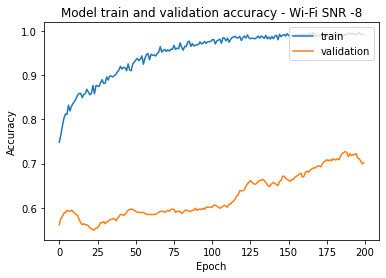

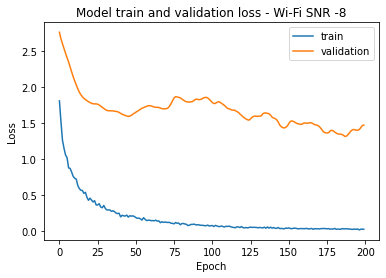


Training SNR = -8 Data on a pre-trained Low SNR model

Epoch 1/200
2/2 [==============================] - 1s 345ms/step - loss: 1.9066 - accuracy: 0.7275 - val_loss: 2.7314 - val_accuracy: 0.4709
Epoch 2/200
2/2 [==============================] - 0s 33ms/step - loss: 1.5317 - accuracy: 0.7612 - val_loss: 2.5718 - val_accuracy: 0.4942
Epoch 3/200
2/2 [==============================] - 0s 29ms/step - loss: 1.3506 - accuracy: 0.7726 - val_loss: 2.4290 - val_accuracy: 0.5175
Epoch 4/200
2/2 [==============================] - 0s 27ms/step - loss: 1.1726 - accuracy: 0.7916 - val_loss: 2.2880 - val_accuracy: 0.5385
Epoch 5/200
2/2 [==============================] - 0s 23ms/step - loss: 1.1175 - accuracy: 0.7941 - val_loss: 2.1666 - val_accuracy: 0.5478
Epoch 6/200
2/2 [==============================] - 0s 27ms/step - loss: 1.0294 - accuracy: 0.8005 - val_loss: 2.0682 - val_accuracy: 0.5594
Epoch 7/200
2/2 [==============================] - 0s 23ms/step - loss: 0.9238 - accuracy: 0.8250 - val

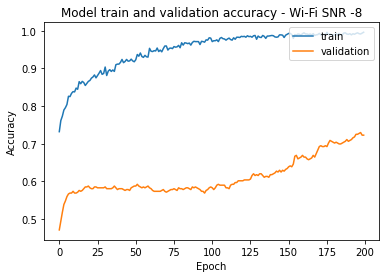

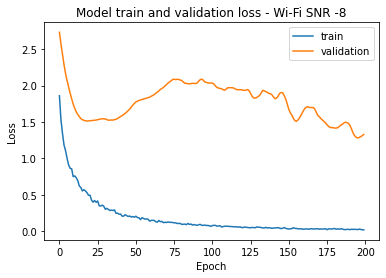


Score of SNR on All SNR model without Transfer Learning -6 = 64.80186581611633
Score of SNR on High SNR model without Transfer Learning -6 = 52.68065333366394
Score of SNR on low SNR model without Transfer Learning -6 = 42.424243688583374

Training SNR = -6 Data

Epoch 1/200
2/2 [==============================] - 1s 351ms/step - loss: 1.4204 - accuracy: 0.3490 - val_loss: 1.0974 - val_accuracy: 0.3054
Epoch 2/200
2/2 [==============================] - 0s 31ms/step - loss: 1.0430 - accuracy: 0.5047 - val_loss: 1.1008 - val_accuracy: 0.3054
Epoch 3/200
2/2 [==============================] - 0s 28ms/step - loss: 0.8267 - accuracy: 0.6232 - val_loss: 1.1096 - val_accuracy: 0.3054
Epoch 4/200
2/2 [==============================] - 0s 26ms/step - loss: 0.6901 - accuracy: 0.7136 - val_loss: 1.1217 - val_accuracy: 0.3054
Epoch 5/200
2/2 [==============================] - 0s 26ms/step - loss: 0.5856 - accuracy: 0.7693 - val_loss: 1.1352 - val_accuracy: 0.3054
Epoch 6/200
2/2 [=================

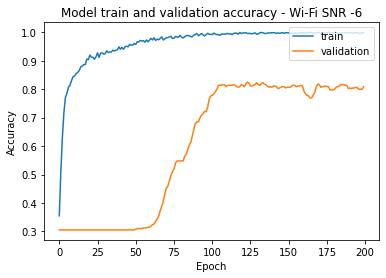

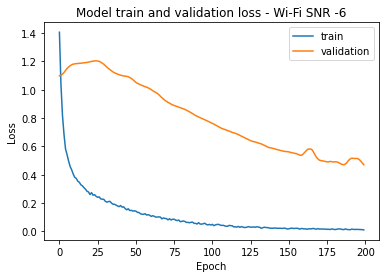


Training SNR = -6 Data on a pre-trained All SNR model

Epoch 1/200
2/2 [==============================] - 1s 342ms/step - loss: 0.5537 - accuracy: 0.8232 - val_loss: 2.9824 - val_accuracy: 0.4965
Epoch 2/200
2/2 [==============================] - 0s 29ms/step - loss: 0.4233 - accuracy: 0.8442 - val_loss: 5.1734 - val_accuracy: 0.3776
Epoch 3/200
2/2 [==============================] - 0s 28ms/step - loss: 0.3444 - accuracy: 0.8777 - val_loss: 7.0566 - val_accuracy: 0.3263
Epoch 4/200
2/2 [==============================] - 0s 30ms/step - loss: 0.3257 - accuracy: 0.8896 - val_loss: 8.5529 - val_accuracy: 0.3124
Epoch 5/200
2/2 [==============================] - 0s 25ms/step - loss: 0.3143 - accuracy: 0.8866 - val_loss: 9.7419 - val_accuracy: 0.3054
Epoch 6/200
2/2 [==============================] - 0s 34ms/step - loss: 0.2621 - accuracy: 0.9037 - val_loss: 10.5694 - val_accuracy: 0.3054
Epoch 7/200
2/2 [==============================] - 0s 27ms/step - loss: 0.2478 - accuracy: 0.8997 - va

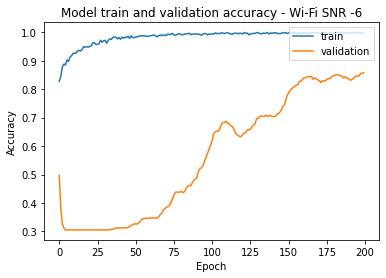

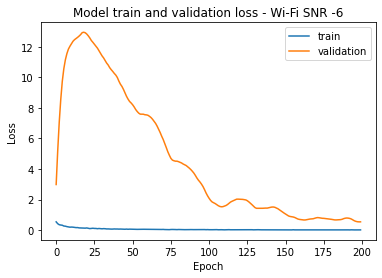


Training SNR = -6 Data on a pre-trained High SNR model

Epoch 1/200
2/2 [==============================] - 1s 348ms/step - loss: 0.9167 - accuracy: 0.8311 - val_loss: 2.9525 - val_accuracy: 0.5897
Epoch 2/200
2/2 [==============================] - 0s 35ms/step - loss: 0.7456 - accuracy: 0.8525 - val_loss: 2.9035 - val_accuracy: 0.6177
Epoch 3/200
2/2 [==============================] - 0s 28ms/step - loss: 0.7022 - accuracy: 0.8699 - val_loss: 2.8556 - val_accuracy: 0.6364
Epoch 4/200
2/2 [==============================] - 0s 47ms/step - loss: 0.5796 - accuracy: 0.8880 - val_loss: 2.7950 - val_accuracy: 0.6503
Epoch 5/200
2/2 [==============================] - 0s 28ms/step - loss: 0.5669 - accuracy: 0.8854 - val_loss: 2.7353 - val_accuracy: 0.6457
Epoch 6/200
2/2 [==============================] - 0s 37ms/step - loss: 0.5141 - accuracy: 0.8914 - val_loss: 2.6747 - val_accuracy: 0.6457
Epoch 7/200
2/2 [==============================] - 0s 29ms/step - loss: 0.4386 - accuracy: 0.9011 - va

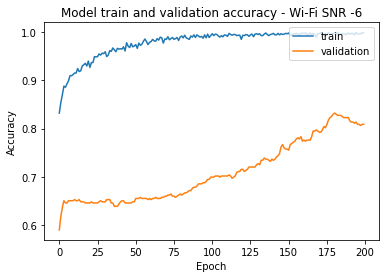

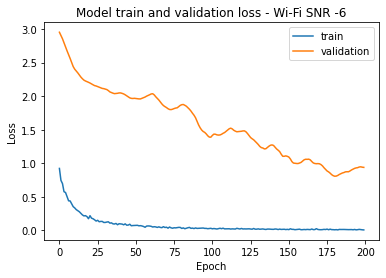


Training SNR = -6 Data on a pre-trained Low SNR model

Epoch 1/200
2/2 [==============================] - 1s 338ms/step - loss: 0.9982 - accuracy: 0.8230 - val_loss: 2.9535 - val_accuracy: 0.4312
Epoch 2/200
2/2 [==============================] - 0s 30ms/step - loss: 0.8283 - accuracy: 0.8508 - val_loss: 2.8841 - val_accuracy: 0.4359
Epoch 3/200
2/2 [==============================] - 0s 29ms/step - loss: 0.7512 - accuracy: 0.8669 - val_loss: 2.8117 - val_accuracy: 0.4452
Epoch 4/200
2/2 [==============================] - 0s 29ms/step - loss: 0.5923 - accuracy: 0.8705 - val_loss: 2.7501 - val_accuracy: 0.4452
Epoch 5/200
2/2 [==============================] - 0s 29ms/step - loss: 0.5298 - accuracy: 0.8847 - val_loss: 2.6724 - val_accuracy: 0.4476
Epoch 6/200
2/2 [==============================] - 0s 32ms/step - loss: 0.5194 - accuracy: 0.8985 - val_loss: 2.5858 - val_accuracy: 0.4499
Epoch 7/200
2/2 [==============================] - 0s 27ms/step - loss: 0.4433 - accuracy: 0.9105 - val

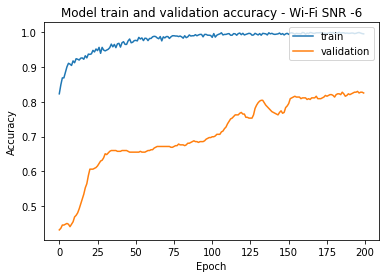

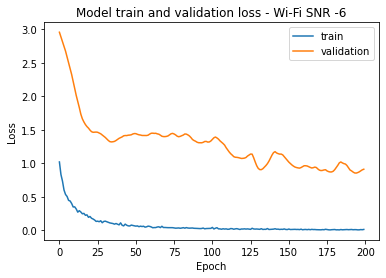


Score of SNR on All SNR model without Transfer Learning -4 = 76.92307829856873
Score of SNR on High SNR model without Transfer Learning -4 = 60.13985872268677
Score of SNR on low SNR model without Transfer Learning -4 = 45.45454680919647

Training SNR = -4 Data

Epoch 1/200
2/2 [==============================] - 1s 344ms/step - loss: 1.3365 - accuracy: 0.3833 - val_loss: 1.0806 - val_accuracy: 0.3543
Epoch 2/200
2/2 [==============================] - 0s 27ms/step - loss: 0.9273 - accuracy: 0.5814 - val_loss: 1.0731 - val_accuracy: 0.3543
Epoch 3/200
2/2 [==============================] - 0s 27ms/step - loss: 0.6881 - accuracy: 0.7098 - val_loss: 1.0707 - val_accuracy: 0.3543
Epoch 4/200
2/2 [==============================] - 0s 29ms/step - loss: 0.5258 - accuracy: 0.8016 - val_loss: 1.0720 - val_accuracy: 0.3543
Epoch 5/200
2/2 [==============================] - 0s 32ms/step - loss: 0.4458 - accuracy: 0.8247 - val_loss: 1.0755 - val_accuracy: 0.3543
Epoch 6/200
2/2 [==================

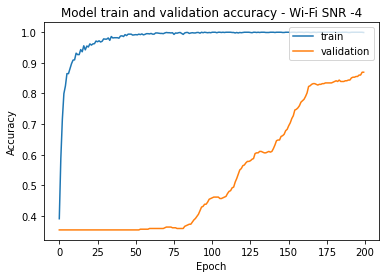

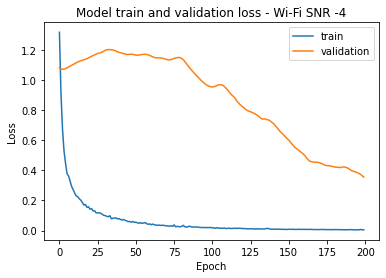


Training SNR = -4 Data on a pre-trained All SNR model

Epoch 1/200
2/2 [==============================] - 1s 330ms/step - loss: 0.3226 - accuracy: 0.8765 - val_loss: 1.9909 - val_accuracy: 0.6200
Epoch 2/200
2/2 [==============================] - 0s 27ms/step - loss: 0.2125 - accuracy: 0.9237 - val_loss: 3.6230 - val_accuracy: 0.5012
Epoch 3/200
2/2 [==============================] - 0s 26ms/step - loss: 0.1716 - accuracy: 0.9238 - val_loss: 5.3018 - val_accuracy: 0.4172
Epoch 4/200
2/2 [==============================] - 0s 29ms/step - loss: 0.1279 - accuracy: 0.9513 - val_loss: 6.7756 - val_accuracy: 0.3753
Epoch 5/200
2/2 [==============================] - 0s 32ms/step - loss: 0.1149 - accuracy: 0.9543 - val_loss: 7.9963 - val_accuracy: 0.3590
Epoch 6/200
2/2 [==============================] - 0s 33ms/step - loss: 0.1042 - accuracy: 0.9633 - val_loss: 8.9711 - val_accuracy: 0.3566
Epoch 7/200
2/2 [==============================] - 0s 37ms/step - loss: 0.0856 - accuracy: 0.9667 - val

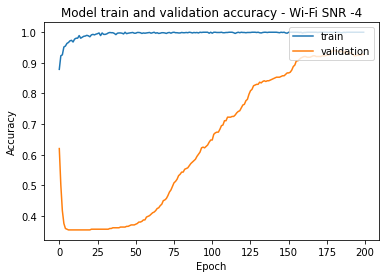

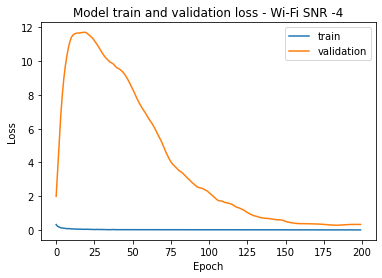


Training SNR = -4 Data on a pre-trained High SNR model

Epoch 1/200
2/2 [==============================] - 1s 338ms/step - loss: 0.3397 - accuracy: 0.9096 - val_loss: 3.5075 - val_accuracy: 0.5478
Epoch 2/200
2/2 [==============================] - 0s 26ms/step - loss: 0.2473 - accuracy: 0.9358 - val_loss: 3.5283 - val_accuracy: 0.5734
Epoch 3/200
2/2 [==============================] - 0s 33ms/step - loss: 0.2200 - accuracy: 0.9312 - val_loss: 3.5138 - val_accuracy: 0.5828
Epoch 4/200
2/2 [==============================] - 0s 29ms/step - loss: 0.1510 - accuracy: 0.9473 - val_loss: 3.4913 - val_accuracy: 0.5851
Epoch 5/200
2/2 [==============================] - 0s 29ms/step - loss: 0.1334 - accuracy: 0.9565 - val_loss: 3.4685 - val_accuracy: 0.5781
Epoch 6/200
2/2 [==============================] - 0s 30ms/step - loss: 0.1190 - accuracy: 0.9564 - val_loss: 3.4371 - val_accuracy: 0.5688
Epoch 7/200
2/2 [==============================] - 0s 32ms/step - loss: 0.1004 - accuracy: 0.9676 - va

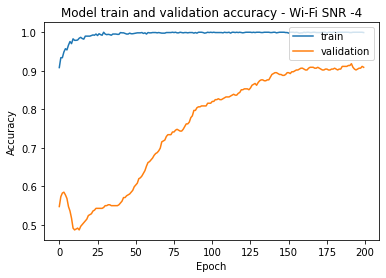

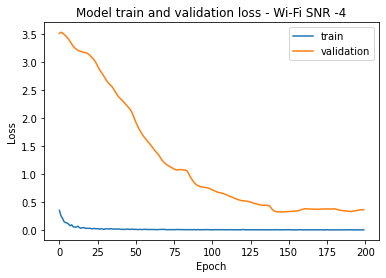


Training SNR = -4 Data on a pre-trained Low SNR model

Epoch 1/200
2/2 [==============================] - 1s 354ms/step - loss: 0.3476 - accuracy: 0.9136 - val_loss: 3.2405 - val_accuracy: 0.4196
Epoch 2/200
2/2 [==============================] - 0s 32ms/step - loss: 0.2635 - accuracy: 0.9307 - val_loss: 3.2555 - val_accuracy: 0.4149
Epoch 3/200
2/2 [==============================] - 0s 29ms/step - loss: 0.1765 - accuracy: 0.9482 - val_loss: 3.2420 - val_accuracy: 0.4103
Epoch 4/200
2/2 [==============================] - 0s 31ms/step - loss: 0.1614 - accuracy: 0.9484 - val_loss: 3.1786 - val_accuracy: 0.4126
Epoch 5/200
2/2 [==============================] - 0s 25ms/step - loss: 0.1373 - accuracy: 0.9598 - val_loss: 3.0953 - val_accuracy: 0.4103
Epoch 6/200
2/2 [==============================] - 0s 34ms/step - loss: 0.1304 - accuracy: 0.9616 - val_loss: 2.9715 - val_accuracy: 0.4126
Epoch 7/200
2/2 [==============================] - 0s 30ms/step - loss: 0.1003 - accuracy: 0.9656 - val

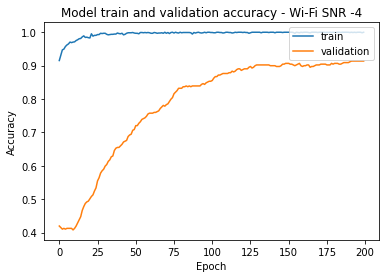

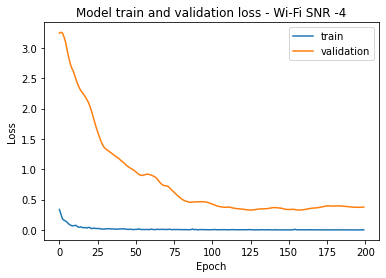


Score of SNR on All SNR model without Transfer Learning -2 = 83.68298411369324
Score of SNR on High SNR model without Transfer Learning -2 = 59.90676283836365
Score of SNR on low SNR model without Transfer Learning -2 = 43.35664212703705

Training SNR = -2 Data

Epoch 1/200
2/2 [==============================] - 1s 342ms/step - loss: 1.2779 - accuracy: 0.3929 - val_loss: 1.0834 - val_accuracy: 0.3263
Epoch 2/200
2/2 [==============================] - 0s 30ms/step - loss: 0.8056 - accuracy: 0.6607 - val_loss: 1.0774 - val_accuracy: 0.3263
Epoch 3/200
2/2 [==============================] - 0s 31ms/step - loss: 0.5750 - accuracy: 0.7614 - val_loss: 1.0757 - val_accuracy: 0.3263
Epoch 4/200
2/2 [==============================] - 0s 26ms/step - loss: 0.4550 - accuracy: 0.8190 - val_loss: 1.0768 - val_accuracy: 0.3263
Epoch 5/200
2/2 [==============================] - 0s 33ms/step - loss: 0.3727 - accuracy: 0.8604 - val_loss: 1.0794 - val_accuracy: 0.3263
Epoch 6/200
2/2 [==================

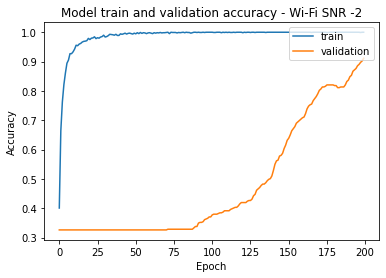

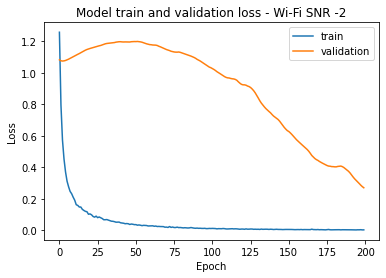


Training SNR = -2 Data on a pre-trained All SNR model

Epoch 1/200
2/2 [==============================] - 1s 350ms/step - loss: 0.1673 - accuracy: 0.9367 - val_loss: 1.7814 - val_accuracy: 0.6154
Epoch 2/200
2/2 [==============================] - 0s 29ms/step - loss: 0.1059 - accuracy: 0.9584 - val_loss: 3.4945 - val_accuracy: 0.4872
Epoch 3/200
2/2 [==============================] - 0s 33ms/step - loss: 0.0906 - accuracy: 0.9645 - val_loss: 5.1263 - val_accuracy: 0.3846
Epoch 4/200
2/2 [==============================] - 0s 28ms/step - loss: 0.0679 - accuracy: 0.9765 - val_loss: 6.4998 - val_accuracy: 0.3403
Epoch 5/200
2/2 [==============================] - 0s 36ms/step - loss: 0.0518 - accuracy: 0.9875 - val_loss: 7.6452 - val_accuracy: 0.3310
Epoch 6/200
2/2 [==============================] - 0s 43ms/step - loss: 0.0375 - accuracy: 0.9878 - val_loss: 8.5282 - val_accuracy: 0.3287
Epoch 7/200
2/2 [==============================] - 0s 42ms/step - loss: 0.0412 - accuracy: 0.9868 - val

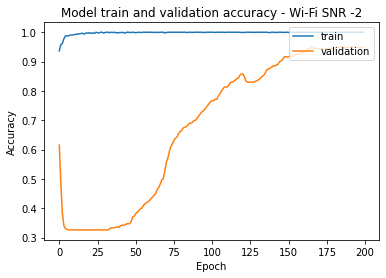

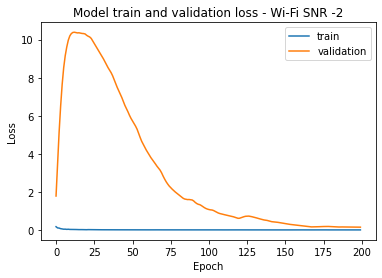


Training SNR = -2 Data on a pre-trained High SNR model

Epoch 1/200
2/2 [==============================] - 1s 342ms/step - loss: 0.1443 - accuracy: 0.9684 - val_loss: 3.3458 - val_accuracy: 0.6014
Epoch 2/200
2/2 [==============================] - 0s 33ms/step - loss: 0.0726 - accuracy: 0.9785 - val_loss: 3.4338 - val_accuracy: 0.6061
Epoch 3/200
2/2 [==============================] - 0s 33ms/step - loss: 0.0598 - accuracy: 0.9826 - val_loss: 3.4962 - val_accuracy: 0.6154
Epoch 4/200
2/2 [==============================] - 0s 30ms/step - loss: 0.0327 - accuracy: 0.9878 - val_loss: 3.5327 - val_accuracy: 0.6270
Epoch 5/200
2/2 [==============================] - 0s 32ms/step - loss: 0.0330 - accuracy: 0.9888 - val_loss: 3.5545 - val_accuracy: 0.6270
Epoch 6/200
2/2 [==============================] - 0s 30ms/step - loss: 0.0203 - accuracy: 0.9888 - val_loss: 3.5573 - val_accuracy: 0.6247
Epoch 7/200
2/2 [==============================] - 0s 30ms/step - loss: 0.0203 - accuracy: 0.9919 - va

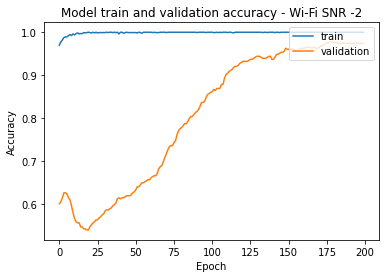

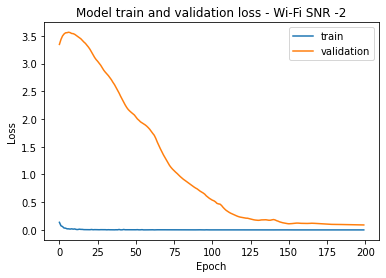


Training SNR = -2 Data on a pre-trained Low SNR model

Epoch 1/200
2/2 [==============================] - 1s 353ms/step - loss: 0.1417 - accuracy: 0.9639 - val_loss: 3.0261 - val_accuracy: 0.4685
Epoch 2/200
2/2 [==============================] - 0s 30ms/step - loss: 0.0896 - accuracy: 0.9711 - val_loss: 3.0100 - val_accuracy: 0.4895
Epoch 3/200
2/2 [==============================] - 0s 30ms/step - loss: 0.0678 - accuracy: 0.9802 - val_loss: 2.9492 - val_accuracy: 0.5175
Epoch 4/200
2/2 [==============================] - 0s 31ms/step - loss: 0.0528 - accuracy: 0.9831 - val_loss: 2.8521 - val_accuracy: 0.5524
Epoch 5/200
2/2 [==============================] - 0s 38ms/step - loss: 0.0461 - accuracy: 0.9833 - val_loss: 2.7387 - val_accuracy: 0.5851
Epoch 6/200
2/2 [==============================] - 0s 30ms/step - loss: 0.0308 - accuracy: 0.9909 - val_loss: 2.6360 - val_accuracy: 0.6061
Epoch 7/200
2/2 [==============================] - 0s 29ms/step - loss: 0.0260 - accuracy: 0.9918 - val

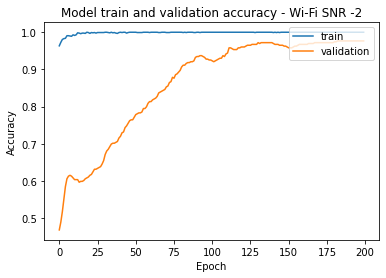

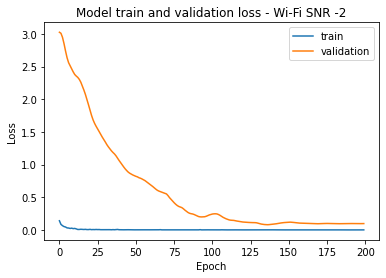

In [ ]:
for i in range(5, 10):

  x_data_mag = np.absolute(x_data_fft_wifi[:,:,:,:,0] + 1j*x_data_fft_wifi[:,:,:,:,1]) 
  x_data_fft_curr = np.reshape(x_data_mag[:,i], (x_dim[0]*x_dim[2], x_dim[3]))
  
  y_data_fft_curr = to_categorical(y_labels_wifi[:,i].flatten())

  X_train_curr, X_test_valid_curr, Y_train_curr, Y_test_valid_curr = train_test_split(x_data_fft_curr, y_data_fft_curr, test_size=0.4)
  X_validation_curr, X_test_curr, Y_validation_curr, Y_test_curr = train_test_split(X_test_valid_curr, Y_test_valid_curr, test_size=0.5)

  Testing(X_test_curr, Y_test_curr, i)
  train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_all_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_high_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_low_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)


Score of SNR on All SNR model without Transfer Learning 0 = 90.67599177360535
Score of SNR on High SNR model without Transfer Learning 0 = 66.20046496391296
Score of SNR on low SNR model without Transfer Learning 0 = 50.58274865150452

Training SNR = 0 Data

Epoch 1/200
2/2 [==============================] - 1s 341ms/step - loss: 1.3103 - accuracy: 0.3656 - val_loss: 1.0717 - val_accuracy: 0.3660
Epoch 2/200
2/2 [==============================] - 0s 22ms/step - loss: 0.7594 - accuracy: 0.6747 - val_loss: 1.0558 - val_accuracy: 0.3660
Epoch 3/200
2/2 [==============================] - 0s 20ms/step - loss: 0.5183 - accuracy: 0.7850 - val_loss: 1.0449 - val_accuracy: 0.3660
Epoch 4/200
2/2 [==============================] - 0s 20ms/step - loss: 0.3662 - accuracy: 0.8744 - val_loss: 1.0378 - val_accuracy: 0.3660
Epoch 5/200
2/2 [==============================] - 0s 19ms/step - loss: 0.3232 - accuracy: 0.8926 - val_loss: 1.0330 - val_accuracy: 0.3660
Epoch 6/200
2/2 [======================

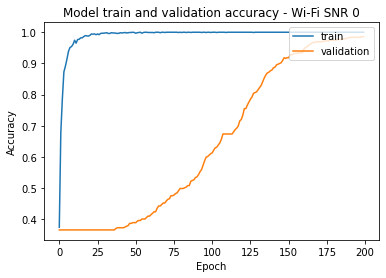

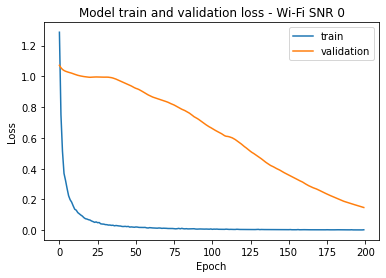


Score of SNR on All SNR model without Transfer Learning 2 = 93.00699234008789
Score of SNR on High SNR model without Transfer Learning 2 = 68.7645673751831
Score of SNR on low SNR model without Transfer Learning 2 = 55.47785758972168

Training SNR = 2 Data

Epoch 1/200
2/2 [==============================] - 1s 342ms/step - loss: 1.4536 - accuracy: 0.2958 - val_loss: 1.0845 - val_accuracy: 0.3520
Epoch 2/200
2/2 [==============================] - 0s 24ms/step - loss: 0.8144 - accuracy: 0.6224 - val_loss: 1.0703 - val_accuracy: 0.3427
Epoch 3/200
2/2 [==============================] - 0s 21ms/step - loss: 0.5502 - accuracy: 0.7801 - val_loss: 1.0622 - val_accuracy: 0.3427
Epoch 4/200
2/2 [==============================] - 0s 20ms/step - loss: 0.3757 - accuracy: 0.8677 - val_loss: 1.0587 - val_accuracy: 0.3427
Epoch 5/200
2/2 [==============================] - 0s 21ms/step - loss: 0.3153 - accuracy: 0.8923 - val_loss: 1.0574 - val_accuracy: 0.3427
Epoch 6/200
2/2 [=======================

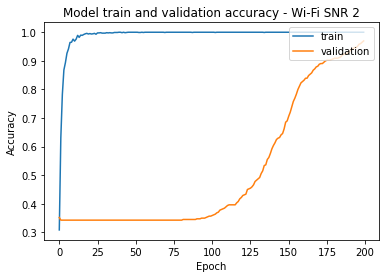

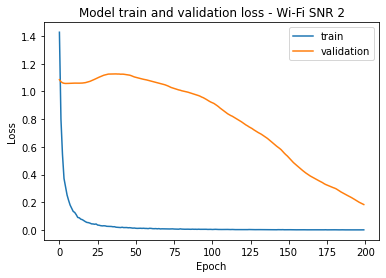


Score of SNR on All SNR model without Transfer Learning 4 = 98.13519716262817
Score of SNR on High SNR model without Transfer Learning 4 = 69.69696879386902
Score of SNR on low SNR model without Transfer Learning 4 = 57.575756311416626

Training SNR = 4 Data

Epoch 1/200
2/2 [==============================] - 1s 326ms/step - loss: 1.3552 - accuracy: 0.3061 - val_loss: 1.0797 - val_accuracy: 0.3520
Epoch 2/200
2/2 [==============================] - 0s 24ms/step - loss: 0.7602 - accuracy: 0.6625 - val_loss: 1.0607 - val_accuracy: 0.3473
Epoch 3/200
2/2 [==============================] - 0s 21ms/step - loss: 0.4944 - accuracy: 0.7985 - val_loss: 1.0492 - val_accuracy: 0.3473
Epoch 4/200
2/2 [==============================] - 0s 22ms/step - loss: 0.3619 - accuracy: 0.8773 - val_loss: 1.0425 - val_accuracy: 0.3473
Epoch 5/200
2/2 [==============================] - 0s 22ms/step - loss: 0.2850 - accuracy: 0.9144 - val_loss: 1.0387 - val_accuracy: 0.3473
Epoch 6/200
2/2 [=====================

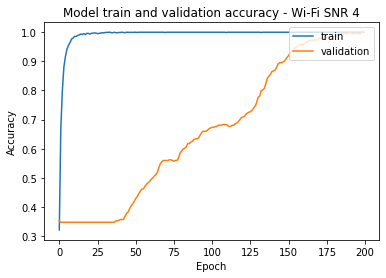

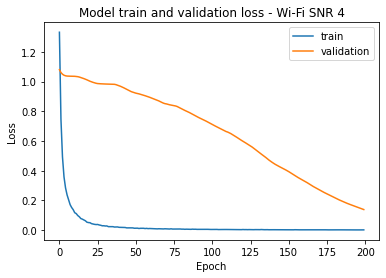


Score of SNR on All SNR model without Transfer Learning 6 = 97.90209531784058
Score of SNR on High SNR model without Transfer Learning 6 = 71.32866978645325
Score of SNR on low SNR model without Transfer Learning 6 = 63.170164823532104

Training SNR = 6 Data

Epoch 1/200
2/2 [==============================] - 1s 343ms/step - loss: 1.2282 - accuracy: 0.3711 - val_loss: 1.0663 - val_accuracy: 0.3823
Epoch 2/200
2/2 [==============================] - 0s 23ms/step - loss: 0.6476 - accuracy: 0.7297 - val_loss: 1.0453 - val_accuracy: 0.3823
Epoch 3/200
2/2 [==============================] - 0s 22ms/step - loss: 0.4093 - accuracy: 0.8763 - val_loss: 1.0290 - val_accuracy: 0.3823
Epoch 4/200
2/2 [==============================] - 0s 22ms/step - loss: 0.3064 - accuracy: 0.9172 - val_loss: 1.0166 - val_accuracy: 0.3823
Epoch 5/200
2/2 [==============================] - 0s 21ms/step - loss: 0.2396 - accuracy: 0.9504 - val_loss: 1.0069 - val_accuracy: 0.3823
Epoch 6/200
2/2 [=====================

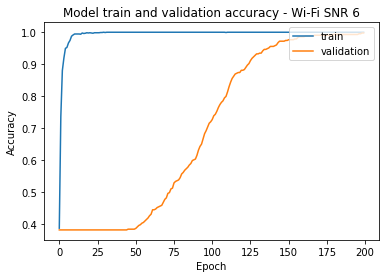

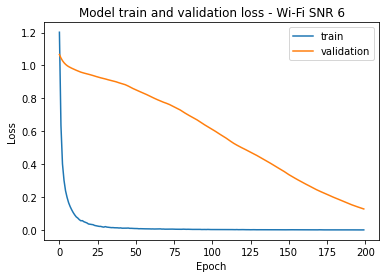


Score of SNR on All SNR model without Transfer Learning 8 = 98.60140085220337
Score of SNR on High SNR model without Transfer Learning 8 = 64.56876397132874
Score of SNR on low SNR model without Transfer Learning 8 = 60.13985872268677

Training SNR = 8 Data

Epoch 1/200
2/2 [==============================] - 1s 327ms/step - loss: 1.3388 - accuracy: 0.3774 - val_loss: 1.0679 - val_accuracy: 0.3007
Epoch 2/200
2/2 [==============================] - 0s 26ms/step - loss: 0.6186 - accuracy: 0.7365 - val_loss: 1.0561 - val_accuracy: 0.3007
Epoch 3/200
2/2 [==============================] - 0s 21ms/step - loss: 0.3693 - accuracy: 0.8758 - val_loss: 1.0513 - val_accuracy: 0.3007
Epoch 4/200
2/2 [==============================] - 0s 24ms/step - loss: 0.2776 - accuracy: 0.9202 - val_loss: 1.0512 - val_accuracy: 0.3007
Epoch 5/200
2/2 [==============================] - 0s 40ms/step - loss: 0.2007 - accuracy: 0.9494 - val_loss: 1.0537 - val_accuracy: 0.3007
Epoch 6/200
2/2 [======================

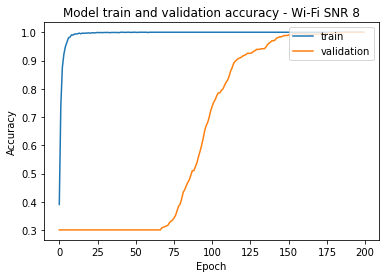

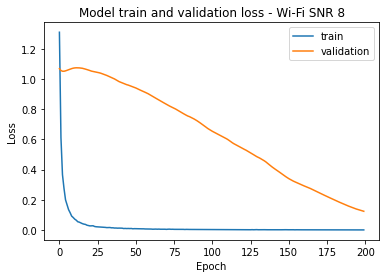

In [ ]:
for i in range(10, 15):

  x_data_mag = np.absolute(x_data_fft_wifi[:,:,:,:,0] + 1j*x_data_fft_wifi[:,:,:,:,1]) 
  x_data_fft_curr = np.reshape(x_data_mag[:,i], (x_dim[0]*x_dim[2], x_dim[3]))
  
  y_data_fft_curr = to_categorical(y_labels_wifi[:,i].flatten())

  X_train_curr, X_test_valid_curr, Y_train_curr, Y_test_valid_curr = train_test_split(x_data_fft_curr, y_data_fft_curr, test_size=0.4)
  X_validation_curr, X_test_curr, Y_validation_curr, Y_test_curr = train_test_split(X_test_valid_curr, Y_test_valid_curr, test_size=0.5)

  Testing(X_test_curr, Y_test_curr, i)
  train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)


Score of SNR on All SNR model without Transfer Learning 10 = 98.13519716262817
Score of SNR on High SNR model without Transfer Learning 10 = 71.09557390213013
Score of SNR on low SNR model without Transfer Learning 10 = 64.10256624221802

Training SNR = 10 Data

Epoch 1/200
2/2 [==============================] - 1s 346ms/step - loss: 1.0438 - accuracy: 0.4939 - val_loss: 1.0610 - val_accuracy: 0.3310
Epoch 2/200
2/2 [==============================] - 0s 22ms/step - loss: 0.5230 - accuracy: 0.7874 - val_loss: 1.0451 - val_accuracy: 0.3263
Epoch 3/200
2/2 [==============================] - 0s 21ms/step - loss: 0.3308 - accuracy: 0.8806 - val_loss: 1.0376 - val_accuracy: 0.3263
Epoch 4/200
2/2 [==============================] - 0s 21ms/step - loss: 0.2411 - accuracy: 0.9364 - val_loss: 1.0348 - val_accuracy: 0.3263
Epoch 5/200
2/2 [==============================] - 0s 21ms/step - loss: 0.1818 - accuracy: 0.9560 - val_loss: 1.0342 - val_accuracy: 0.3263
Epoch 6/200
2/2 [==================

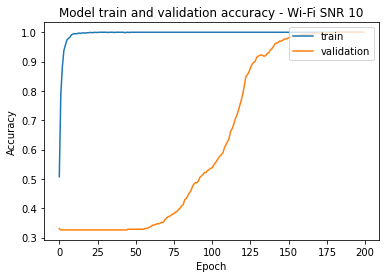

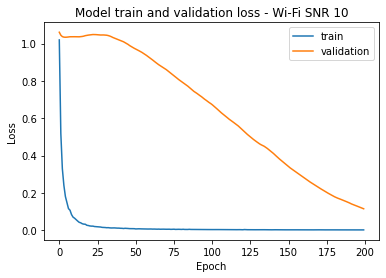


Score of SNR on All SNR model without Transfer Learning 12 = 99.06759858131409
Score of SNR on High SNR model without Transfer Learning 12 = 65.73426723480225
Score of SNR on low SNR model without Transfer Learning 12 = 62.23776340484619

Training SNR = 12 Data

Epoch 1/200
2/2 [==============================] - 2s 340ms/step - loss: 1.3147 - accuracy: 0.3582 - val_loss: 1.0731 - val_accuracy: 0.3427
Epoch 2/200
2/2 [==============================] - 0s 21ms/step - loss: 0.6698 - accuracy: 0.7287 - val_loss: 1.0548 - val_accuracy: 0.3427
Epoch 3/200
2/2 [==============================] - 0s 21ms/step - loss: 0.4122 - accuracy: 0.8664 - val_loss: 1.0419 - val_accuracy: 0.3427
Epoch 4/200
2/2 [==============================] - 0s 23ms/step - loss: 0.2896 - accuracy: 0.9249 - val_loss: 1.0326 - val_accuracy: 0.3427
Epoch 5/200
2/2 [==============================] - 0s 21ms/step - loss: 0.2303 - accuracy: 0.9602 - val_loss: 1.0259 - val_accuracy: 0.3427
Epoch 6/200
2/2 [==================

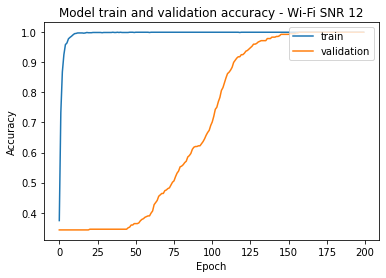

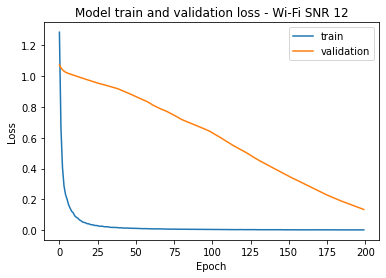


Score of SNR on All SNR model without Transfer Learning 14 = 99.30070042610168
Score of SNR on High SNR model without Transfer Learning 14 = 66.89976453781128
Score of SNR on low SNR model without Transfer Learning 14 = 64.80186581611633

Training SNR = 14 Data

Epoch 1/200
2/2 [==============================] - 1s 332ms/step - loss: 1.4641 - accuracy: 0.3200 - val_loss: 1.0819 - val_accuracy: 0.3100
Epoch 2/200
2/2 [==============================] - 0s 25ms/step - loss: 0.7113 - accuracy: 0.6991 - val_loss: 1.0625 - val_accuracy: 0.3100
Epoch 3/200
2/2 [==============================] - 0s 22ms/step - loss: 0.4072 - accuracy: 0.8614 - val_loss: 1.0462 - val_accuracy: 0.3100
Epoch 4/200
2/2 [==============================] - 0s 23ms/step - loss: 0.2817 - accuracy: 0.9342 - val_loss: 1.0318 - val_accuracy: 0.3100
Epoch 5/200
2/2 [==============================] - 0s 26ms/step - loss: 0.2238 - accuracy: 0.9565 - val_loss: 1.0189 - val_accuracy: 0.3100
Epoch 6/200
2/2 [==================

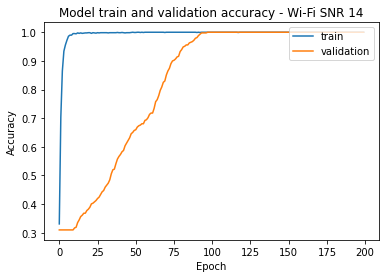

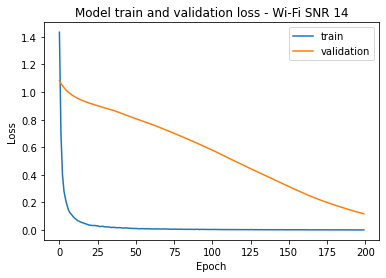


Score of SNR on All SNR model without Transfer Learning 16 = 99.53380227088928
Score of SNR on High SNR model without Transfer Learning 16 = 67.13286638259888
Score of SNR on low SNR model without Transfer Learning 16 = 65.50116539001465

Training SNR = 16 Data

Epoch 1/200
2/2 [==============================] - 1s 343ms/step - loss: 1.2216 - accuracy: 0.3795 - val_loss: 1.0648 - val_accuracy: 0.3613
Epoch 2/200
2/2 [==============================] - 0s 23ms/step - loss: 0.6033 - accuracy: 0.7434 - val_loss: 1.0420 - val_accuracy: 0.3520
Epoch 3/200
2/2 [==============================] - 0s 23ms/step - loss: 0.3821 - accuracy: 0.8651 - val_loss: 1.0247 - val_accuracy: 0.3520
Epoch 4/200
2/2 [==============================] - 0s 25ms/step - loss: 0.2717 - accuracy: 0.9177 - val_loss: 1.0120 - val_accuracy: 0.3520
Epoch 5/200
2/2 [==============================] - 0s 23ms/step - loss: 0.2127 - accuracy: 0.9517 - val_loss: 1.0025 - val_accuracy: 0.3520
Epoch 6/200
2/2 [==================

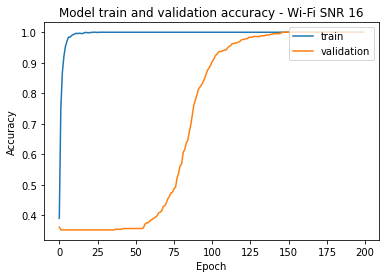

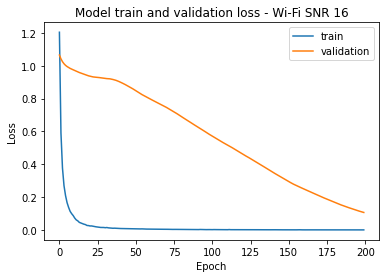


Score of SNR on All SNR model without Transfer Learning 18 = 100.0
Score of SNR on High SNR model without Transfer Learning 18 = 66.66666865348816
Score of SNR on low SNR model without Transfer Learning 18 = 62.47086524963379

Training SNR = 18 Data

Epoch 1/200
2/2 [==============================] - 1s 376ms/step - loss: 1.3134 - accuracy: 0.3314 - val_loss: 1.0700 - val_accuracy: 0.3893
Epoch 2/200
2/2 [==============================] - 0s 29ms/step - loss: 0.6776 - accuracy: 0.7095 - val_loss: 1.0494 - val_accuracy: 0.3357
Epoch 3/200
2/2 [==============================] - 0s 28ms/step - loss: 0.4061 - accuracy: 0.8630 - val_loss: 1.0333 - val_accuracy: 0.3357
Epoch 4/200
2/2 [==============================] - 0s 25ms/step - loss: 0.2930 - accuracy: 0.9146 - val_loss: 1.0217 - val_accuracy: 0.3357
Epoch 5/200
2/2 [==============================] - 0s 44ms/step - loss: 0.2264 - accuracy: 0.9467 - val_loss: 1.0137 - val_accuracy: 0.3357
Epoch 6/200
2/2 [==============================

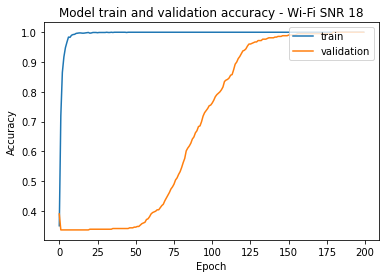

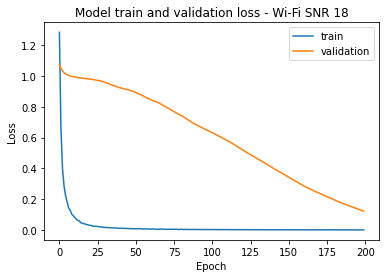


Score of SNR on All SNR model without Transfer Learning 20 = 99.53380227088928
Score of SNR on High SNR model without Transfer Learning 20 = 66.20046496391296
Score of SNR on low SNR model without Transfer Learning 20 = 64.33566212654114

Training SNR = 20 Data

Epoch 1/200
2/2 [==============================] - 1s 330ms/step - loss: 1.2236 - accuracy: 0.4082 - val_loss: 1.0726 - val_accuracy: 0.2984
Epoch 2/200
2/2 [==============================] - 0s 25ms/step - loss: 0.6143 - accuracy: 0.7559 - val_loss: 1.0600 - val_accuracy: 0.2821
Epoch 3/200
2/2 [==============================] - 0s 24ms/step - loss: 0.3702 - accuracy: 0.8771 - val_loss: 1.0529 - val_accuracy: 0.2821
Epoch 4/200
2/2 [==============================] - 0s 25ms/step - loss: 0.2750 - accuracy: 0.9188 - val_loss: 1.0501 - val_accuracy: 0.2821
Epoch 5/200
2/2 [==============================] - 0s 24ms/step - loss: 0.2037 - accuracy: 0.9575 - val_loss: 1.0500 - val_accuracy: 0.2821
Epoch 6/200
2/2 [==================

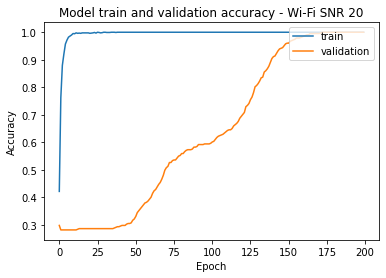

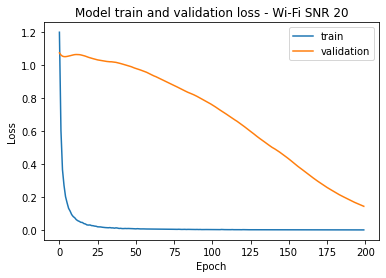

In [ ]:
for i in range(15, 21):

  x_data_mag = np.absolute(x_data_fft_wifi[:,:,:,:,0] + 1j*x_data_fft_wifi[:,:,:,:,1]) 
  x_data_fft_curr = np.reshape(x_data_mag[:,i], (x_dim[0]*x_dim[2], x_dim[3]))
  
  y_data_fft_curr = to_categorical(y_labels_wifi[:,i].flatten())

  X_train_curr, X_test_valid_curr, Y_train_curr, Y_test_valid_curr = train_test_split(x_data_fft_curr, y_data_fft_curr, test_size=0.4)
  X_validation_curr, X_test_curr, Y_validation_curr, Y_test_curr = train_test_split(X_test_valid_curr, Y_test_valid_curr, test_size=0.5)

  Testing(X_test_curr, Y_test_curr, i)
  train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)

# Zigbee

## Whole data

In [ ]:
x_data_fft_zigbee = x_data_fft_data[13:15]
y_labels_zigbee = y_labels_data[13:15]

print(x_data_fft_zigbee.shape)
print(y_labels_zigbee.shape)

(2, 21, 715, 128, 2)
(2, 21, 715)


In [ ]:
x_dim = x_data_fft_zigbee.shape
total_num_snapshots = x_dim[0]*x_dim[1]*x_dim[2]
num_snapshots_per_tech = x_dim[1]*x_dim[2]
num_tech = x_dim[0]
num_samples = x_dim[3]
print(num_snapshots_per_tech)

15015


In [ ]:
from sklearn.preprocessing import MinMaxScaler

# Bin wise scalers for FFT data from sklearn
scaler_01 = MinMaxScaler(feature_range=(0,1))

x_data_fft_all_SNR_1d = np.reshape(x_data_fft_zigbee, (total_num_snapshots, num_samples*x_dim[4]))
fft_data_complex = np.reshape(x_data_fft_all_SNR_1d.flatten()[::2] + 1j*x_data_fft_all_SNR_1d.flatten()[1::2], (total_num_snapshots, num_samples))
x_data_fft_all_SNR_1d = scaler_01.fit_transform(np.absolute(fft_data_complex))

In [ ]:
from keras.utils.np_utils import to_categorical

y_labels_all_SNR = y_labels_zigbee.flatten()
y_labels_all_SNR = y_labels_all_SNR - 13
y_labels_one_hot_all_SNR = to_categorical(y_labels_all_SNR)

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test_valid, Y_train, Y_test_valid = train_test_split(x_data_fft_all_SNR_1d, y_labels_one_hot_all_SNR, test_size=0.4)
X_validation, X_test, Y_validation, Y_test = train_test_split(X_test_valid, Y_test_valid, test_size=0.5)

In [ ]:
from keras.callbacks import EarlyStopping
ES = EarlyStopping(monitor = 'val_accuracy', mode = 'max', min_delta = 0.00001, patience = 200, verbose = 1)

import logging
logging.disable(logging.WARNING)

Epoch 1/200
18/18 [==============================] - 2s 32ms/step - loss: 0.3621 - accuracy: 0.8335 - val_loss: 0.4082 - val_accuracy: 0.9710
Epoch 2/200
18/18 [==============================] - 0s 9ms/step - loss: 0.0803 - accuracy: 0.9684 - val_loss: 0.3300 - val_accuracy: 0.9754
Epoch 3/200
18/18 [==============================] - 0s 8ms/step - loss: 0.0675 - accuracy: 0.9740 - val_loss: 0.3000 - val_accuracy: 0.9707
Epoch 4/200
18/18 [==============================] - 0s 8ms/step - loss: 0.0644 - accuracy: 0.9743 - val_loss: 0.2754 - val_accuracy: 0.9755
Epoch 5/200
18/18 [==============================] - 0s 9ms/step - loss: 0.0621 - accuracy: 0.9757 - val_loss: 0.2563 - val_accuracy: 0.9697
Epoch 6/200
18/18 [==============================] - 0s 8ms/step - loss: 0.0601 - accuracy: 0.9767 - val_loss: 0.2263 - val_accuracy: 0.9749
Epoch 7/200
18/18 [==============================] - 0s 8ms/step - loss: 0.0539 - accuracy: 0.9787 - val_loss: 0.2033 - val_accuracy: 0.9774
Epoch 8/200


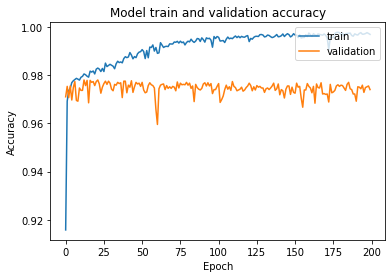

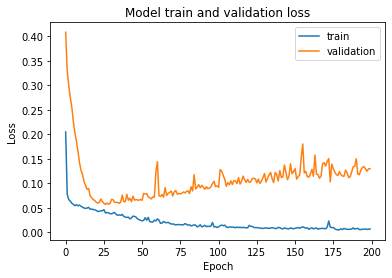


Training Accuracy Array:  [0.9157509207725525, 0.9691974520683289, 0.9736374616622925, 0.9745810031890869, 0.9769119620323181, 0.9776889681816101, 0.9781884551048279, 0.9786880016326904, 0.9783549904823303, 0.9779664874076843, 0.9791319966316223, 0.9795204997062683, 0.9805194735527039, 0.9801864624023438, 0.9795759916305542, 0.9791874885559082, 0.9816849827766418, 0.9812964797019958, 0.9817404747009277, 0.9805194735527039, 0.9825174808502197, 0.9829614758491516, 0.9825174808502197, 0.9815185070037842, 0.982795000076294, 0.9815185070037842, 0.9850149750709534, 0.9835720062255859, 0.9840160012245178, 0.9845154881477356, 0.9841269850730896, 0.9837384819984436, 0.9826839566230774, 0.9847374558448792, 0.9857919812202454, 0.9852370023727417, 0.9855144619941711, 0.9851259589195251, 0.9869019985198975, 0.9876790046691895, 0.9872905015945435, 0.9875679612159729, 0.9893994927406311, 0.9883449673652649, 0.9867910146713257, 0.9877344965934753, 0.9872905015945435, 0.9889000058174133, 0.98956596851

In [ ]:
fcn_learning = fcn_model_zigbee()

epochs = 200
batch_size = 1024

history = fcn_learning.fit(X_train, Y_train, epochs=epochs, batch_size=batch_size,  validation_data = (X_validation, Y_validation), shuffle=True, callbacks=[ES])

score = fcn_learning.evaluate(X_test, Y_test, verbose=0)
print('\nEvaluating on Test data : Score of SNR  = ' + str(score[1]*100) +'\n')

summarize_model(history)
fcn_learning.save("/gdrive/My Drive/Signal Identification Model FCN/Zigbee/fcnFFTdata_allSNR_zigbee.tf")

print("\nTraining Accuracy Array: ", history.history['accuracy'])
print("\nValidation Accuracy Array: ", history.history['val_accuracy'])

## High SNR

In [ ]:
x_data_fft_high_SNR_zigbee = x_data_fft_data[13:15,10:21]
y_labels_high_SNR_zigbee = y_labels_data[13:15,10:21]

print(x_data_fft_high_SNR_zigbee.shape)
print(y_labels_high_SNR_zigbee.shape)

(2, 11, 715, 128, 2)
(2, 11, 715)


In [ ]:
x_dim = x_data_fft_high_SNR_zigbee.shape
total_num_snapshots = x_dim[0]*x_dim[1]*x_dim[2]
num_snapshots_per_tech = x_dim[1]*x_dim[2]
num_tech = x_dim[0]
num_samples = x_dim[3]
print(num_snapshots_per_tech)

7865


In [ ]:
from sklearn.preprocessing import MinMaxScaler

# Bin wise scalers for FFT data from sklearn
scaler_01 = MinMaxScaler(feature_range=(0,1))

x_data_fft_high_SNR_zigbee_1d = np.reshape(x_data_fft_high_SNR_zigbee, (total_num_snapshots, num_samples*x_dim[4]))
fft_data_complex = np.reshape(x_data_fft_high_SNR_zigbee_1d.flatten()[::2] + 1j*x_data_fft_high_SNR_zigbee_1d.flatten()[1::2], (total_num_snapshots, num_samples))
x_data_fft_high_SNR_zigbee_1d = scaler_01.fit_transform(np.absolute(fft_data_complex))

In [ ]:
from keras.utils.np_utils import to_categorical

y_labels_high_SNR_zigbee = y_labels_high_SNR_zigbee.flatten()
y_labels_high_SNR_zigbee = y_labels_high_SNR_zigbee - 13
y_labels_one_hot_high_SNR_zigbee = to_categorical(y_labels_high_SNR_zigbee)

In [ ]:
from keras.callbacks import EarlyStopping
ES = EarlyStopping(monitor = 'val_accuracy', mode = 'max', min_delta = 0.00001, patience = 200, verbose = 1)

import logging
logging.disable(logging.WARNING)

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test_valid, Y_train, Y_test_valid = train_test_split(x_data_fft_high_SNR_zigbee_1d, y_labels_one_hot_high_SNR_zigbee, test_size=0.4)
X_validation, X_test, Y_validation, Y_test = train_test_split(X_test_valid, Y_test_valid, test_size=0.5)

Epoch 1/200
10/10 [==============================] - 2s 44ms/step - loss: 0.2304 - accuracy: 0.8955 - val_loss: 0.1605 - val_accuracy: 0.9971
Epoch 2/200
10/10 [==============================] - 0s 7ms/step - loss: 0.0077 - accuracy: 0.9967 - val_loss: 0.0941 - val_accuracy: 0.9968
Epoch 3/200
10/10 [==============================] - 0s 8ms/step - loss: 0.0057 - accuracy: 0.9980 - val_loss: 0.0759 - val_accuracy: 0.9965
Epoch 4/200
10/10 [==============================] - 0s 6ms/step - loss: 0.0051 - accuracy: 0.9981 - val_loss: 0.0695 - val_accuracy: 0.9971
Epoch 5/200
10/10 [==============================] - 0s 7ms/step - loss: 0.0051 - accuracy: 0.9977 - val_loss: 0.0660 - val_accuracy: 0.9968
Epoch 6/200
10/10 [==============================] - 0s 7ms/step - loss: 0.0046 - accuracy: 0.9977 - val_loss: 0.0622 - val_accuracy: 0.9968
Epoch 7/200
10/10 [==============================] - 0s 6ms/step - loss: 0.0043 - accuracy: 0.9978 - val_loss: 0.0582 - val_accuracy: 0.9968
Epoch 8/200


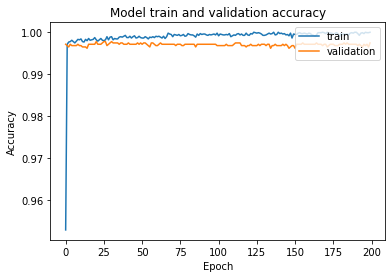

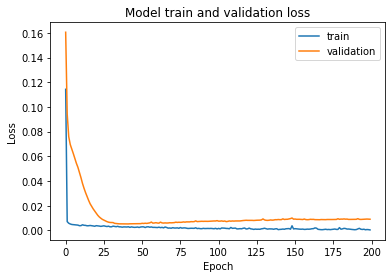


Training Accuracy Array:  [0.9529561400413513, 0.9971392154693604, 0.997668981552124, 0.9977749586105347, 0.9980928301811218, 0.9977749586105347, 0.9974570870399475, 0.9978809356689453, 0.9983047246932983, 0.9981987476348877, 0.998410701751709, 0.9977749586105347, 0.997668981552124, 0.9983047246932983, 0.9979868531227112, 0.9985166192054749, 0.9980928301811218, 0.9981987476348877, 0.9983047246932983, 0.9987285733222961, 0.9981987476348877, 0.9978809356689453, 0.9981987476348877, 0.9985166192054749, 0.9980928301811218, 0.9979868531227112, 0.9981987476348877, 0.9989404678344727, 0.9981987476348877, 0.998834490776062, 0.9989404678344727, 0.9981987476348877, 0.9985166192054749, 0.998410701751709, 0.998410701751709, 0.998834490776062, 0.9989404678344727, 0.998834490776062, 0.9990463852882385, 0.9992583394050598, 0.9987285733222961, 0.9987285733222961, 0.9990463852882385, 0.9986225962638855, 0.9989404678344727, 0.9991523623466492, 0.9986225962638855, 0.9987285733222961, 0.9990463852882385, 

In [ ]:
fcn_learning_high_SNR_zigbee = fcn_model_zigbee()

epochs = 200
batch_size = 1024

history = fcn_learning_high_SNR_zigbee.fit(X_train, Y_train, epochs=epochs, batch_size=batch_size,  validation_data = (X_validation, Y_validation), shuffle=True, callbacks=[ES])

score = fcn_learning_high_SNR_zigbee.evaluate(X_test, Y_test, verbose=0)
print('\nEvaluating on Test data : Score of SNR = ' + str(score[1]*100) +'\n')

summarize_model(history)
fcn_learning_high_SNR_zigbee.save("/gdrive/My Drive/Signal Identification Model FCN/Zigbee/fcnFFTdata_highSNR_zigbee.tf")

print("\nTraining Accuracy Array: ", history.history['accuracy'])
print("\nValidation Accuracy Array: ", history.history['val_accuracy'])

## Low SNR

In [ ]:
x_data_fft_low_SNR_zigbee = x_data_fft_data[13:15,10:21]
y_labels_low_SNR_zigbee = y_labels_data[13:15,10:21]

print(x_data_fft_low_SNR_zigbee.shape)
print(y_labels_low_SNR_zigbee.shape)

(2, 11, 715, 128, 2)
(2, 11, 715)


In [ ]:
x_dim = x_data_fft_low_SNR_zigbee.shape
total_num_snapshots = x_dim[0]*x_dim[1]*x_dim[2]
num_snapshots_per_tech = x_dim[1]*x_dim[2]
num_tech = x_dim[0]
num_samples = x_dim[3]
print(num_snapshots_per_tech)

7865


In [ ]:
from sklearn.preprocessing import MinMaxScaler

# Bin wise scalers for FFT data from sklearn
scaler_01 = MinMaxScaler(feature_range=(0,1))

x_data_fft_low_SNR_zigbee_1d = np.reshape(x_data_fft_low_SNR_zigbee, (total_num_snapshots, num_samples*x_dim[4]))
fft_data_complex = np.reshape(x_data_fft_low_SNR_zigbee_1d.flatten()[::2] + 1j*x_data_fft_low_SNR_zigbee_1d.flatten()[1::2], (total_num_snapshots, num_samples))
x_data_fft_low_SNR_zigbee_1d = scaler_01.fit_transform(np.absolute(fft_data_complex))

In [ ]:
from keras.utils.np_utils import to_categorical

y_labels_low_SNR_zigbee = y_labels_low_SNR_zigbee.flatten()
y_labels_low_SNR_zigbee = y_labels_low_SNR_zigbee - 13
y_labels_one_hot_low_SNR_zigbee = to_categorical(y_labels_low_SNR_zigbee)

In [ ]:
from keras.callbacks import EarlyStopping
ES = EarlyStopping(monitor = 'val_accuracy', mode = 'max', min_delta = 0.00001, patience = 200, verbose = 1)

import logging
logging.disable(logging.WARNING)

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test_valid, Y_train, Y_test_valid = train_test_split(x_data_fft_low_SNR_zigbee_1d, y_labels_one_hot_low_SNR_zigbee, test_size=0.4)
X_validation, X_test, Y_validation, Y_test = train_test_split(X_test_valid, Y_test_valid, test_size=0.5)

Epoch 1/200
10/10 [==============================] - 2s 42ms/step - loss: 0.3716 - accuracy: 0.8081 - val_loss: 0.1773 - val_accuracy: 0.9965
Epoch 2/200
10/10 [==============================] - 0s 8ms/step - loss: 0.0098 - accuracy: 0.9967 - val_loss: 0.1023 - val_accuracy: 0.9968
Epoch 3/200
10/10 [==============================] - 0s 7ms/step - loss: 0.0071 - accuracy: 0.9973 - val_loss: 0.0839 - val_accuracy: 0.9965
Epoch 4/200
10/10 [==============================] - 0s 7ms/step - loss: 0.0071 - accuracy: 0.9967 - val_loss: 0.0773 - val_accuracy: 0.9968
Epoch 5/200
10/10 [==============================] - 0s 7ms/step - loss: 0.0063 - accuracy: 0.9972 - val_loss: 0.0735 - val_accuracy: 0.9968
Epoch 6/200
10/10 [==============================] - 0s 7ms/step - loss: 0.0052 - accuracy: 0.9980 - val_loss: 0.0704 - val_accuracy: 0.9965
Epoch 7/200
10/10 [==============================] - 0s 7ms/step - loss: 0.0066 - accuracy: 0.9963 - val_loss: 0.0677 - val_accuracy: 0.9968
Epoch 8/200


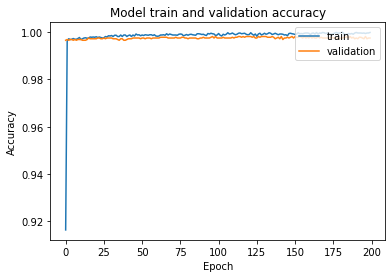

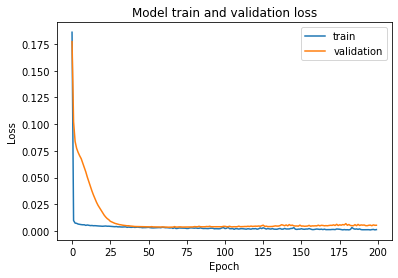


Training Accuracy Array:  [0.9164018034934998, 0.9961856603622437, 0.9971392154693604, 0.9968213438987732, 0.9969273209571838, 0.997245192527771, 0.9969273209571838, 0.9969273209571838, 0.997245192527771, 0.997668981552124, 0.9968213438987732, 0.9971392154693604, 0.9974570870399475, 0.9975630640983582, 0.9973511099815369, 0.9974570870399475, 0.9978809356689453, 0.9977749586105347, 0.9978809356689453, 0.9977749586105347, 0.9979868531227112, 0.997668981552124, 0.9978809356689453, 0.997668981552124, 0.9974570870399475, 0.9975630640983582, 0.9980928301811218, 0.9978809356689453, 0.998410701751709, 0.9983047246932983, 0.9985166192054749, 0.9980928301811218, 0.9986225962638855, 0.9986225962638855, 0.9980928301811218, 0.9980928301811218, 0.9987285733222961, 0.9980928301811218, 0.9987285733222961, 0.9987285733222961, 0.9980928301811218, 0.9985166192054749, 0.9987285733222961, 0.9980928301811218, 0.9987285733222961, 0.9983047246932983, 0.9991523623466492, 0.9987285733222961, 0.998834490776062,

In [ ]:
fcn_learning_low_SNR_zigbee = fcn_model_zigbee()

epochs = 200
batch_size = 1024

history = fcn_learning_low_SNR_zigbee.fit(X_train, Y_train, epochs=epochs, batch_size=batch_size,  validation_data = (X_validation, Y_validation), shuffle=True, callbacks=[ES])

score = fcn_learning_low_SNR_zigbee.evaluate(X_test, Y_test, verbose=0)
print('\nEvaluating on Test data : Score of SNR = ' + str(score[1]*100) +'\n')

summarize_model(history)
fcn_learning_low_SNR_zigbee.save("/gdrive/My Drive/Signal Identification Model FCN/Zigbee/fcnFFTdata_lowSNR_zigbee.tf")

print("\nTraining Accuracy Array: ", history.history['accuracy'])
print("\nValidation Accuracy Array: ", history.history['val_accuracy'])

## Channel Classification on each SNR separately and Transfer Learning

In [ ]:
x_data_fft_zigbee = x_data_fft_data[13:15]
y_labels_zigbee = y_labels_data[13:15]

print(x_data_fft_zigbee.shape)
print(y_labels_zigbee.shape)

y_labels_zigbee = y_labels_zigbee - 13

(2, 21, 715, 128, 2)
(2, 21, 715)


In [ ]:
x_dim = x_data_fft_zigbee.shape
total_num_snapshots = x_dim[0]*x_dim[1]*x_dim[2]
num_snapshots_per_tech = x_dim[1]*x_dim[2]
num_tech = x_dim[0]
num_samples = x_dim[3]
print(num_snapshots_per_tech)

15015


In [ ]:
from sklearn.model_selection import train_test_split
from keras.utils.np_utils import to_categorical
from keras import models
import math

X_train_curr = np.zeros((math.floor(0.6*total_num_snapshots/21), num_samples, 2))
X_validation_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_samples, 2))
X_test_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_samples, 2))
Y_train_curr = np.zeros((math.floor(0.6*total_num_snapshots/21), num_tech))
Y_validation_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_tech))
Y_test_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_tech))

X_test_valid_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_samples, 2))
Y_test_valid_curr = np.zeros((math.ceil(0.2*total_num_snapshots/21), num_tech))

In [ ]:
print('X_train_curr.shape = ' + str(X_train_curr.shape))
print('X_validation_curr.shape = ' + str(X_validation_curr.shape))
print('X_test_curr.shape = ' + str(X_test_curr.shape))
print('Y_train_curr.shape = ' + str(Y_train_curr.shape))
print('Y_validation_curr.shape = ' + str(Y_validation_curr.shape))
print('Y_test_curr.shape = ' + str(Y_test_curr.shape))

X_train_curr.shape = (858, 128, 2)
X_validation_curr.shape = (286, 128, 2)
X_test_curr.shape = (286, 128, 2)
Y_train_curr.shape = (858, 2)
Y_validation_curr.shape = (286, 2)
Y_test_curr.shape = (286, 2)


In [ ]:
from matplotlib import pyplot

def summarize_model(history, i):

  pyplot.plot(history.history['accuracy'])
  pyplot.plot(history.history['val_accuracy']) 
  pyplot.title('Model train and validation accuracy - Zigbee SNR ' + str(2*i-20))
  pyplot.ylabel('Accuracy')
  pyplot.xlabel('Epoch')
  pyplot.legend(['train', 'validation'], loc='upper right')
  pyplot.show()

  pyplot.plot(history.history['loss'])
  pyplot.plot(history.history['val_loss'])  
  pyplot.title('Model train and validation loss - Zigbee SNR ' + str(2*i-20))
  pyplot.ylabel('Loss')
  pyplot.xlabel('Epoch')
  pyplot.legend(['train', 'validation'], loc='upper right')
  pyplot.show()

In [ ]:
from keras.callbacks import EarlyStopping

ES = EarlyStopping(monitor = 'val_accuracy', mode = 'max', min_delta = 0.000001, patience = 200, verbose = 1)

In [ ]:
def Testing(X_test_curr, Y_test_curr, i):
  
  all_snr_model = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/Zigbee/fcnFFTdata_allSNR_zigbee.tf"))

  score = all_snr_model.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('\nScore of SNR on All SNR model without Transfer Learning ' + str(2*i-20) + ' = ' + str(score[1]*100))

  high_snr_model = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/Zigbee/fcnFFTdata_highSNR_zigbee.tf"))

  score = high_snr_model.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('Score of SNR on High SNR model without Transfer Learning ' + str(2*i-20) + ' = ' + str(score[1]*100))

  low_snr_model = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/Zigbee/fcnFFTdata_lowSNR_zigbee.tf"))

  score = low_snr_model.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('Score of SNR on low SNR model without Transfer Learning ' + str(2*i-20) + ' = ' + str(score[1]*100))

In [ ]:
def train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i):
  
  print("\nTraining SNR = "+str(2*i-20)+" Data\n")

  lstm_model_cur = fcn_model_zigbee()
  history = lstm_model_cur.fit(X_train_curr, Y_train_curr, validation_data = (X_validation_curr, Y_validation_curr), epochs=200, batch_size=1024, callbacks=[ES])

  score = lstm_model_cur.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('\nEvaluating on Test data : Score of SNR ' + str(2*i-20) + ' = ' + str(score[1]*100) +'\n')

  summarize_model(history, i)
  lstm_model_cur.save("/gdrive/My Drive/Signal Identification Model FCN/Zigbee/fcnFFTdata_SNR_"+str(2*i-20)+"_zigbee.tf")

In [ ]:
def train_data_on_all_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i):
  
  print("\nTraining SNR = "+str(2*i-20)+" Data on a pre-trained All SNR model\n")

  lstm_model_cur = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/Zigbee/fcnFFTdata_allSNR_zigbee.tf"))
  lstm_model_cur.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
  history = lstm_model_cur.fit(X_train_curr, Y_train_curr, validation_data = (X_validation_curr, Y_validation_curr), epochs=200, batch_size=1024, callbacks=[ES])

  score = lstm_model_cur.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('\nEvaluating on Test data : Score of SNR ' + str(2*i-20) + ' = ' + str(score[1]*100) +'\n')

  summarize_model(history, i)
  lstm_model_cur.save("/gdrive/My Drive/Signal Identification Model FCN/Zigbee/fcnFFTdata_allSNR_to_SNR_"+str(2*i-20)+"_zigbee.tf")

In [ ]:
def train_data_on_high_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i):
  
  print("\nTraining SNR = "+str(2*i-20)+" Data on a pre-trained High SNR model\n")

  lstm_model_cur = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/Zigbee/fcnFFTdata_highSNR_zigbee.tf"))
  lstm_model_cur.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
  history = lstm_model_cur.fit(X_train_curr, Y_train_curr, validation_data = (X_validation_curr, Y_validation_curr), epochs=200, batch_size=1024, callbacks=[ES])

  score = lstm_model_cur.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('\nEvaluating on Test data : Score of SNR ' + str(2*i-20) + ' = ' + str(score[1]*100) +'\n')

  summarize_model(history, i)
  lstm_model_cur.save("/gdrive/My Drive/Signal Identification Model FCN/Zigbee/fcnFFTdata_highSNR_to_SNR_"+str(2*i-20)+"_zigbee.tf")

In [ ]:
def train_data_on_low_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i):
  
  print("\nTraining SNR = "+str(2*i-20)+" Data on a pre-trained Low SNR model\n")

  lstm_model_cur = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/Zigbee/fcnFFTdata_lowSNR_zigbee.tf"))  
  lstm_model_cur.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
  history = lstm_model_cur.fit(X_train_curr, Y_train_curr, validation_data = (X_validation_curr, Y_validation_curr), epochs=200, batch_size=1024, callbacks=[ES])

  score = lstm_model_cur.evaluate(X_test_curr, Y_test_curr, verbose=0)
  print('\nEvaluating on Test data : Score of SNR ' + str(2*i-20) + ' = ' + str(score[1]*100) +'\n')

  summarize_model(history, i)
  lstm_model_cur.save("/gdrive/My Drive/Signal Identification Model FCN/Zigbee/fcnFFTdata_lowSNR_to_SNR_"+str(2*i-20)+"_zigbee.tf")
  


Score of SNR on All SNR model without Transfer Learning -20 = 86.36363744735718
Score of SNR on High SNR model without Transfer Learning -20 = 63.2867157459259
Score of SNR on low SNR model without Transfer Learning -20 = 61.888110637664795

Training SNR = -20 Data

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.8109 - accuracy: 0.5501 - val_loss: 0.6870 - val_accuracy: 0.5594
Epoch 2/200
1/1 [==============================] - 0s 21ms/step - loss: 0.7597 - accuracy: 0.5676 - val_loss: 0.6810 - val_accuracy: 0.5944
Epoch 3/200
1/1 [==============================] - 0s 22ms/step - loss: 0.6955 - accuracy: 0.6037 - val_loss: 0.6757 - val_accuracy: 0.6643
Epoch 4/200
1/1 [==============================] - 0s 22ms/step - loss: 0.6399 - accuracy: 0.6527 - val_loss: 0.6712 - val_accuracy: 0.6853
Epoch 5/200
1/1 [==============================] - 0s 28ms/step - loss: 0.5980 - accuracy: 0.6946 - val_loss: 0.6668 - val_accuracy: 0.6643
Epoch 6/200
1/1 [=================

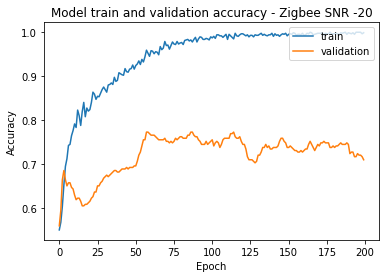

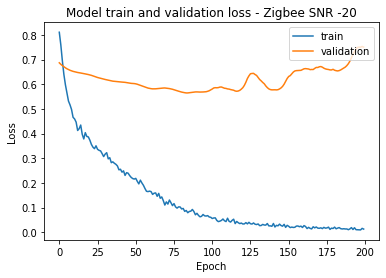


Training SNR = -20 Data on a pre-trained All SNR model

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.7868 - accuracy: 0.8800 - val_loss: 0.7154 - val_accuracy: 0.8776
Epoch 2/200
1/1 [==============================] - 0s 24ms/step - loss: 0.7869 - accuracy: 0.8788 - val_loss: 0.6942 - val_accuracy: 0.8741
Epoch 3/200
1/1 [==============================] - 0s 24ms/step - loss: 0.6637 - accuracy: 0.8881 - val_loss: 0.6736 - val_accuracy: 0.8846
Epoch 4/200
1/1 [==============================] - 0s 24ms/step - loss: 0.5833 - accuracy: 0.8823 - val_loss: 0.6559 - val_accuracy: 0.8916
Epoch 5/200
1/1 [==============================] - 0s 23ms/step - loss: 0.5317 - accuracy: 0.8904 - val_loss: 0.6406 - val_accuracy: 0.8916
Epoch 6/200
1/1 [==============================] - 0s 23ms/step - loss: 0.4696 - accuracy: 0.8893 - val_loss: 0.6306 - val_accuracy: 0.8916
Epoch 7/200
1/1 [==============================] - 0s 23ms/step - loss: 0.4170 - accuracy: 0.9021 - val_l

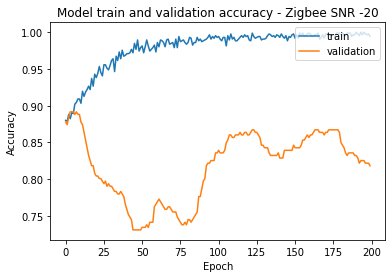

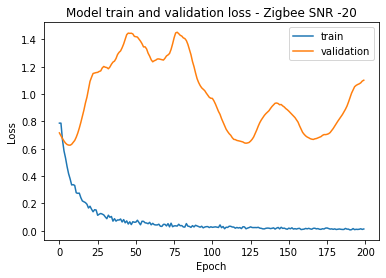


Training SNR = -20 Data on a pre-trained High SNR model

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 2.4023 - accuracy: 0.6399 - val_loss: 1.2192 - val_accuracy: 0.6678
Epoch 2/200
1/1 [==============================] - 0s 28ms/step - loss: 2.2120 - accuracy: 0.6387 - val_loss: 1.1153 - val_accuracy: 0.6958
Epoch 3/200
1/1 [==============================] - 0s 31ms/step - loss: 1.9657 - accuracy: 0.6702 - val_loss: 1.0449 - val_accuracy: 0.6923
Epoch 4/200
1/1 [==============================] - 0s 27ms/step - loss: 1.7675 - accuracy: 0.6737 - val_loss: 1.0038 - val_accuracy: 0.6783
Epoch 5/200
1/1 [==============================] - 0s 24ms/step - loss: 1.6254 - accuracy: 0.6946 - val_loss: 0.9848 - val_accuracy: 0.6748
Epoch 6/200
1/1 [==============================] - 0s 25ms/step - loss: 1.4503 - accuracy: 0.6981 - val_loss: 0.9867 - val_accuracy: 0.6573
Epoch 7/200
1/1 [==============================] - 0s 28ms/step - loss: 1.3066 - accuracy: 0.7016 - val_

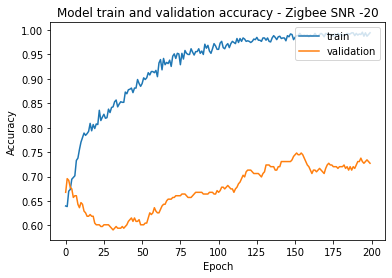

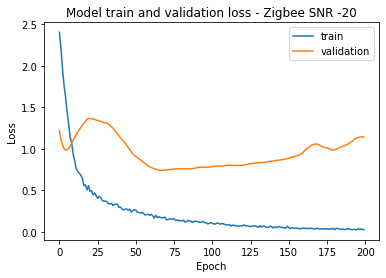


Training SNR = -20 Data on a pre-trained Low SNR model

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 2.0756 - accuracy: 0.6305 - val_loss: 1.4902 - val_accuracy: 0.6608
Epoch 2/200
1/1 [==============================] - 0s 25ms/step - loss: 1.8886 - accuracy: 0.6667 - val_loss: 1.3556 - val_accuracy: 0.6608
Epoch 3/200
1/1 [==============================] - 0s 23ms/step - loss: 1.6628 - accuracy: 0.6690 - val_loss: 1.2299 - val_accuracy: 0.6818
Epoch 4/200
1/1 [==============================] - 0s 26ms/step - loss: 1.4893 - accuracy: 0.6853 - val_loss: 1.1179 - val_accuracy: 0.6853
Epoch 5/200
1/1 [==============================] - 0s 30ms/step - loss: 1.3366 - accuracy: 0.7040 - val_loss: 1.0281 - val_accuracy: 0.6958
Epoch 6/200
1/1 [==============================] - 0s 24ms/step - loss: 1.1781 - accuracy: 0.7401 - val_loss: 0.9506 - val_accuracy: 0.6958
Epoch 7/200
1/1 [==============================] - 0s 22ms/step - loss: 1.0777 - accuracy: 0.7483 - val_l

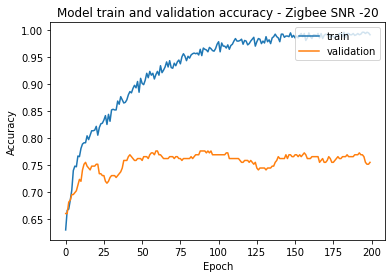

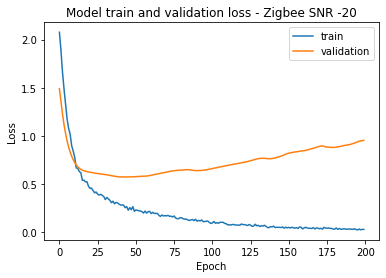


Score of SNR on All SNR model without Transfer Learning -18 = 90.90909361839294
Score of SNR on High SNR model without Transfer Learning -18 = 75.52447319030762
Score of SNR on low SNR model without Transfer Learning -18 = 69.2307710647583

Training SNR = -18 Data

Epoch 1/200
1/1 [==============================] - 2s 2s/step - loss: 1.0696 - accuracy: 0.4429 - val_loss: 0.6887 - val_accuracy: 0.5490
Epoch 2/200
1/1 [==============================] - 0s 27ms/step - loss: 0.8720 - accuracy: 0.5070 - val_loss: 0.6718 - val_accuracy: 0.6154
Epoch 3/200
1/1 [==============================] - 0s 31ms/step - loss: 0.6960 - accuracy: 0.6538 - val_loss: 0.6567 - val_accuracy: 0.7133
Epoch 4/200
1/1 [==============================] - 0s 24ms/step - loss: 0.6228 - accuracy: 0.6783 - val_loss: 0.6429 - val_accuracy: 0.7483
Epoch 5/200
1/1 [==============================] - 0s 29ms/step - loss: 0.5391 - accuracy: 0.7389 - val_loss: 0.6305 - val_accuracy: 0.7552
Epoch 6/200
1/1 [==================

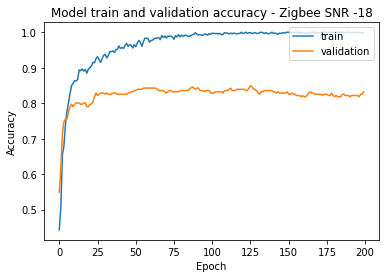

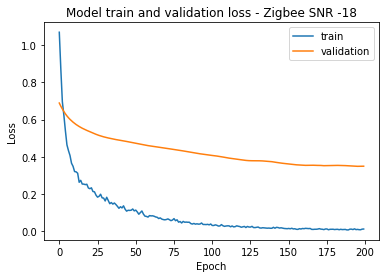


Training SNR = -18 Data on a pre-trained All SNR model

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.2927 - accuracy: 0.9289 - val_loss: 0.3874 - val_accuracy: 0.9336
Epoch 2/200
1/1 [==============================] - 0s 26ms/step - loss: 0.2712 - accuracy: 0.9406 - val_loss: 0.3626 - val_accuracy: 0.9406
Epoch 3/200
1/1 [==============================] - 0s 26ms/step - loss: 0.2095 - accuracy: 0.9499 - val_loss: 0.3393 - val_accuracy: 0.9371
Epoch 4/200
1/1 [==============================] - 0s 25ms/step - loss: 0.1726 - accuracy: 0.9464 - val_loss: 0.3126 - val_accuracy: 0.9371
Epoch 5/200
1/1 [==============================] - 0s 27ms/step - loss: 0.1640 - accuracy: 0.9522 - val_loss: 0.2939 - val_accuracy: 0.9336
Epoch 6/200
1/1 [==============================] - 0s 26ms/step - loss: 0.1167 - accuracy: 0.9534 - val_loss: 0.2895 - val_accuracy: 0.9371
Epoch 7/200
1/1 [==============================] - 0s 33ms/step - loss: 0.1078 - accuracy: 0.9604 - val_l

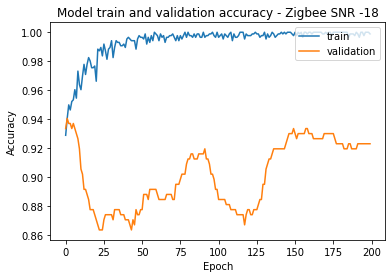

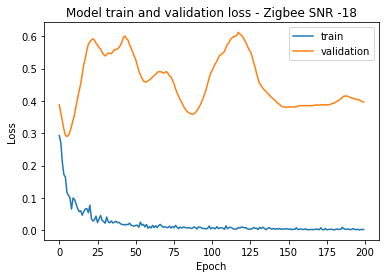


Training SNR = -18 Data on a pre-trained High SNR model

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 1.6847 - accuracy: 0.7226 - val_loss: 0.8487 - val_accuracy: 0.7413
Epoch 2/200
1/1 [==============================] - 0s 28ms/step - loss: 1.4611 - accuracy: 0.7354 - val_loss: 0.7718 - val_accuracy: 0.7587
Epoch 3/200
1/1 [==============================] - 0s 29ms/step - loss: 1.2311 - accuracy: 0.7657 - val_loss: 0.7191 - val_accuracy: 0.7762
Epoch 4/200
1/1 [==============================] - 0s 30ms/step - loss: 1.1197 - accuracy: 0.7821 - val_loss: 0.6850 - val_accuracy: 0.7762
Epoch 5/200
1/1 [==============================] - 0s 25ms/step - loss: 0.9887 - accuracy: 0.7984 - val_loss: 0.6708 - val_accuracy: 0.7867
Epoch 6/200
1/1 [==============================] - 0s 25ms/step - loss: 0.8786 - accuracy: 0.8135 - val_loss: 0.6663 - val_accuracy: 0.7937
Epoch 7/200
1/1 [==============================] - 0s 32ms/step - loss: 0.7417 - accuracy: 0.8252 - val_

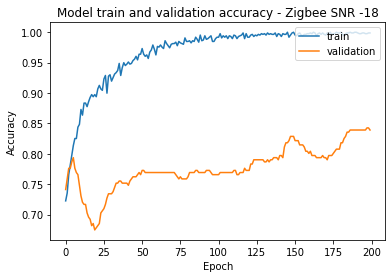

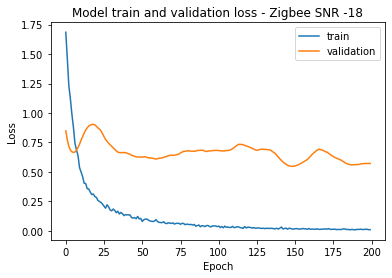


Training SNR = -18 Data on a pre-trained Low SNR model

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 1.5135 - accuracy: 0.6981 - val_loss: 0.9523 - val_accuracy: 0.6748
Epoch 2/200
1/1 [==============================] - 0s 30ms/step - loss: 1.2224 - accuracy: 0.7226 - val_loss: 0.8359 - val_accuracy: 0.6958
Epoch 3/200
1/1 [==============================] - 0s 25ms/step - loss: 1.0575 - accuracy: 0.7459 - val_loss: 0.7375 - val_accuracy: 0.7308
Epoch 4/200
1/1 [==============================] - 0s 26ms/step - loss: 1.0103 - accuracy: 0.7599 - val_loss: 0.6554 - val_accuracy: 0.7413
Epoch 5/200
1/1 [==============================] - 0s 25ms/step - loss: 0.8317 - accuracy: 0.7902 - val_loss: 0.5870 - val_accuracy: 0.7587
Epoch 6/200
1/1 [==============================] - 0s 29ms/step - loss: 0.7481 - accuracy: 0.7995 - val_loss: 0.5345 - val_accuracy: 0.7727
Epoch 7/200
1/1 [==============================] - 0s 25ms/step - loss: 0.6798 - accuracy: 0.8159 - val_l

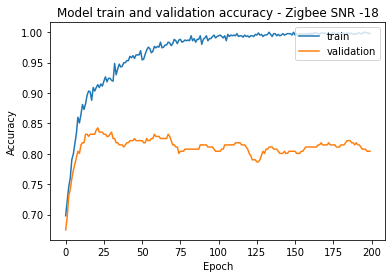

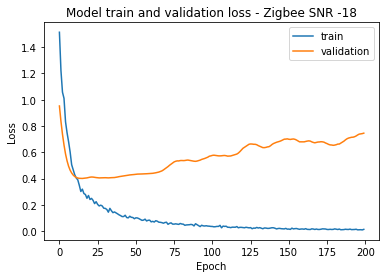


Score of SNR on All SNR model without Transfer Learning -16 = 97.55244851112366
Score of SNR on High SNR model without Transfer Learning -16 = 75.52447319030762
Score of SNR on low SNR model without Transfer Learning -16 = 78.32167744636536

Training SNR = -16 Data

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 1.0116 - accuracy: 0.4021 - val_loss: 0.7021 - val_accuracy: 0.4231
Epoch 2/200
1/1 [==============================] - 0s 26ms/step - loss: 0.8473 - accuracy: 0.4930 - val_loss: 0.6887 - val_accuracy: 0.5000
Epoch 3/200
1/1 [==============================] - 0s 31ms/step - loss: 0.6731 - accuracy: 0.6247 - val_loss: 0.6759 - val_accuracy: 0.6364
Epoch 4/200
1/1 [==============================] - 0s 25ms/step - loss: 0.5615 - accuracy: 0.6981 - val_loss: 0.6638 - val_accuracy: 0.7308
Epoch 5/200
1/1 [==============================] - 0s 34ms/step - loss: 0.4723 - accuracy: 0.7949 - val_loss: 0.6520 - val_accuracy: 0.8007
Epoch 6/200
1/1 [=================

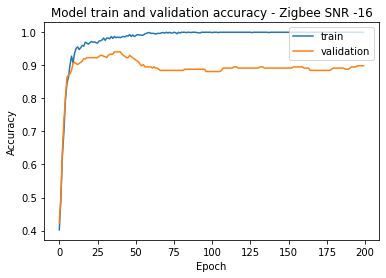

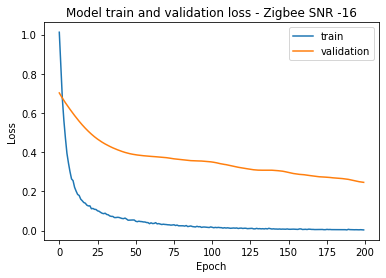


Training SNR = -16 Data on a pre-trained All SNR model

Epoch 1/200
1/1 [==============================] - 2s 2s/step - loss: 0.1821 - accuracy: 0.9650 - val_loss: 0.1128 - val_accuracy: 0.9650
Epoch 2/200
1/1 [==============================] - 0s 35ms/step - loss: 0.1376 - accuracy: 0.9697 - val_loss: 0.1313 - val_accuracy: 0.9545
Epoch 3/200
1/1 [==============================] - 0s 27ms/step - loss: 0.1190 - accuracy: 0.9709 - val_loss: 0.1460 - val_accuracy: 0.9476
Epoch 4/200
1/1 [==============================] - 0s 29ms/step - loss: 0.0732 - accuracy: 0.9732 - val_loss: 0.1771 - val_accuracy: 0.9441
Epoch 5/200
1/1 [==============================] - 0s 29ms/step - loss: 0.0692 - accuracy: 0.9779 - val_loss: 0.2174 - val_accuracy: 0.9301
Epoch 6/200
1/1 [==============================] - 0s 32ms/step - loss: 0.0502 - accuracy: 0.9779 - val_loss: 0.2689 - val_accuracy: 0.9161
Epoch 7/200
1/1 [==============================] - 0s 31ms/step - loss: 0.0380 - accuracy: 0.9883 - val_l

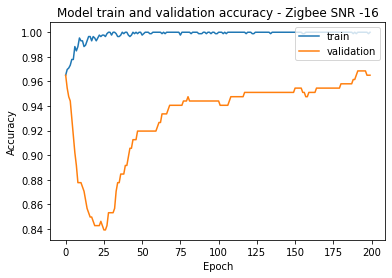

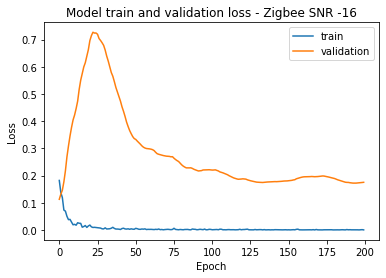


Training SNR = -16 Data on a pre-trained High SNR model

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.9244 - accuracy: 0.8228 - val_loss: 0.5211 - val_accuracy: 0.8182
Epoch 2/200
1/1 [==============================] - 0s 29ms/step - loss: 0.7409 - accuracy: 0.8380 - val_loss: 0.4493 - val_accuracy: 0.8182
Epoch 3/200
1/1 [==============================] - 0s 34ms/step - loss: 0.6084 - accuracy: 0.8590 - val_loss: 0.3986 - val_accuracy: 0.8462
Epoch 4/200
1/1 [==============================] - 0s 26ms/step - loss: 0.4628 - accuracy: 0.8811 - val_loss: 0.3669 - val_accuracy: 0.8671
Epoch 5/200
1/1 [==============================] - 0s 39ms/step - loss: 0.4277 - accuracy: 0.8881 - val_loss: 0.3513 - val_accuracy: 0.8636
Epoch 6/200
1/1 [==============================] - 0s 27ms/step - loss: 0.3393 - accuracy: 0.9068 - val_loss: 0.3484 - val_accuracy: 0.8566
Epoch 7/200
1/1 [==============================] - 0s 32ms/step - loss: 0.2516 - accuracy: 0.9266 - val_

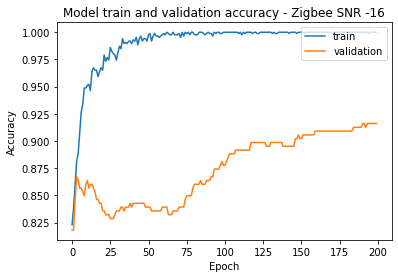

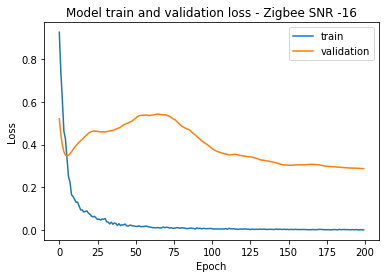


Training SNR = -16 Data on a pre-trained Low SNR model

Epoch 1/200
1/1 [==============================] - 2s 2s/step - loss: 0.8039 - accuracy: 0.8182 - val_loss: 0.6032 - val_accuracy: 0.7413
Epoch 2/200
1/1 [==============================] - 0s 28ms/step - loss: 0.6087 - accuracy: 0.8531 - val_loss: 0.5295 - val_accuracy: 0.7692
Epoch 3/200
1/1 [==============================] - 0s 42ms/step - loss: 0.5190 - accuracy: 0.8648 - val_loss: 0.4739 - val_accuracy: 0.7902
Epoch 4/200
1/1 [==============================] - 0s 31ms/step - loss: 0.4187 - accuracy: 0.8951 - val_loss: 0.4312 - val_accuracy: 0.8182
Epoch 5/200
1/1 [==============================] - 0s 31ms/step - loss: 0.3290 - accuracy: 0.9126 - val_loss: 0.3987 - val_accuracy: 0.8252
Epoch 6/200
1/1 [==============================] - 0s 27ms/step - loss: 0.2958 - accuracy: 0.9149 - val_loss: 0.3739 - val_accuracy: 0.8357
Epoch 7/200
1/1 [==============================] - 0s 39ms/step - loss: 0.2441 - accuracy: 0.9266 - val_l

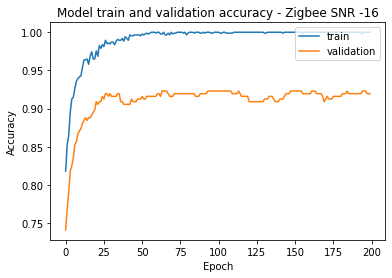

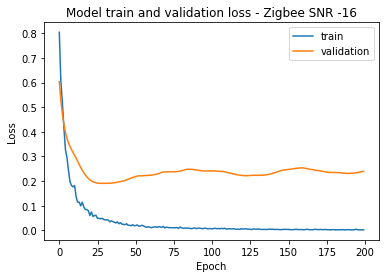


Score of SNR on All SNR model without Transfer Learning -14 = 99.6503472328186
Score of SNR on High SNR model without Transfer Learning -14 = 82.51748085021973
Score of SNR on low SNR model without Transfer Learning -14 = 79.72028255462646

Training SNR = -14 Data

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 1.0866 - accuracy: 0.4755 - val_loss: 0.6826 - val_accuracy: 0.5070
Epoch 2/200
1/1 [==============================] - 0s 39ms/step - loss: 0.8106 - accuracy: 0.5839 - val_loss: 0.6606 - val_accuracy: 0.5874
Epoch 3/200
1/1 [==============================] - 0s 32ms/step - loss: 0.6134 - accuracy: 0.6958 - val_loss: 0.6399 - val_accuracy: 0.7413
Epoch 4/200
1/1 [==============================] - 0s 28ms/step - loss: 0.4588 - accuracy: 0.7925 - val_loss: 0.6207 - val_accuracy: 0.8846
Epoch 5/200
1/1 [==============================] - 0s 32ms/step - loss: 0.3378 - accuracy: 0.8578 - val_loss: 0.6027 - val_accuracy: 0.9476
Epoch 6/200
1/1 [==================

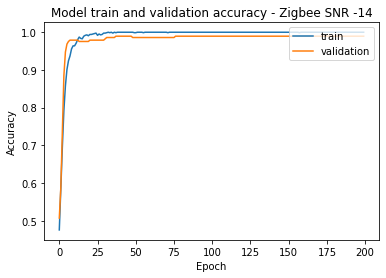

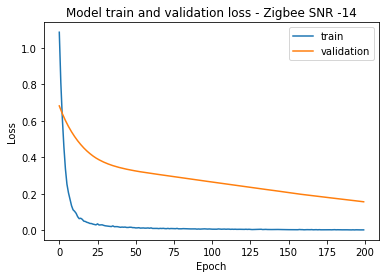


Training SNR = -14 Data on a pre-trained All SNR model

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.0188 - accuracy: 0.9907 - val_loss: 0.0212 - val_accuracy: 0.9965
Epoch 2/200
1/1 [==============================] - 0s 34ms/step - loss: 0.0106 - accuracy: 0.9965 - val_loss: 0.0243 - val_accuracy: 0.9965
Epoch 3/200
1/1 [==============================] - 0s 31ms/step - loss: 0.0114 - accuracy: 0.9977 - val_loss: 0.0277 - val_accuracy: 0.9930
Epoch 4/200
1/1 [==============================] - 0s 33ms/step - loss: 0.0052 - accuracy: 0.9988 - val_loss: 0.0300 - val_accuracy: 0.9930
Epoch 5/200
1/1 [==============================] - 0s 31ms/step - loss: 0.0055 - accuracy: 0.9977 - val_loss: 0.0323 - val_accuracy: 0.9930
Epoch 6/200
1/1 [==============================] - 0s 32ms/step - loss: 0.0028 - accuracy: 1.0000 - val_loss: 0.0343 - val_accuracy: 0.9930
Epoch 7/200
1/1 [==============================] - 0s 35ms/step - loss: 0.0059 - accuracy: 0.9965 - val_l

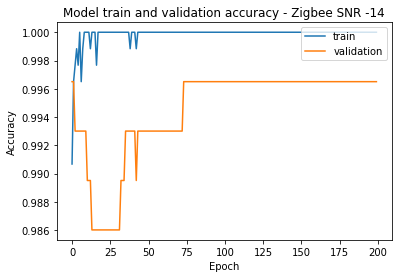

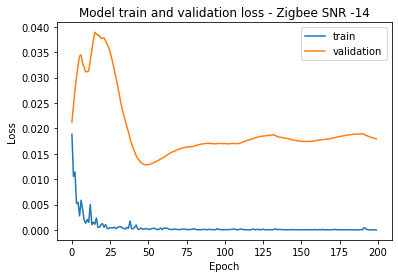


Training SNR = -14 Data on a pre-trained High SNR model

Epoch 1/200
1/1 [==============================] - 2s 2s/step - loss: 0.4714 - accuracy: 0.8730 - val_loss: 0.4538 - val_accuracy: 0.8322
Epoch 2/200
1/1 [==============================] - 0s 28ms/step - loss: 0.3391 - accuracy: 0.9009 - val_loss: 0.3797 - val_accuracy: 0.8531
Epoch 3/200
1/1 [==============================] - 0s 31ms/step - loss: 0.2575 - accuracy: 0.9184 - val_loss: 0.3200 - val_accuracy: 0.8601
Epoch 4/200
1/1 [==============================] - 0s 40ms/step - loss: 0.1964 - accuracy: 0.9394 - val_loss: 0.2728 - val_accuracy: 0.8916
Epoch 5/200
1/1 [==============================] - 0s 28ms/step - loss: 0.1266 - accuracy: 0.9604 - val_loss: 0.2363 - val_accuracy: 0.9056
Epoch 6/200
1/1 [==============================] - 0s 28ms/step - loss: 0.0918 - accuracy: 0.9627 - val_loss: 0.2073 - val_accuracy: 0.9231
Epoch 7/200
1/1 [==============================] - 0s 29ms/step - loss: 0.0785 - accuracy: 0.9744 - val_

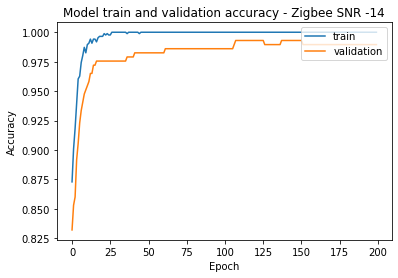

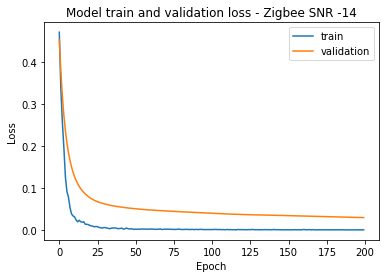


Training SNR = -14 Data on a pre-trained Low SNR model

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.3982 - accuracy: 0.8939 - val_loss: 0.4715 - val_accuracy: 0.7902
Epoch 2/200
1/1 [==============================] - 0s 39ms/step - loss: 0.3134 - accuracy: 0.9184 - val_loss: 0.3868 - val_accuracy: 0.8357
Epoch 3/200
1/1 [==============================] - 0s 31ms/step - loss: 0.2100 - accuracy: 0.9312 - val_loss: 0.3206 - val_accuracy: 0.8497
Epoch 4/200
1/1 [==============================] - 0s 25ms/step - loss: 0.1835 - accuracy: 0.9382 - val_loss: 0.2686 - val_accuracy: 0.8881
Epoch 5/200
1/1 [==============================] - 0s 26ms/step - loss: 0.1346 - accuracy: 0.9557 - val_loss: 0.2299 - val_accuracy: 0.9056
Epoch 6/200
1/1 [==============================] - 0s 27ms/step - loss: 0.0948 - accuracy: 0.9674 - val_loss: 0.1992 - val_accuracy: 0.9126
Epoch 7/200
1/1 [==============================] - 0s 26ms/step - loss: 0.0775 - accuracy: 0.9720 - val_l

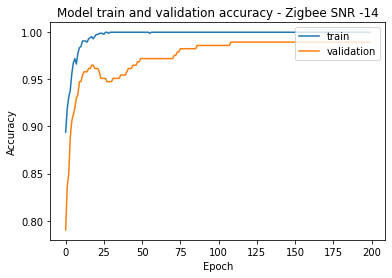

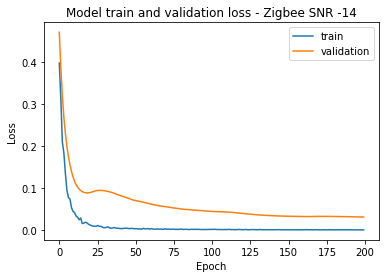


Score of SNR on All SNR model without Transfer Learning -12 = 99.6503472328186
Score of SNR on High SNR model without Transfer Learning -12 = 81.81818127632141
Score of SNR on low SNR model without Transfer Learning -12 = 83.91608595848083

Training SNR = -12 Data

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 1.0523 - accuracy: 0.3963 - val_loss: 0.6892 - val_accuracy: 0.5350
Epoch 2/200
1/1 [==============================] - 0s 35ms/step - loss: 0.7100 - accuracy: 0.6014 - val_loss: 0.6641 - val_accuracy: 0.8077
Epoch 3/200
1/1 [==============================] - 0s 29ms/step - loss: 0.4544 - accuracy: 0.7925 - val_loss: 0.6402 - val_accuracy: 0.9056
Epoch 4/200
1/1 [==============================] - 0s 37ms/step - loss: 0.3026 - accuracy: 0.9056 - val_loss: 0.6178 - val_accuracy: 0.9476
Epoch 5/200
1/1 [==============================] - 0s 34ms/step - loss: 0.2053 - accuracy: 0.9592 - val_loss: 0.5968 - val_accuracy: 0.9720
Epoch 6/200
1/1 [==================

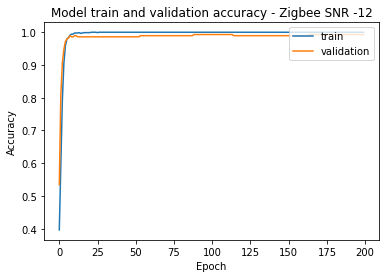

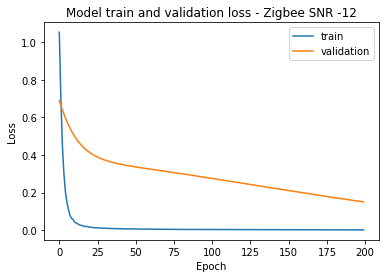


Training SNR = -12 Data on a pre-trained All SNR model

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.0065 - accuracy: 0.9977 - val_loss: 0.0052 - val_accuracy: 0.9965
Epoch 2/200
1/1 [==============================] - 0s 31ms/step - loss: 5.2671e-04 - accuracy: 1.0000 - val_loss: 0.0048 - val_accuracy: 0.9965
Epoch 3/200
1/1 [==============================] - 0s 33ms/step - loss: 1.5696e-04 - accuracy: 1.0000 - val_loss: 0.0056 - val_accuracy: 0.9965
Epoch 4/200
1/1 [==============================] - 0s 49ms/step - loss: 2.8854e-04 - accuracy: 1.0000 - val_loss: 0.0072 - val_accuracy: 0.9965
Epoch 5/200
1/1 [==============================] - 0s 34ms/step - loss: 1.1775e-04 - accuracy: 1.0000 - val_loss: 0.0094 - val_accuracy: 0.9965
Epoch 6/200
1/1 [==============================] - 0s 32ms/step - loss: 2.1330e-04 - accuracy: 1.0000 - val_loss: 0.0117 - val_accuracy: 0.9965
Epoch 7/200
1/1 [==============================] - 0s 31ms/step - loss: 5.5774e-04 - 

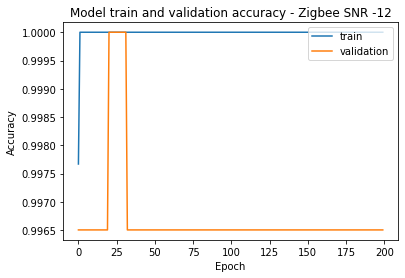

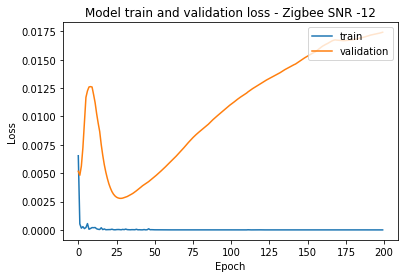


Training SNR = -12 Data on a pre-trained High SNR model

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.1318 - accuracy: 0.9569 - val_loss: 0.3882 - val_accuracy: 0.8217
Epoch 2/200
1/1 [==============================] - 0s 43ms/step - loss: 0.0643 - accuracy: 0.9790 - val_loss: 0.3124 - val_accuracy: 0.8427
Epoch 3/200
1/1 [==============================] - 0s 47ms/step - loss: 0.0438 - accuracy: 0.9872 - val_loss: 0.2523 - val_accuracy: 0.8776
Epoch 4/200
1/1 [==============================] - 0s 38ms/step - loss: 0.0220 - accuracy: 0.9965 - val_loss: 0.2058 - val_accuracy: 0.9091
Epoch 5/200
1/1 [==============================] - 0s 39ms/step - loss: 0.0130 - accuracy: 0.9953 - val_loss: 0.1703 - val_accuracy: 0.9371
Epoch 6/200
1/1 [==============================] - 0s 47ms/step - loss: 0.0074 - accuracy: 0.9965 - val_loss: 0.1423 - val_accuracy: 0.9441
Epoch 7/200
1/1 [==============================] - 0s 37ms/step - loss: 0.0048 - accuracy: 0.9988 - val_

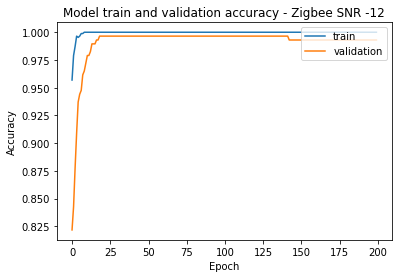

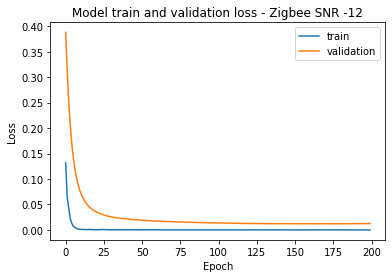


Training SNR = -12 Data on a pre-trained Low SNR model

Epoch 1/200
1/1 [==============================] - 2s 2s/step - loss: 0.0752 - accuracy: 0.9744 - val_loss: 0.3136 - val_accuracy: 0.8531
Epoch 2/200
1/1 [==============================] - 0s 31ms/step - loss: 0.0434 - accuracy: 0.9848 - val_loss: 0.2487 - val_accuracy: 0.8846
Epoch 3/200
1/1 [==============================] - 0s 29ms/step - loss: 0.0247 - accuracy: 0.9930 - val_loss: 0.1995 - val_accuracy: 0.9091
Epoch 4/200
1/1 [==============================] - 0s 27ms/step - loss: 0.0110 - accuracy: 0.9988 - val_loss: 0.1628 - val_accuracy: 0.9336
Epoch 5/200
1/1 [==============================] - 0s 40ms/step - loss: 0.0069 - accuracy: 0.9977 - val_loss: 0.1361 - val_accuracy: 0.9510
Epoch 6/200
1/1 [==============================] - 0s 30ms/step - loss: 0.0057 - accuracy: 0.9988 - val_loss: 0.1164 - val_accuracy: 0.9580
Epoch 7/200
1/1 [==============================] - 0s 29ms/step - loss: 0.0020 - accuracy: 1.0000 - val_l

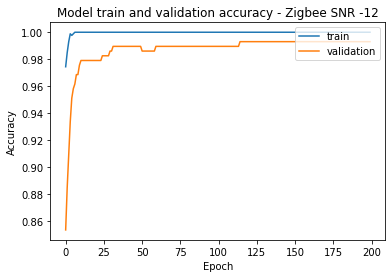

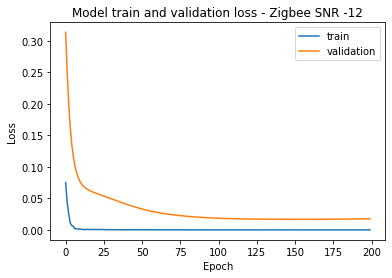

In [ ]:
for i in range(0, 5):

  x_data_mag = np.absolute(x_data_fft_zigbee[:,:,:,:,0] + 1j*x_data_fft_zigbee[:,:,:,:,1]) 
  x_data_fft_curr = np.reshape(x_data_mag[:,i], (x_dim[0]*x_dim[2], x_dim[3]))

  y_data_fft_curr = to_categorical(y_labels_zigbee[:,i].flatten())

  X_train_curr, X_test_valid_curr, Y_train_curr, Y_test_valid_curr = train_test_split(x_data_fft_curr, y_data_fft_curr, test_size=0.4)
  X_validation_curr, X_test_curr, Y_validation_curr, Y_test_curr = train_test_split(X_test_valid_curr, Y_test_valid_curr, test_size=0.5)

  Testing(X_test_curr, Y_test_curr, i)
  train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_all_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_high_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_low_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)


Score of SNR on All SNR model without Transfer Learning -10 = 100.0
Score of SNR on High SNR model without Transfer Learning -10 = 83.91608595848083
Score of SNR on low SNR model without Transfer Learning -10 = 91.25874042510986

Training SNR = -10 Data

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.5440 - accuracy: 0.7401 - val_loss: 0.6412 - val_accuracy: 0.9196
Epoch 2/200
1/1 [==============================] - 0s 26ms/step - loss: 0.3005 - accuracy: 0.8788 - val_loss: 0.6154 - val_accuracy: 0.9755
Epoch 3/200
1/1 [==============================] - 0s 23ms/step - loss: 0.1794 - accuracy: 0.9476 - val_loss: 0.5923 - val_accuracy: 0.9825
Epoch 4/200
1/1 [==============================] - 0s 21ms/step - loss: 0.1078 - accuracy: 0.9802 - val_loss: 0.5716 - val_accuracy: 0.9930
Epoch 5/200
1/1 [==============================] - 0s 22ms/step - loss: 0.0738 - accuracy: 0.9953 - val_loss: 0.5532 - val_accuracy: 0.9965
Epoch 6/200
1/1 [=============================

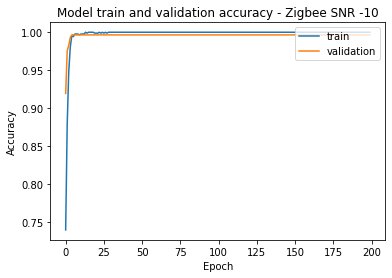

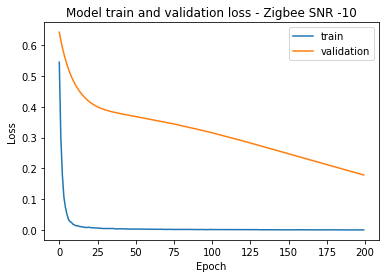


Training SNR = -10 Data on a pre-trained All SNR model

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.0018 - accuracy: 0.9988 - val_loss: 0.0086 - val_accuracy: 0.9965
Epoch 2/200
1/1 [==============================] - 0s 25ms/step - loss: 4.8631e-04 - accuracy: 1.0000 - val_loss: 0.0102 - val_accuracy: 0.9965
Epoch 3/200
1/1 [==============================] - 0s 26ms/step - loss: 8.9594e-05 - accuracy: 1.0000 - val_loss: 0.0114 - val_accuracy: 0.9965
Epoch 4/200
1/1 [==============================] - 0s 26ms/step - loss: 4.9271e-04 - accuracy: 1.0000 - val_loss: 0.0110 - val_accuracy: 0.9965
Epoch 5/200
1/1 [==============================] - 0s 26ms/step - loss: 6.8689e-05 - accuracy: 1.0000 - val_loss: 0.0105 - val_accuracy: 0.9965
Epoch 6/200
1/1 [==============================] - 0s 23ms/step - loss: 3.5002e-05 - accuracy: 1.0000 - val_loss: 0.0101 - val_accuracy: 0.9965
Epoch 7/200
1/1 [==============================] - 0s 22ms/step - loss: 6.6854e-05 - 

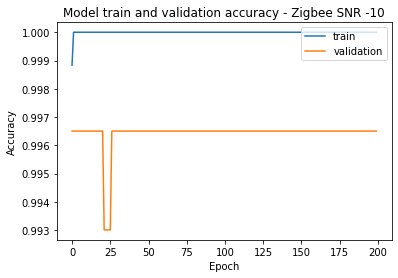

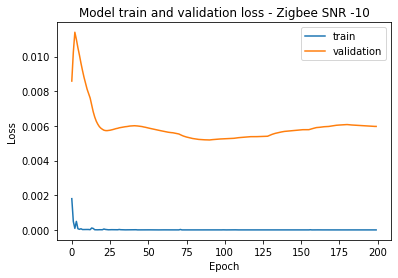


Training SNR = -10 Data on a pre-trained High SNR model

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.0427 - accuracy: 0.9837 - val_loss: 0.3192 - val_accuracy: 0.8497
Epoch 2/200
1/1 [==============================] - 0s 44ms/step - loss: 0.0164 - accuracy: 0.9942 - val_loss: 0.2490 - val_accuracy: 0.8811
Epoch 3/200
1/1 [==============================] - 0s 28ms/step - loss: 0.0064 - accuracy: 0.9977 - val_loss: 0.1976 - val_accuracy: 0.9161
Epoch 4/200
1/1 [==============================] - 0s 24ms/step - loss: 0.0026 - accuracy: 1.0000 - val_loss: 0.1612 - val_accuracy: 0.9336
Epoch 5/200
1/1 [==============================] - 0s 25ms/step - loss: 0.0012 - accuracy: 1.0000 - val_loss: 0.1350 - val_accuracy: 0.9615
Epoch 6/200
1/1 [==============================] - 0s 37ms/step - loss: 0.0020 - accuracy: 0.9988 - val_loss: 0.1157 - val_accuracy: 0.9650
Epoch 7/200
1/1 [==============================] - 0s 30ms/step - loss: 6.2808e-04 - accuracy: 1.0000 - 

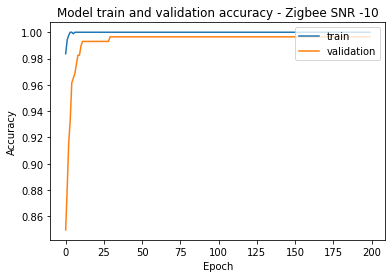

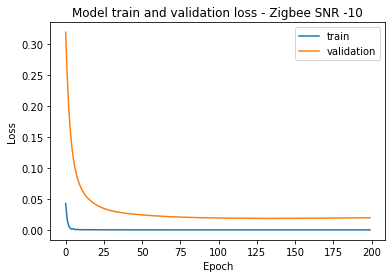


Training SNR = -10 Data on a pre-trained Low SNR model

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.0309 - accuracy: 0.9907 - val_loss: 0.2069 - val_accuracy: 0.9126
Epoch 2/200
1/1 [==============================] - 0s 25ms/step - loss: 0.0169 - accuracy: 0.9942 - val_loss: 0.1626 - val_accuracy: 0.9371
Epoch 3/200
1/1 [==============================] - 0s 26ms/step - loss: 0.0086 - accuracy: 0.9953 - val_loss: 0.1293 - val_accuracy: 0.9545
Epoch 4/200
1/1 [==============================] - 0s 33ms/step - loss: 0.0060 - accuracy: 0.9977 - val_loss: 0.1065 - val_accuracy: 0.9720
Epoch 5/200
1/1 [==============================] - 0s 25ms/step - loss: 0.0025 - accuracy: 0.9988 - val_loss: 0.0905 - val_accuracy: 0.9755
Epoch 6/200
1/1 [==============================] - 0s 28ms/step - loss: 0.0020 - accuracy: 0.9988 - val_loss: 0.0787 - val_accuracy: 0.9755
Epoch 7/200
1/1 [==============================] - 0s 30ms/step - loss: 0.0016 - accuracy: 1.0000 - val_l

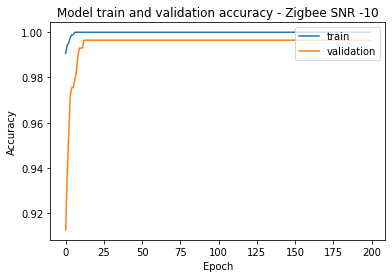

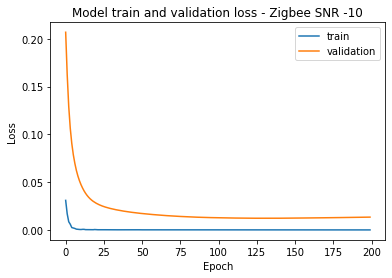


Score of SNR on All SNR model without Transfer Learning -8 = 99.6503472328186
Score of SNR on High SNR model without Transfer Learning -8 = 88.46153616905212
Score of SNR on low SNR model without Transfer Learning -8 = 90.90909361839294

Training SNR = -8 Data

Epoch 1/200
1/1 [==============================] - 2s 2s/step - loss: 1.0535 - accuracy: 0.4825 - val_loss: 0.6691 - val_accuracy: 0.8217
Epoch 2/200
1/1 [==============================] - 0s 25ms/step - loss: 0.6208 - accuracy: 0.6643 - val_loss: 0.6425 - val_accuracy: 0.9685
Epoch 3/200
1/1 [==============================] - 0s 26ms/step - loss: 0.3280 - accuracy: 0.8485 - val_loss: 0.6183 - val_accuracy: 0.9965
Epoch 4/200
1/1 [==============================] - 0s 36ms/step - loss: 0.1810 - accuracy: 0.9510 - val_loss: 0.5961 - val_accuracy: 0.9965
Epoch 5/200
1/1 [==============================] - 0s 27ms/step - loss: 0.0958 - accuracy: 0.9860 - val_loss: 0.5759 - val_accuracy: 0.9965
Epoch 6/200
1/1 [======================

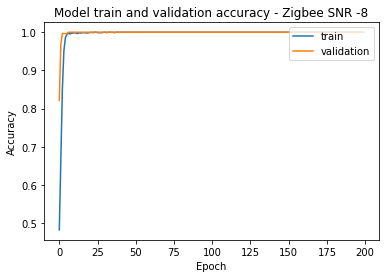

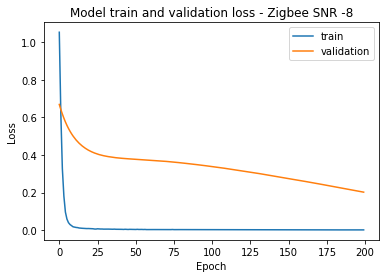


Training SNR = -8 Data on a pre-trained All SNR model

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.0012 - accuracy: 1.0000 - val_loss: 3.0844e-07 - val_accuracy: 1.0000
Epoch 2/200
1/1 [==============================] - 0s 26ms/step - loss: 3.1954e-04 - accuracy: 1.0000 - val_loss: 2.6134e-07 - val_accuracy: 1.0000
Epoch 3/200
1/1 [==============================] - 0s 22ms/step - loss: 8.1237e-05 - accuracy: 1.0000 - val_loss: 2.6968e-07 - val_accuracy: 1.0000
Epoch 4/200
1/1 [==============================] - 0s 24ms/step - loss: 3.7619e-04 - accuracy: 1.0000 - val_loss: 2.8552e-07 - val_accuracy: 1.0000
Epoch 5/200
1/1 [==============================] - 0s 28ms/step - loss: 6.2561e-05 - accuracy: 1.0000 - val_loss: 3.9597e-07 - val_accuracy: 1.0000
Epoch 6/200
1/1 [==============================] - 0s 34ms/step - loss: 2.0666e-05 - accuracy: 1.0000 - val_loss: 5.7978e-07 - val_accuracy: 1.0000
Epoch 7/200
1/1 [==============================] - 0s 26ms/ste

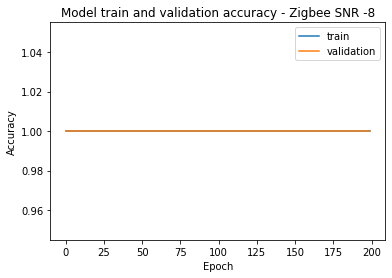

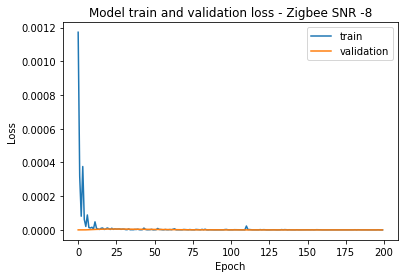


Training SNR = -8 Data on a pre-trained High SNR model

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.0215 - accuracy: 0.9918 - val_loss: 0.1852 - val_accuracy: 0.9371
Epoch 2/200
1/1 [==============================] - 0s 28ms/step - loss: 0.0097 - accuracy: 0.9953 - val_loss: 0.1502 - val_accuracy: 0.9580
Epoch 3/200
1/1 [==============================] - 0s 32ms/step - loss: 0.0056 - accuracy: 0.9977 - val_loss: 0.1302 - val_accuracy: 0.9615
Epoch 4/200
1/1 [==============================] - 0s 29ms/step - loss: 0.0038 - accuracy: 0.9988 - val_loss: 0.1143 - val_accuracy: 0.9650
Epoch 5/200
1/1 [==============================] - 0s 37ms/step - loss: 0.0033 - accuracy: 0.9988 - val_loss: 0.1004 - val_accuracy: 0.9650
Epoch 6/200
1/1 [==============================] - 0s 29ms/step - loss: 0.0010 - accuracy: 1.0000 - val_loss: 0.0891 - val_accuracy: 0.9755
Epoch 7/200
1/1 [==============================] - 0s 33ms/step - loss: 9.2118e-04 - accuracy: 1.0000 - v

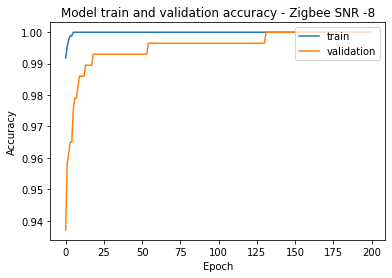

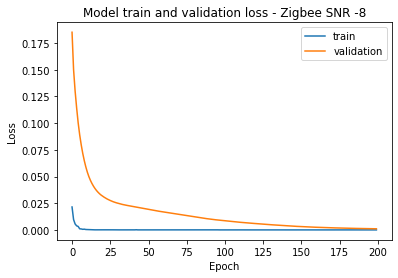


Training SNR = -8 Data on a pre-trained Low SNR model

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.0100 - accuracy: 0.9953 - val_loss: 0.1986 - val_accuracy: 0.9126
Epoch 2/200
1/1 [==============================] - 0s 25ms/step - loss: 0.0075 - accuracy: 0.9988 - val_loss: 0.2275 - val_accuracy: 0.8986
Epoch 3/200
1/1 [==============================] - 0s 29ms/step - loss: 0.0036 - accuracy: 0.9988 - val_loss: 0.2286 - val_accuracy: 0.8916
Epoch 4/200
1/1 [==============================] - 0s 24ms/step - loss: 0.0024 - accuracy: 1.0000 - val_loss: 0.2099 - val_accuracy: 0.8986
Epoch 5/200
1/1 [==============================] - 0s 26ms/step - loss: 0.0016 - accuracy: 1.0000 - val_loss: 0.1829 - val_accuracy: 0.9231
Epoch 6/200
1/1 [==============================] - 0s 26ms/step - loss: 7.0598e-04 - accuracy: 1.0000 - val_loss: 0.1574 - val_accuracy: 0.9336
Epoch 7/200
1/1 [==============================] - 0s 28ms/step - loss: 3.0470e-04 - accuracy: 1.0000 

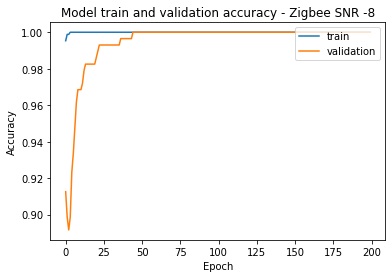

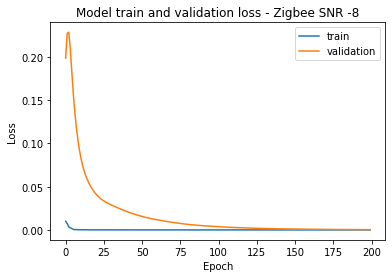


Score of SNR on All SNR model without Transfer Learning -6 = 100.0
Score of SNR on High SNR model without Transfer Learning -6 = 87.0629370212555
Score of SNR on low SNR model without Transfer Learning -6 = 97.55244851112366

Training SNR = -6 Data

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.7635 - accuracy: 0.5676 - val_loss: 0.6543 - val_accuracy: 0.9371
Epoch 2/200
1/1 [==============================] - 0s 28ms/step - loss: 0.3449 - accuracy: 0.8590 - val_loss: 0.6244 - val_accuracy: 0.9895
Epoch 3/200
1/1 [==============================] - 0s 27ms/step - loss: 0.1676 - accuracy: 0.9569 - val_loss: 0.5976 - val_accuracy: 0.9965
Epoch 4/200
1/1 [==============================] - 0s 50ms/step - loss: 0.0826 - accuracy: 0.9918 - val_loss: 0.5738 - val_accuracy: 1.0000
Epoch 5/200
1/1 [==============================] - 0s 27ms/step - loss: 0.0403 - accuracy: 0.9965 - val_loss: 0.5527 - val_accuracy: 1.0000
Epoch 6/200
1/1 [==============================] - 

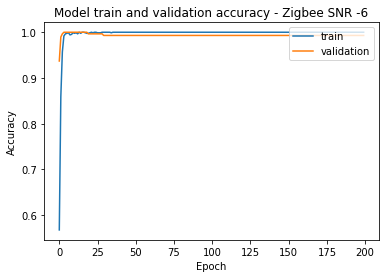

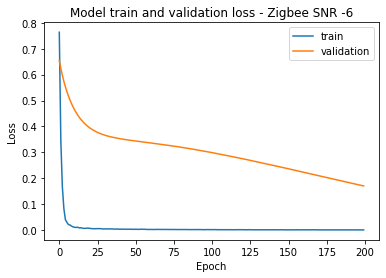


Training SNR = -6 Data on a pre-trained All SNR model

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.0079 - accuracy: 0.9953 - val_loss: 9.2819e-04 - val_accuracy: 1.0000
Epoch 2/200
1/1 [==============================] - 0s 37ms/step - loss: 0.0083 - accuracy: 0.9953 - val_loss: 0.0010 - val_accuracy: 1.0000
Epoch 3/200
1/1 [==============================] - 0s 27ms/step - loss: 0.0034 - accuracy: 0.9988 - val_loss: 0.0012 - val_accuracy: 1.0000
Epoch 4/200
1/1 [==============================] - 0s 37ms/step - loss: 0.0026 - accuracy: 0.9988 - val_loss: 0.0014 - val_accuracy: 1.0000
Epoch 5/200
1/1 [==============================] - 0s 28ms/step - loss: 5.6749e-04 - accuracy: 1.0000 - val_loss: 0.0017 - val_accuracy: 1.0000
Epoch 6/200
1/1 [==============================] - 0s 26ms/step - loss: 6.3334e-04 - accuracy: 1.0000 - val_loss: 0.0018 - val_accuracy: 1.0000
Epoch 7/200
1/1 [==============================] - 0s 36ms/step - loss: 0.0017 - accuracy: 1.0

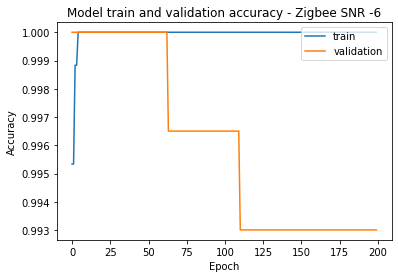

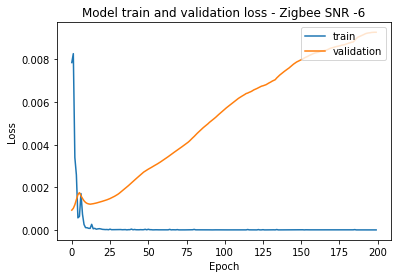


Training SNR = -6 Data on a pre-trained High SNR model

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.0117 - accuracy: 0.9953 - val_loss: 0.2068 - val_accuracy: 0.9231
Epoch 2/200
1/1 [==============================] - 0s 41ms/step - loss: 0.0081 - accuracy: 0.9977 - val_loss: 0.1920 - val_accuracy: 0.9301
Epoch 3/200
1/1 [==============================] - 0s 32ms/step - loss: 0.0047 - accuracy: 0.9988 - val_loss: 0.1715 - val_accuracy: 0.9406
Epoch 4/200
1/1 [==============================] - 0s 27ms/step - loss: 0.0030 - accuracy: 0.9988 - val_loss: 0.1480 - val_accuracy: 0.9476
Epoch 5/200
1/1 [==============================] - 0s 33ms/step - loss: 0.0018 - accuracy: 0.9988 - val_loss: 0.1253 - val_accuracy: 0.9650
Epoch 6/200
1/1 [==============================] - 0s 35ms/step - loss: 0.0017 - accuracy: 1.0000 - val_loss: 0.1089 - val_accuracy: 0.9685
Epoch 7/200
1/1 [==============================] - 0s 26ms/step - loss: 9.0140e-04 - accuracy: 1.0000 - v

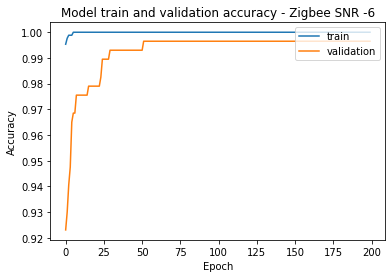

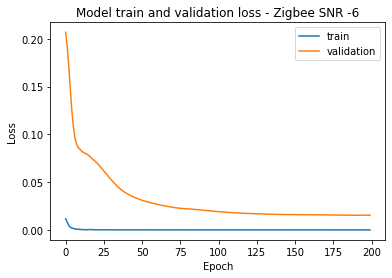


Training SNR = -6 Data on a pre-trained Low SNR model

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.0046 - accuracy: 0.9977 - val_loss: 0.1112 - val_accuracy: 0.9720
Epoch 2/200
1/1 [==============================] - 0s 27ms/step - loss: 0.0064 - accuracy: 0.9965 - val_loss: 0.0971 - val_accuracy: 0.9860
Epoch 3/200
1/1 [==============================] - 0s 36ms/step - loss: 0.0028 - accuracy: 1.0000 - val_loss: 0.0877 - val_accuracy: 0.9825
Epoch 4/200
1/1 [==============================] - 0s 32ms/step - loss: 0.0017 - accuracy: 1.0000 - val_loss: 0.0834 - val_accuracy: 0.9825
Epoch 5/200
1/1 [==============================] - 0s 25ms/step - loss: 0.0010 - accuracy: 1.0000 - val_loss: 0.0804 - val_accuracy: 0.9825
Epoch 6/200
1/1 [==============================] - 0s 29ms/step - loss: 0.0012 - accuracy: 1.0000 - val_loss: 0.0769 - val_accuracy: 0.9895
Epoch 7/200
1/1 [==============================] - 0s 43ms/step - loss: 4.3255e-04 - accuracy: 1.0000 - va

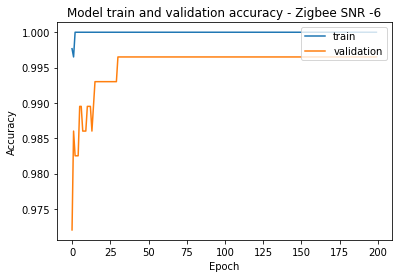

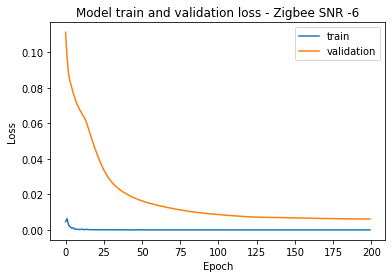


Score of SNR on All SNR model without Transfer Learning -4 = 99.6503472328186
Score of SNR on High SNR model without Transfer Learning -4 = 88.46153616905212
Score of SNR on low SNR model without Transfer Learning -4 = 97.90209531784058

Training SNR = -4 Data

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.7124 - accuracy: 0.6096 - val_loss: 0.6414 - val_accuracy: 0.9965
Epoch 2/200
1/1 [==============================] - 0s 29ms/step - loss: 0.3100 - accuracy: 0.8730 - val_loss: 0.6076 - val_accuracy: 0.9965
Epoch 3/200
1/1 [==============================] - 0s 32ms/step - loss: 0.1314 - accuracy: 0.9814 - val_loss: 0.5795 - val_accuracy: 0.9965
Epoch 4/200
1/1 [==============================] - 0s 31ms/step - loss: 0.0679 - accuracy: 0.9953 - val_loss: 0.5559 - val_accuracy: 0.9965
Epoch 5/200
1/1 [==============================] - 0s 34ms/step - loss: 0.0418 - accuracy: 0.9977 - val_loss: 0.5355 - val_accuracy: 0.9965
Epoch 6/200
1/1 [======================

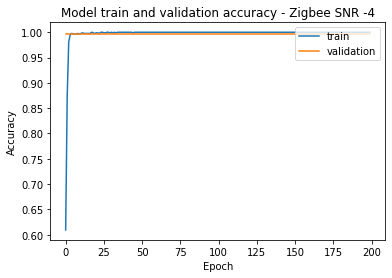

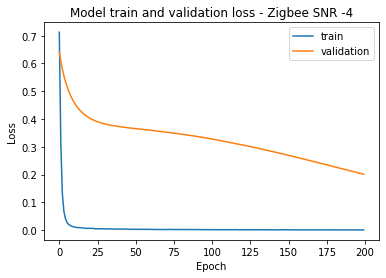


Training SNR = -4 Data on a pre-trained All SNR model

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.0027 - accuracy: 0.9977 - val_loss: 1.4948e-04 - val_accuracy: 1.0000
Epoch 2/200
1/1 [==============================] - 0s 28ms/step - loss: 0.0012 - accuracy: 1.0000 - val_loss: 1.5414e-04 - val_accuracy: 1.0000
Epoch 3/200
1/1 [==============================] - 0s 37ms/step - loss: 9.5662e-04 - accuracy: 0.9988 - val_loss: 2.0098e-04 - val_accuracy: 1.0000
Epoch 4/200
1/1 [==============================] - 0s 36ms/step - loss: 0.0018 - accuracy: 0.9988 - val_loss: 3.2760e-04 - val_accuracy: 1.0000
Epoch 5/200
1/1 [==============================] - 0s 29ms/step - loss: 7.8230e-04 - accuracy: 1.0000 - val_loss: 5.2989e-04 - val_accuracy: 1.0000
Epoch 6/200
1/1 [==============================] - 0s 35ms/step - loss: 3.2454e-04 - accuracy: 1.0000 - val_loss: 7.6065e-04 - val_accuracy: 1.0000
Epoch 7/200
1/1 [==============================] - 0s 32ms/step - loss

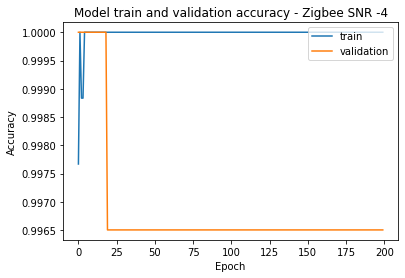

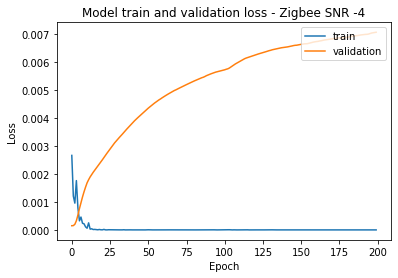


Training SNR = -4 Data on a pre-trained High SNR model

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.0083 - accuracy: 0.9965 - val_loss: 0.1947 - val_accuracy: 0.9126
Epoch 2/200
1/1 [==============================] - 0s 29ms/step - loss: 0.0076 - accuracy: 0.9965 - val_loss: 0.1585 - val_accuracy: 0.9441
Epoch 3/200
1/1 [==============================] - 0s 39ms/step - loss: 0.0043 - accuracy: 0.9977 - val_loss: 0.1365 - val_accuracy: 0.9650
Epoch 4/200
1/1 [==============================] - 0s 31ms/step - loss: 0.0031 - accuracy: 0.9977 - val_loss: 0.1254 - val_accuracy: 0.9720
Epoch 5/200
1/1 [==============================] - 0s 49ms/step - loss: 0.0017 - accuracy: 1.0000 - val_loss: 0.1182 - val_accuracy: 0.9720
Epoch 6/200
1/1 [==============================] - 0s 36ms/step - loss: 5.4405e-04 - accuracy: 1.0000 - val_loss: 0.1134 - val_accuracy: 0.9720
Epoch 7/200
1/1 [==============================] - 0s 40ms/step - loss: 4.6381e-04 - accuracy: 1.0000

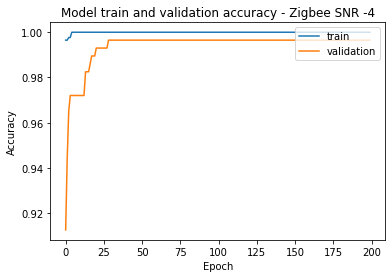

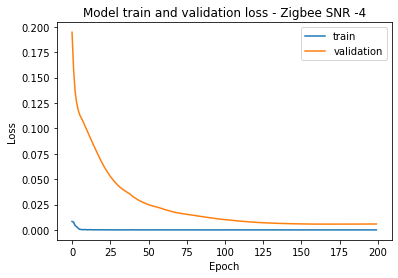


Training SNR = -4 Data on a pre-trained Low SNR model

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.0085 - accuracy: 0.9977 - val_loss: 0.1024 - val_accuracy: 0.9685
Epoch 2/200
1/1 [==============================] - 0s 31ms/step - loss: 0.0055 - accuracy: 0.9977 - val_loss: 0.0965 - val_accuracy: 0.9720
Epoch 3/200
1/1 [==============================] - 0s 32ms/step - loss: 0.0038 - accuracy: 0.9977 - val_loss: 0.0845 - val_accuracy: 0.9860
Epoch 4/200
1/1 [==============================] - 0s 37ms/step - loss: 0.0044 - accuracy: 0.9977 - val_loss: 0.0760 - val_accuracy: 0.9895
Epoch 5/200
1/1 [==============================] - 0s 34ms/step - loss: 0.0014 - accuracy: 1.0000 - val_loss: 0.0722 - val_accuracy: 0.9930
Epoch 6/200
1/1 [==============================] - 0s 38ms/step - loss: 0.0010 - accuracy: 1.0000 - val_loss: 0.0713 - val_accuracy: 0.9930
Epoch 7/200
1/1 [==============================] - 0s 36ms/step - loss: 4.6337e-04 - accuracy: 1.0000 - va

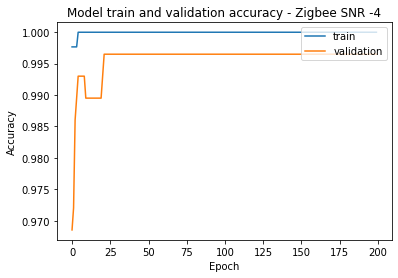

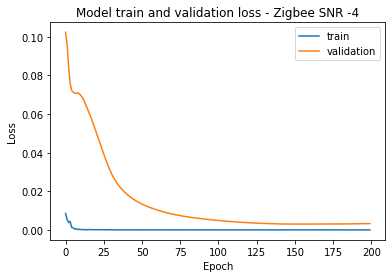


Score of SNR on All SNR model without Transfer Learning -2 = 100.0
Score of SNR on High SNR model without Transfer Learning -2 = 86.36363744735718
Score of SNR on low SNR model without Transfer Learning -2 = 98.95104765892029

Training SNR = -2 Data

Epoch 1/200
1/1 [==============================] - 2s 2s/step - loss: 0.6557 - accuracy: 0.6760 - val_loss: 0.6433 - val_accuracy: 0.9930
Epoch 2/200
1/1 [==============================] - 0s 43ms/step - loss: 0.2850 - accuracy: 0.8998 - val_loss: 0.6131 - val_accuracy: 1.0000
Epoch 3/200
1/1 [==============================] - 0s 31ms/step - loss: 0.1205 - accuracy: 0.9814 - val_loss: 0.5864 - val_accuracy: 1.0000
Epoch 4/200
1/1 [==============================] - 0s 30ms/step - loss: 0.0621 - accuracy: 0.9942 - val_loss: 0.5626 - val_accuracy: 1.0000
Epoch 5/200
1/1 [==============================] - 0s 28ms/step - loss: 0.0365 - accuracy: 0.9965 - val_loss: 0.5413 - val_accuracy: 1.0000
Epoch 6/200
1/1 [==============================] -

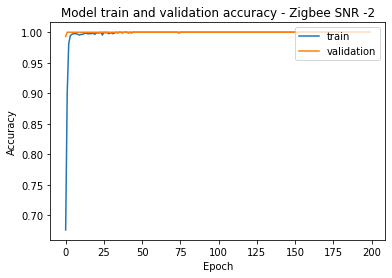

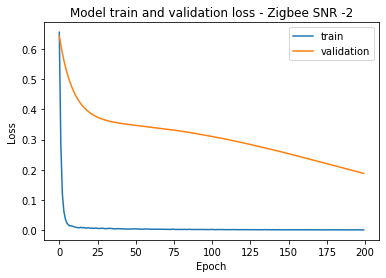


Training SNR = -2 Data on a pre-trained All SNR model

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.0063 - accuracy: 0.9965 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 2/200
1/1 [==============================] - 0s 41ms/step - loss: 0.0032 - accuracy: 0.9988 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 3/200
1/1 [==============================] - 0s 32ms/step - loss: 0.0028 - accuracy: 0.9977 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 4/200
1/1 [==============================] - 0s 37ms/step - loss: 0.0018 - accuracy: 1.0000 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 5/200
1/1 [==============================] - 0s 40ms/step - loss: 0.0019 - accuracy: 0.9988 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 6/200
1/1 [==============================] - 0s 33ms/step - loss: 0.0019 - accuracy: 0.9988 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 7/200
1/1 [==============================] - 0s 35ms/step - loss: 0.0019 - a

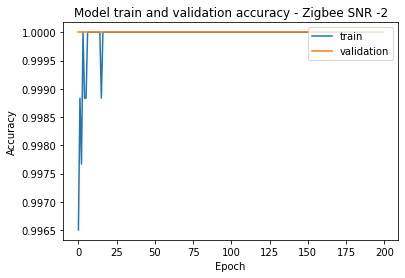

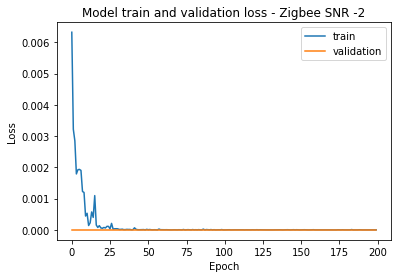


Training SNR = -2 Data on a pre-trained High SNR model

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.0166 - accuracy: 0.9965 - val_loss: 0.2124 - val_accuracy: 0.9126
Epoch 2/200
1/1 [==============================] - 0s 32ms/step - loss: 0.0132 - accuracy: 0.9953 - val_loss: 0.1627 - val_accuracy: 0.9336
Epoch 3/200
1/1 [==============================] - 0s 33ms/step - loss: 0.0098 - accuracy: 0.9965 - val_loss: 0.1276 - val_accuracy: 0.9476
Epoch 4/200
1/1 [==============================] - 0s 31ms/step - loss: 0.0083 - accuracy: 0.9953 - val_loss: 0.0999 - val_accuracy: 0.9755
Epoch 5/200
1/1 [==============================] - 0s 31ms/step - loss: 0.0055 - accuracy: 0.9965 - val_loss: 0.0869 - val_accuracy: 0.9860
Epoch 6/200
1/1 [==============================] - 0s 36ms/step - loss: 0.0044 - accuracy: 0.9977 - val_loss: 0.0833 - val_accuracy: 0.9860
Epoch 7/200
1/1 [==============================] - 0s 37ms/step - loss: 0.0032 - accuracy: 0.9988 - val_l

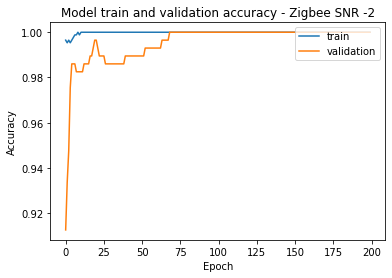

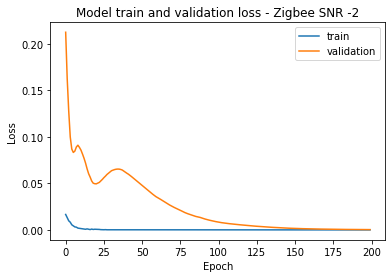


Training SNR = -2 Data on a pre-trained Low SNR model

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.0104 - accuracy: 0.9953 - val_loss: 0.0576 - val_accuracy: 0.9965
Epoch 2/200
1/1 [==============================] - 0s 55ms/step - loss: 0.0081 - accuracy: 0.9977 - val_loss: 0.0508 - val_accuracy: 0.9965
Epoch 3/200
1/1 [==============================] - 0s 45ms/step - loss: 0.0049 - accuracy: 0.9977 - val_loss: 0.0442 - val_accuracy: 0.9965
Epoch 4/200
1/1 [==============================] - 0s 35ms/step - loss: 0.0036 - accuracy: 0.9988 - val_loss: 0.0379 - val_accuracy: 1.0000
Epoch 5/200
1/1 [==============================] - 0s 37ms/step - loss: 0.0024 - accuracy: 1.0000 - val_loss: 0.0334 - val_accuracy: 1.0000
Epoch 6/200
1/1 [==============================] - 0s 27ms/step - loss: 0.0017 - accuracy: 1.0000 - val_loss: 0.0302 - val_accuracy: 1.0000
Epoch 7/200
1/1 [==============================] - 0s 28ms/step - loss: 0.0014 - accuracy: 1.0000 - val_lo

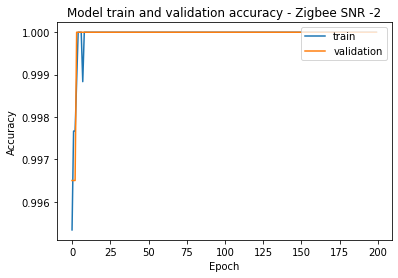

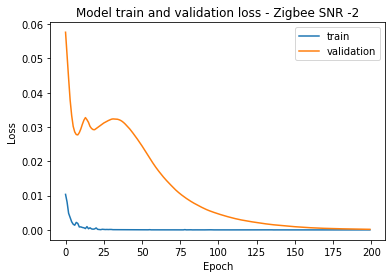

In [ ]:
for i in range(5, 10):

  x_data_mag = np.absolute(x_data_fft_zigbee[:,:,:,:,0] + 1j*x_data_fft_zigbee[:,:,:,:,1]) 
  x_data_fft_curr = np.reshape(x_data_mag[:,i], (x_dim[0]*x_dim[2], x_dim[3]))
  
  y_data_fft_curr = to_categorical(y_labels_zigbee[:,i].flatten())

  X_train_curr, X_test_valid_curr, Y_train_curr, Y_test_valid_curr = train_test_split(x_data_fft_curr, y_data_fft_curr, test_size=0.4)
  X_validation_curr, X_test_curr, Y_validation_curr, Y_test_curr = train_test_split(X_test_valid_curr, Y_test_valid_curr, test_size=0.5)

  Testing(X_test_curr, Y_test_curr, i)
  train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_all_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_high_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)
  train_data_on_low_snr_model(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)


Score of SNR on All SNR model without Transfer Learning 0 = 100.0
Score of SNR on High SNR model without Transfer Learning 0 = 86.01398468017578
Score of SNR on low SNR model without Transfer Learning 0 = 100.0

Training SNR = 0 Data

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.8790 - accuracy: 0.5093 - val_loss: 0.6525 - val_accuracy: 0.9685
Epoch 2/200
1/1 [==============================] - 0s 23ms/step - loss: 0.3751 - accuracy: 0.8252 - val_loss: 0.6209 - val_accuracy: 1.0000
Epoch 3/200
1/1 [==============================] - 0s 30ms/step - loss: 0.1585 - accuracy: 0.9697 - val_loss: 0.5929 - val_accuracy: 1.0000
Epoch 4/200
1/1 [==============================] - 0s 21ms/step - loss: 0.0745 - accuracy: 0.9988 - val_loss: 0.5681 - val_accuracy: 1.0000
Epoch 5/200
1/1 [==============================] - 0s 24ms/step - loss: 0.0477 - accuracy: 0.9965 - val_loss: 0.5462 - val_accuracy: 1.0000
Epoch 6/200
1/1 [==============================] - 0s 20ms/step - 

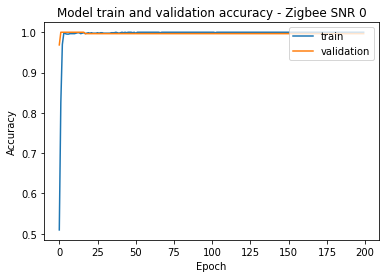

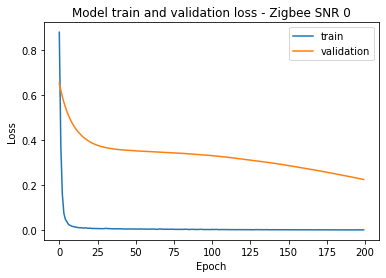


Score of SNR on All SNR model without Transfer Learning 2 = 100.0
Score of SNR on High SNR model without Transfer Learning 2 = 87.76223659515381
Score of SNR on low SNR model without Transfer Learning 2 = 100.0

Training SNR = 2 Data

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.6637 - accuracy: 0.6340 - val_loss: 0.6446 - val_accuracy: 0.9406
Epoch 2/200
1/1 [==============================] - 0s 25ms/step - loss: 0.2886 - accuracy: 0.8823 - val_loss: 0.6066 - val_accuracy: 1.0000
Epoch 3/200
1/1 [==============================] - 0s 22ms/step - loss: 0.1056 - accuracy: 0.9895 - val_loss: 0.5754 - val_accuracy: 1.0000
Epoch 4/200
1/1 [==============================] - 0s 28ms/step - loss: 0.0480 - accuracy: 0.9965 - val_loss: 0.5497 - val_accuracy: 1.0000
Epoch 5/200
1/1 [==============================] - 0s 27ms/step - loss: 0.0270 - accuracy: 0.9965 - val_loss: 0.5280 - val_accuracy: 1.0000
Epoch 6/200
1/1 [==============================] - 0s 22ms/step - 

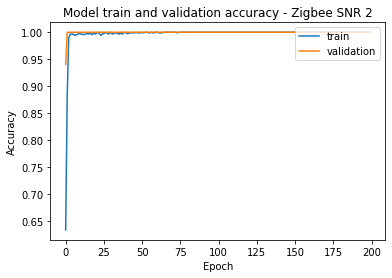

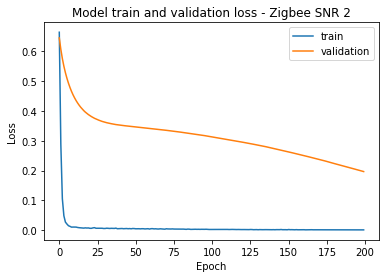


Score of SNR on All SNR model without Transfer Learning 4 = 100.0
Score of SNR on High SNR model without Transfer Learning 4 = 89.51048851013184
Score of SNR on low SNR model without Transfer Learning 4 = 99.6503472328186

Training SNR = 4 Data

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.5324 - accuracy: 0.7308 - val_loss: 0.6518 - val_accuracy: 0.9650
Epoch 2/200
1/1 [==============================] - 0s 25ms/step - loss: 0.2142 - accuracy: 0.9347 - val_loss: 0.6157 - val_accuracy: 1.0000
Epoch 3/200
1/1 [==============================] - 0s 26ms/step - loss: 0.0790 - accuracy: 0.9930 - val_loss: 0.5850 - val_accuracy: 1.0000
Epoch 4/200
1/1 [==============================] - 0s 23ms/step - loss: 0.0420 - accuracy: 0.9953 - val_loss: 0.5585 - val_accuracy: 1.0000
Epoch 5/200
1/1 [==============================] - 0s 23ms/step - loss: 0.0264 - accuracy: 0.9965 - val_loss: 0.5353 - val_accuracy: 1.0000
Epoch 6/200
1/1 [==============================] - 0s 2

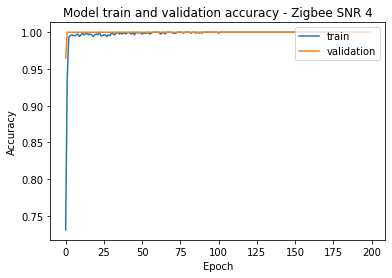

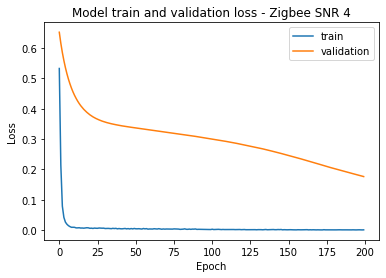


Score of SNR on All SNR model without Transfer Learning 6 = 99.6503472328186
Score of SNR on High SNR model without Transfer Learning 6 = 85.31468510627747
Score of SNR on low SNR model without Transfer Learning 6 = 100.0

Training SNR = 6 Data

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.3973 - accuracy: 0.8252 - val_loss: 0.6014 - val_accuracy: 0.9930
Epoch 2/200
1/1 [==============================] - 0s 27ms/step - loss: 0.1330 - accuracy: 0.9662 - val_loss: 0.5657 - val_accuracy: 0.9930
Epoch 3/200
1/1 [==============================] - 0s 22ms/step - loss: 0.0446 - accuracy: 0.9953 - val_loss: 0.5360 - val_accuracy: 0.9930
Epoch 4/200
1/1 [==============================] - 0s 28ms/step - loss: 0.0244 - accuracy: 0.9965 - val_loss: 0.5109 - val_accuracy: 0.9930
Epoch 5/200
1/1 [==============================] - 0s 21ms/step - loss: 0.0140 - accuracy: 0.9965 - val_loss: 0.4896 - val_accuracy: 0.9930
Epoch 6/200
1/1 [==============================] - 0s 2

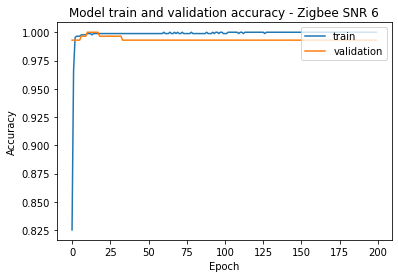

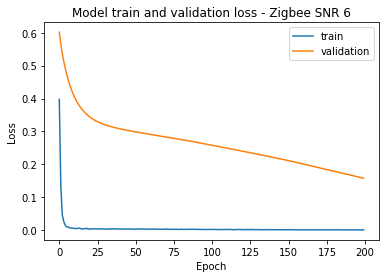


Score of SNR on All SNR model without Transfer Learning 8 = 100.0
Score of SNR on High SNR model without Transfer Learning 8 = 85.66433787345886
Score of SNR on low SNR model without Transfer Learning 8 = 99.6503472328186

Training SNR = 8 Data

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.9961 - accuracy: 0.3998 - val_loss: 0.6483 - val_accuracy: 0.8042
Epoch 2/200
1/1 [==============================] - 0s 28ms/step - loss: 0.3893 - accuracy: 0.8392 - val_loss: 0.6099 - val_accuracy: 1.0000
Epoch 3/200
1/1 [==============================] - 0s 27ms/step - loss: 0.1418 - accuracy: 0.9802 - val_loss: 0.5772 - val_accuracy: 1.0000
Epoch 4/200
1/1 [==============================] - 0s 26ms/step - loss: 0.0629 - accuracy: 0.9965 - val_loss: 0.5494 - val_accuracy: 1.0000
Epoch 5/200
1/1 [==============================] - 0s 23ms/step - loss: 0.0316 - accuracy: 0.9965 - val_loss: 0.5256 - val_accuracy: 1.0000
Epoch 6/200
1/1 [==============================] - 0s 2

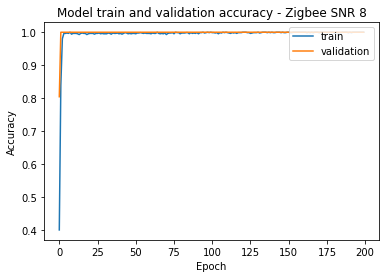

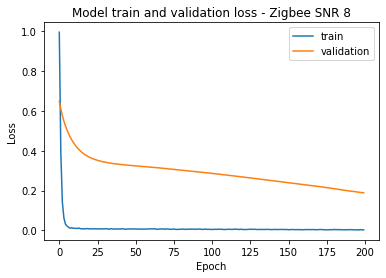

In [ ]:
for i in range(10, 15):

  x_data_mag = np.absolute(x_data_fft_zigbee[:,:,:,:,0] + 1j*x_data_fft_zigbee[:,:,:,:,1]) 
  x_data_fft_curr = np.reshape(x_data_mag[:,i], (x_dim[0]*x_dim[2], x_dim[3]))
  
  y_data_fft_curr = to_categorical(y_labels_zigbee[:,i].flatten())

  X_train_curr, X_test_valid_curr, Y_train_curr, Y_test_valid_curr = train_test_split(x_data_fft_curr, y_data_fft_curr, test_size=0.4)
  X_validation_curr, X_test_curr, Y_validation_curr, Y_test_curr = train_test_split(X_test_valid_curr, Y_test_valid_curr, test_size=0.5)

  Testing(X_test_curr, Y_test_curr, i)
  train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)


Score of SNR on All SNR model without Transfer Learning 10 = 99.30070042610168
Score of SNR on High SNR model without Transfer Learning 10 = 87.76223659515381
Score of SNR on low SNR model without Transfer Learning 10 = 98.95104765892029

Training SNR = 10 Data

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 1.0475 - accuracy: 0.3904 - val_loss: 0.6535 - val_accuracy: 0.9965
Epoch 2/200
1/1 [==============================] - 0s 22ms/step - loss: 0.4228 - accuracy: 0.8310 - val_loss: 0.6134 - val_accuracy: 0.9965
Epoch 3/200
1/1 [==============================] - 0s 21ms/step - loss: 0.1613 - accuracy: 0.9697 - val_loss: 0.5791 - val_accuracy: 0.9930
Epoch 4/200
1/1 [==============================] - 0s 21ms/step - loss: 0.0638 - accuracy: 0.9953 - val_loss: 0.5507 - val_accuracy: 0.9930
Epoch 5/200
1/1 [==============================] - 0s 24ms/step - loss: 0.0305 - accuracy: 1.0000 - val_loss: 0.5267 - val_accuracy: 0.9930
Epoch 6/200
1/1 [=====================

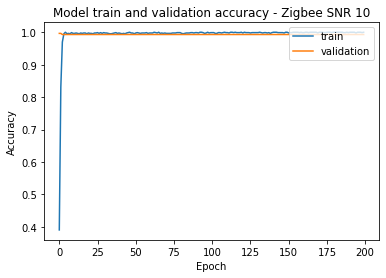

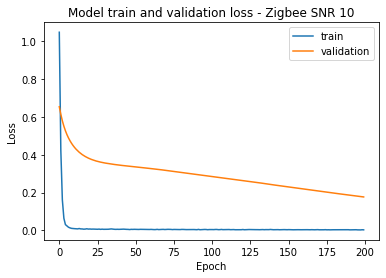


Score of SNR on All SNR model without Transfer Learning 12 = 100.0
Score of SNR on High SNR model without Transfer Learning 12 = 86.01398468017578
Score of SNR on low SNR model without Transfer Learning 12 = 100.0

Training SNR = 12 Data

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.7538 - accuracy: 0.5536 - val_loss: 0.6509 - val_accuracy: 0.9755
Epoch 2/200
1/1 [==============================] - 0s 25ms/step - loss: 0.3377 - accuracy: 0.8788 - val_loss: 0.6135 - val_accuracy: 0.9965
Epoch 3/200
1/1 [==============================] - 0s 24ms/step - loss: 0.1606 - accuracy: 0.9848 - val_loss: 0.5806 - val_accuracy: 0.9965
Epoch 4/200
1/1 [==============================] - 0s 23ms/step - loss: 0.0822 - accuracy: 0.9953 - val_loss: 0.5518 - val_accuracy: 0.9965
Epoch 5/200
1/1 [==============================] - 0s 24ms/step - loss: 0.0515 - accuracy: 0.9977 - val_loss: 0.5263 - val_accuracy: 0.9965
Epoch 6/200
1/1 [==============================] - 0s 42ms/ste

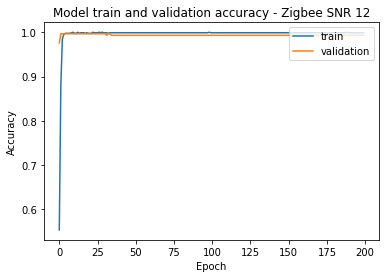

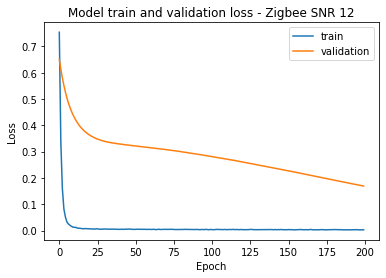


Score of SNR on All SNR model without Transfer Learning 14 = 98.95104765892029
Score of SNR on High SNR model without Transfer Learning 14 = 87.0629370212555
Score of SNR on low SNR model without Transfer Learning 14 = 99.6503472328186

Training SNR = 14 Data

Epoch 1/200
1/1 [==============================] - 2s 2s/step - loss: 0.3365 - accuracy: 0.8741 - val_loss: 0.6113 - val_accuracy: 0.9860
Epoch 2/200
1/1 [==============================] - 0s 26ms/step - loss: 0.1101 - accuracy: 0.9872 - val_loss: 0.5704 - val_accuracy: 1.0000
Epoch 3/200
1/1 [==============================] - 0s 25ms/step - loss: 0.0428 - accuracy: 0.9953 - val_loss: 0.5361 - val_accuracy: 1.0000
Epoch 4/200
1/1 [==============================] - 0s 26ms/step - loss: 0.0230 - accuracy: 0.9988 - val_loss: 0.5069 - val_accuracy: 1.0000
Epoch 5/200
1/1 [==============================] - 0s 25ms/step - loss: 0.0148 - accuracy: 0.9988 - val_loss: 0.4819 - val_accuracy: 1.0000
Epoch 6/200
1/1 [=======================

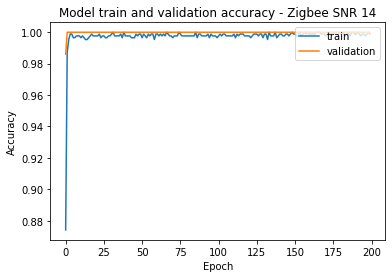

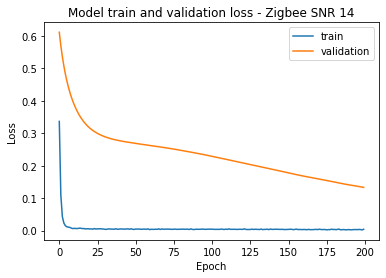


Score of SNR on All SNR model without Transfer Learning 16 = 100.0
Score of SNR on High SNR model without Transfer Learning 16 = 86.7132842540741
Score of SNR on low SNR model without Transfer Learning 16 = 99.30070042610168

Training SNR = 16 Data

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 1.6290 - accuracy: 0.2273 - val_loss: 0.6851 - val_accuracy: 0.6014
Epoch 2/200
1/1 [==============================] - 0s 23ms/step - loss: 0.6958 - accuracy: 0.6305 - val_loss: 0.6313 - val_accuracy: 0.9895
Epoch 3/200
1/1 [==============================] - 0s 28ms/step - loss: 0.2469 - accuracy: 0.9079 - val_loss: 0.5863 - val_accuracy: 0.9965
Epoch 4/200
1/1 [==============================] - 0s 42ms/step - loss: 0.0893 - accuracy: 0.9942 - val_loss: 0.5499 - val_accuracy: 0.9965
Epoch 5/200
1/1 [==============================] - 0s 23ms/step - loss: 0.0461 - accuracy: 0.9988 - val_loss: 0.5203 - val_accuracy: 0.9965
Epoch 6/200
1/1 [==============================] - 

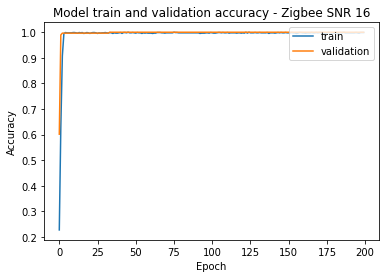

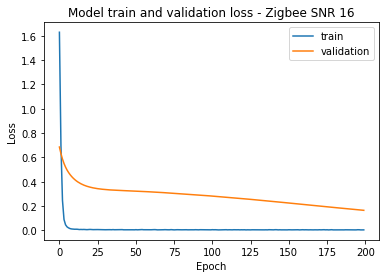


Score of SNR on All SNR model without Transfer Learning 18 = 99.6503472328186
Score of SNR on High SNR model without Transfer Learning 18 = 87.41258978843689
Score of SNR on low SNR model without Transfer Learning 18 = 100.0

Training SNR = 18 Data

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 1.1218 - accuracy: 0.3403 - val_loss: 0.6650 - val_accuracy: 0.6748
Epoch 2/200
1/1 [==============================] - 0s 23ms/step - loss: 0.4596 - accuracy: 0.7762 - val_loss: 0.6211 - val_accuracy: 0.9685
Epoch 3/200
1/1 [==============================] - 0s 25ms/step - loss: 0.1979 - accuracy: 0.9615 - val_loss: 0.5842 - val_accuracy: 1.0000
Epoch 4/200
1/1 [==============================] - 0s 29ms/step - loss: 0.0874 - accuracy: 0.9942 - val_loss: 0.5531 - val_accuracy: 1.0000
Epoch 5/200
1/1 [==============================] - 0s 31ms/step - loss: 0.0537 - accuracy: 0.9953 - val_loss: 0.5267 - val_accuracy: 1.0000
Epoch 6/200
1/1 [==============================] - 

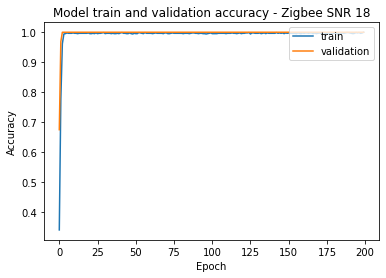

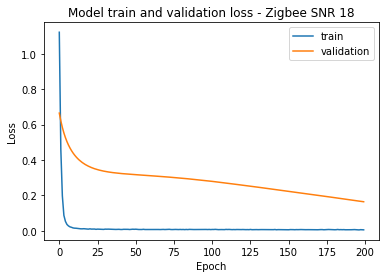


Score of SNR on All SNR model without Transfer Learning 20 = 99.6503472328186
Score of SNR on High SNR model without Transfer Learning 20 = 84.96503233909607
Score of SNR on low SNR model without Transfer Learning 20 = 100.0

Training SNR = 20 Data

Epoch 1/200
1/1 [==============================] - 1s 1s/step - loss: 0.6604 - accuracy: 0.6643 - val_loss: 0.6160 - val_accuracy: 0.8811
Epoch 2/200
1/1 [==============================] - 0s 26ms/step - loss: 0.2376 - accuracy: 0.9254 - val_loss: 0.5749 - val_accuracy: 0.9930
Epoch 3/200
1/1 [==============================] - 0s 32ms/step - loss: 0.0860 - accuracy: 0.9942 - val_loss: 0.5407 - val_accuracy: 0.9965
Epoch 4/200
1/1 [==============================] - 0s 24ms/step - loss: 0.0445 - accuracy: 0.9953 - val_loss: 0.5119 - val_accuracy: 0.9965
Epoch 5/200
1/1 [==============================] - 0s 25ms/step - loss: 0.0285 - accuracy: 0.9965 - val_loss: 0.4873 - val_accuracy: 0.9965
Epoch 6/200
1/1 [==============================] - 

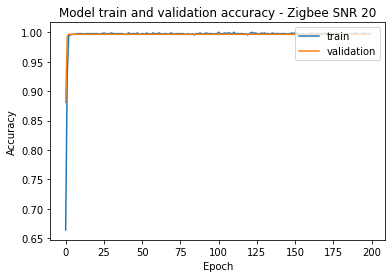

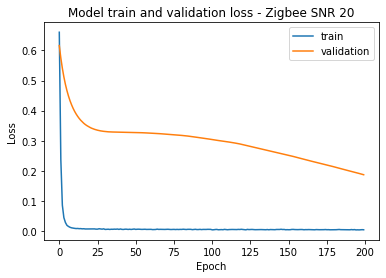

In [ ]:
for i in range(15, 21):

  x_data_mag = np.absolute(x_data_fft_zigbee[:,:,:,:,0] + 1j*x_data_fft_zigbee[:,:,:,:,1]) 
  x_data_fft_curr = np.reshape(x_data_mag[:,i], (x_dim[0]*x_dim[2], x_dim[3]))
  
  y_data_fft_curr = to_categorical(y_labels_zigbee[:,i].flatten())

  X_train_curr, X_test_valid_curr, Y_train_curr, Y_test_valid_curr = train_test_split(x_data_fft_curr, y_data_fft_curr, test_size=0.4)
  X_validation_curr, X_test_curr, Y_validation_curr, Y_test_curr = train_test_split(X_test_valid_curr, Y_test_valid_curr, test_size=0.5)

  Testing(X_test_curr, Y_test_curr, i)
  train_data(X_train_curr, Y_train_curr, X_validation_curr, Y_validation_curr, X_test_curr, Y_test_curr, i)

# Confusion Martix

##Channel Classification

In [ ]:
x_dim = x_data_fft_data[:, 10:21].shape
total_num_snapshots = x_dim[0]*x_dim[1]*x_dim[2]
num_snapshots_per_tech = x_dim[1]*x_dim[2]
num_tech = x_dim[0]
num_samples = x_dim[3]
print(num_snapshots_per_tech)

7865


In [ ]:
from sklearn.preprocessing import MinMaxScaler

# Bin wise scalers for FFT data from sklearn
scaler_01 = MinMaxScaler(feature_range=(0,1))

x_data_fft_all_SNR_1d = np.reshape(x_data_fft_data[:, 10:21], (total_num_snapshots, num_samples*x_dim[4]))
fft_data_complex = np.reshape(x_data_fft_all_SNR_1d.flatten()[::2] + 1j*x_data_fft_all_SNR_1d.flatten()[1::2], (total_num_snapshots, num_samples))
x_data_fft_all_SNR_1d = scaler_01.fit_transform(np.absolute(fft_data_complex))

In [ ]:
from keras import models

x_models = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/fcnFFTdata_allSNR.tf"))
pred = x_models.predict(x_data_fft_all_SNR_1d)

In [ ]:
Y_pred = np.zeros(shape=(x_data_fft_all_SNR_1d.shape[0],15))
for i in range(pred.shape[0]):
  temp_max = max(pred[i])
  for j in range(15):
    if(temp_max == pred[i][j]):
      Y_pred[i][j] = 1

y_act = y_labels_data[:, 10:21].flatten()
y_pred = np.argmax(Y_pred, axis = 1)

In [ ]:
import itertools

def plot_confusion_matrix(cm, size, title='Confusion matrix', target_names=None, cmap=None, normalize=True, labels=True, grid=True, colorbar=True):

    if cmap is None:
        cmap = plt.get_cmap('Blues')

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        
    plt.figure(figsize=size)
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    if colorbar:
      plt.colorbar()

    thresh = cm.max() / 1.5 if normalize else cm.max() / 2
    
    if target_names is not None:
        tick_marks = np.arange(len(target_names))
        plt.xticks(tick_marks, target_names, rotation=45)
        plt.yticks(tick_marks, target_names)
    
    if labels:
        for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
            if normalize:
                plt.text(j, i, "{:0.2f}".format(cm[i, j]),
                         horizontalalignment="center",
                         color="white" if cm[i, j] > thresh else "black")
            else:
                plt.text(j, i, "{:,}".format(cm[i, j]),
                         horizontalalignment="center",
                         color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    if grid:
      plt.grid()
    plt.ylabel('True label ->')
    plt.xlabel('Predicted label ->')
    plt.show()

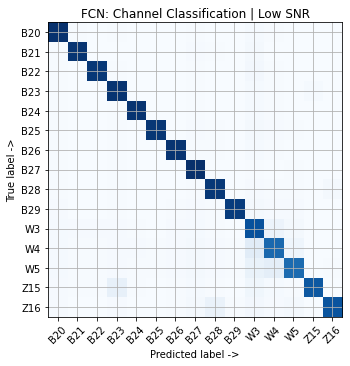

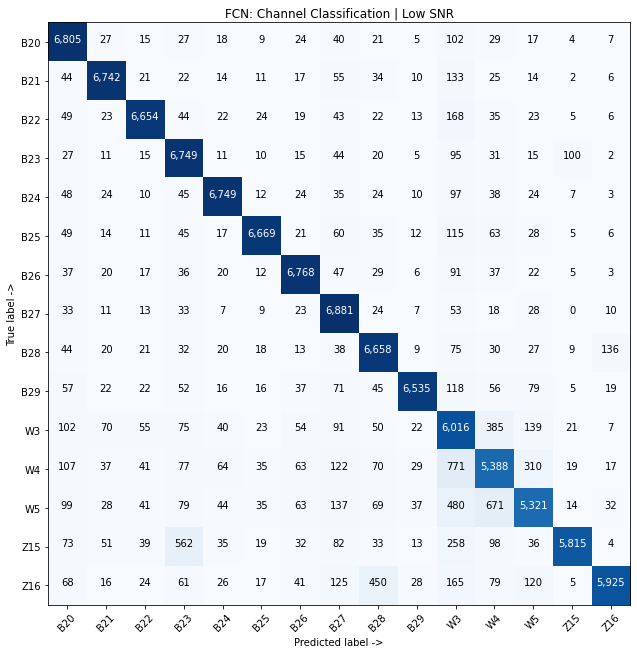

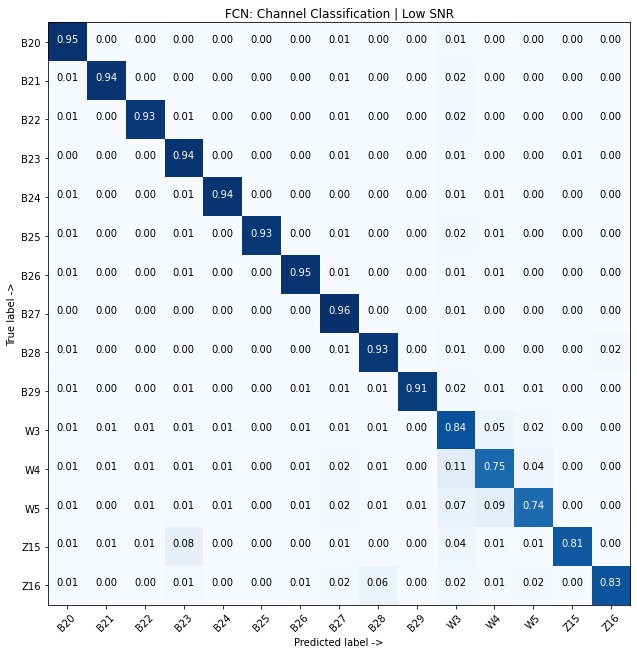


Classfication Report:
               precision    recall  f1-score   support

         B20       0.89      0.95      0.92      7150
         B21       0.95      0.94      0.95      7150
         B22       0.95      0.93      0.94      7150
         B23       0.85      0.94      0.89      7150
         B24       0.95      0.94      0.95      7150
         B25       0.96      0.93      0.95      7150
         B26       0.94      0.95      0.94      7150
         B27       0.87      0.96      0.92      7150
         B28       0.88      0.93      0.90      7150
         B29       0.97      0.91      0.94      7150
          W3       0.69      0.84      0.76      7150
          W4       0.77      0.75      0.76      7150
          W5       0.86      0.74      0.80      7150
         Z15       0.97      0.81      0.88      7150
         Z16       0.96      0.83      0.89      7150

    accuracy                           0.89    107250
   macro avg       0.90      0.89      0.89    107250
we

In [ ]:
#low snr 

import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

conf_mat = confusion_matrix(y_act, y_pred)
class_names = ['B20', 'B21', 'B22', 'B23', 'B24', 'B25', 'B26', 'B27', 'B28', 'B29', 'W3', 'W4', 'W5', 'Z15', 'Z16']
title = 'FCN: Channel Classification | Low SNR'

size = (7,5)
plot_confusion_matrix(conf_mat, size, title, class_names, normalize=False, colorbar=False, labels=False)
size = (12,9)
plot_confusion_matrix(conf_mat, size, title, class_names, grid=False, colorbar=False, normalize=False)
plot_confusion_matrix(conf_mat, size, title, class_names, grid=False, colorbar=False, normalize=True)

print("\nClassfication Report:\n", classification_report(y_act, y_pred, target_names=class_names))

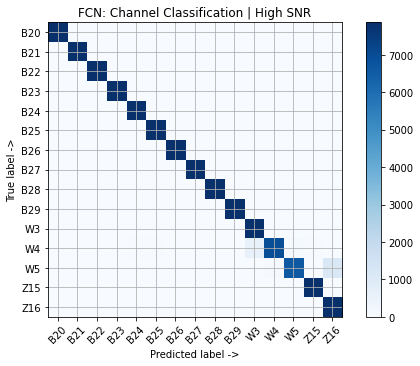

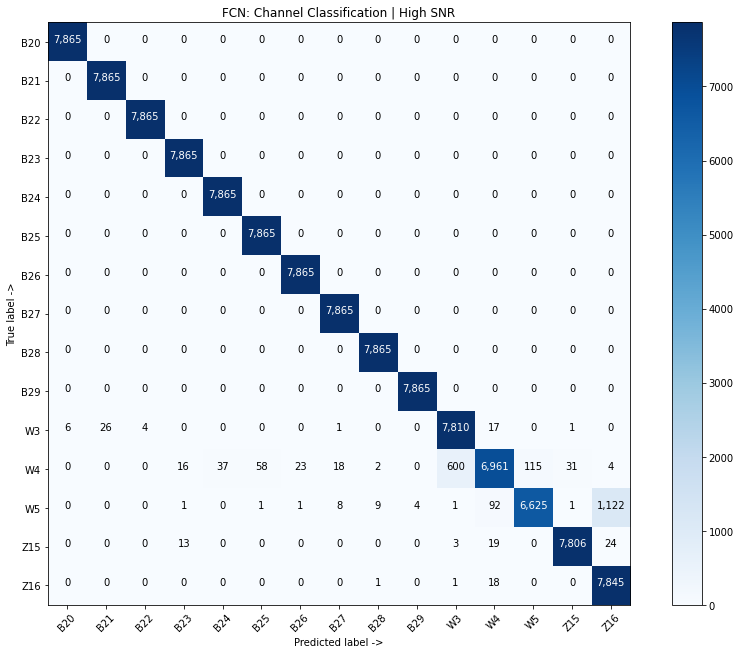

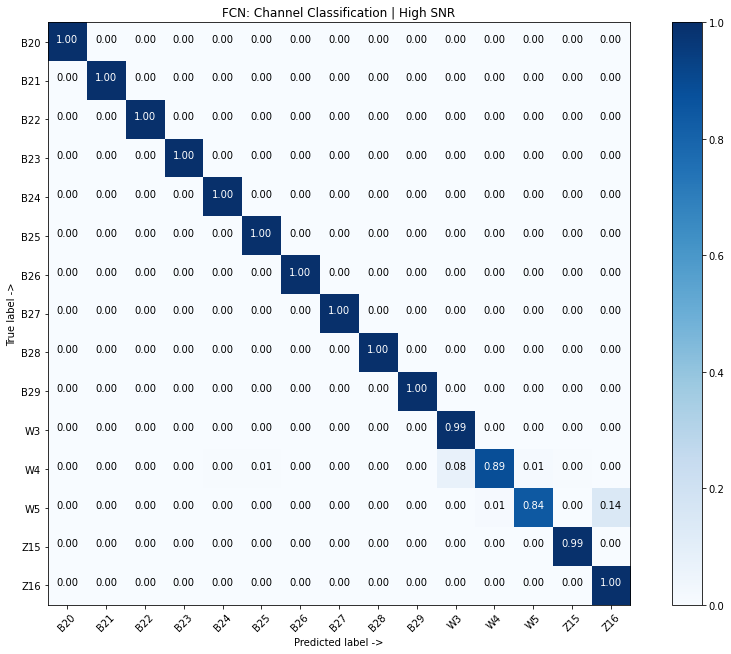


Classfication Report:
               precision    recall  f1-score   support

         B20       1.00      1.00      1.00      7865
         B21       1.00      1.00      1.00      7865
         B22       1.00      1.00      1.00      7865
         B23       1.00      1.00      1.00      7865
         B24       1.00      1.00      1.00      7865
         B25       0.99      1.00      1.00      7865
         B26       1.00      1.00      1.00      7865
         B27       1.00      1.00      1.00      7865
         B28       1.00      1.00      1.00      7865
         B29       1.00      1.00      1.00      7865
          W3       0.93      0.99      0.96      7865
          W4       0.98      0.89      0.93      7865
          W5       0.98      0.84      0.91      7865
         Z15       1.00      0.99      0.99      7865
         Z16       0.87      1.00      0.93      7865

    accuracy                           0.98    117975
   macro avg       0.98      0.98      0.98    117975
we

In [ ]:
#high snr 

from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

conf_mat = confusion_matrix(y_act, y_pred)
class_names = ['B20', 'B21', 'B22', 'B23', 'B24', 'B25', 'B26', 'B27', 'B28', 'B29', 'W3', 'W4', 'W5', 'Z15', 'Z16']
title = 'FCN: Channel Classification | High SNR'

size = (7,5)
plot_confusion_matrix(conf_mat, size, title, class_names, normalize=False, labels=False)
size = (12,9)
plot_confusion_matrix(conf_mat, size, title, class_names, grid=False, normalize=False)
plot_confusion_matrix(conf_mat, size, title, class_names, grid=False, normalize=True)

print("\nClassfication Report:\n", classification_report(y_act, y_pred, target_names=class_names))

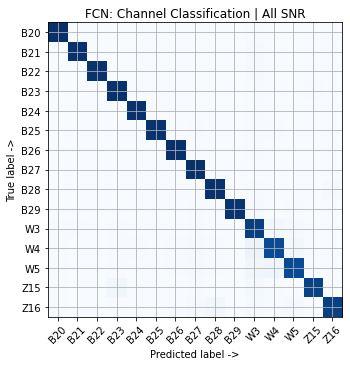

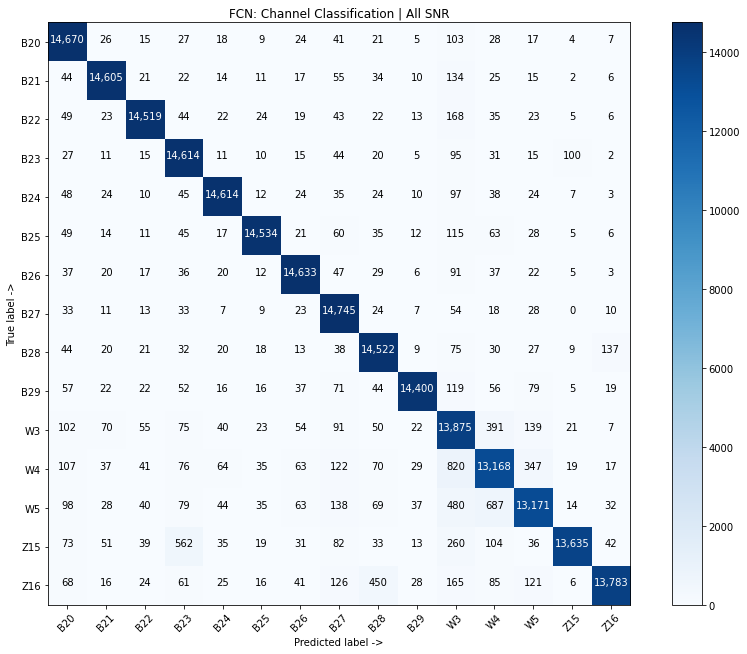

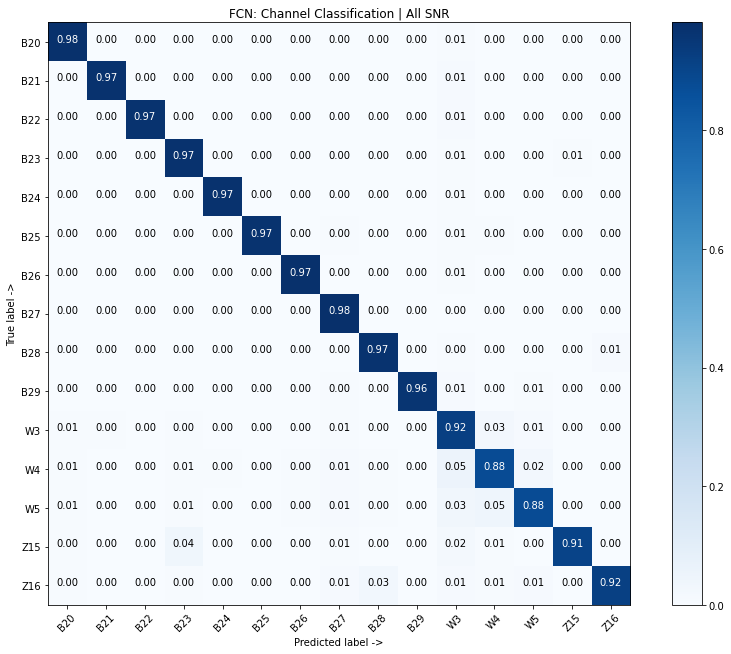


Classfication Report:
               precision    recall  f1-score   support

         B20       0.95      0.98      0.96     15015
         B21       0.98      0.97      0.97     15015
         B22       0.98      0.97      0.97     15015
         B23       0.92      0.97      0.95     15015
         B24       0.98      0.97      0.97     15015
         B25       0.98      0.97      0.98     15015
         B26       0.97      0.97      0.97     15015
         B27       0.94      0.98      0.96     15015
         B28       0.94      0.97      0.95     15015
         B29       0.99      0.96      0.97     15015
          W3       0.83      0.92      0.88     15015
          W4       0.89      0.88      0.88     15015
          W5       0.93      0.88      0.91     15015
         Z15       0.99      0.91      0.95     15015
         Z16       0.98      0.92      0.95     15015

    accuracy                           0.95    225225
   macro avg       0.95      0.95      0.95    225225
we

In [ ]:
#all snr

import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

conf_mat = confusion_matrix(y_act, y_pred)
class_names = ['B20', 'B21', 'B22', 'B23', 'B24', 'B25', 'B26', 'B27', 'B28', 'B29', 'W3', 'W4', 'W5', 'Z15', 'Z16']
title = 'FCN: Channel Classification | All SNR'

size = (7,5)
plot_confusion_matrix(conf_mat, size, title, class_names, normalize=False, labels=False, colorbar=False)
size = (12,9)
plot_confusion_matrix(conf_mat, size, title, class_names, grid=False, normalize=False)
plot_confusion_matrix(conf_mat, size, title, class_names, grid=False, normalize=True)

print("\nClassfication Report:\n", classification_report(y_act, y_pred, target_names=class_names))

##Signal Classification

In [ ]:
x_dim = x_data_fft_data[:, 10:21].shape
total_num_snapshots = x_dim[0]*x_dim[1]*x_dim[2]
num_snapshots_per_tech = x_dim[1]*x_dim[2]
num_tech = x_dim[0]
num_samples = x_dim[3]
print(num_snapshots_per_tech)

7865


In [ ]:
from sklearn.preprocessing import MinMaxScaler
import numpy as np
# Bin wise scalers for FFT data from sklearn
scaler_01 = MinMaxScaler(feature_range=(0,1))

x_data_fft_all_SNR_1d = np.reshape(x_data_fft_data[:, 10:21], (total_num_snapshots, num_samples*x_dim[4]))
fft_data_complex = np.reshape(x_data_fft_all_SNR_1d.flatten()[::2] + 1j*x_data_fft_all_SNR_1d.flatten()[1::2], (total_num_snapshots, num_samples))
x_data_fft_all_SNR_1d = scaler_01.fit_transform(np.absolute(fft_data_complex))

In [ ]:
y_labels_all = y_labels_data[:, 10:21].flatten()

y_labels_one_hot_all = np.zeros(shape=(y_labels_all.shape[0],3))
for i in range(y_labels_all.shape[0]):
  if(0<=y_labels_all[i] and y_labels_all[i]<=9):
    y_labels_one_hot_all[i][0] = 1
  elif(10<=y_labels_all[i] and y_labels_all[i]<=12):
    y_labels_one_hot_all[i][1] = 1
  else:
    y_labels_one_hot_all[i][2] = 1

In [ ]:
from keras import models

x_models = models.load_model(("/gdrive/My Drive/Signal Identification Model FCN/Signal Type/fcnFFTdata_allSNR_signalType.tf"))
pred = x_models.predict(x_data_fft_all_SNR_1d)

In [ ]:
Y_pred = np.zeros(shape=(x_data_fft_all_SNR_1d.shape[0],3))
for i in range(pred.shape[0]):
  temp_max = max(pred[i])
  for j in range(3):
    if(temp_max == pred[i][j]):
      Y_pred[i][j] = 1

y_act = np.argmax(y_labels_one_hot_all, axis = 1)
y_pred = np.argmax(Y_pred, axis = 1)

In [ ]:
import itertools

def plot_confusion_matrix(cm, size, title='Confusion matrix', target_names=None, cmap=None, normalize=True, labels=True, grid=True, colorbar=True):

    if cmap is None:
        cmap = plt.get_cmap('Reds')

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        
    plt.figure(figsize=size)
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    if colorbar:
      plt.colorbar()

    thresh = cm.max() / 1.5 if normalize else cm.max() / 2
    
    if target_names is not None:
        tick_marks = np.arange(len(target_names))
        plt.xticks(tick_marks, target_names)
        plt.yticks(tick_marks, target_names)
    
    if labels:
        for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
            if normalize:
                plt.text(j, i, "{:0.2f}".format(cm[i, j]),
                         horizontalalignment="center",
                         color="white" if cm[i, j] > thresh else "black")
            else:
                plt.text(j, i, "{:,}".format(cm[i, j]),
                         horizontalalignment="center",
                         color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    if grid:
      plt.grid()
    plt.ylabel('True label ->')
    plt.xlabel('Predicted label ->')
    plt.show()

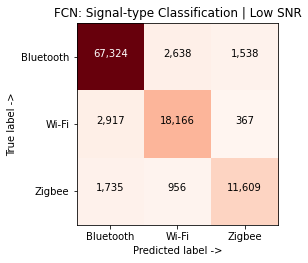

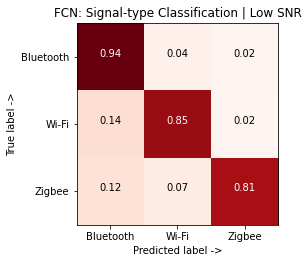


Classfication Report:
               precision    recall  f1-score   support

   Bluetooth       0.94      0.94      0.94     71500
       Wi-Fi       0.83      0.85      0.84     21450
      Zigbee       0.86      0.81      0.83     14300

    accuracy                           0.91    107250
   macro avg       0.88      0.87      0.87    107250
weighted avg       0.91      0.91      0.91    107250



In [ ]:
#low snr

from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
import matplotlib.pyplot as plt

conf_mat = confusion_matrix(y_act, y_pred)
class_names = ['Bluetooth', 'Wi-Fi', 'Zigbee']
title = 'FCN: Signal-type Classification | Low SNR'

size = (4,4)
plot_confusion_matrix(conf_mat, size, title, class_names, normalize=False, grid=False, colorbar=False)
plot_confusion_matrix(conf_mat, size, title, class_names, normalize=True, grid=False, colorbar=False)

print("\nClassfication Report:\n", classification_report(y_act, y_pred, target_names=class_names))

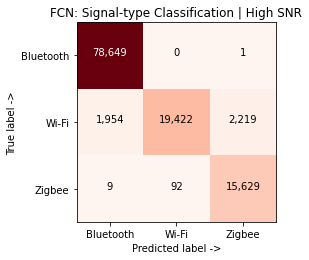

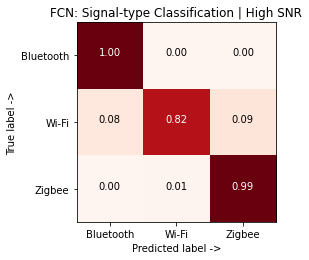


Classfication Report:
               precision    recall  f1-score   support

   Bluetooth       0.98      1.00      0.99     78650
       Wi-Fi       1.00      0.82      0.90     23595
      Zigbee       0.88      0.99      0.93     15730

    accuracy                           0.96    117975
   macro avg       0.95      0.94      0.94    117975
weighted avg       0.97      0.96      0.96    117975



In [ ]:
#high snr

from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
import matplotlib.pyplot as plt

conf_mat = confusion_matrix(y_act, y_pred)
class_names = ['Bluetooth', 'Wi-Fi', 'Zigbee']
title = 'FCN: Signal-type Classification | High SNR'


size = (4,4)
plot_confusion_matrix(conf_mat, size, title, class_names, grid=False, normalize=False, colorbar=False)
plot_confusion_matrix(conf_mat, size, title, class_names, grid=False, normalize=True, colorbar=False)

print("\nClassfication Report:\n", classification_report(y_act, y_pred, target_names=class_names))

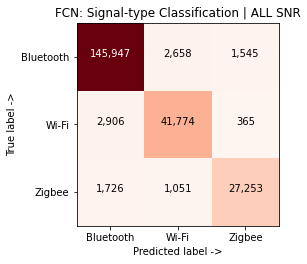

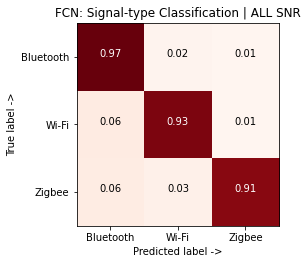


Classfication Report:
               precision    recall  f1-score   support

   Bluetooth       0.97      0.97      0.97    150150
       Wi-Fi       0.92      0.93      0.92     45045
      Zigbee       0.93      0.91      0.92     30030

    accuracy                           0.95    225225
   macro avg       0.94      0.94      0.94    225225
weighted avg       0.95      0.95      0.95    225225



In [ ]:
#all snr

from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
import matplotlib.pyplot as plt

conf_mat = confusion_matrix(y_act, y_pred)
class_names = ['Bluetooth', 'Wi-Fi', 'Zigbee']
title = 'FCN: Signal-type Classification | ALL SNR'

size = (4,4)
plot_confusion_matrix(conf_mat, size, title, class_names, grid=False, normalize=False, colorbar=False)
plot_confusion_matrix(conf_mat, size, title, class_names, grid=False, normalize=True, colorbar=False)

print("\nClassfication Report:\n", classification_report(y_act, y_pred, target_names=class_names))